# Task 5: Extracting Frequency Domain Features

This task focuses on extracting features from EEG signals, specifically performing a 4-level Discrete Wavelet Transform (DWT) to obtain the approximation and detail coefficients for each signal. The DWT parameters are then saved into CSV files for later analysis.

The required steps and functions involved are:

- **DWT (Wavelet Decomposition)** to extract time-frequency features.
- **Spectrogram plotting** to visualize the frequency content.
- **Saving wavelet decomposition parameters** into CSV files.

## Workflow Overview

### 1. Data Loading
The EEG data is loaded using a custom `NPYDataset` class, which handles `.npy` files and efficiently loads the dataset for each specific class (Normal, Complex Partial Seizures, Video Detected Seizures, and Electrographic Seizures).

### 2. Utility Functions

Several utility functions are used to handle and analyze the EEG data:

- **dwt_4_level**:
  - This function takes in EEG data and performs a 4-level Discrete Wavelet Transform (DWT) using a specified wavelet type (default: 'db1'). It returns the approximation and detail coefficients for each level.
  
- **apply_fourier_transform**:
  - Computes the Fourier Transform (FFT) of the EEG data and returns the FFT data, magnitude, frequencies, and phase of the signal.

- **plot_fourier_transform**:
  - Plots Fourier Transform (FFT) of the EEG data.
 
- **plot_spectrogram**:
  - Generates and displays the spectrogram for a specific channel of the EEG signal to visualize its frequency components over time.
  
- **visualize_wavelet_decomposition**:
  - Visualizes the wavelet decomposition for a specific channel by plotting the approximation and detail coefficients for each level. The coefficients are also saved into a CSV file, containing the wavelet decomposition parameters for each channel.

- **save_features_to_csv**:
  - Saves the features into a CSV file. This function is used to save the compiled wavelet decomposition parameters into a CSV file.

### 3. Data Preparation
After loading the dataset, EEG data is passed through the utility functions for Fourier Transform, wavelet decomposition, and spectrogram generation.

### 4. Wavelet Decomposition Saving
The **visualize_wavelet_decomposition** function also saves the wavelet decomposition parameters (approximation and detail coefficients for each level) into CSV files. The CSV files are saved in a specified directory and are named based on the channel index.

### 5. Feature Inspection and Saving
The wavelet decomposition features are saved into CSV files, allowing for easy inspection and further analysis. The CSV files contain columns for the level of decomposition, approximation coefficients, and detail coefficients.

### 6. Analyzing Data from Multiple Classes
The `analyze_data` function analyzes the EEG data from various datasets representing different seizure types (Normal, Complex Partial Seizures, Video Detected Seizures, Electrographic Seizures). For each dataset, the data is passed through the Fourier Transform and wavelet decomposition functions, and the results are saved in CSV files.

## Code Execution

1. **Data Loading**:
   - The EEG data files are loaded from directories containing the `.npy` files for each class (Normal, Complex Partial Seizures, Video Detected Seizures, Electrographic Seizures).
   
2. **Analysis**:
   - For each dataset, the following steps are performed:
     - The signal is passed through the `apply_fourier_transform` function.
     - The `plot_spectrogram` function generates the spectrogram for the signal.
     - The `visualize_wavelet_decomposition` function performs the 4-level DWT and saves the decomposition parameters into a CSV file.

3. **Saving Decomposition Features**:
   - The wavelet decomposition parameters for each channel are saved into CSV files located in the specified save directory (`/kaggle/working/` in this case). The CSV files contain the approximation and detail coefficients for each decomposition level.


# 1. Importing Libraries

In [18]:
import os
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import pywt
from torch.utils.data import Dataset, DataLoader
import random

# 2. Utility Functions

In [19]:
def dwt_4_level(data, wavelet='db1'):
    """
    Perform a 4-level Discrete Wavelet Transform on EEG signals.

    Args:
        data (numpy.ndarray): 1D signal data.
        wavelet (str): Wavelet type (default: 'db1').

    Returns:
        list: Approximation and detail coefficients for each level.
    """
    coeffs = []
    for i in range(4):
        data, cD = pywt.dwt(data, wavelet)
        coeffs.append((data, cD))
    return coeffs

def apply_fourier_transform(data):
    """
    Compute Fourier Transform for EEG signals.

    Args:
        data (numpy.ndarray): EEG signal data.

    Returns:
        tuple: FFT data, magnitude, frequencies, and phase.
    """
    fft_data = np.fft.fft(data, axis=1)
    magnitude = np.abs(fft_data)
    phase = np.angle(fft_data)
    freqs = np.fft.fftfreq(data.shape[1], d=0.002)  # Sampling rate: 500 Hz

    return fft_data, magnitude, freqs, phase

def plot_fourier_transform(magnitude, freqs, channel):
    """
    Plot the magnitude and phase of the Fourier Transform for a specific channel.

    Args:
        magnitude (numpy.ndarray): Magnitude of the FFT data.
        freqs (numpy.ndarray): Frequencies corresponding to the FFT data.
        channel (int): Channel index to visualize.
    """
    plt.figure(figsize=(10, 6))

    # Plot the magnitude spectrum
    plt.subplot(2, 1, 1)
    plt.plot(freqs[:len(freqs)//2], magnitude[channel, :len(freqs)//2])  # Plot only the positive frequencies
    plt.title(f"Fourier Transform Magnitude (Channel {channel + 1})")
    plt.xlabel("Frequency (Hz)")
    plt.ylabel("Magnitude")

    plt.tight_layout()
    plt.show()

def plot_spectrogram(data, channel, sampling_rate=500):
    """
    Generate and display a spectrogram for a specific channel.

    Args:
        data (numpy.ndarray): EEG data (shape: [channels, samples]).
        channel (int): Channel index for spectrogram.
        sampling_rate (int): Sampling rate in Hz (default: 500).
    """
    plt.figure(figsize=(10, 6))
    plt.specgram(data[channel], Fs=sampling_rate, NFFT=256, noverlap=128, cmap='jet')
    plt.title(f"Spectrogram for Channel {channel + 1}")
    plt.xlabel("Time (s)")
    plt.ylabel("Frequency (Hz)")
    plt.colorbar(label="Power/Frequency")
    plt.show()

def calculate_similarity(signal1, signal2):
    """
    Calculate the correlation coefficient between two signals.

    Args:
        signal1 (numpy.ndarray): First signal to compare.
        signal2 (numpy.ndarray): Second signal to compare.

    Returns:
        float: Similarity score (correlation coefficient).
    """
    # Padding shorter signal with zeros to match the length
    if len(signal1) > len(signal2):
        signal2 = np.pad(signal2, (0, len(signal1) - len(signal2)))
    elif len(signal2) > len(signal1):
        signal1 = np.pad(signal1, (0, len(signal2) - len(signal1)))
    
    # Calculate similarity using correlation
    correlation = np.corrcoef(signal1, signal2)[0, 1]
    return correlation

def visualize_wavelet_decomposition(data, channel, wavelet='db1'):
    """
    Visualize wavelet decomposition for a specific channel and present which coefficient is most similar to the original signal.

    Args:
        data (numpy.ndarray): EEG data (shape: [channels, samples]).
        channel (int): Channel index.
        wavelet (str): Wavelet type (default: 'db1').
    """
    coeffs = dwt_4_level(data[channel], wavelet)
    plt.figure(figsize=(10, 12))

    # Plot the original signal
    original_signal = data[channel]
    signal_length = len(original_signal)
    plt.subplot(6, 1, 1)
    plt.plot(original_signal)
    plt.title("Original Signal")

    # Initialize variables to store the similarity of coefficients to the original signal
    similarities = []

    for i, (approx, detail) in enumerate(coeffs):
        # Calculate similarity for both approximation and detail
        approx_similarity = calculate_similarity(original_signal, approx)
        detail_similarity = calculate_similarity(original_signal, detail)

        similarities.append({
            'Level': i + 1,
            'Approximation Similarity': approx_similarity,
            'Detail Similarity': detail_similarity
        })

        plt.subplot(6, 1, i+2)
        plt.plot(approx, label=f"Approximation L{i+1}")
        plt.plot(detail, label=f"Detail L{i+1}", linestyle='--')
        plt.title(f"Level {i+1} Coefficients")
        plt.legend()

    # Find the most similar coefficient
    most_similar = max(similarities, key=lambda x: max(x['Approximation Similarity'], x['Detail Similarity']))
    most_similar_coefficient = 'Approximation' if most_similar['Approximation Similarity'] > most_similar['Detail Similarity'] else 'Detail'

    print(f"Most similar coefficient to the original signal (Channel {channel+1}): {most_similar_coefficient} L{most_similar['Level']} with similarity: {max(most_similar['Approximation Similarity'], most_similar['Detail Similarity'])}")

    # Output the similarity scores for debugging
    print("Similarity Scores:")
    for sim in similarities:
        print(f"Level {sim['Level']} -> Approximation Similarity: {sim['Approximation Similarity']}, Detail Similarity: {sim['Detail Similarity']}")

    plt.tight_layout()
    plt.show()

def save_features_to_csv(features_list, file_name):
    """
    Save the compiled features into a CSV file.

    Args:
        features_list (list): List of feature dictionaries for a dataset.
        file_name (str): The name of the output CSV file.
    """
    # Flatten the nested list and convert to a DataFrame
    flattened_features = [item for sublist in features_list for item in sublist]
    df = pd.DataFrame(flattened_features)

    # Save to CSV
    df.to_csv(file_name, index=False)
    print(f"Features saved to {file_name}")

# 3. Data Loading

In [20]:
class NPYDataset(Dataset):
    """
    Custom PyTorch Dataset to load .npy EEG files.
    """
    def __init__(self, directory):
        self.file_paths = [os.path.join(directory, f) for f in os.listdir(directory) if f.endswith('.npy')]
        self.file_paths.sort()

    def __len__(self):
        return len(self.file_paths)

    def __getitem__(self, idx):
        data = np.load(self.file_paths[idx])
        label = os.path.basename(self.file_paths[idx]).split('.')[0]
        return data, label

In [21]:
# Define the directory containing the .npy files
normal_data_dir = "/kaggle/input/impulse/Impulse/EEG_Data/train_data/Normal"
cps_data_dir = "/kaggle/input/impulse/Impulse/EEG_Data/train_data/Complex_Partial_Seizures"
video_data_dir = "/kaggle/input/impulse/Impulse/EEG_Data/train_data/Video_detected_Seizures_with_no_visual_change_over_EEG"
seizure_data_dir = "/kaggle/input/impulse/Impulse/EEG_Data/train_data/Electrographic_Seizures"

In [22]:
# Load datasets
normal_dataset = NPYDataset(normal_data_dir)
cps_dataset = NPYDataset(cps_data_dir)
video_dataset = NPYDataset(video_data_dir)
seizure_dataset = NPYDataset(seizure_data_dir)

In [23]:
def analyze_data(dataset, label):
    # Randomly select a sample from the dataset
    idx = random.randint(0, len(dataset) - 1)  # Select a random index
    data, sample_label = dataset[idx]
    fft_data, magnitude, freqs, phase = apply_fourier_transform(data)

    print(f"Analyzing {label}: {sample_label}")
    
    features = []
    
    # Collect features for each channel (19 channels)
    for channel in range(data.shape[0]):
        print(f"Plotting Channel {channel + 1}")
        
        # Plot spectrogram
        plot_spectrogram(data, channel=channel)
        
        # Plot wavelet decomposition
        visualize_wavelet_decomposition(data, channel=channel)
        
        # Plot Fourier Transform
        plot_fourier_transform(magnitude, freqs, channel=channel)
        
        # Store features in a dictionary
        feature_dict = {
            "sample_label": sample_label,
            "channel": channel + 1,
            "magnitude": magnitude[channel, :].tolist(),  # Convert numpy array to list for CSV
            "frequencies": freqs.tolist(),
            "phase": phase[channel, :].tolist()
        }
        features.append(feature_dict)

    # Save features to CSV
    save_file_name = f"{label}_features.csv"
    save_features_to_csv(features, save_file_name)

    return features

# 4. Analyze samples from all datasets

Normal Data Analysis
Analyzing Normal: 3342
Plotting Channel 1


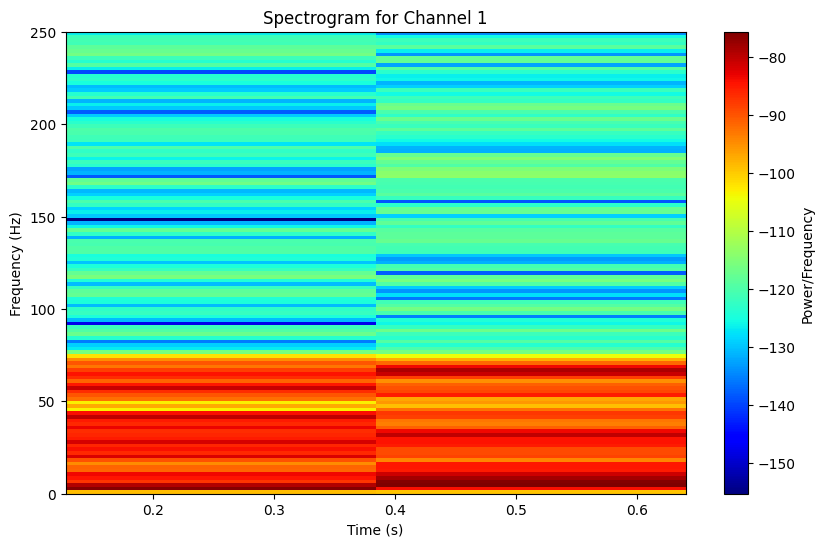

Most similar coefficient to the original signal (Channel 1): Approximation L1 with similarity: 0.013827994220867315
Similarity Scores:
Level 1 -> Approximation Similarity: 0.013827994220867315, Detail Similarity: 0.0052964415743464825
Level 2 -> Approximation Similarity: -0.077157611315306, Detail Similarity: -0.0028392055250443314
Level 3 -> Approximation Similarity: -0.010983900206941656, Detail Similarity: -0.035894185646627406
Level 4 -> Approximation Similarity: -0.05374285820487881, Detail Similarity: -0.013225854494877134


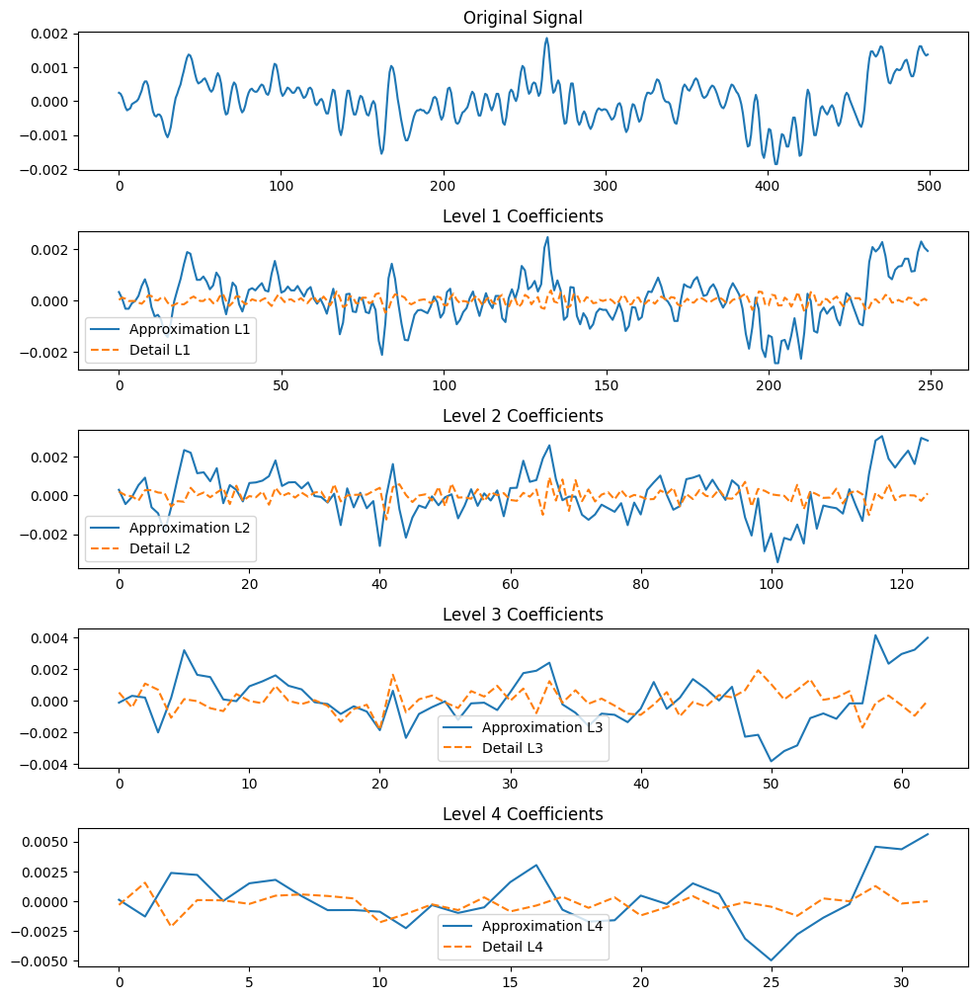

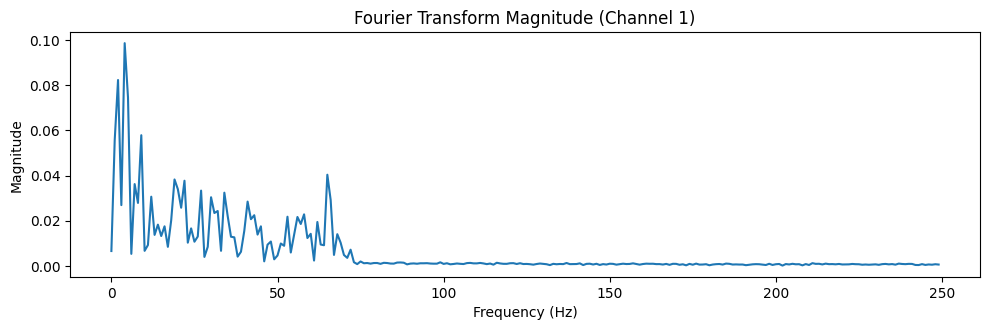

Plotting Channel 2


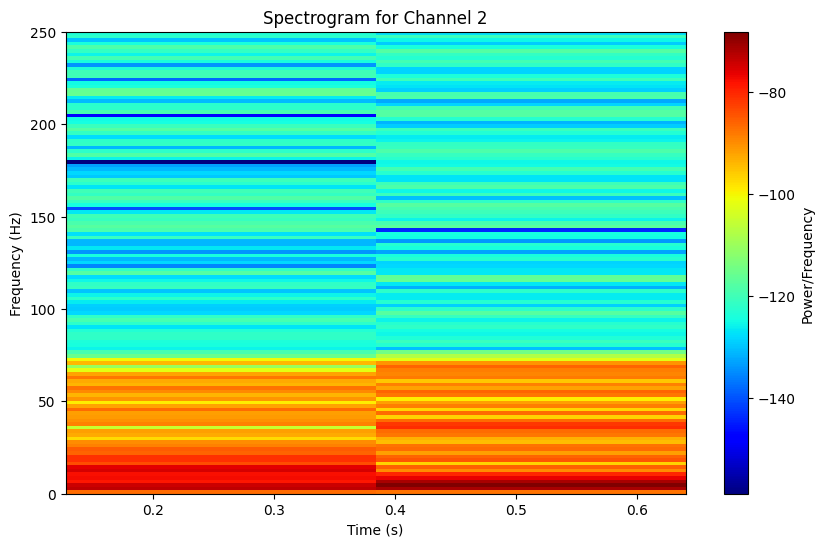

Most similar coefficient to the original signal (Channel 2): Approximation L3 with similarity: 0.04663609136077189
Similarity Scores:
Level 1 -> Approximation Similarity: -0.13313962061697357, Detail Similarity: 0.02028300174412163
Level 2 -> Approximation Similarity: -0.0274954764292395, Detail Similarity: -0.001861706614831761
Level 3 -> Approximation Similarity: 0.04663609136077189, Detail Similarity: 0.028034510534998232
Level 4 -> Approximation Similarity: -0.09974166546211562, Detail Similarity: 0.037565692501501845


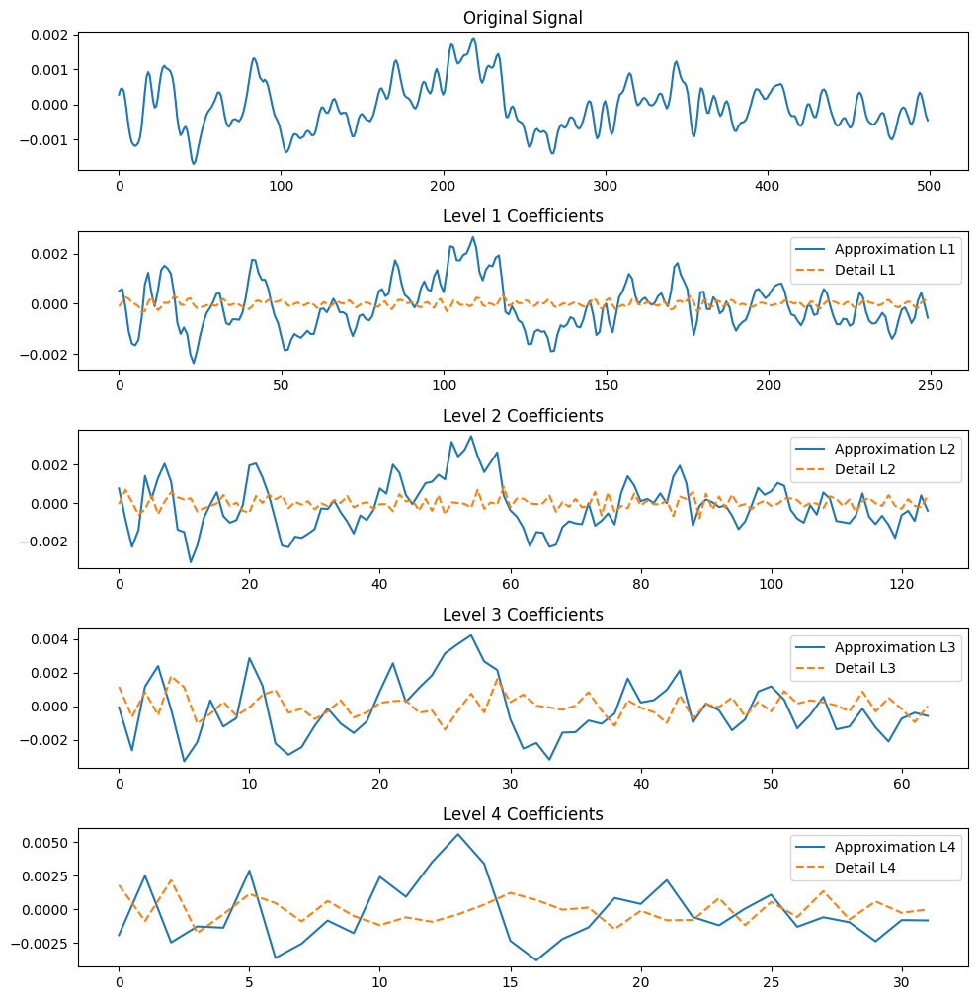

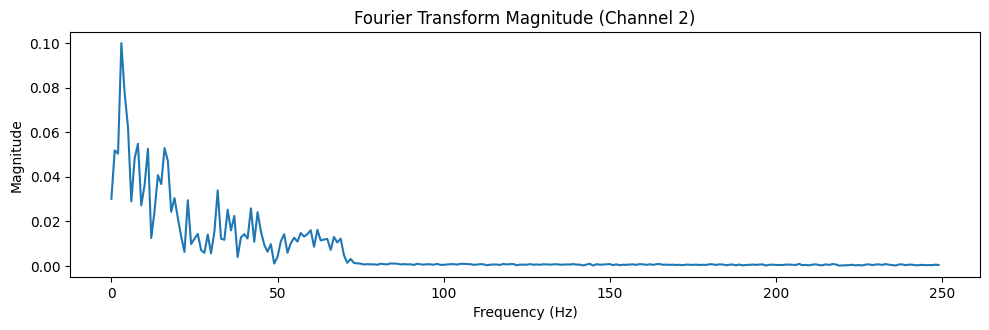

Plotting Channel 3


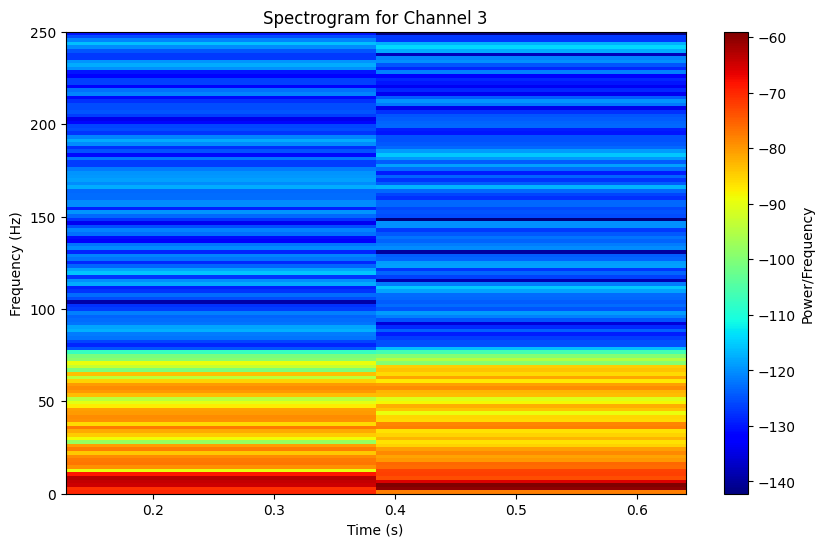

Most similar coefficient to the original signal (Channel 3): Approximation L1 with similarity: 0.05092477337702737
Similarity Scores:
Level 1 -> Approximation Similarity: 0.05092477337702737, Detail Similarity: -0.03520095590527459
Level 2 -> Approximation Similarity: -0.1958569791741346, Detail Similarity: 7.836444107814815e-05
Level 3 -> Approximation Similarity: -0.031203832798408132, Detail Similarity: -0.014106216038545026
Level 4 -> Approximation Similarity: 0.00038011918613061553, Detail Similarity: -0.012735076097966213


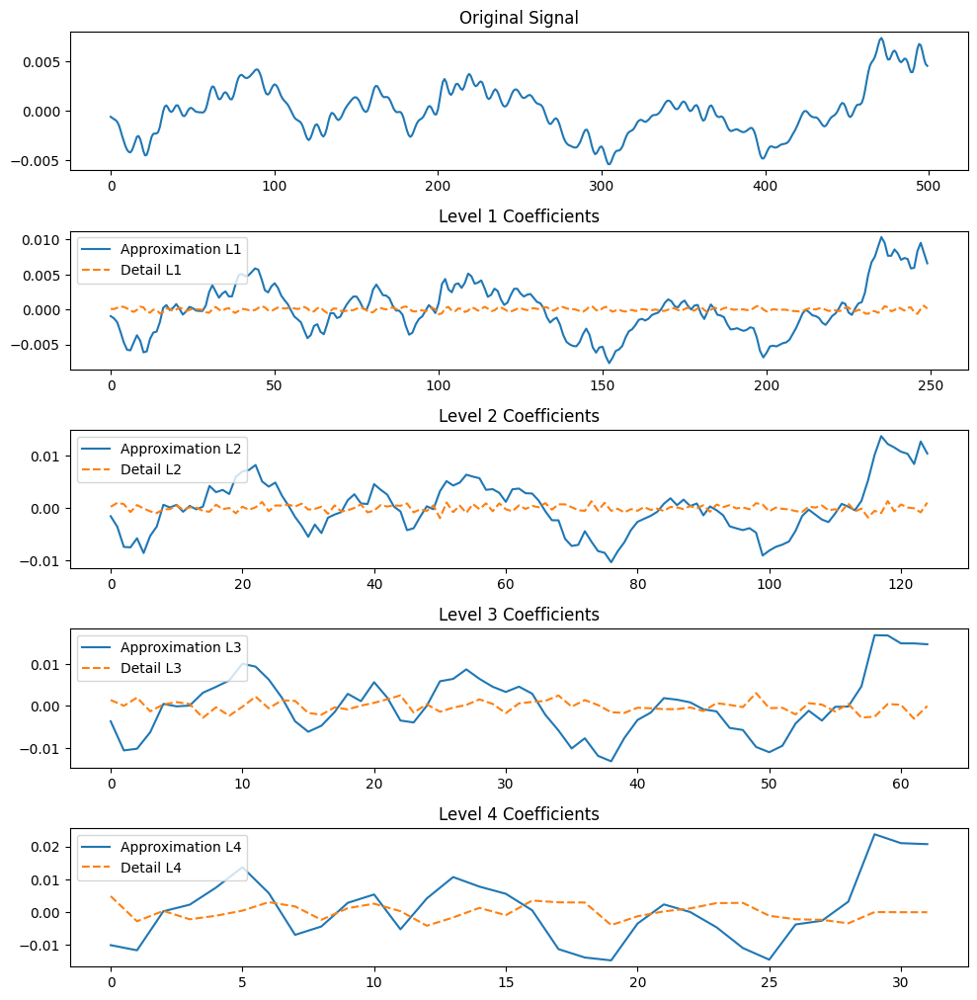

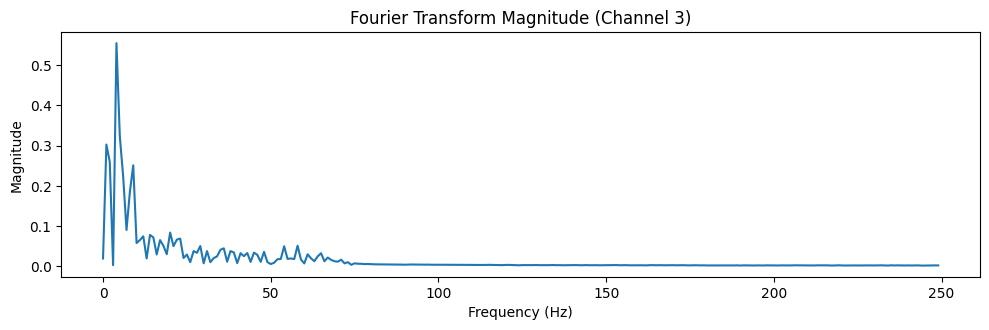

Plotting Channel 4


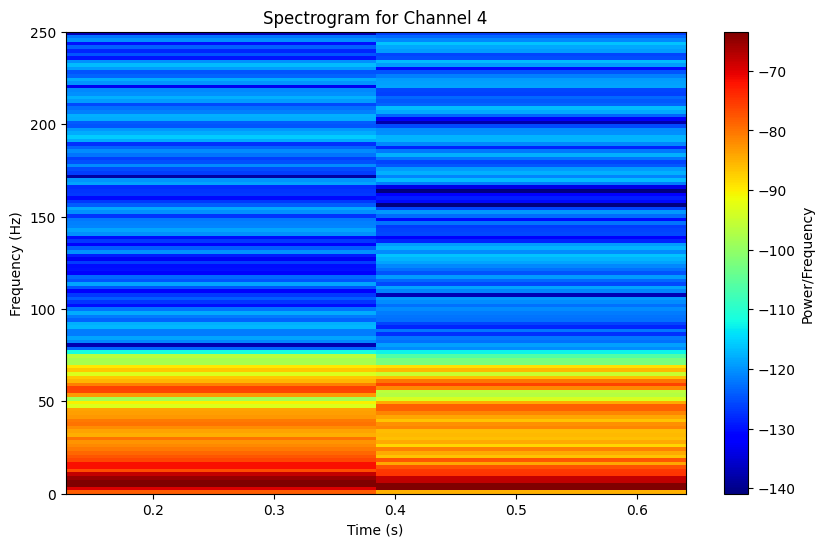

Most similar coefficient to the original signal (Channel 4): Approximation L1 with similarity: 0.03808070422190698
Similarity Scores:
Level 1 -> Approximation Similarity: 0.03808070422190698, Detail Similarity: 0.023330576385943564
Level 2 -> Approximation Similarity: -0.17851766688118018, Detail Similarity: 0.021962077147998367
Level 3 -> Approximation Similarity: 0.004539531890343567, Detail Similarity: 0.001794523470933412
Level 4 -> Approximation Similarity: 0.028483562892027463, Detail Similarity: -0.002099396237104904


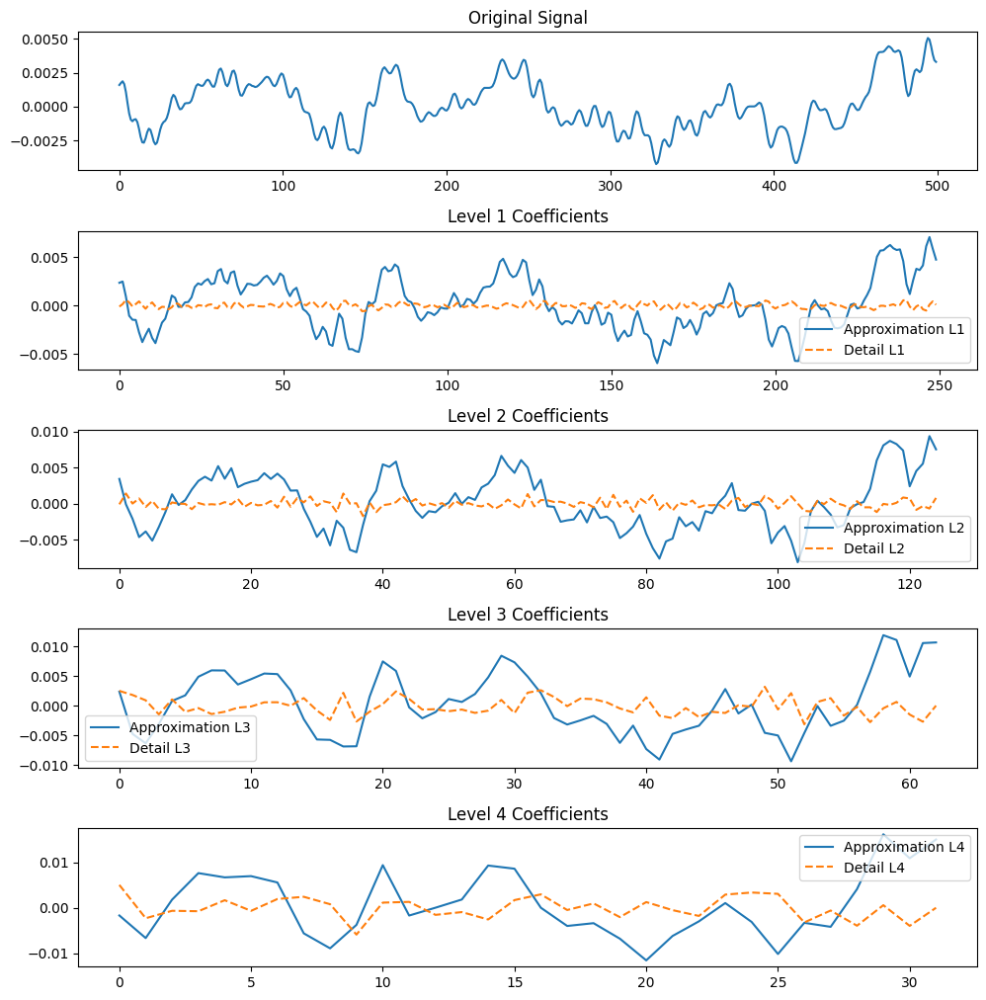

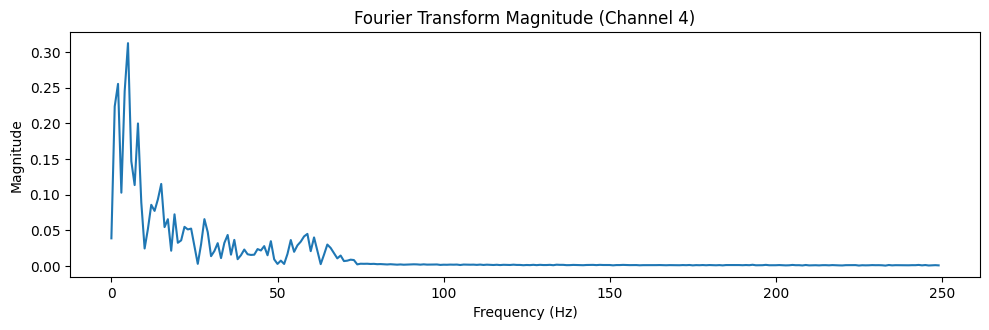

Plotting Channel 5


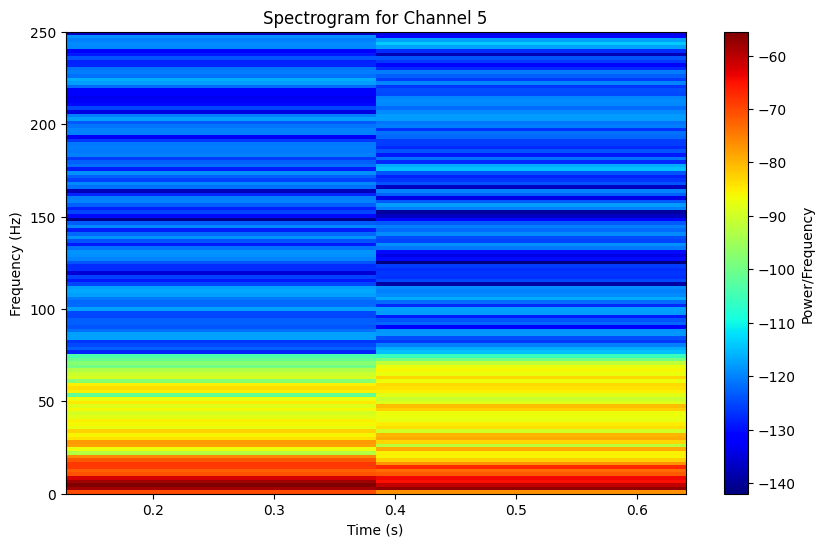

Most similar coefficient to the original signal (Channel 5): Approximation L3 with similarity: 0.029539188464905365
Similarity Scores:
Level 1 -> Approximation Similarity: -0.046037243798476526, Detail Similarity: -0.07850895599718302
Level 2 -> Approximation Similarity: -0.08800058327742233, Detail Similarity: 0.020100163609463966
Level 3 -> Approximation Similarity: 0.029539188464905365, Detail Similarity: 0.013672864435099595
Level 4 -> Approximation Similarity: 0.005778858943487978, Detail Similarity: -0.00839494558600519


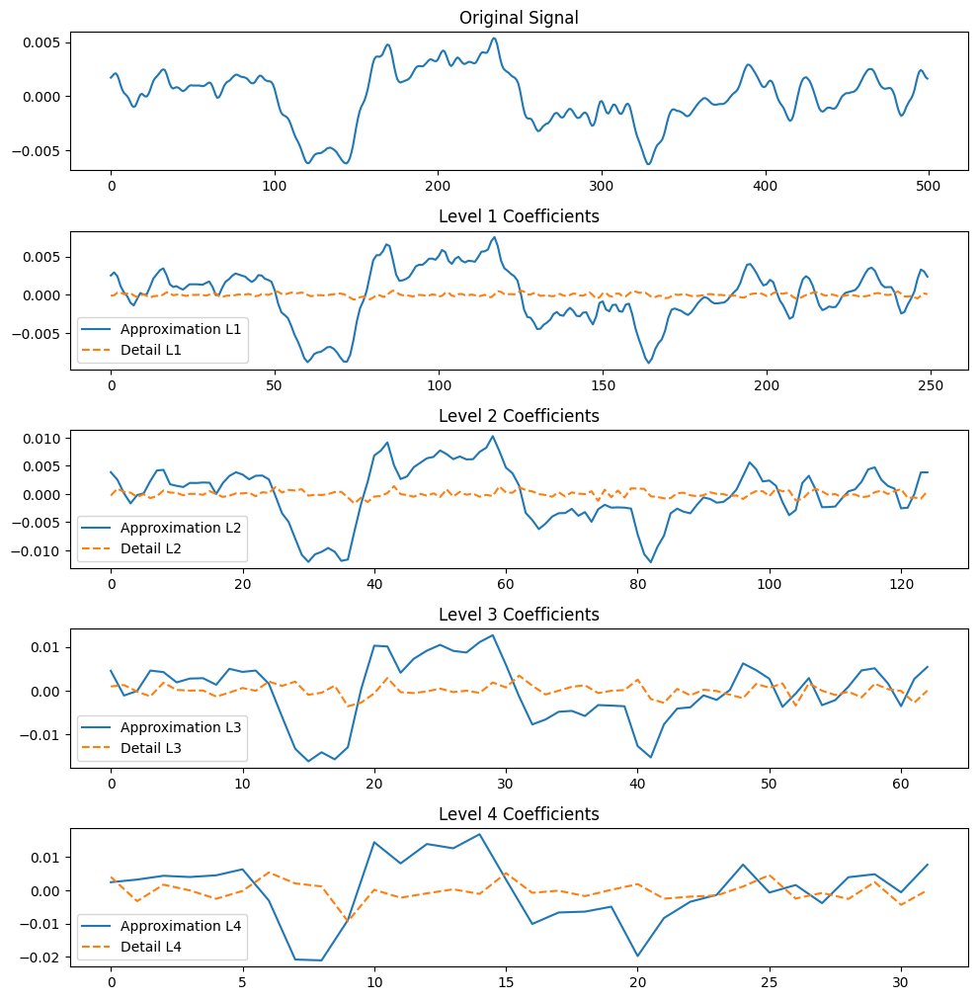

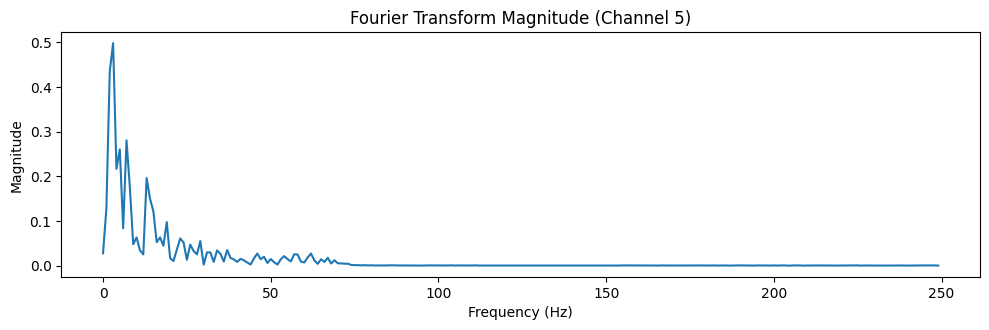

Plotting Channel 6


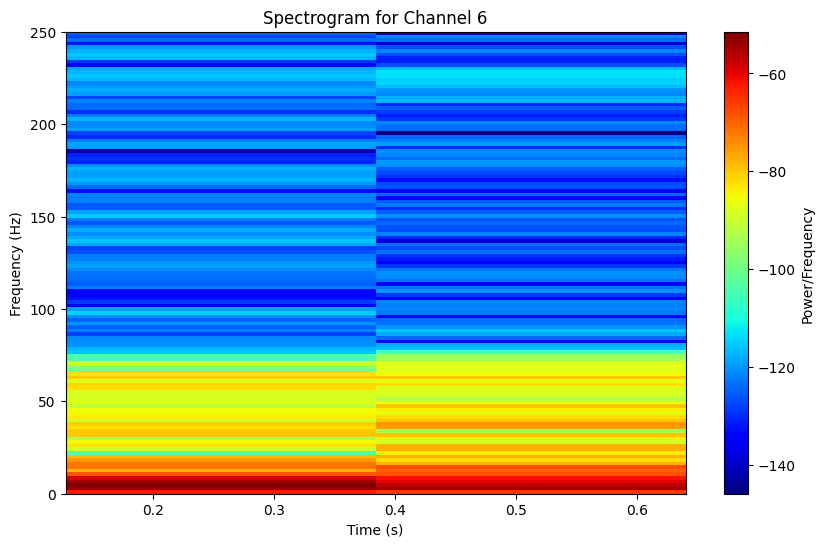

Most similar coefficient to the original signal (Channel 6): Approximation L3 with similarity: 0.04235806070526122
Similarity Scores:
Level 1 -> Approximation Similarity: -0.0912747578636673, Detail Similarity: -0.11538729446257918
Level 2 -> Approximation Similarity: -0.057936819827940154, Detail Similarity: 0.02729153543961937
Level 3 -> Approximation Similarity: 0.04235806070526122, Detail Similarity: 0.009773396596235827
Level 4 -> Approximation Similarity: -0.0316052221077165, Detail Similarity: -0.005340538634205269


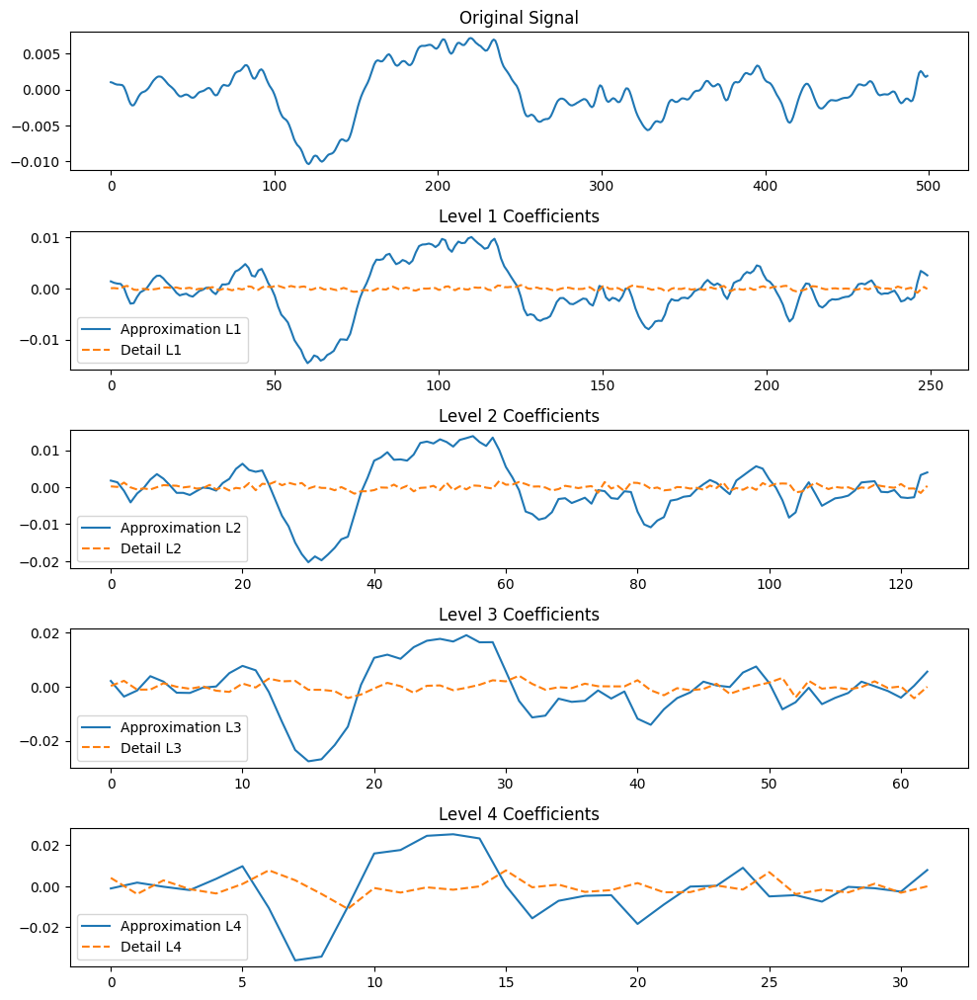

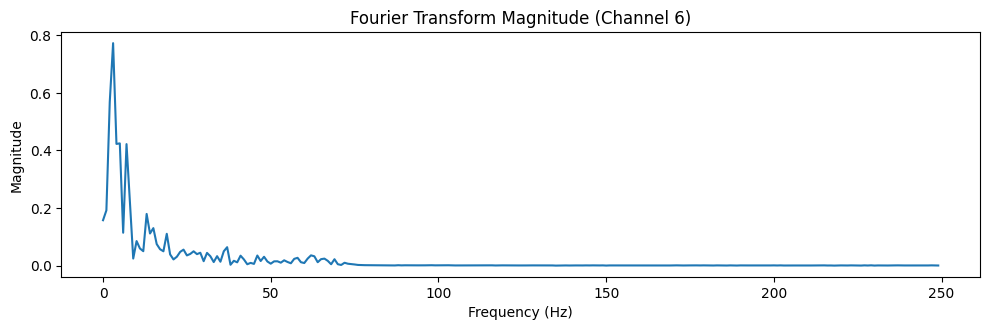

Plotting Channel 7


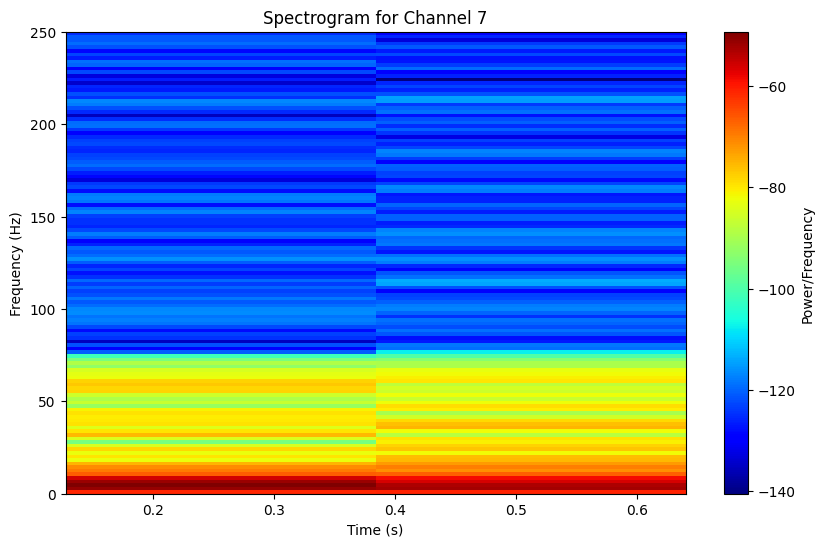

Most similar coefficient to the original signal (Channel 7): Detail L2 with similarity: 0.045790664757059577
Similarity Scores:
Level 1 -> Approximation Similarity: -0.12055852563163776, Detail Similarity: -0.15506393858179843
Level 2 -> Approximation Similarity: -0.027458826761841002, Detail Similarity: 0.045790664757059577
Level 3 -> Approximation Similarity: 0.03213812397039637, Detail Similarity: 0.005104543230507322
Level 4 -> Approximation Similarity: -0.01045273057460807, Detail Similarity: 0.006441575340780736


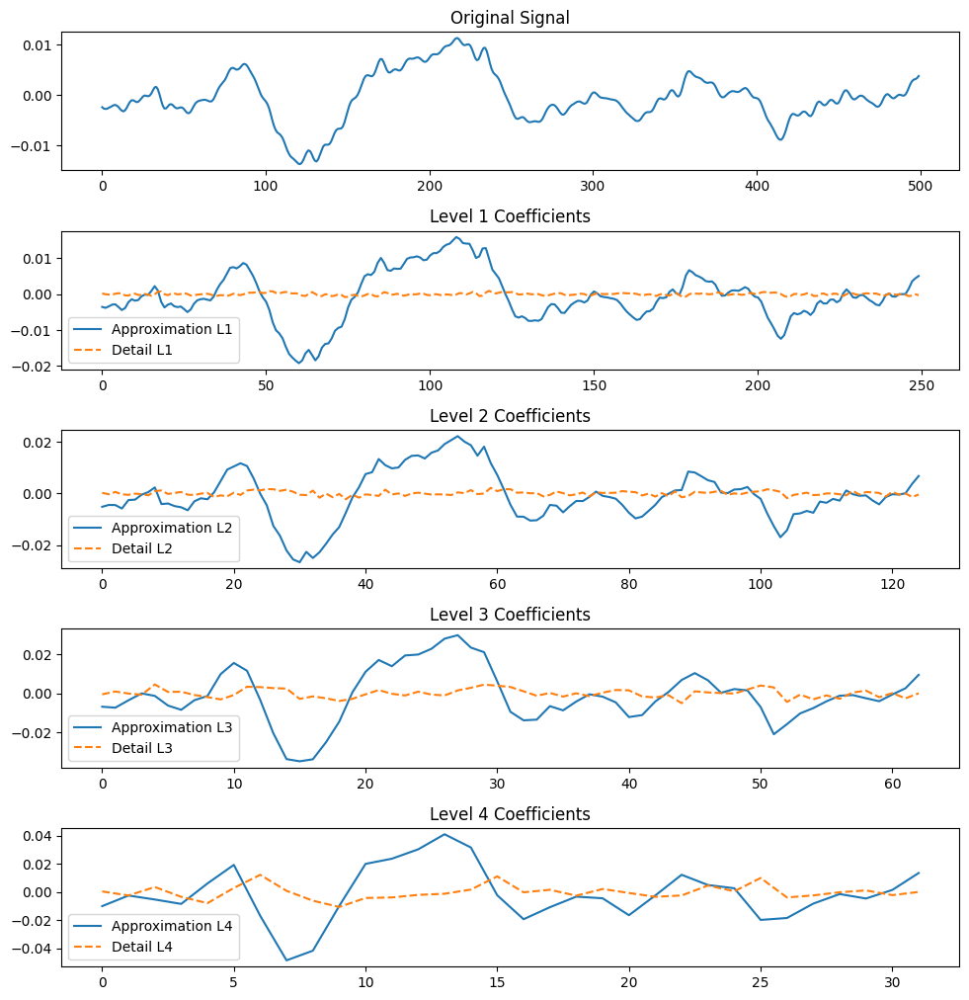

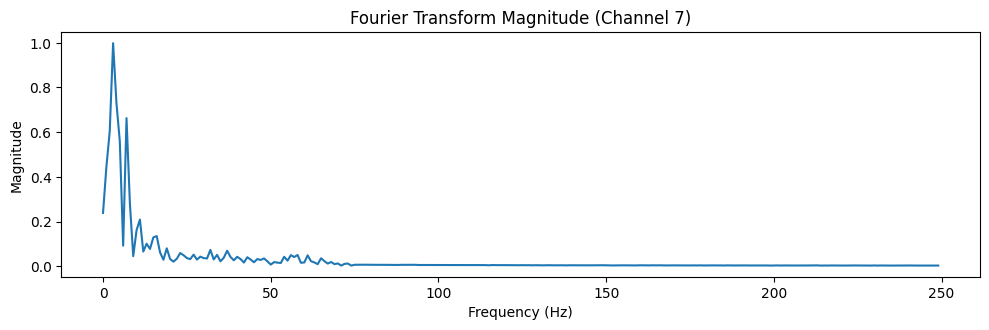

Plotting Channel 8


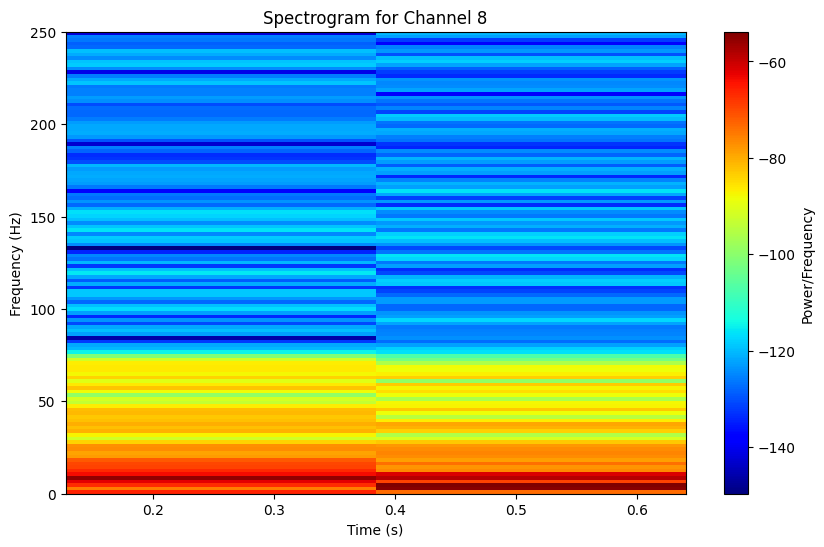

Most similar coefficient to the original signal (Channel 8): Approximation L3 with similarity: 0.05530189804703983
Similarity Scores:
Level 1 -> Approximation Similarity: -0.1726191194387046, Detail Similarity: -0.0914100125991726
Level 2 -> Approximation Similarity: -0.1513307282187646, Detail Similarity: -0.015808863936209436
Level 3 -> Approximation Similarity: 0.05530189804703983, Detail Similarity: 0.03842853755946747
Level 4 -> Approximation Similarity: -0.022518498146524492, Detail Similarity: -0.005238165405087122


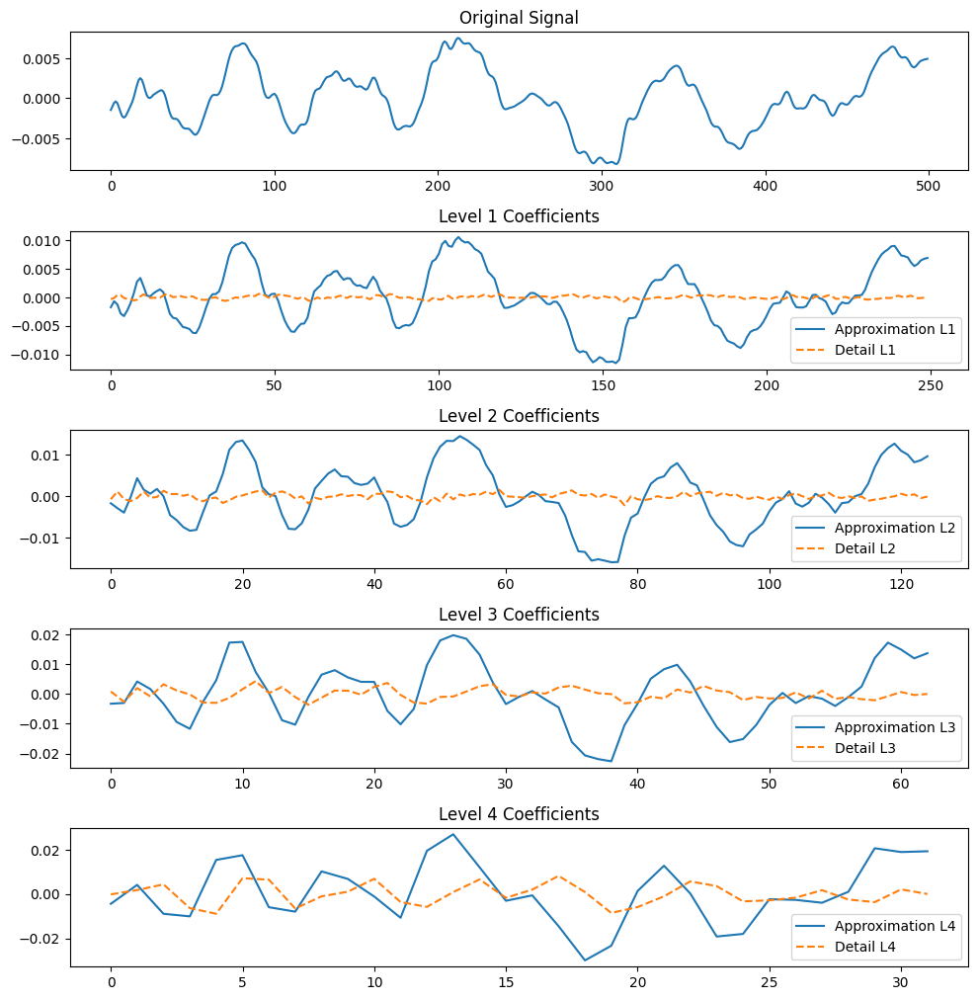

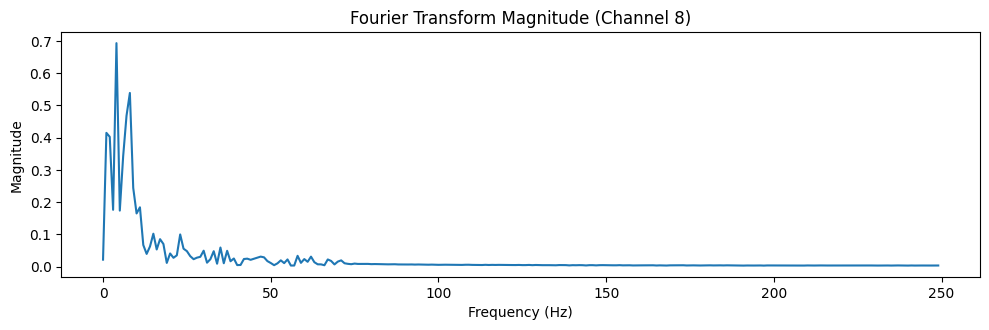

Plotting Channel 9


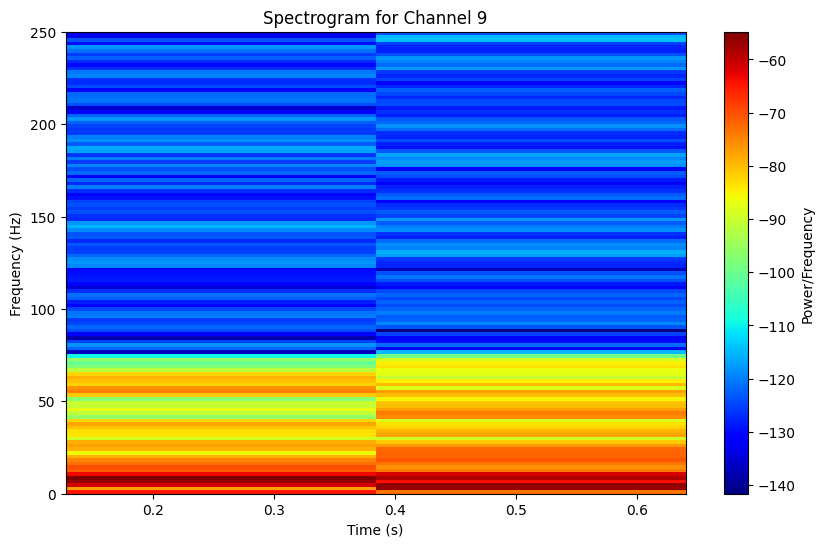

Most similar coefficient to the original signal (Channel 9): Approximation L3 with similarity: 0.06474642177649721
Similarity Scores:
Level 1 -> Approximation Similarity: -0.13924347529220568, Detail Similarity: -0.0941699887758931
Level 2 -> Approximation Similarity: -0.1786514798856186, Detail Similarity: 0.0077541130919061094
Level 3 -> Approximation Similarity: 0.06474642177649721, Detail Similarity: 0.01076894513928247
Level 4 -> Approximation Similarity: -0.017351329882619487, Detail Similarity: -0.0003154643981911846


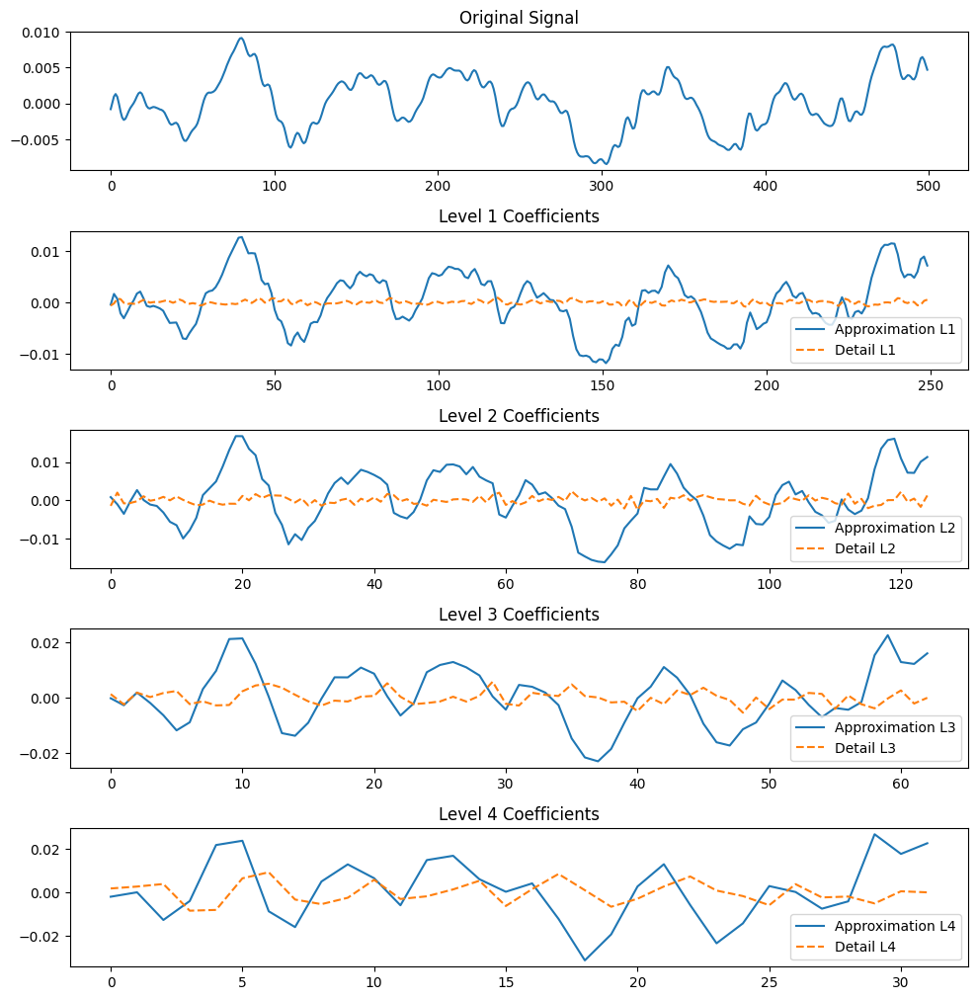

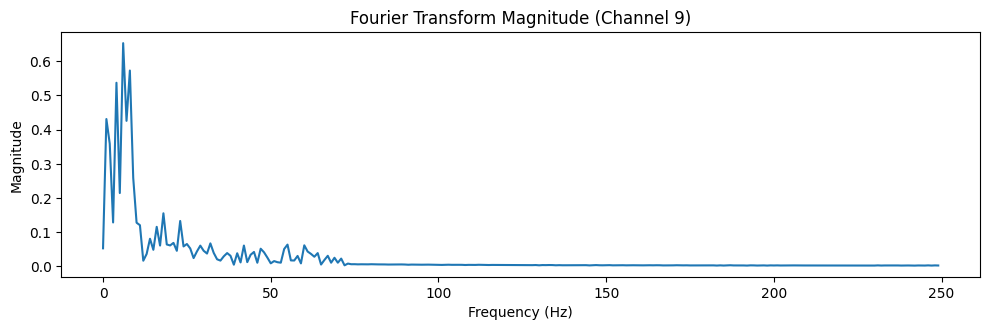

Plotting Channel 10


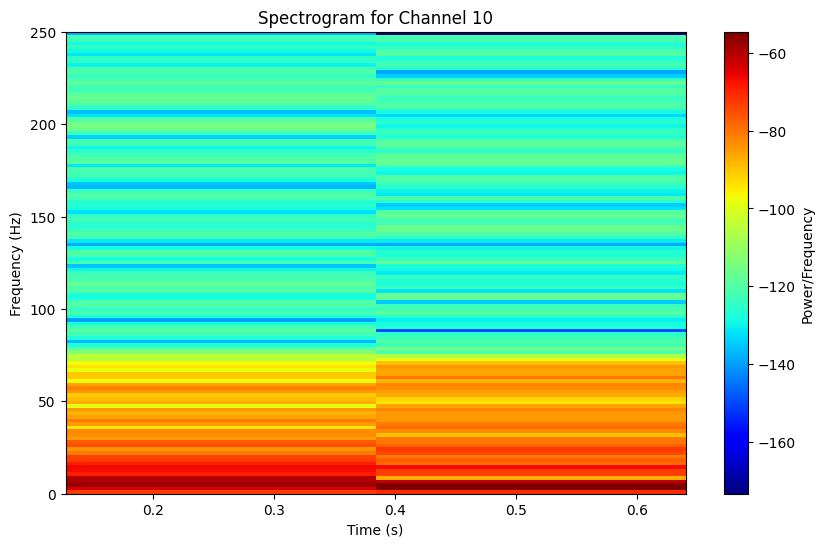

Most similar coefficient to the original signal (Channel 10): Approximation L3 with similarity: 0.041676699777077136
Similarity Scores:
Level 1 -> Approximation Similarity: 0.01228036629485965, Detail Similarity: -0.1373410741010409
Level 2 -> Approximation Similarity: -0.20843035082544692, Detail Similarity: 0.02196193686021074
Level 3 -> Approximation Similarity: 0.041676699777077136, Detail Similarity: -0.004307399104660612
Level 4 -> Approximation Similarity: 0.03192430412694262, Detail Similarity: -0.010497531210443644


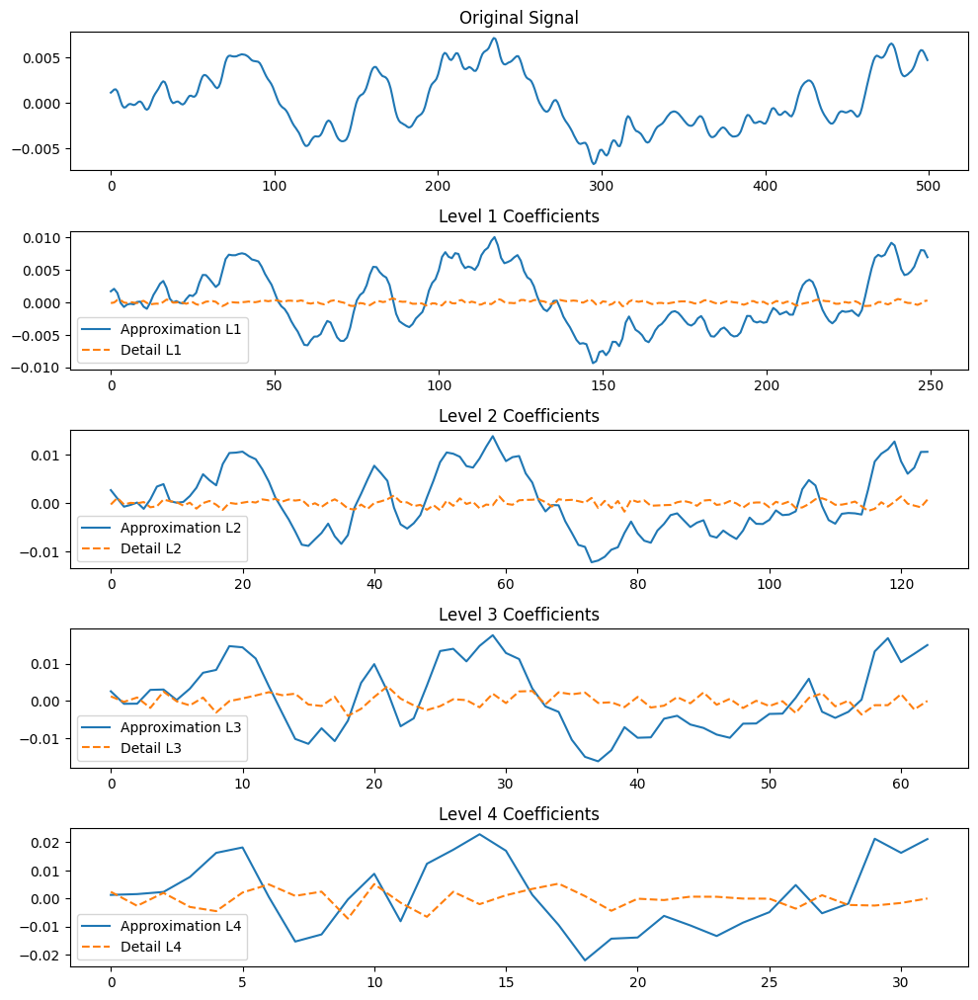

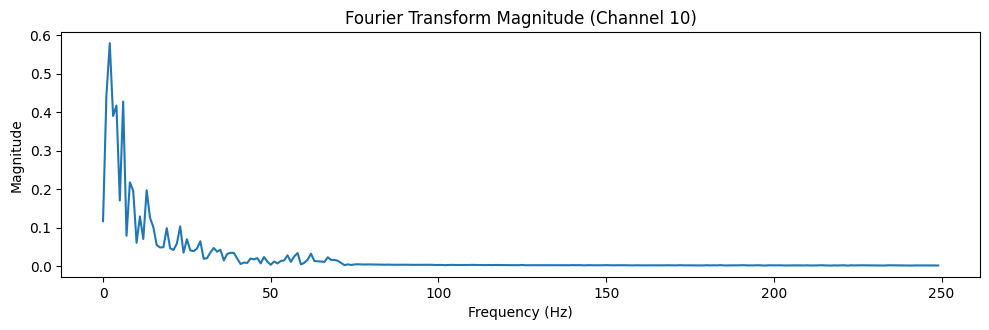

Plotting Channel 11


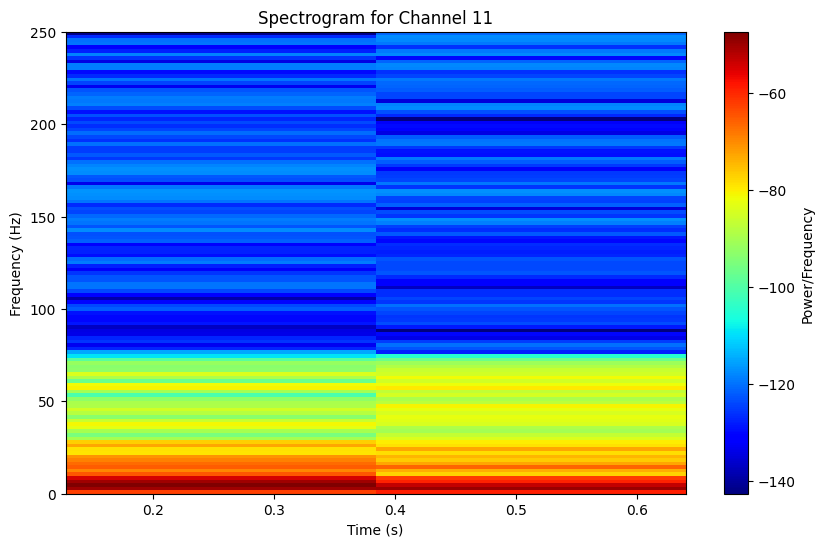

Most similar coefficient to the original signal (Channel 11): Detail L2 with similarity: 0.01879234103000506
Similarity Scores:
Level 1 -> Approximation Similarity: -0.10868671001573242, Detail Similarity: -0.15526038231421344
Level 2 -> Approximation Similarity: -0.050357244499962754, Detail Similarity: 0.01879234103000506
Level 3 -> Approximation Similarity: 0.016316458202181455, Detail Similarity: -0.004950050162343498
Level 4 -> Approximation Similarity: -0.011574585439191067, Detail Similarity: 0.003493541869292488


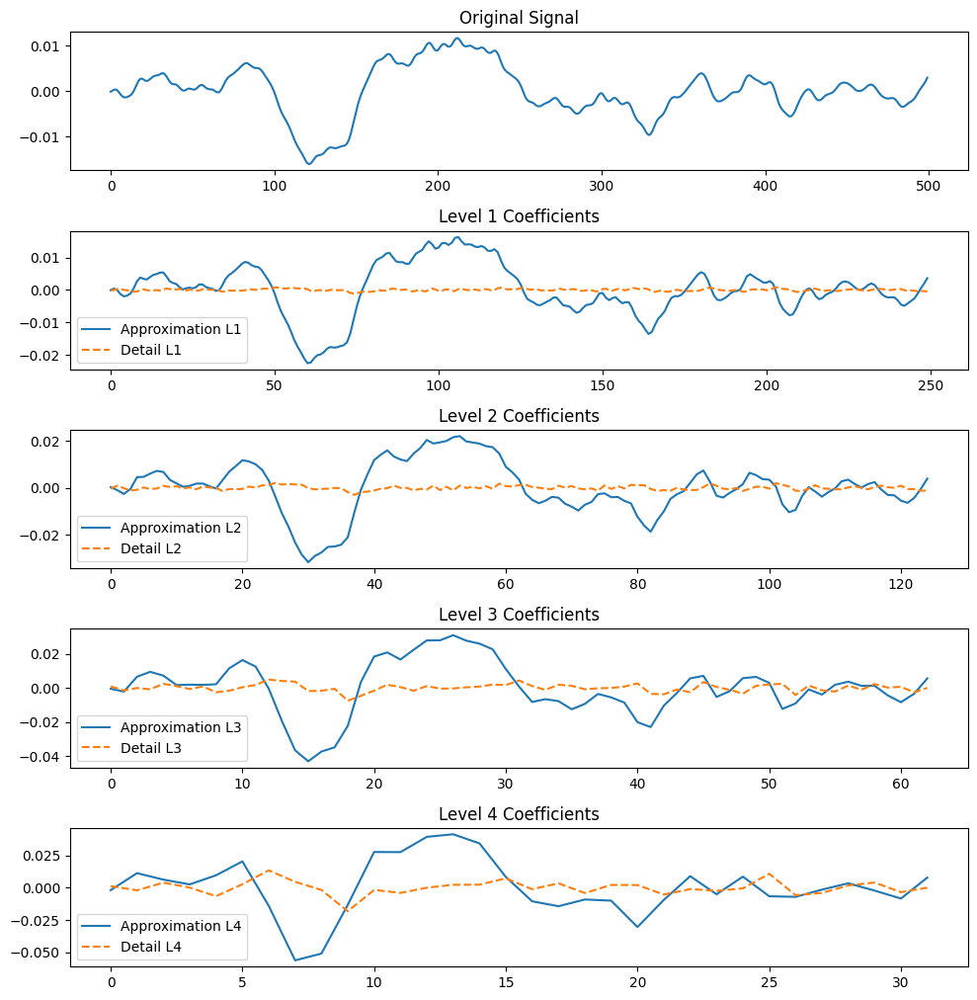

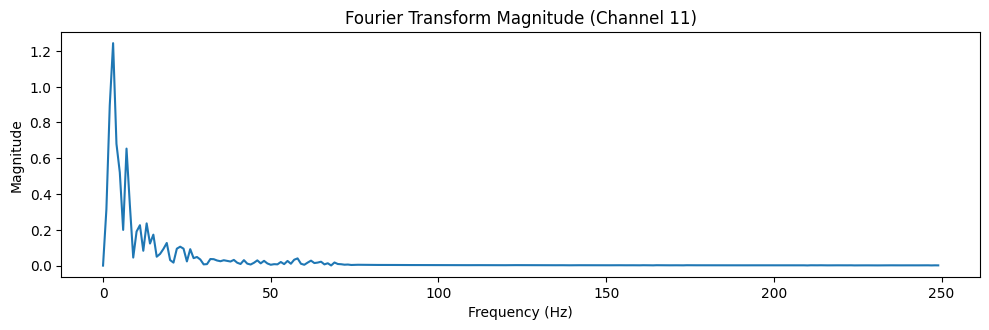

Plotting Channel 12


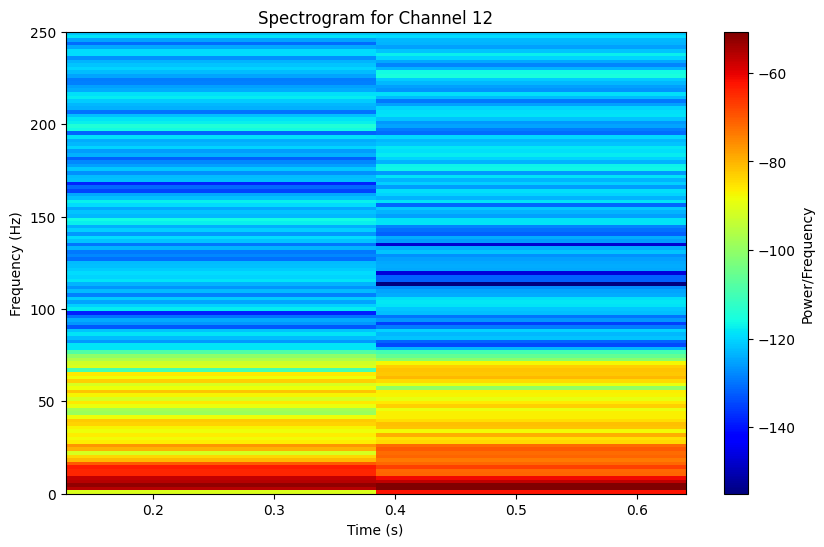

Most similar coefficient to the original signal (Channel 12): Detail L2 with similarity: 0.03040222666702528
Similarity Scores:
Level 1 -> Approximation Similarity: -0.07583344107249532, Detail Similarity: -0.1450695874153339
Level 2 -> Approximation Similarity: -0.055622186947315584, Detail Similarity: 0.03040222666702528
Level 3 -> Approximation Similarity: 0.027555823498079838, Detail Similarity: 0.008031791340191947
Level 4 -> Approximation Similarity: -0.008560742119544097, Detail Similarity: 0.008489395832133867


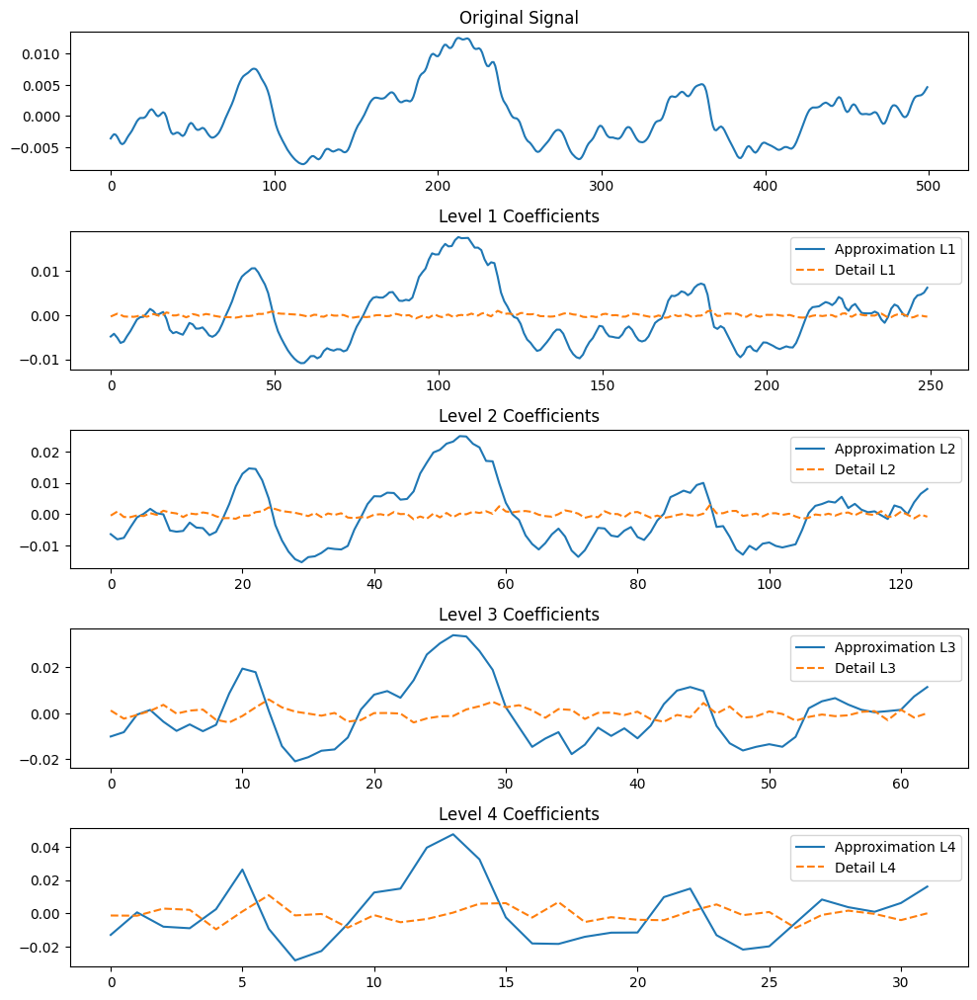

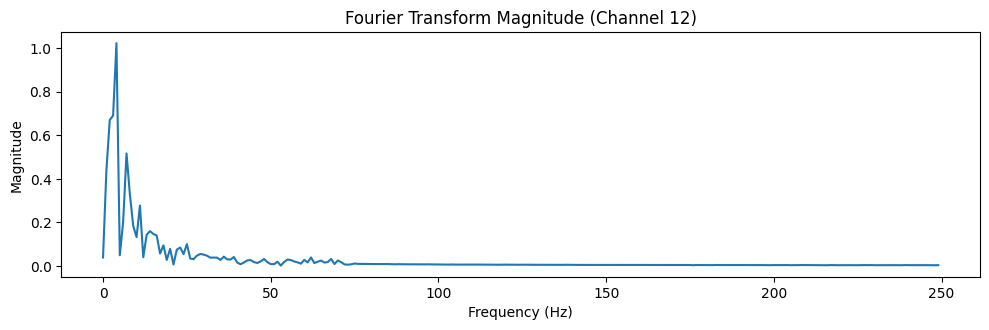

Plotting Channel 13


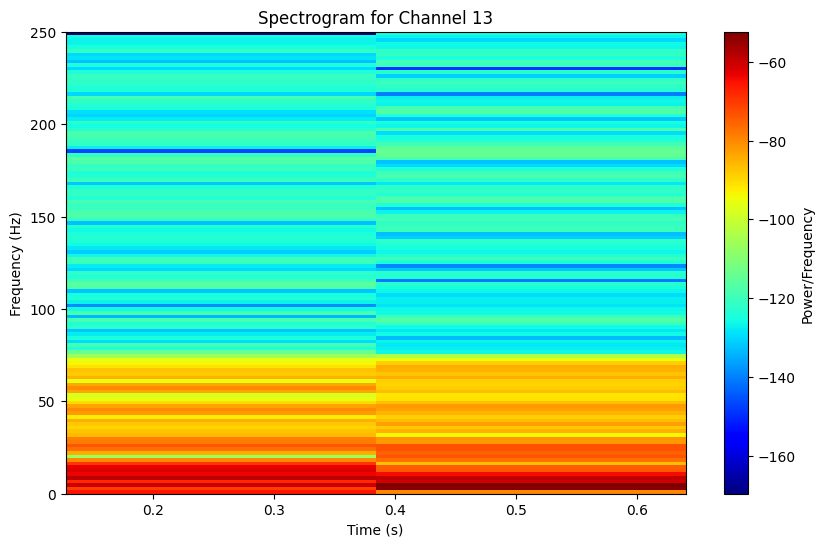

Most similar coefficient to the original signal (Channel 13): Approximation L3 with similarity: 0.03887465973225823
Similarity Scores:
Level 1 -> Approximation Similarity: -0.18442625450970349, Detail Similarity: -0.10857388775521903
Level 2 -> Approximation Similarity: -0.07741353067981349, Detail Similarity: 0.010157219437544208
Level 3 -> Approximation Similarity: 0.03887465973225823, Detail Similarity: 0.026094655618615504
Level 4 -> Approximation Similarity: -0.02186601656684723, Detail Similarity: -0.006199352677963166


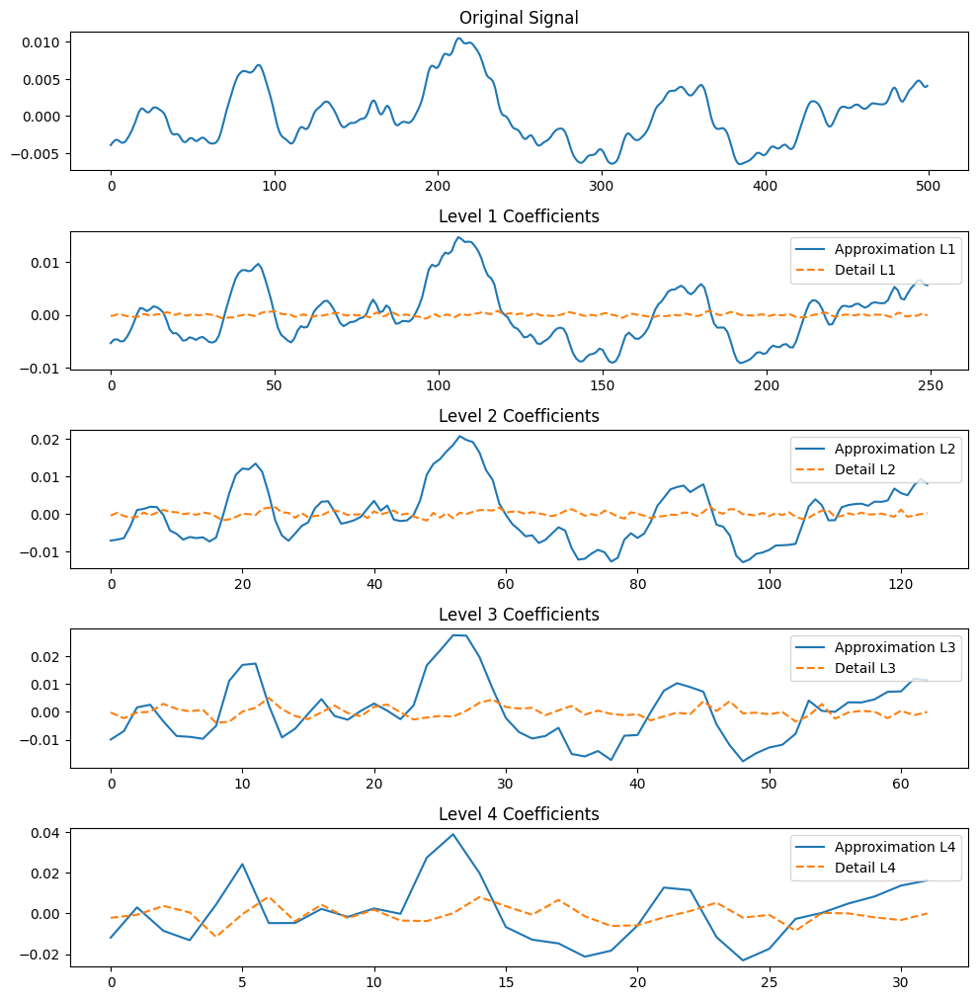

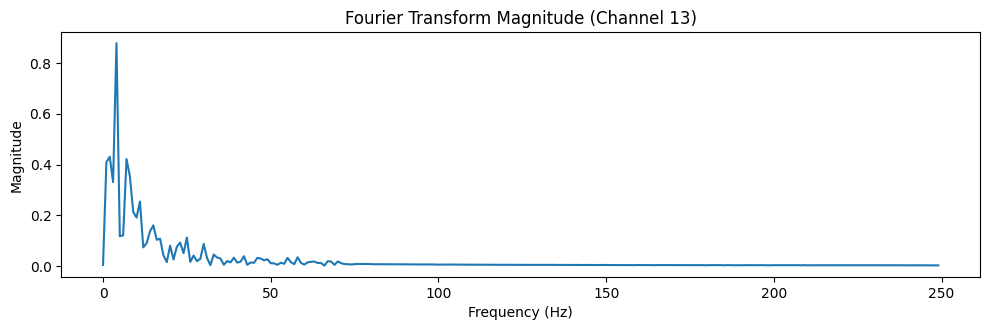

Plotting Channel 14


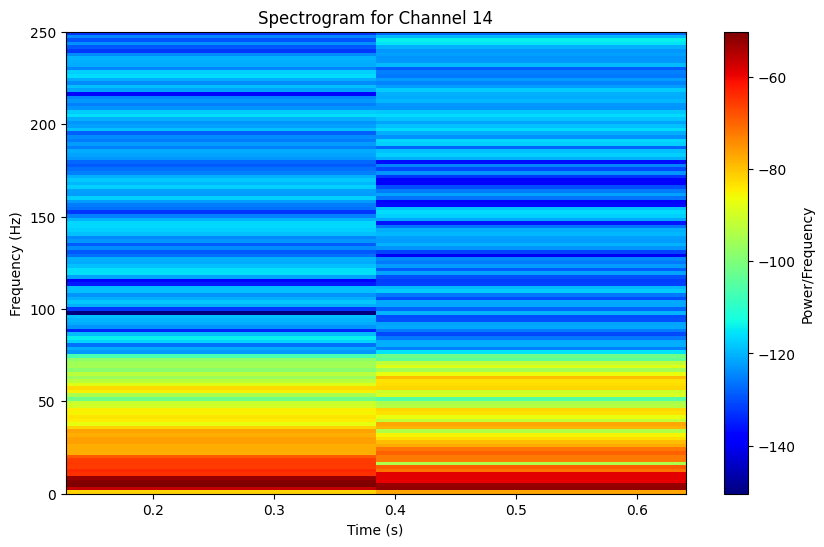

Most similar coefficient to the original signal (Channel 14): Detail L2 with similarity: 0.06285158648178228
Similarity Scores:
Level 1 -> Approximation Similarity: -0.12515285683683697, Detail Similarity: -0.16483149439564537
Level 2 -> Approximation Similarity: -0.17847907234749488, Detail Similarity: 0.06285158648178228
Level 3 -> Approximation Similarity: 0.06276757870642556, Detail Similarity: -0.005464480463942376
Level 4 -> Approximation Similarity: 0.02164180771636451, Detail Similarity: -0.0018024381572449622


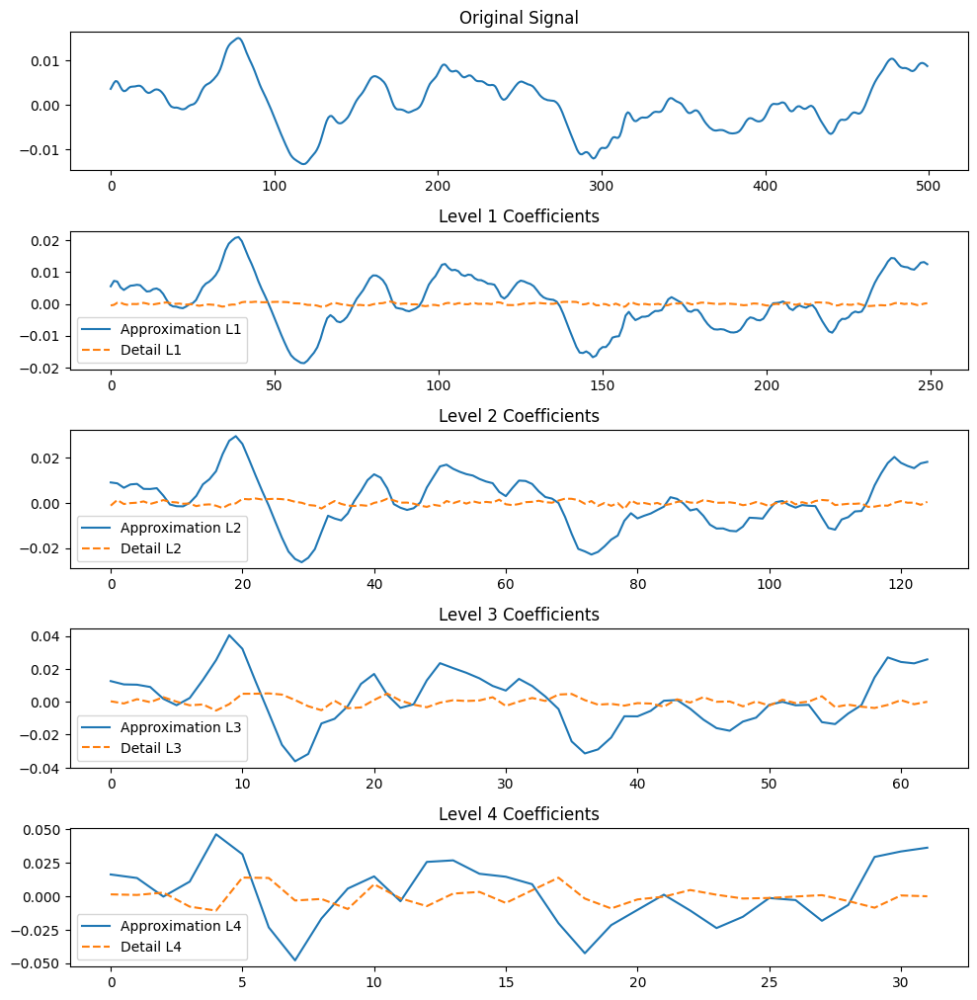

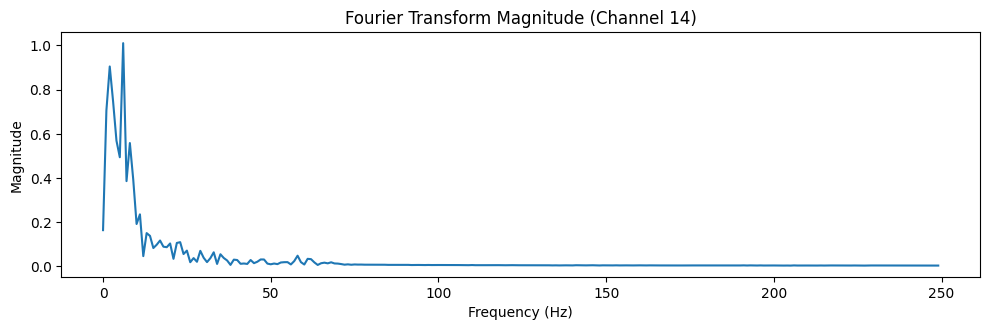

Plotting Channel 15


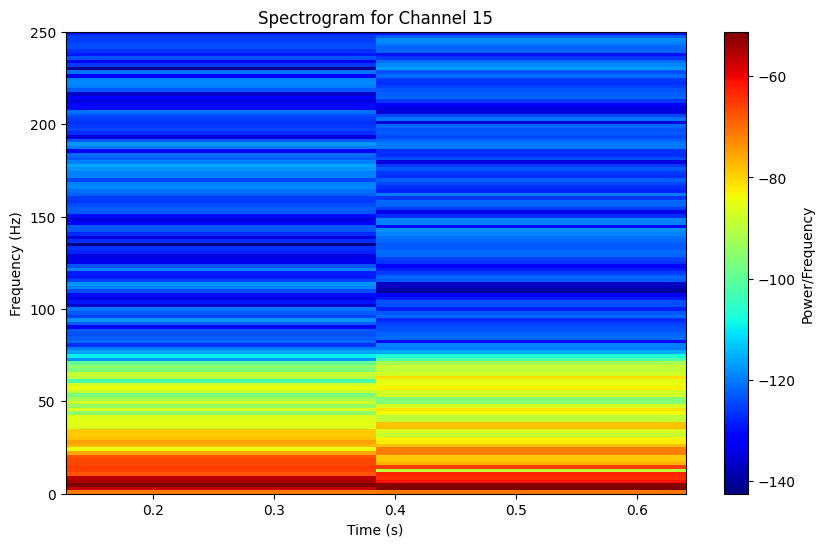

Most similar coefficient to the original signal (Channel 15): Approximation L3 with similarity: 0.05839011438149273
Similarity Scores:
Level 1 -> Approximation Similarity: -0.051758607873451795, Detail Similarity: -0.16282330810117288
Level 2 -> Approximation Similarity: -0.16779077049278793, Detail Similarity: 0.055610502871240294
Level 3 -> Approximation Similarity: 0.05839011438149273, Detail Similarity: -0.008036107938074893
Level 4 -> Approximation Similarity: 0.02191157753327873, Detail Similarity: -0.007986872970260597


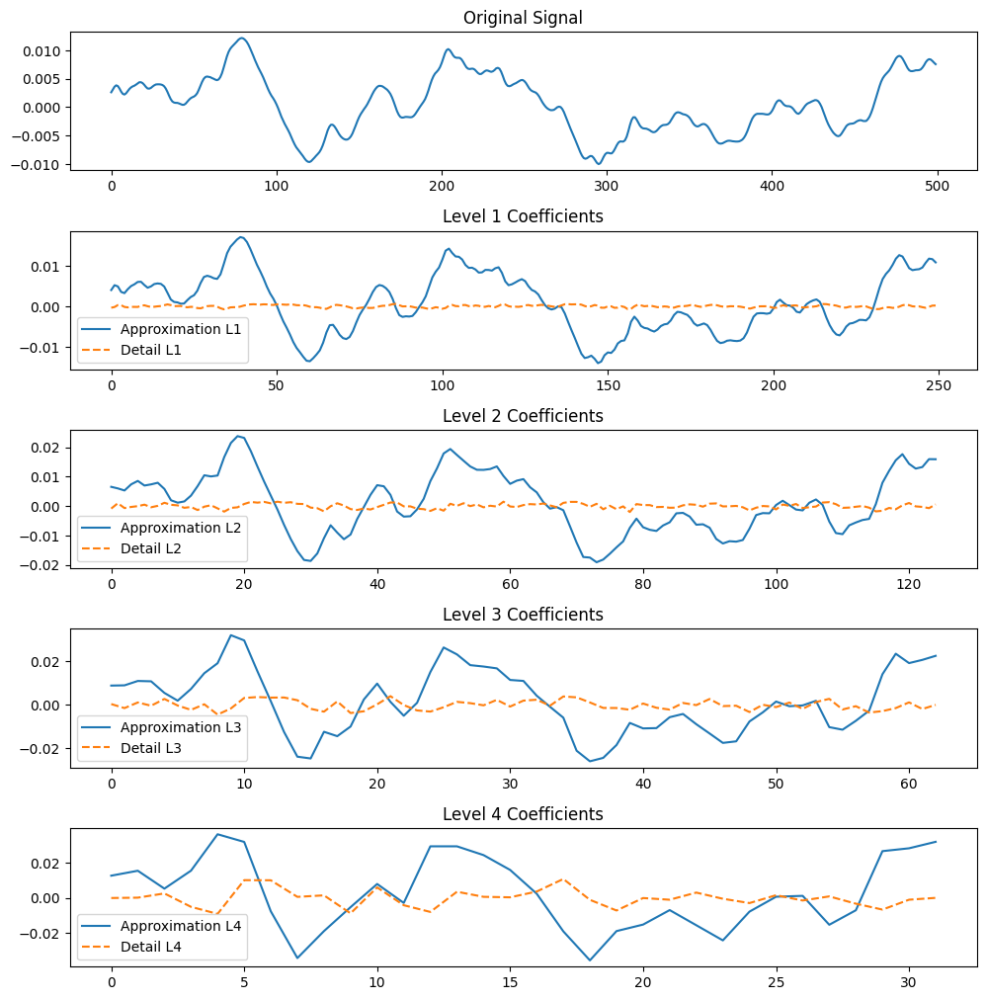

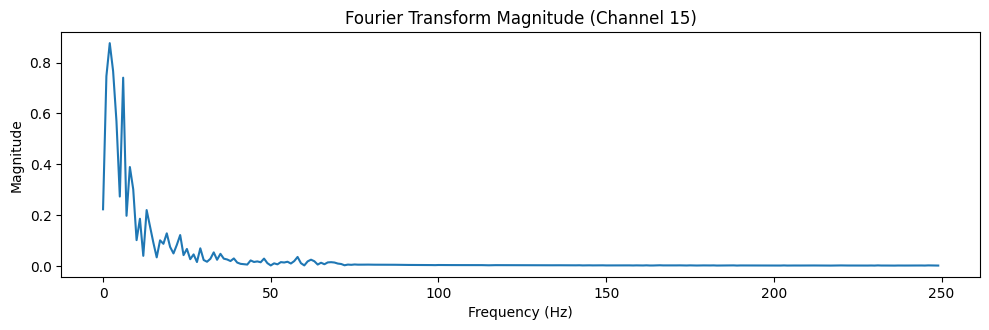

Plotting Channel 16


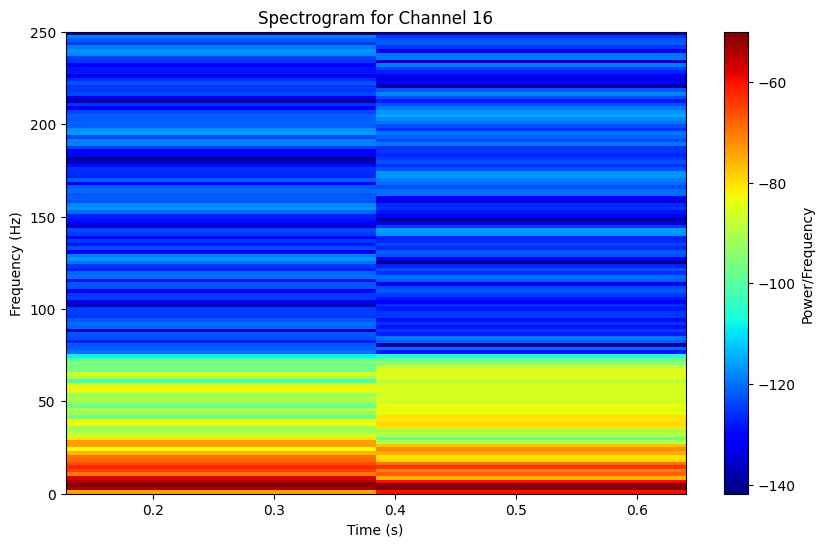

Most similar coefficient to the original signal (Channel 16): Detail L2 with similarity: 0.040836575266982644
Similarity Scores:
Level 1 -> Approximation Similarity: -0.09183337875861612, Detail Similarity: -0.1679762726856448
Level 2 -> Approximation Similarity: -0.04282561764915856, Detail Similarity: 0.040836575266982644
Level 3 -> Approximation Similarity: 0.02588926124287574, Detail Similarity: -0.009006275387768017
Level 4 -> Approximation Similarity: -0.016649878774388113, Detail Similarity: -0.0030220316172432215


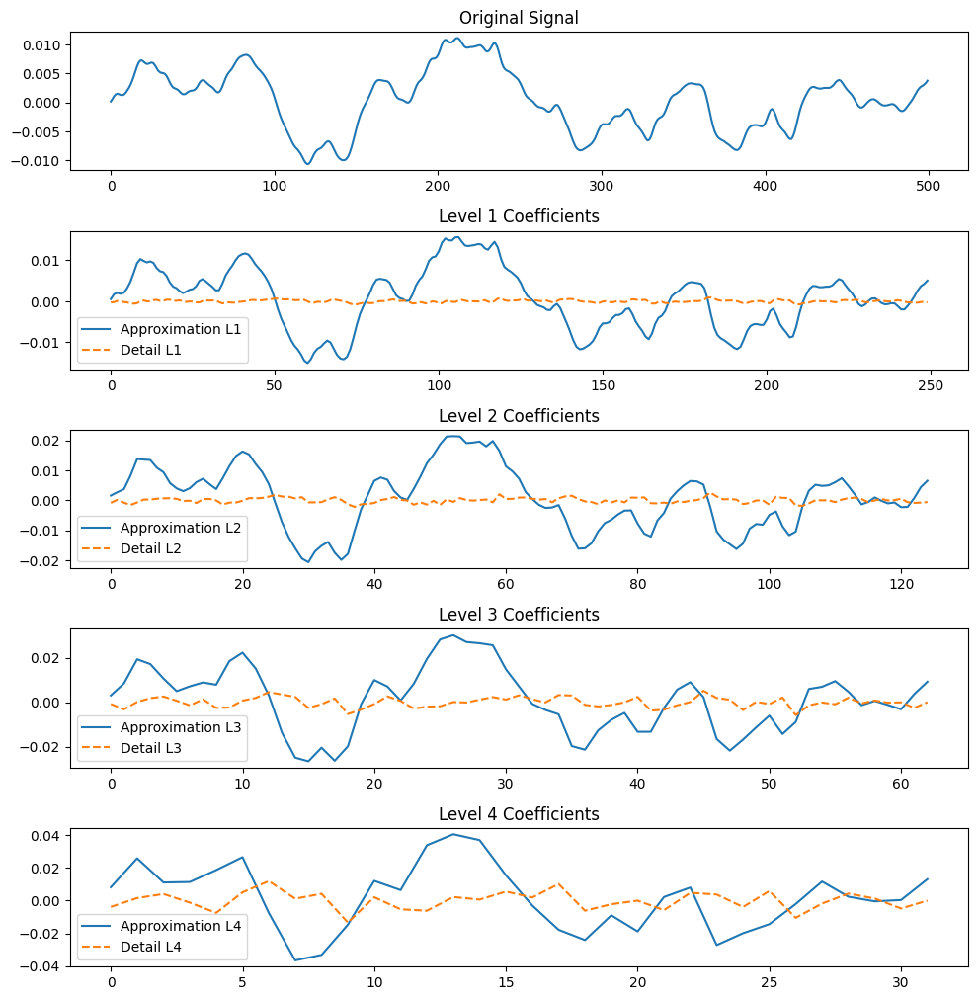

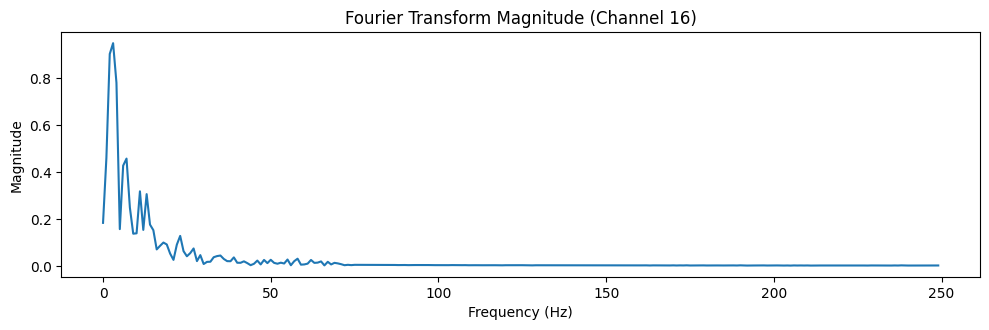

Plotting Channel 17


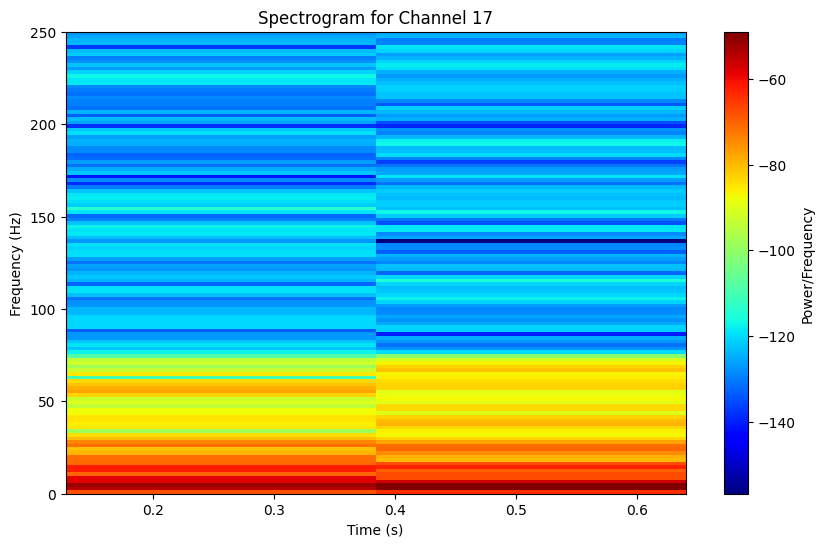

Most similar coefficient to the original signal (Channel 17): Detail L2 with similarity: 0.01565781321173672
Similarity Scores:
Level 1 -> Approximation Similarity: -0.14277093445325204, Detail Similarity: -0.17398072605353182
Level 2 -> Approximation Similarity: -0.08799690693927115, Detail Similarity: 0.01565781321173672
Level 3 -> Approximation Similarity: 0.007724717012735955, Detail Similarity: -0.00754856439874002
Level 4 -> Approximation Similarity: -0.014668295612944835, Detail Similarity: -0.0017809660119294723


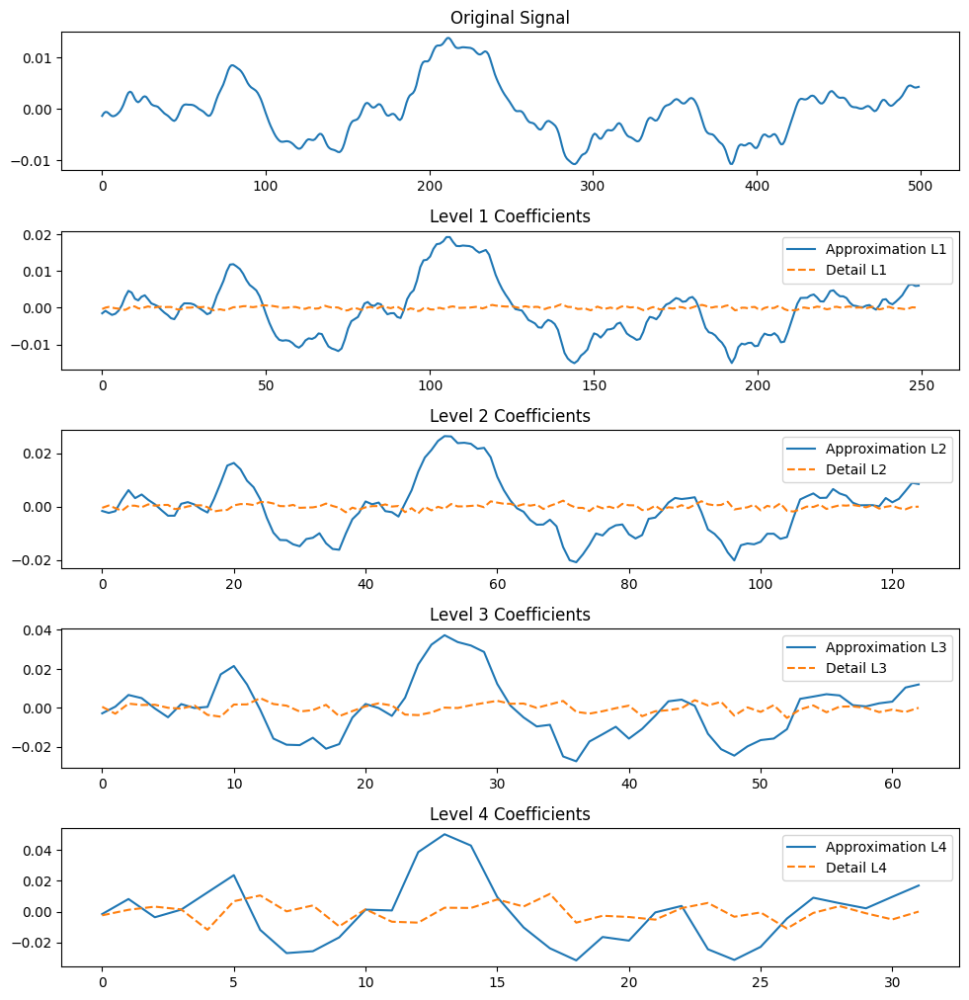

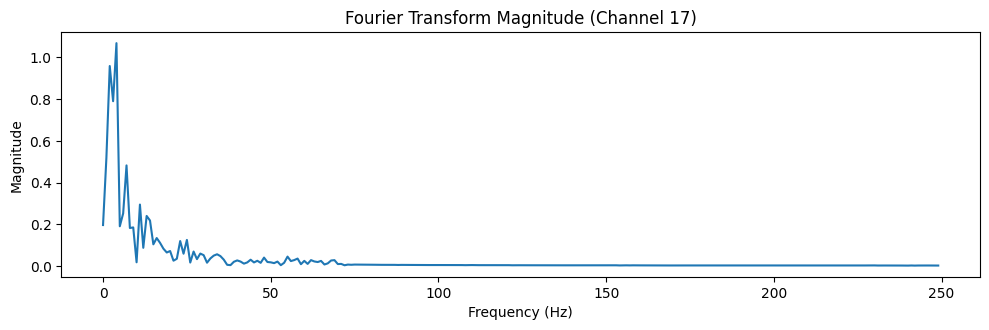

Plotting Channel 18


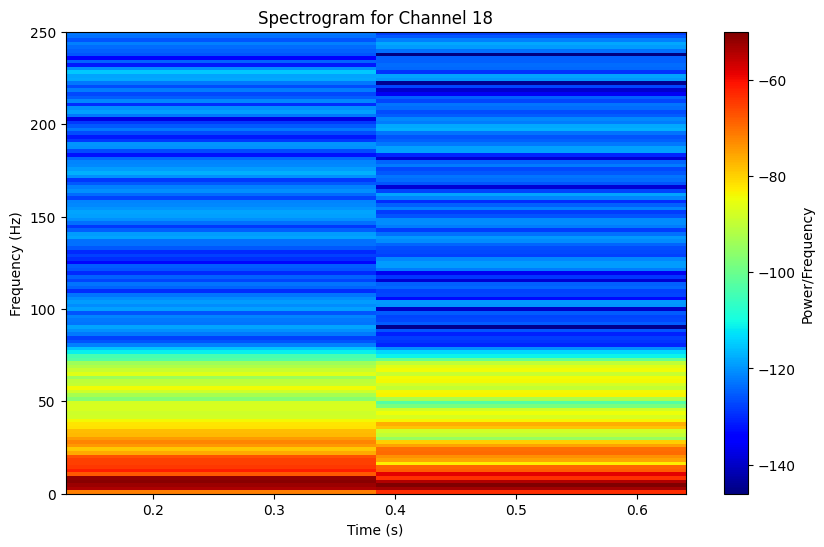

Most similar coefficient to the original signal (Channel 18): Approximation L1 with similarity: 0.11049866007599056
Similarity Scores:
Level 1 -> Approximation Similarity: 0.11049866007599056, Detail Similarity: -0.09643566650642157
Level 2 -> Approximation Similarity: -0.06739473408716613, Detail Similarity: 0.0421708017614178
Level 3 -> Approximation Similarity: 0.05467349697945926, Detail Similarity: 0.0012832763381239592
Level 4 -> Approximation Similarity: 0.024810326376994114, Detail Similarity: -0.007421690757918983


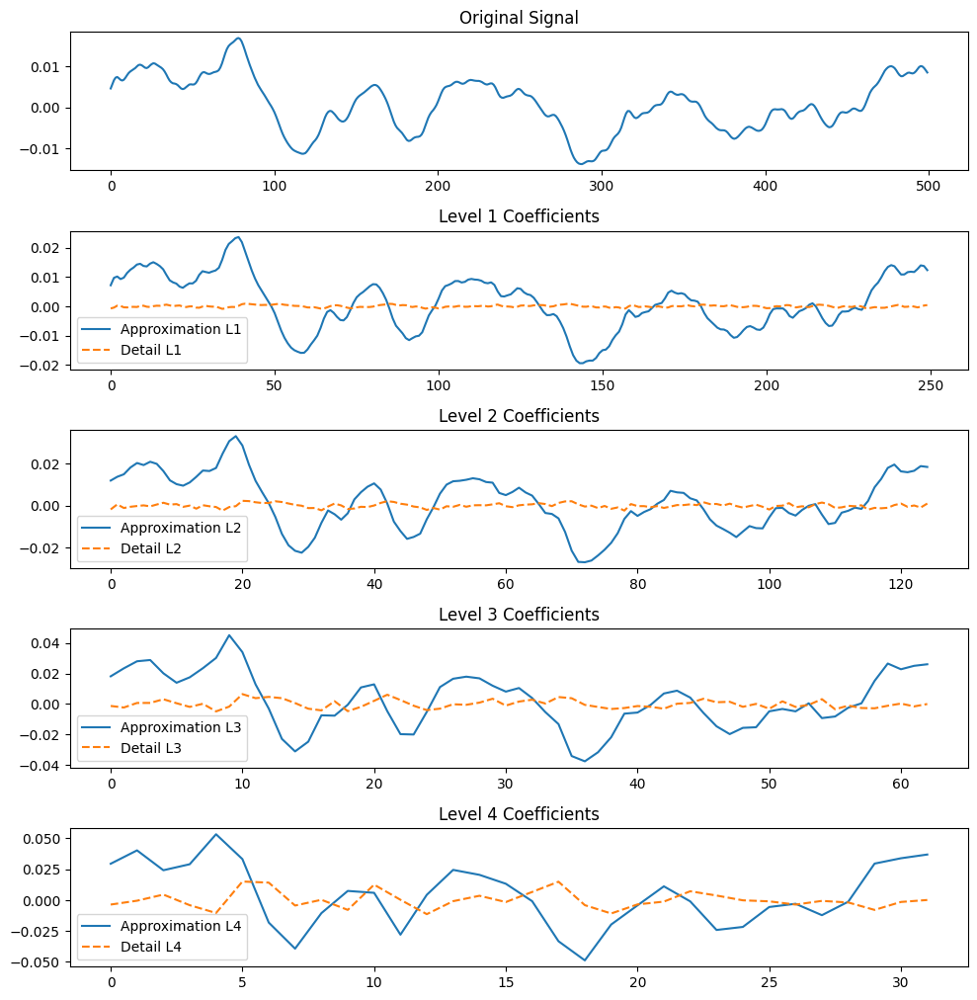

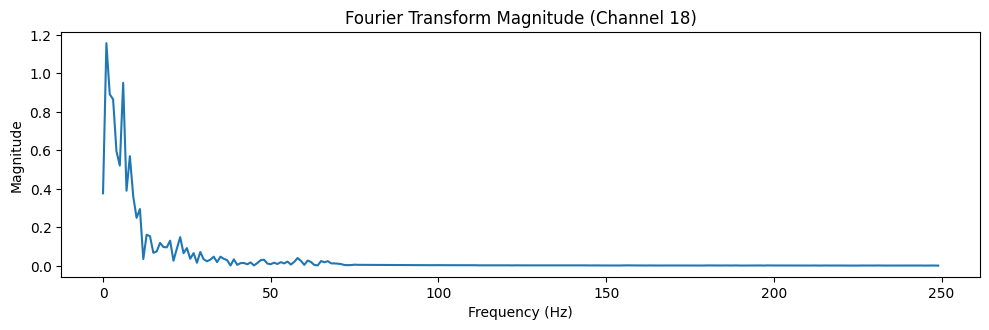

Plotting Channel 19


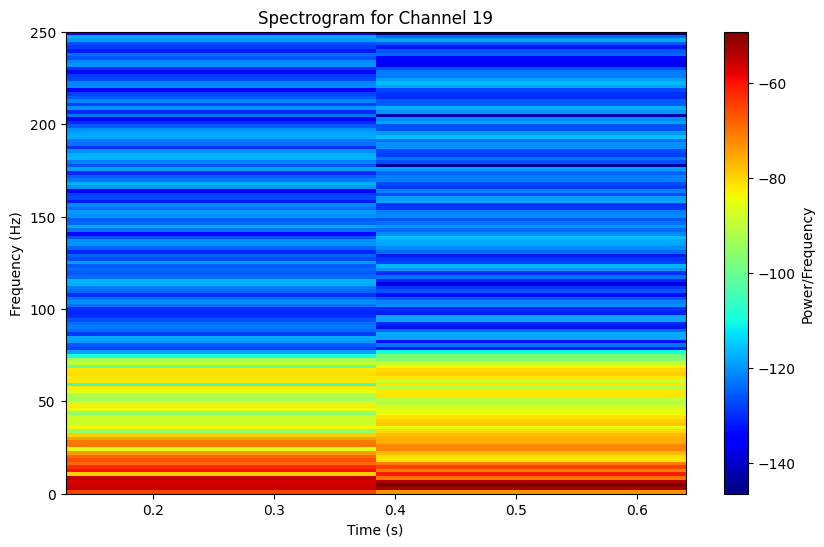

Most similar coefficient to the original signal (Channel 19): Approximation L1 with similarity: 0.12439477460157693
Similarity Scores:
Level 1 -> Approximation Similarity: 0.12439477460157693, Detail Similarity: -0.0765740657101385
Level 2 -> Approximation Similarity: -0.03800975972793024, Detail Similarity: 0.005113751478127432
Level 3 -> Approximation Similarity: 0.031355408772661734, Detail Similarity: 0.01071097511440735
Level 4 -> Approximation Similarity: -0.010133495373426718, Detail Similarity: -0.0007196417838620813


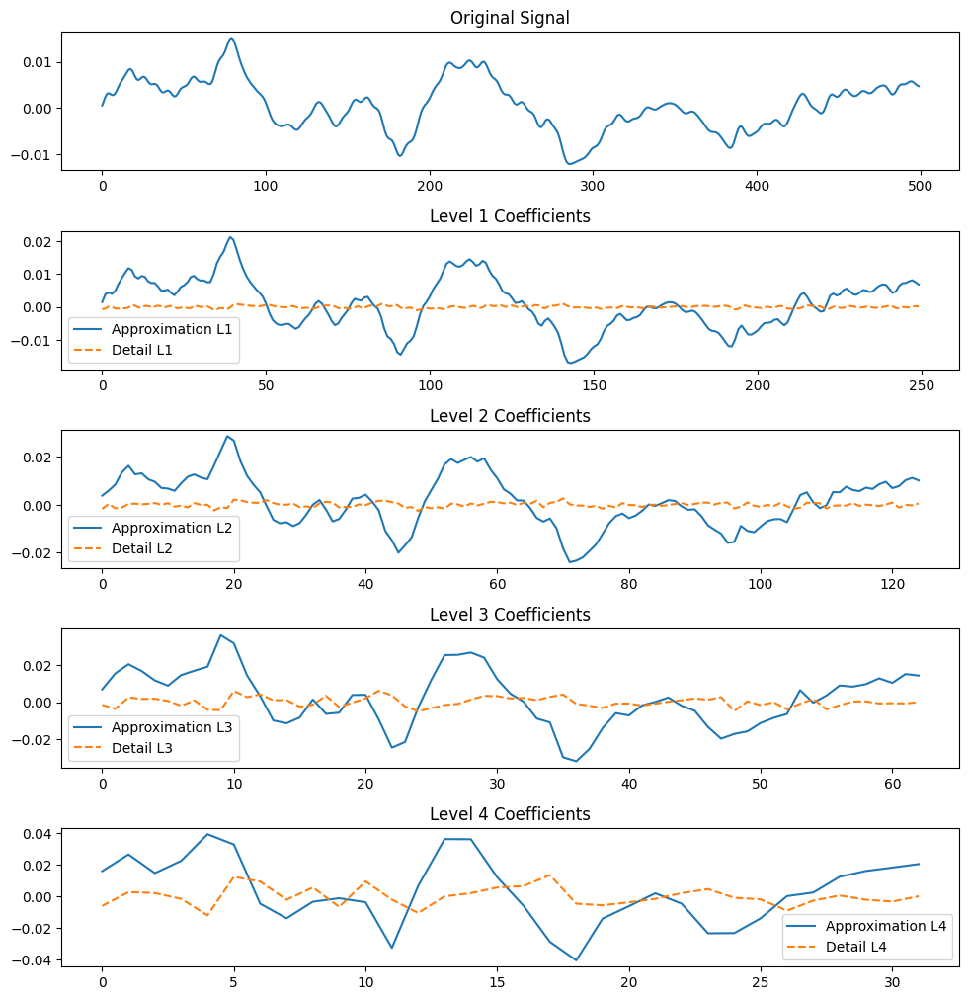

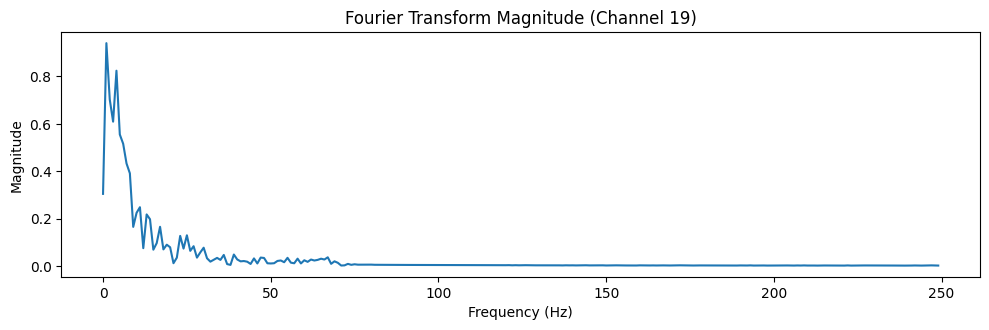

Features saved to Normal_features.csv


In [24]:
print("Normal Data Analysis")
normal_features = analyze_data(normal_dataset, "Normal")

Complex Partial Seizures Analysis
Analyzing Complex_Partial_Seizures: 2694
Plotting Channel 1


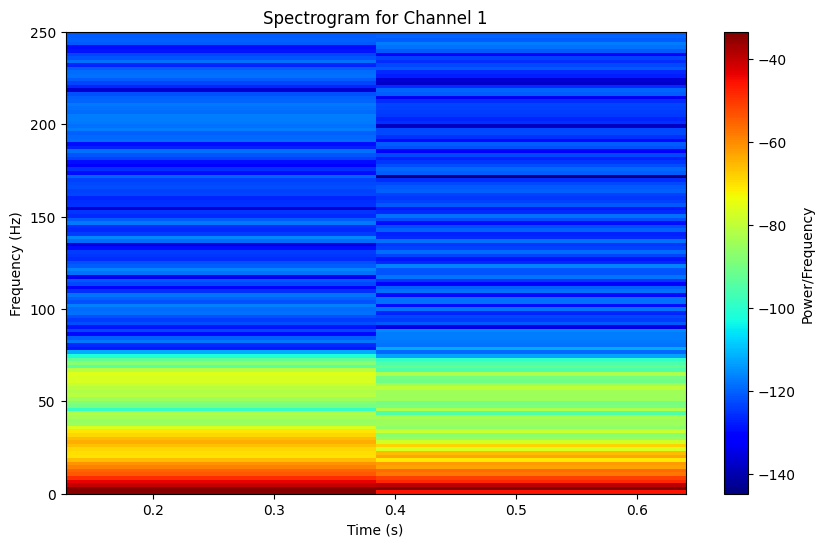

Most similar coefficient to the original signal (Channel 1): Detail L1 with similarity: 0.04403785404240116
Similarity Scores:
Level 1 -> Approximation Similarity: -0.23340959164642214, Detail Similarity: 0.04403785404240116
Level 2 -> Approximation Similarity: -0.004995917860131003, Detail Similarity: 0.01065720396967305
Level 3 -> Approximation Similarity: -0.009706377361055616, Detail Similarity: -0.002421236345581467
Level 4 -> Approximation Similarity: -0.005276295693897489, Detail Similarity: -0.00012563343799063123


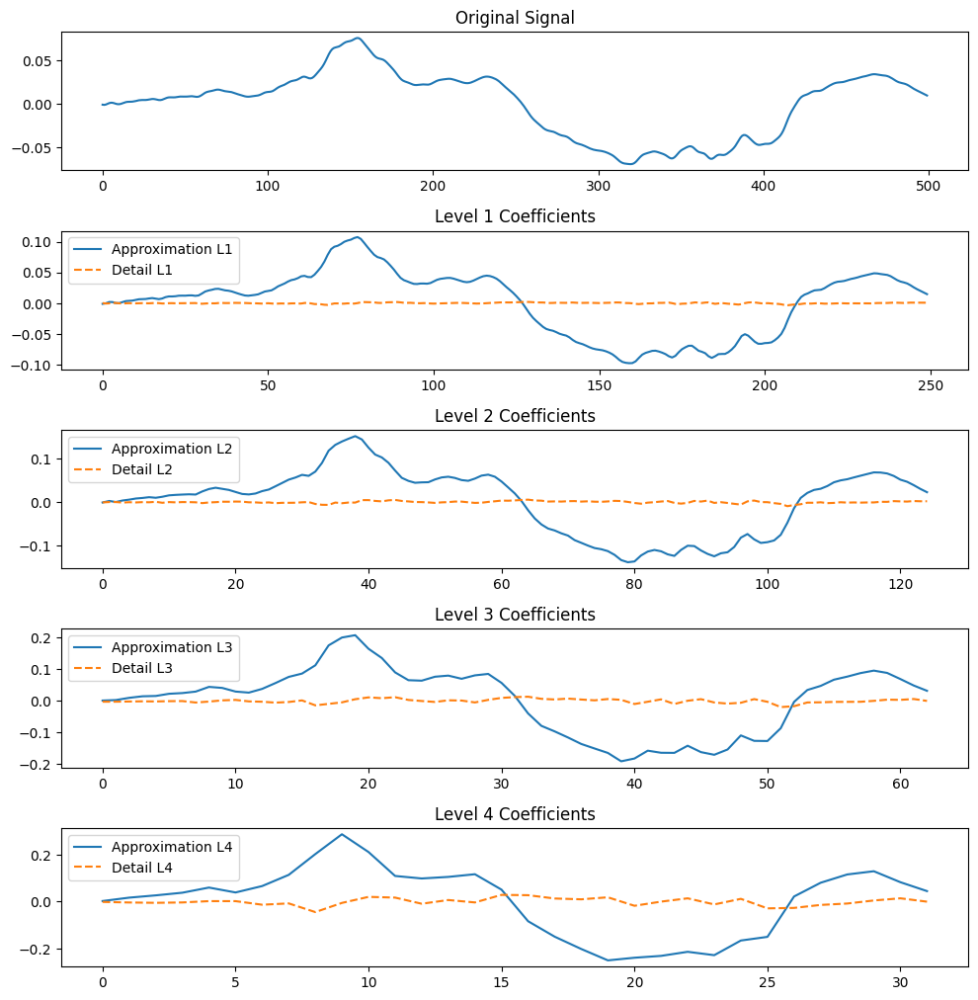

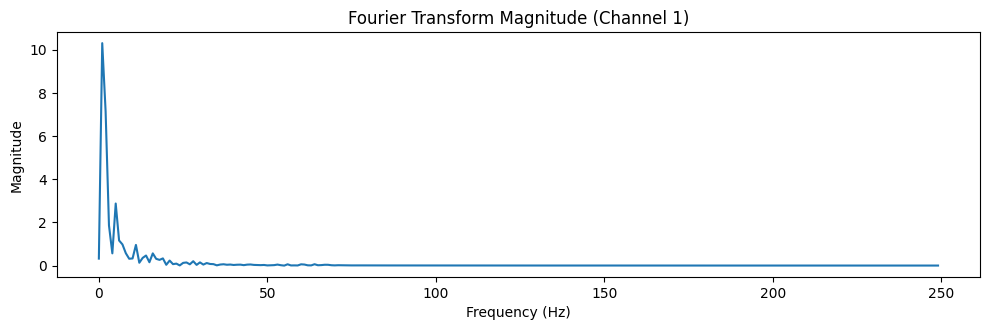

Plotting Channel 2


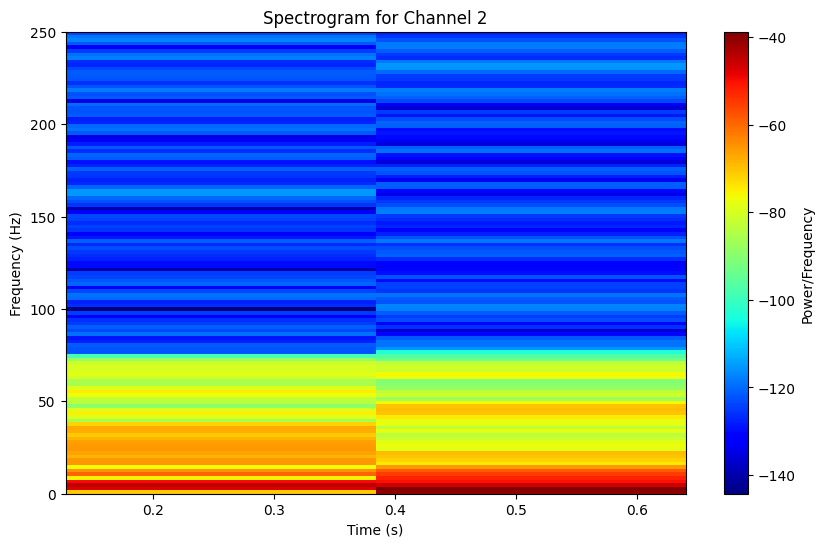

Most similar coefficient to the original signal (Channel 2): Approximation L2 with similarity: 0.03322703309824446
Similarity Scores:
Level 1 -> Approximation Similarity: -0.41547114097719795, Detail Similarity: 0.0010348259293630215
Level 2 -> Approximation Similarity: 0.03322703309824446, Detail Similarity: 0.015213115391944363
Level 3 -> Approximation Similarity: 0.016568976674096566, Detail Similarity: 0.009898723889327886
Level 4 -> Approximation Similarity: -0.0027036251537559076, Detail Similarity: 0.013907054707160103


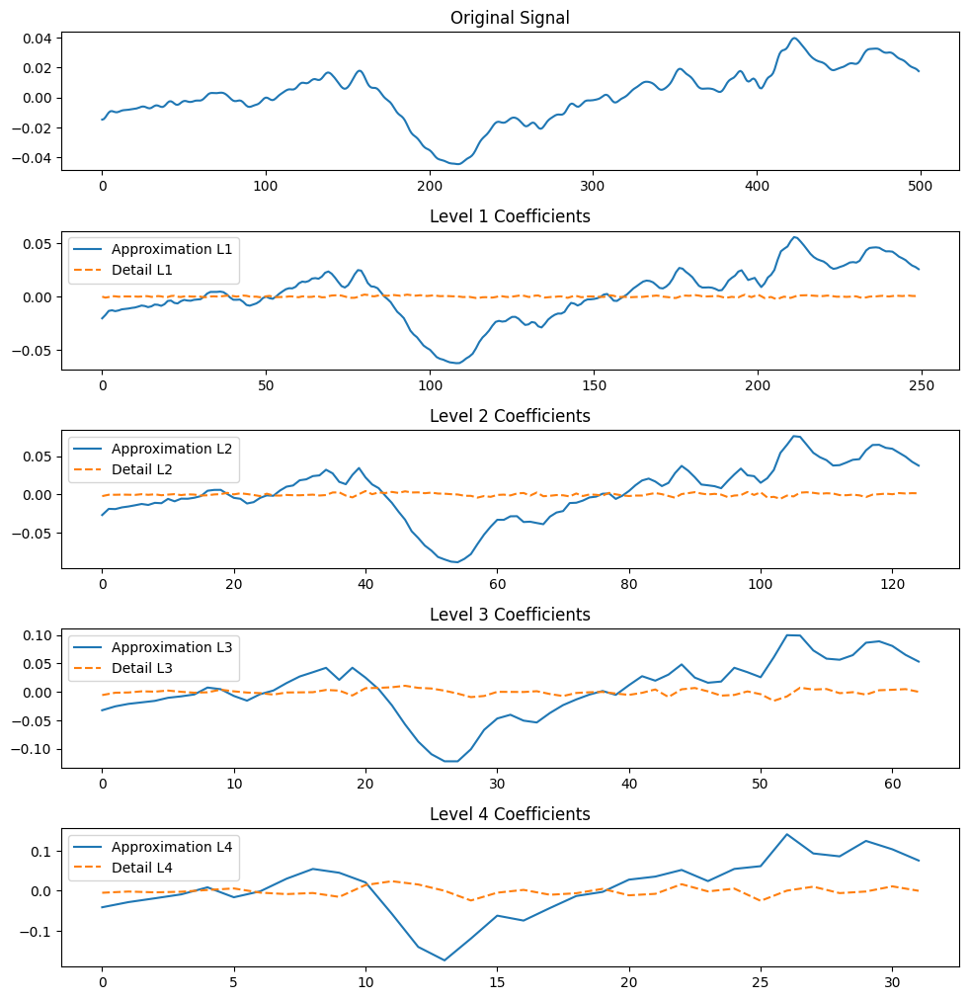

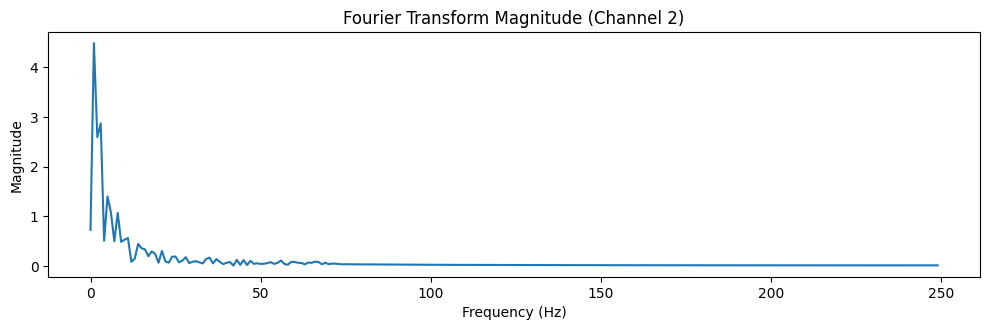

Plotting Channel 3


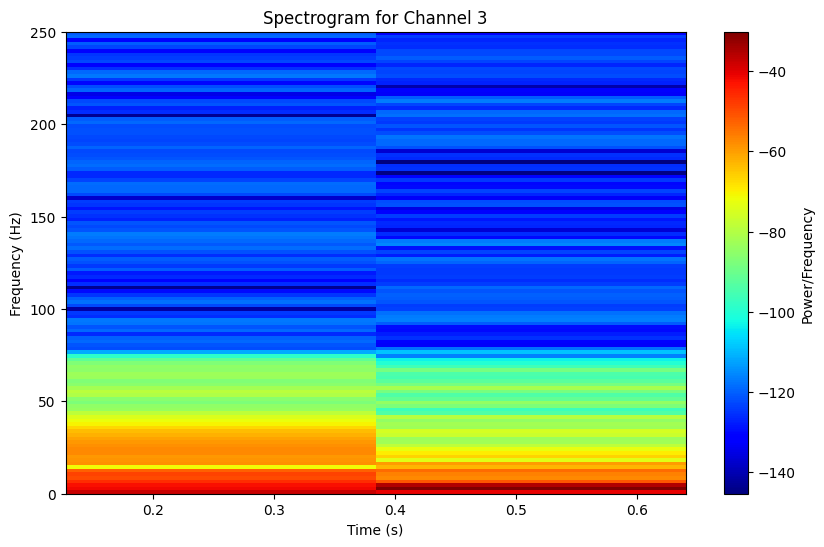

Most similar coefficient to the original signal (Channel 3): Approximation L2 with similarity: 0.003894149440743237
Similarity Scores:
Level 1 -> Approximation Similarity: -0.13313808960251514, Detail Similarity: -0.14128266063158645
Level 2 -> Approximation Similarity: 0.003894149440743237, Detail Similarity: -0.004268076023682689
Level 3 -> Approximation Similarity: 0.00027928263216999815, Detail Similarity: -0.0022847759247544017
Level 4 -> Approximation Similarity: -0.0034831566223903028, Detail Similarity: -0.0017188827130105615


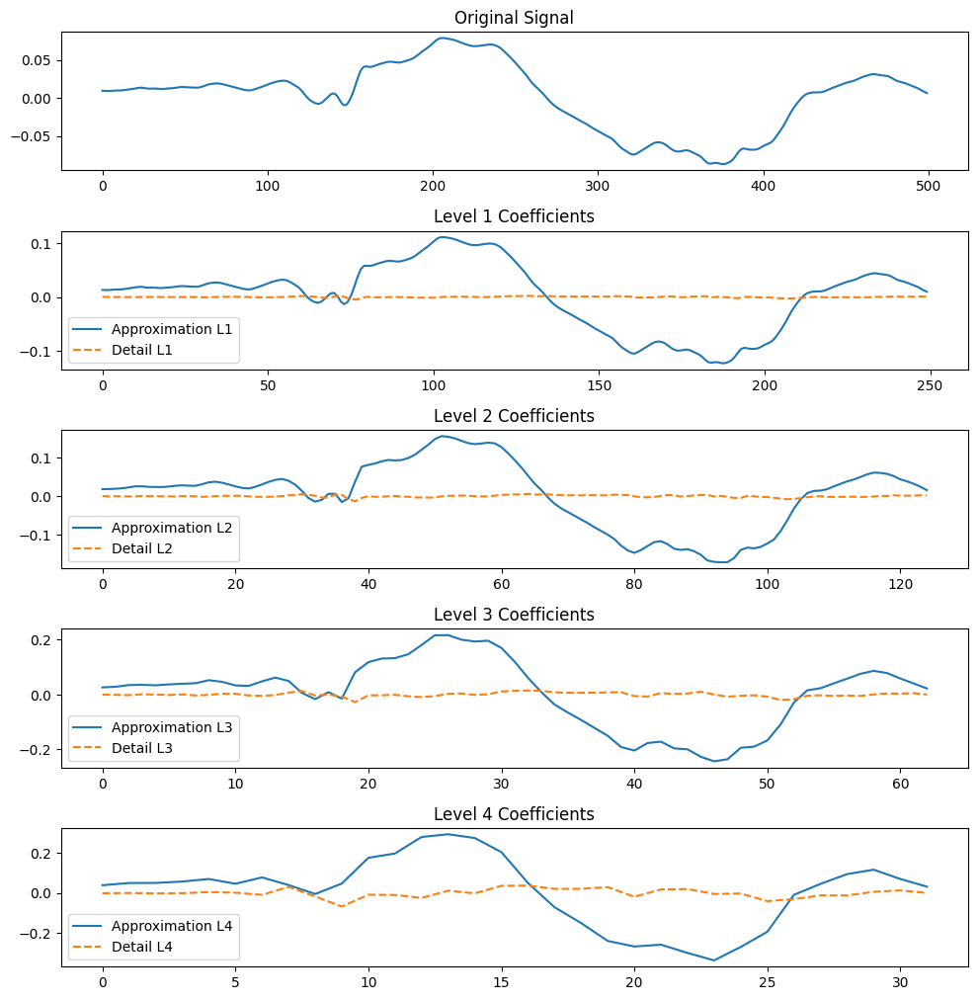

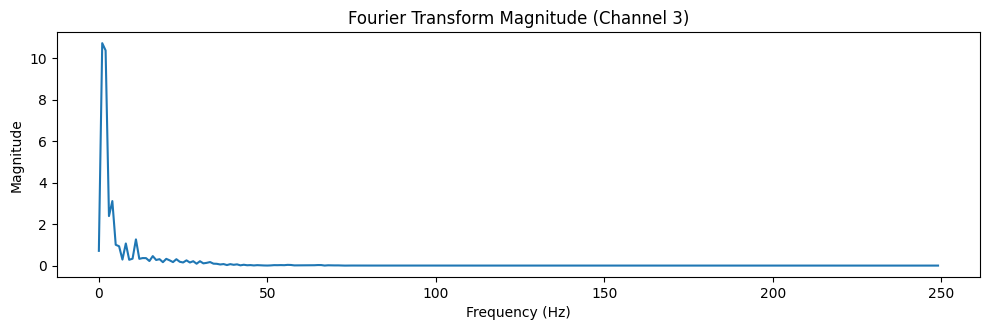

Plotting Channel 4


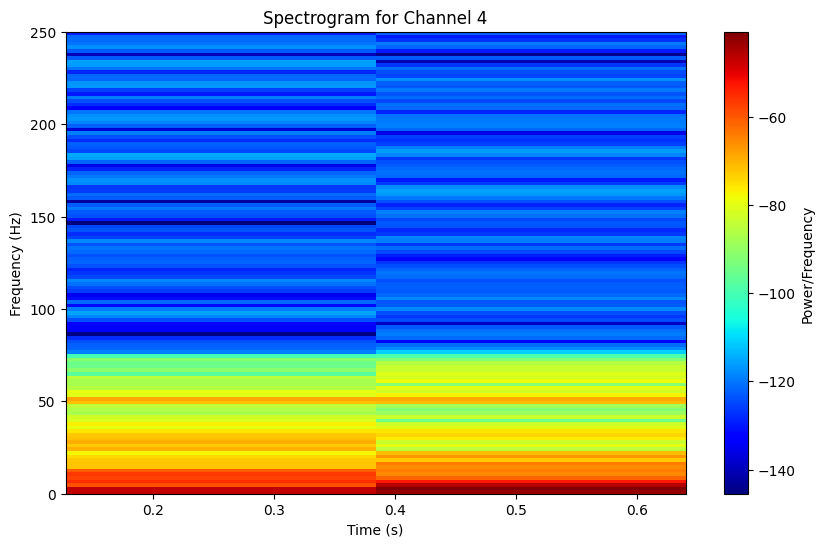

Most similar coefficient to the original signal (Channel 4): Approximation L3 with similarity: 0.07048114771750139
Similarity Scores:
Level 1 -> Approximation Similarity: -0.26265024759910527, Detail Similarity: 0.0015350632280645563
Level 2 -> Approximation Similarity: -0.11311742515163319, Detail Similarity: -0.003610556824797911
Level 3 -> Approximation Similarity: 0.07048114771750139, Detail Similarity: 0.0012981241548885877
Level 4 -> Approximation Similarity: 0.002579378945914678, Detail Similarity: 0.0025720275962847396


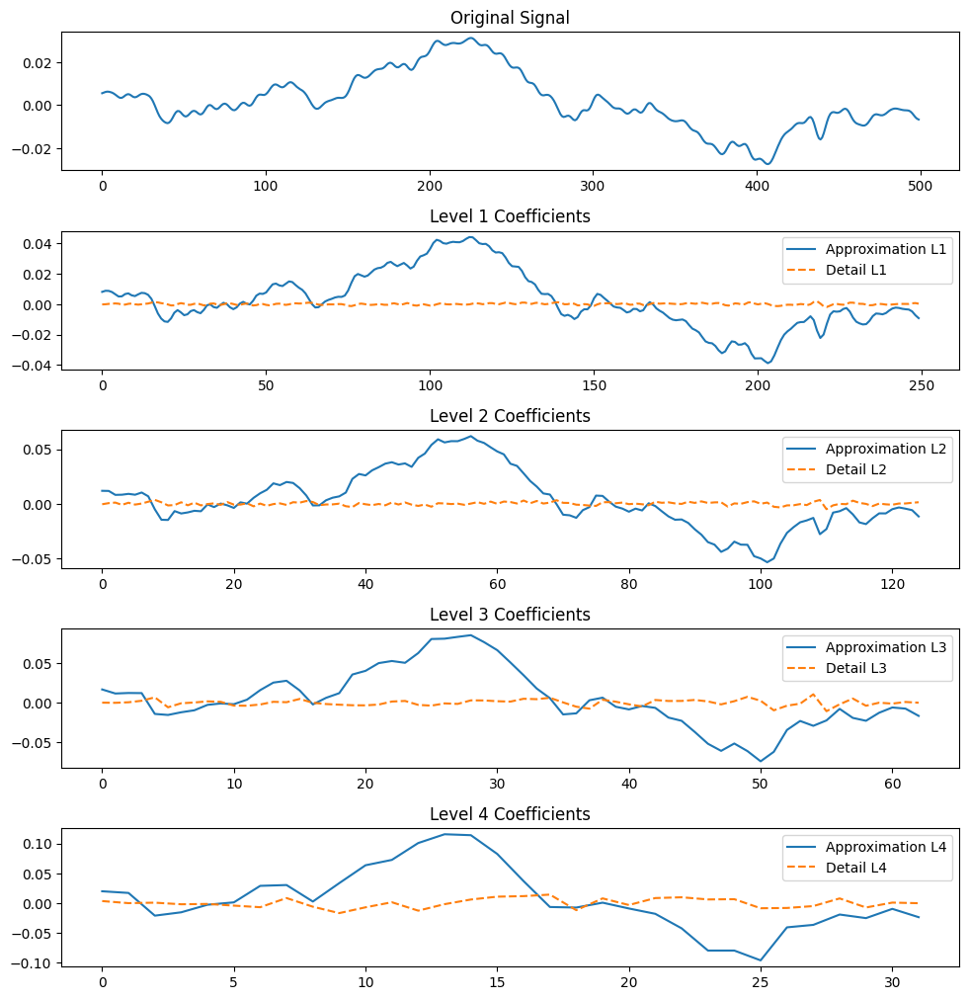

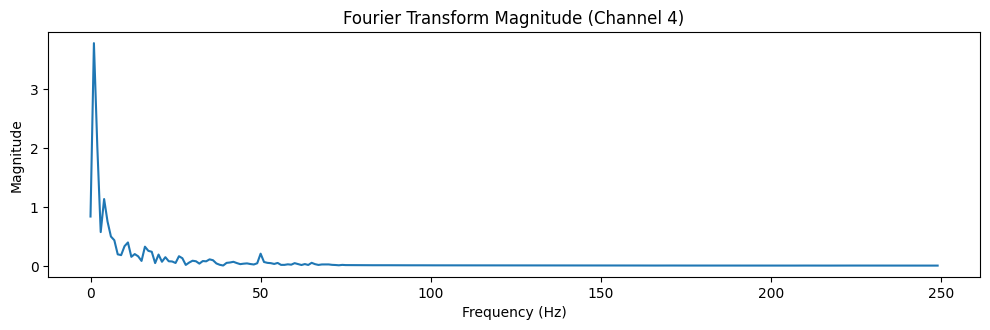

Plotting Channel 5


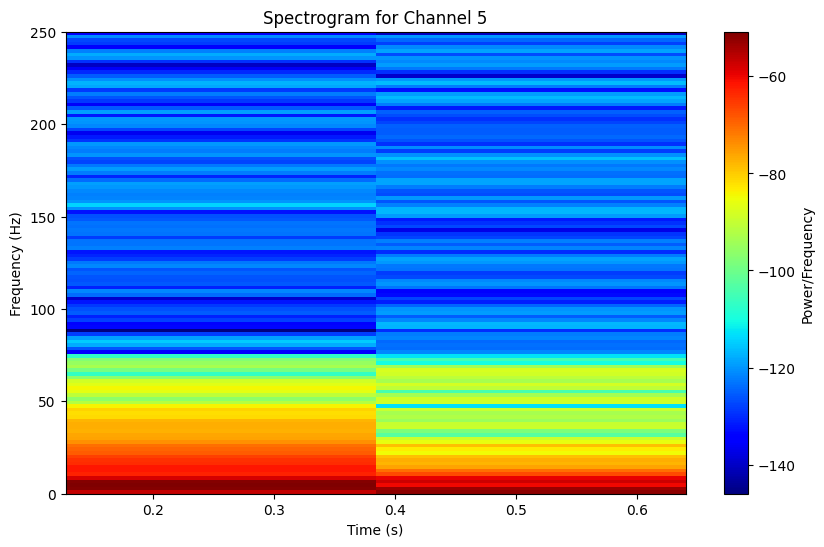

Most similar coefficient to the original signal (Channel 5): Approximation L3 with similarity: 0.016711382010796208
Similarity Scores:
Level 1 -> Approximation Similarity: -0.15670908436195297, Detail Similarity: -0.05352093908726027
Level 2 -> Approximation Similarity: -0.013856202027185993, Detail Similarity: 0.011689647302453006
Level 3 -> Approximation Similarity: 0.016711382010796208, Detail Similarity: 0.005963289694548836
Level 4 -> Approximation Similarity: 0.0026647739659519764, Detail Similarity: 0.006197225052058138


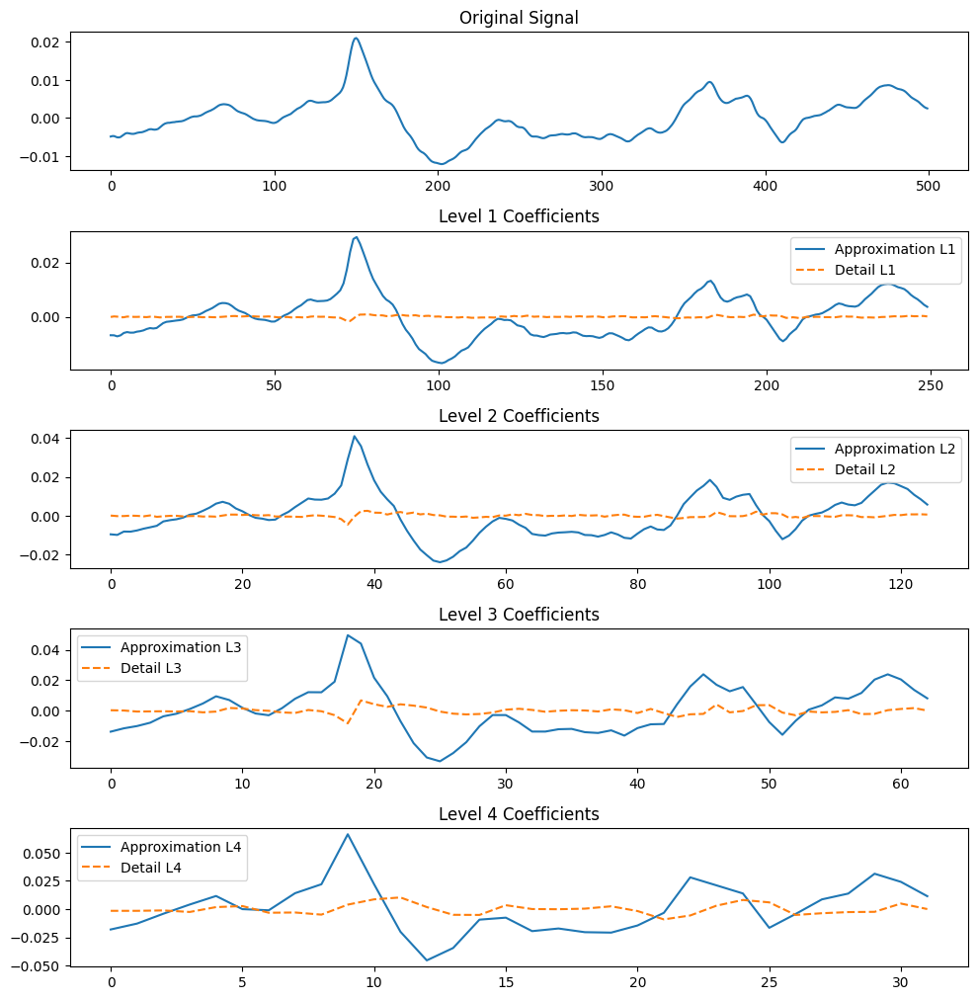

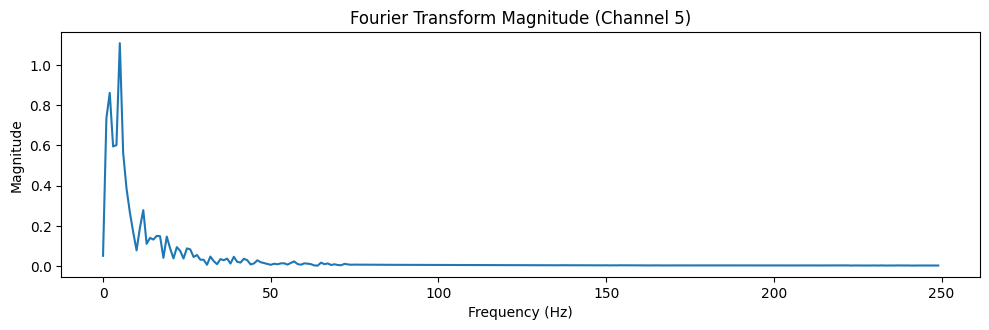

Plotting Channel 6


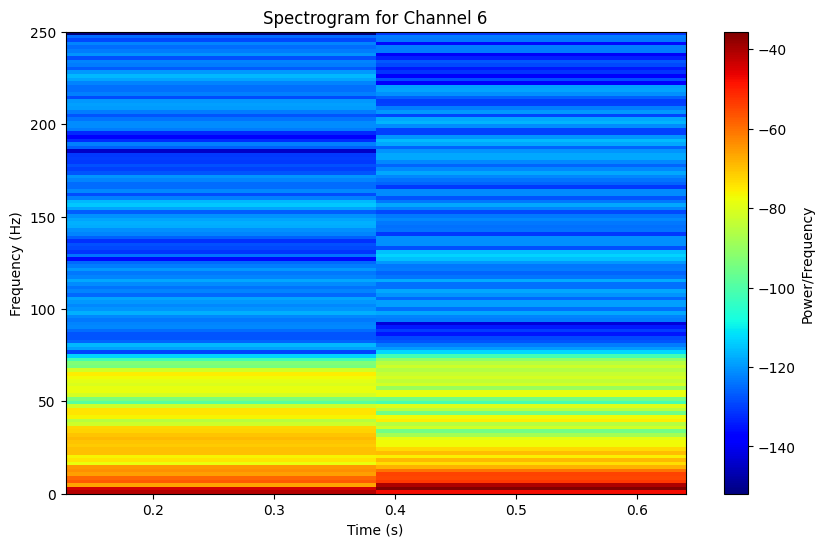

Most similar coefficient to the original signal (Channel 6): Approximation L3 with similarity: 0.01331190216281797
Similarity Scores:
Level 1 -> Approximation Similarity: -0.13876257269426698, Detail Similarity: -0.08353143897136185
Level 2 -> Approximation Similarity: 0.0008965933171515487, Detail Similarity: -0.006654955399520402
Level 3 -> Approximation Similarity: 0.01331190216281797, Detail Similarity: 0.010824059746807075
Level 4 -> Approximation Similarity: 0.004354038788301111, Detail Similarity: 0.00044082750305507896


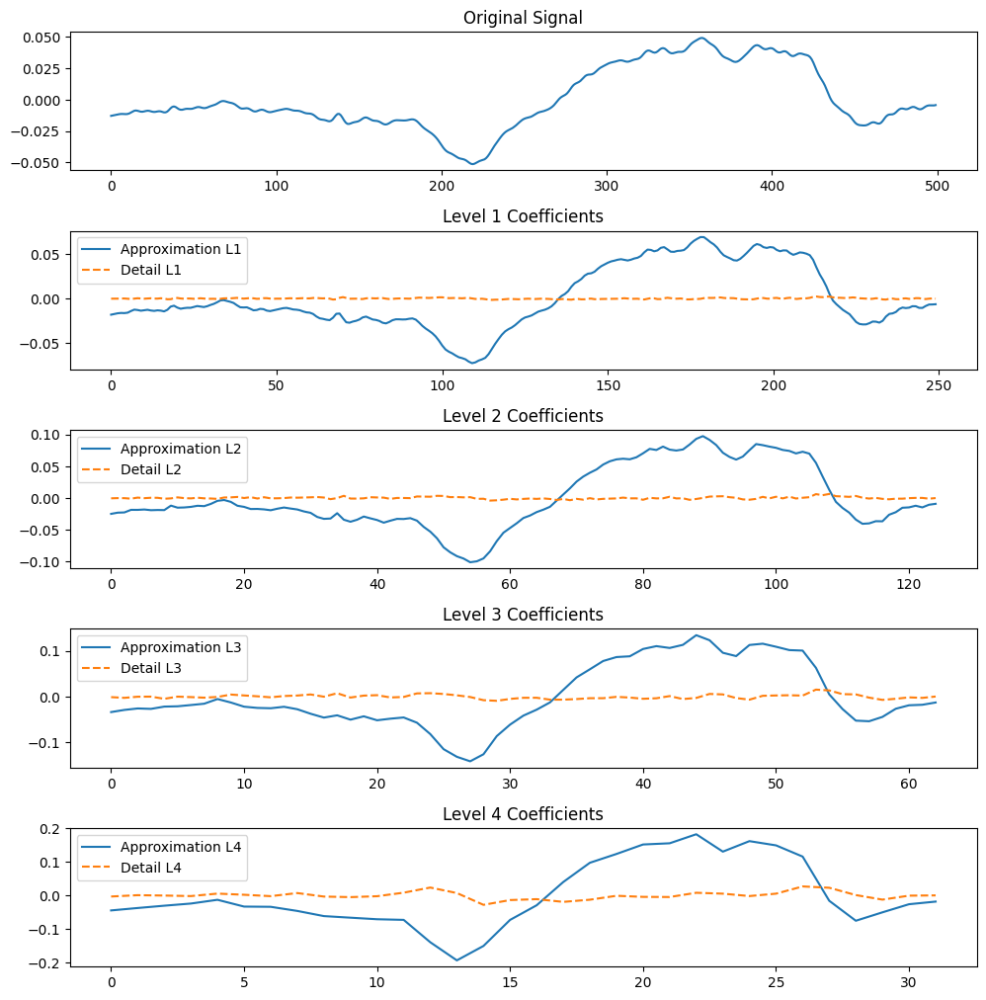

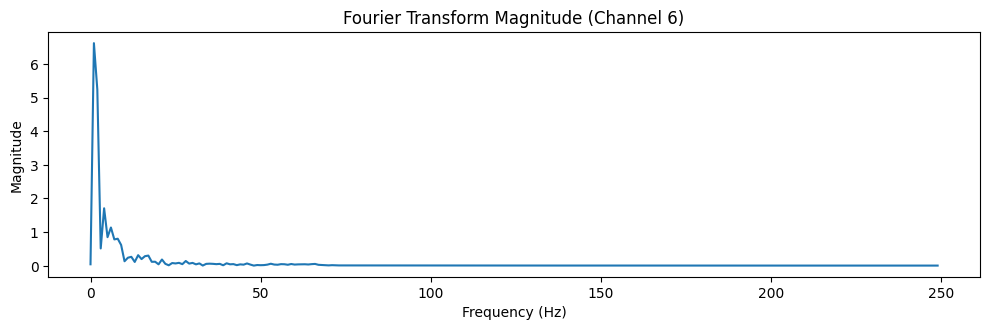

Plotting Channel 7


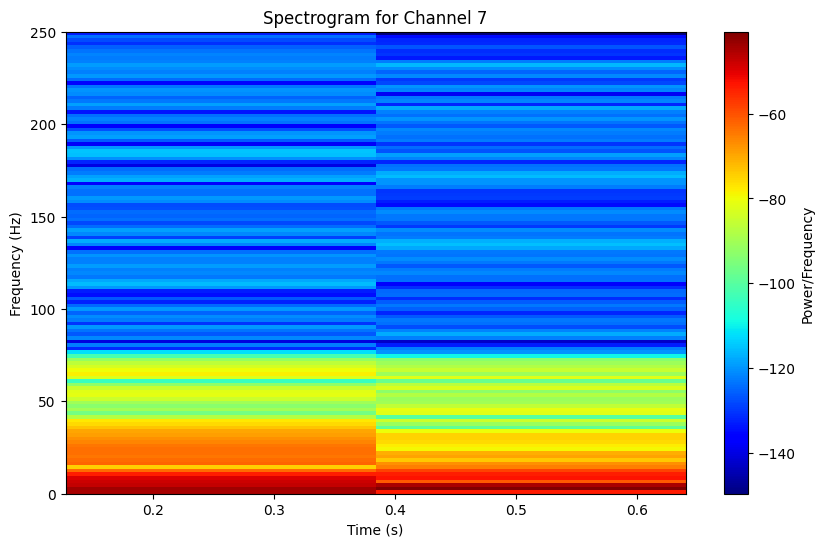

Most similar coefficient to the original signal (Channel 7): Detail L1 with similarity: 0.04226353867207192
Similarity Scores:
Level 1 -> Approximation Similarity: -0.21984334001981537, Detail Similarity: 0.04226353867207192
Level 2 -> Approximation Similarity: -0.0022837676243799157, Detail Similarity: -0.008396091555730295
Level 3 -> Approximation Similarity: -0.006565080955371375, Detail Similarity: -0.00014860226643455732
Level 4 -> Approximation Similarity: 0.016678158695143414, Detail Similarity: -7.113190397266545e-05


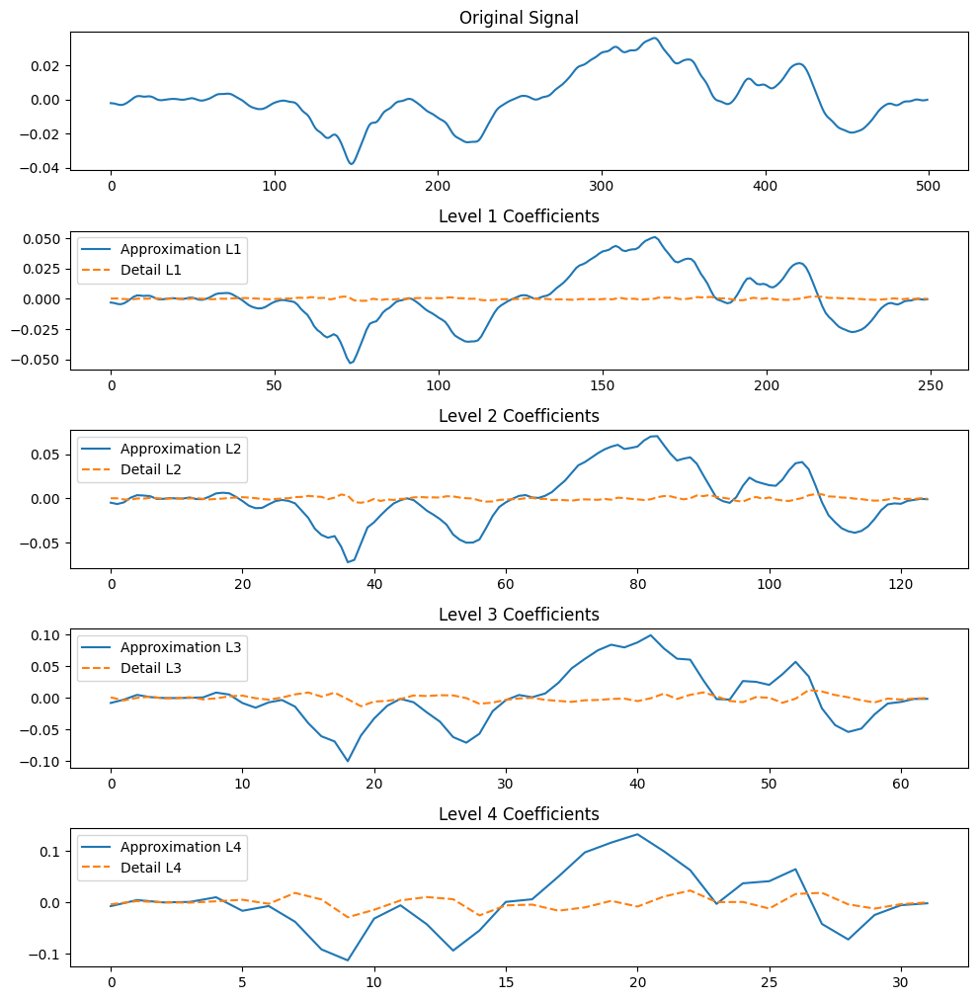

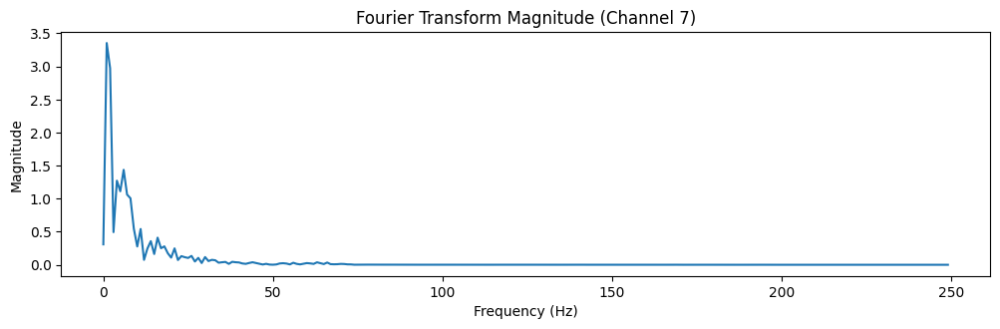

Plotting Channel 8


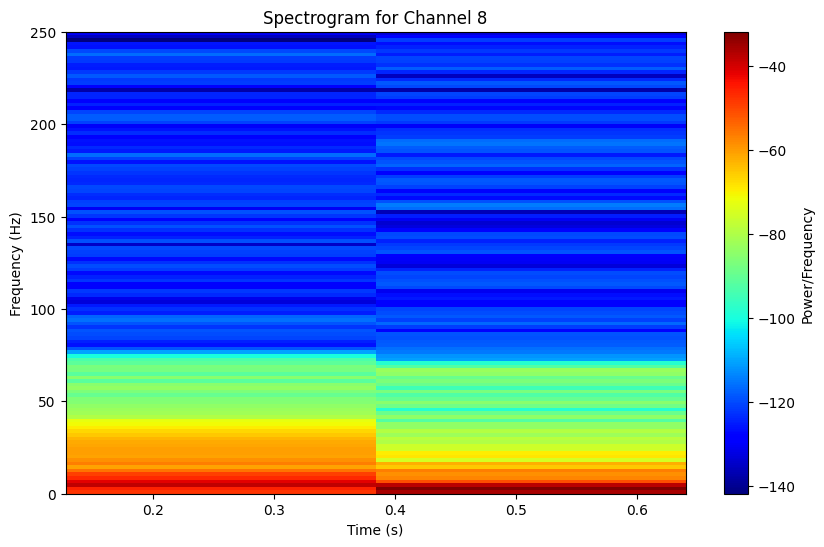

Most similar coefficient to the original signal (Channel 8): Approximation L3 with similarity: 0.0028811034153359717
Similarity Scores:
Level 1 -> Approximation Similarity: -0.11246815652174827, Detail Similarity: -0.21570417774611564
Level 2 -> Approximation Similarity: -0.005727154550449873, Detail Similarity: -0.0028822521018518534
Level 3 -> Approximation Similarity: 0.0028811034153359717, Detail Similarity: -0.00611080422249681
Level 4 -> Approximation Similarity: -0.0021675014706841692, Detail Similarity: -0.0012357263296796357


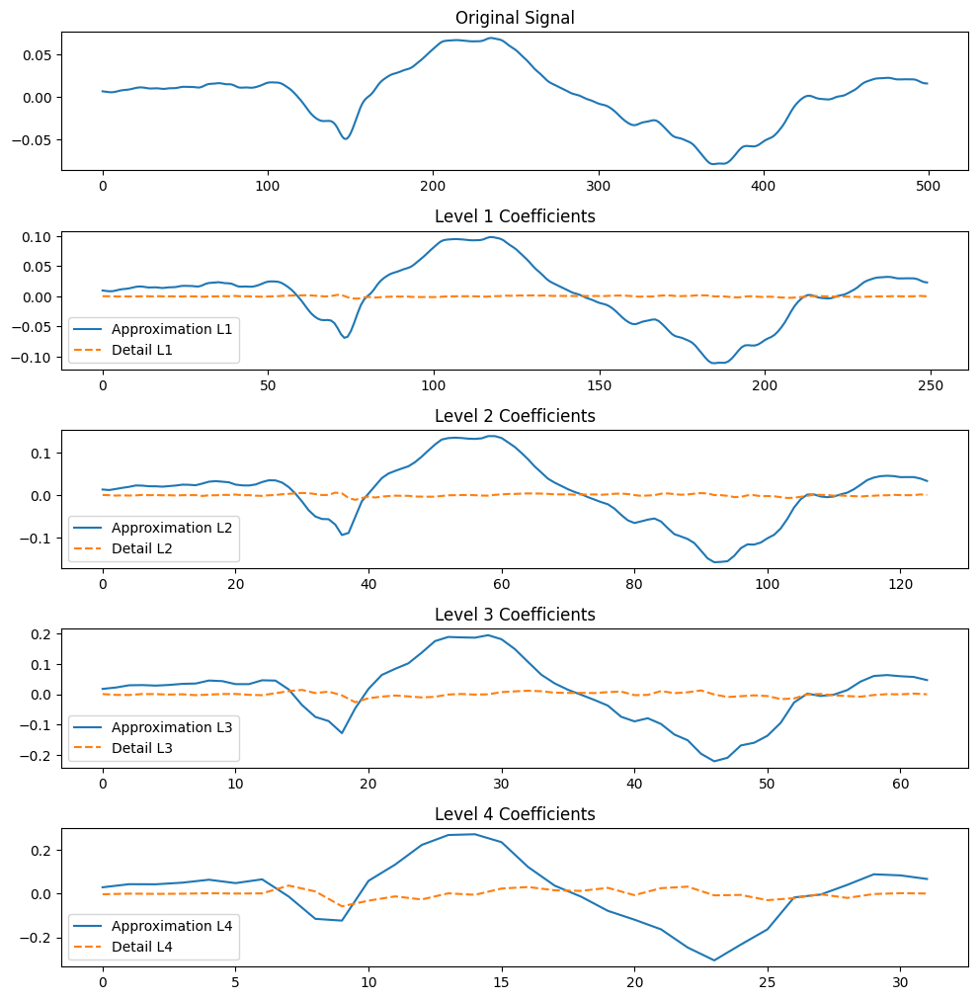

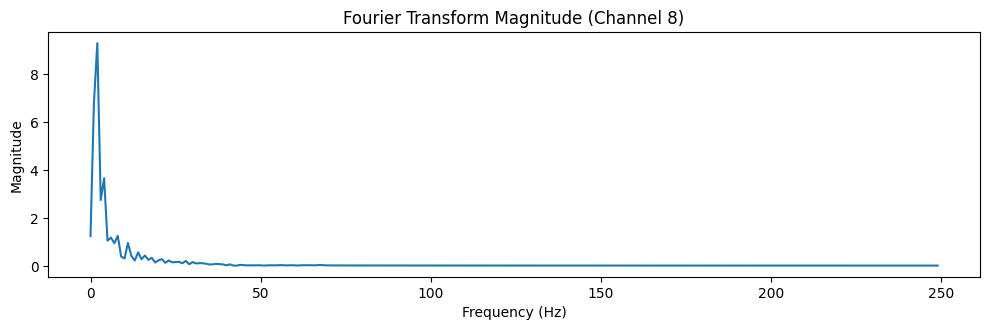

Plotting Channel 9


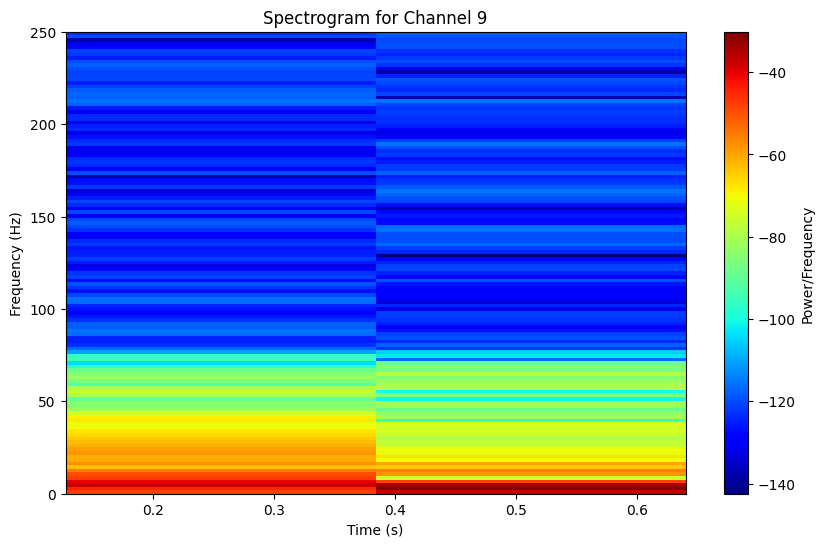

Most similar coefficient to the original signal (Channel 9): Approximation L1 with similarity: 0.036437797829945974
Similarity Scores:
Level 1 -> Approximation Similarity: 0.036437797829945974, Detail Similarity: -0.23077410511207233
Level 2 -> Approximation Similarity: 0.0054743732627630035, Detail Similarity: -0.016191006572436686
Level 3 -> Approximation Similarity: 0.002674135597208916, Detail Similarity: -0.0007006946392286338
Level 4 -> Approximation Similarity: 0.0002217415429507955, Detail Similarity: -0.0019871334075965055


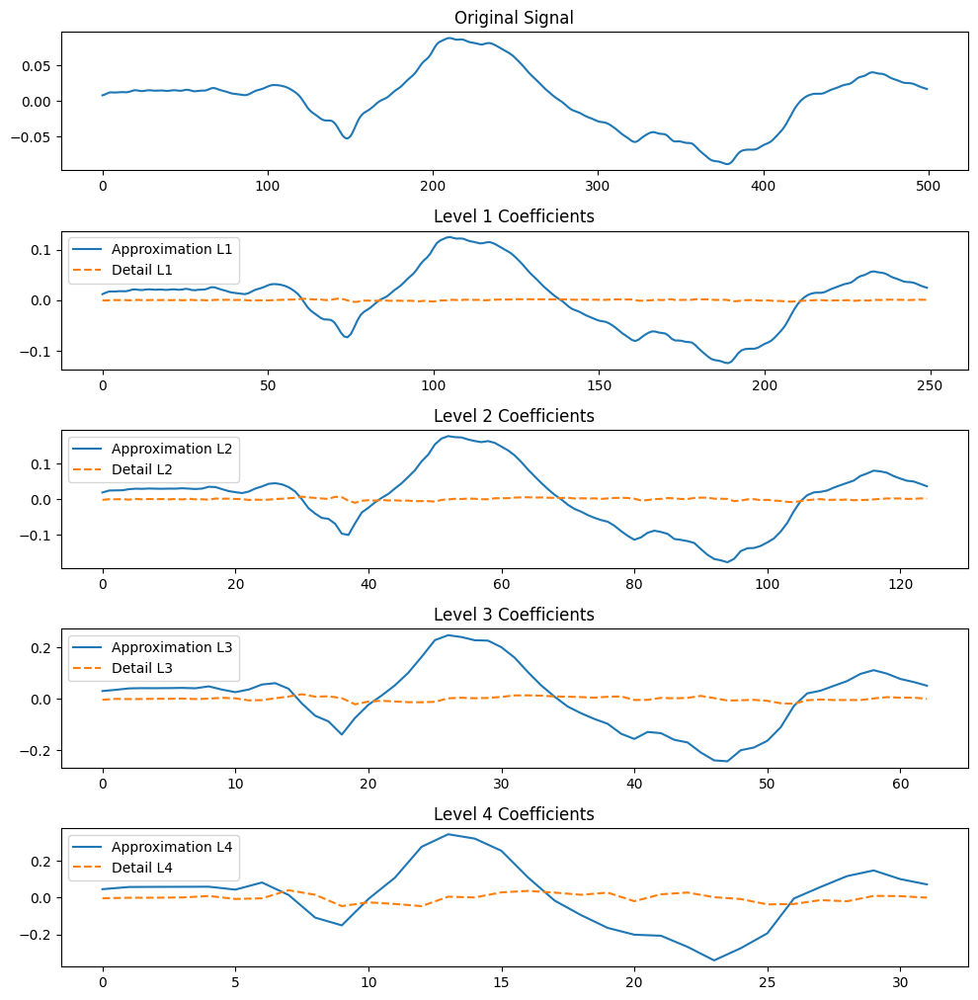

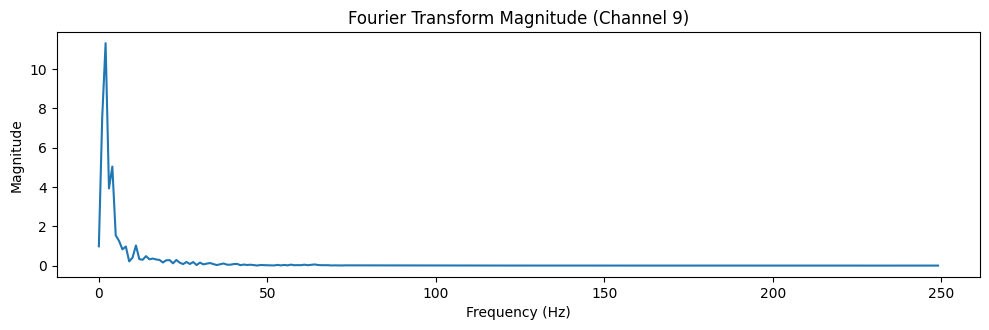

Plotting Channel 10


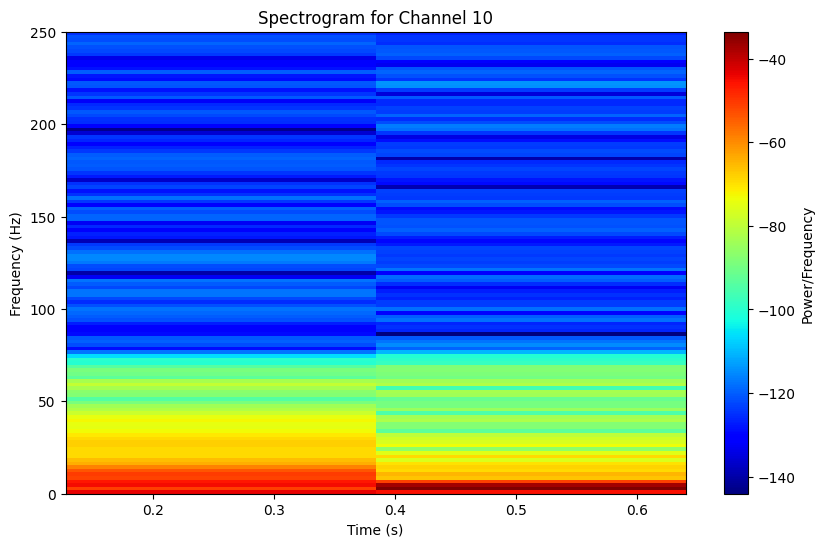

Most similar coefficient to the original signal (Channel 10): Detail L3 with similarity: 0.00205264671711332
Similarity Scores:
Level 1 -> Approximation Similarity: -0.043925322555019325, Detail Similarity: -0.18410269067398
Level 2 -> Approximation Similarity: -0.0012380937724448045, Detail Similarity: -0.022051193718678284
Level 3 -> Approximation Similarity: -0.001594605639385327, Detail Similarity: 0.00205264671711332
Level 4 -> Approximation Similarity: -0.0038776602134792545, Detail Similarity: 0.001121009728881448


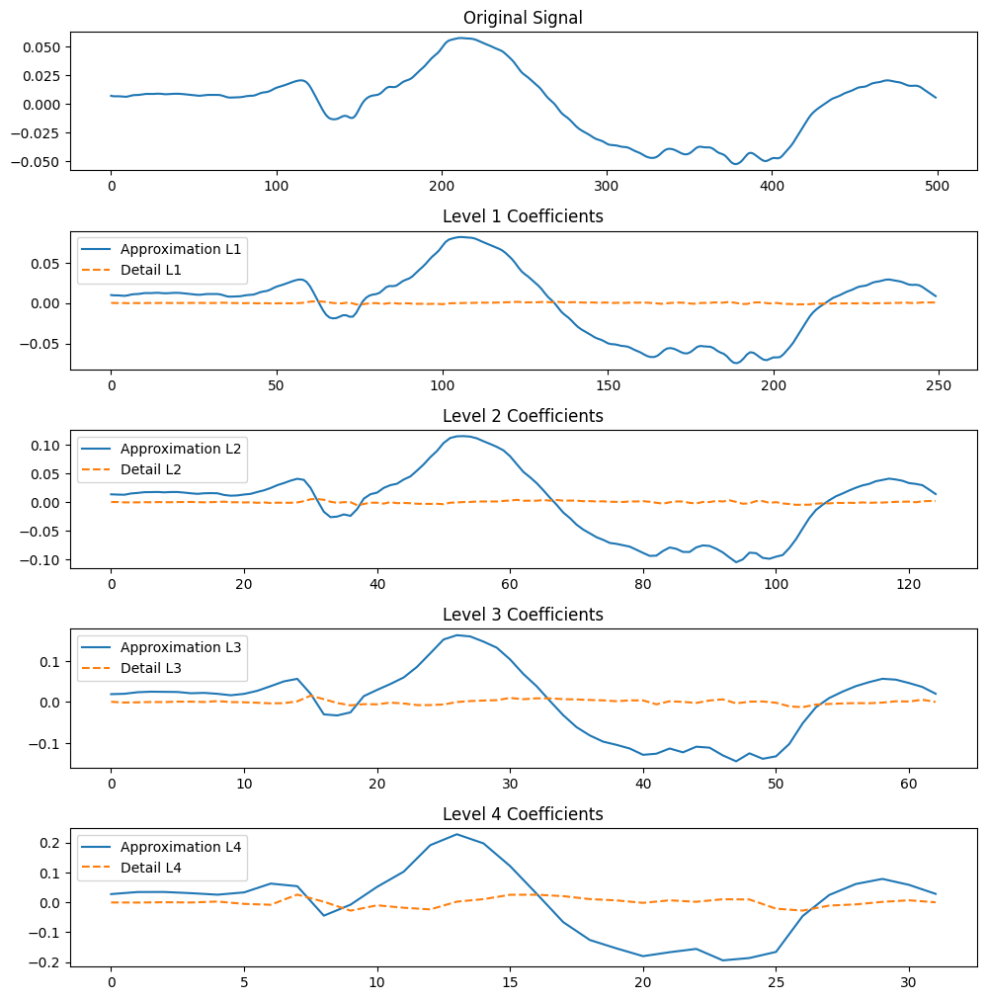

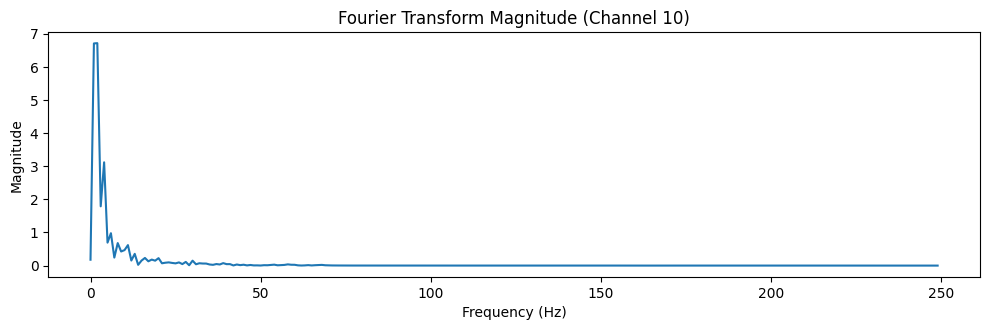

Plotting Channel 11


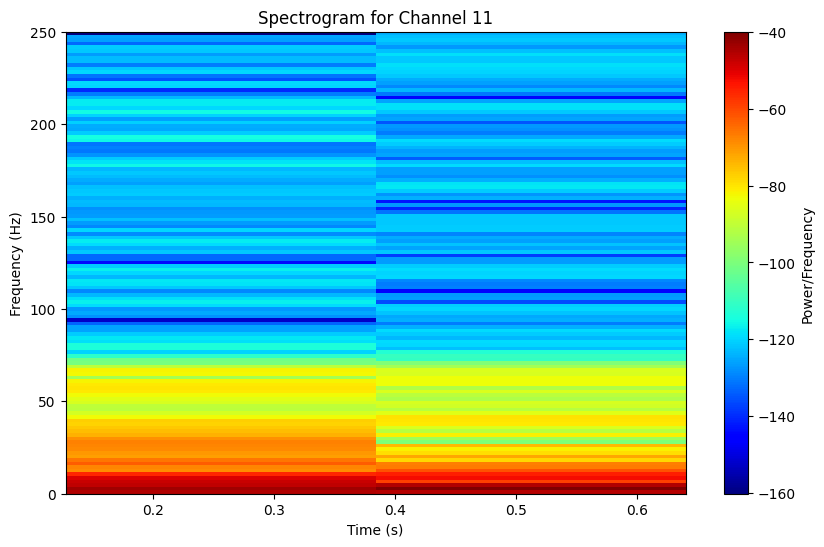

Most similar coefficient to the original signal (Channel 11): Detail L2 with similarity: 0.018488912314928874
Similarity Scores:
Level 1 -> Approximation Similarity: -0.23716297209681314, Detail Similarity: -0.005726530536348142
Level 2 -> Approximation Similarity: 0.0022823853419431527, Detail Similarity: 0.018488912314928874
Level 3 -> Approximation Similarity: -0.003515078585400236, Detail Similarity: -0.003389615650695426
Level 4 -> Approximation Similarity: 0.008116510987028872, Detail Similarity: 0.0024726233547257533


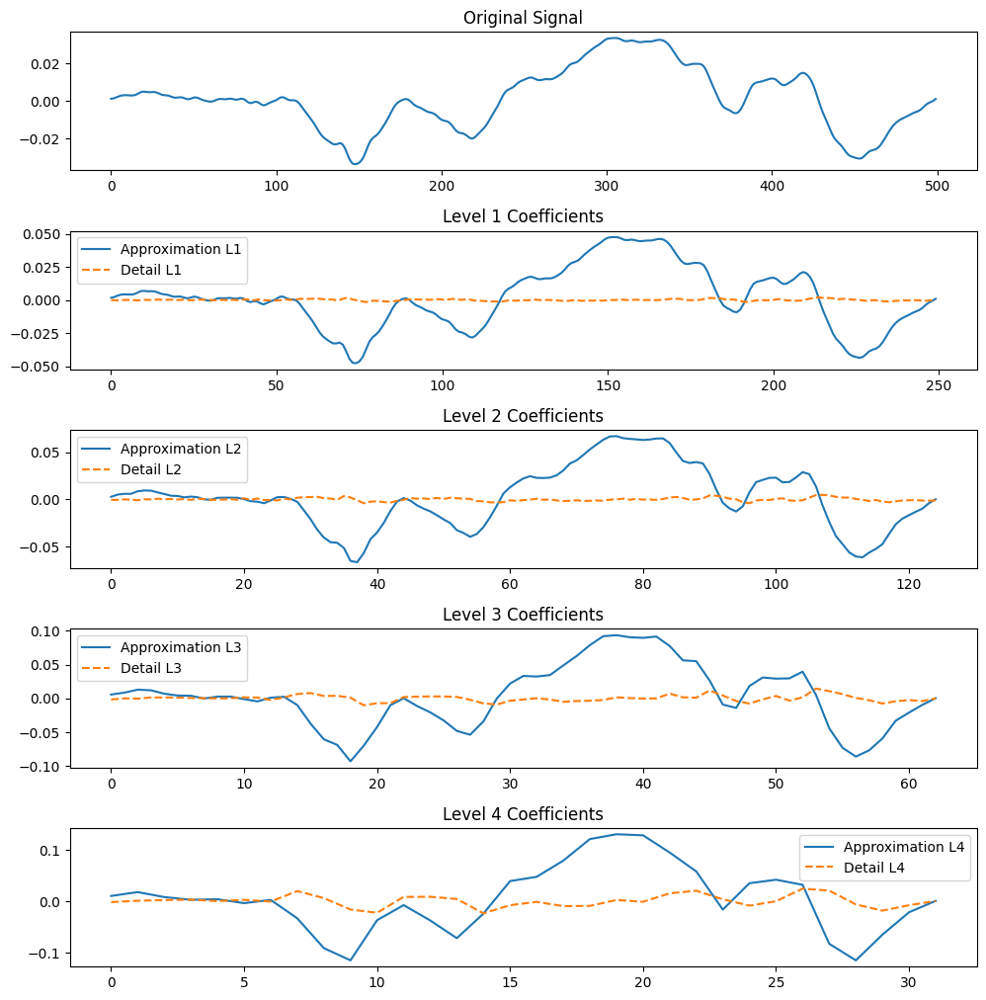

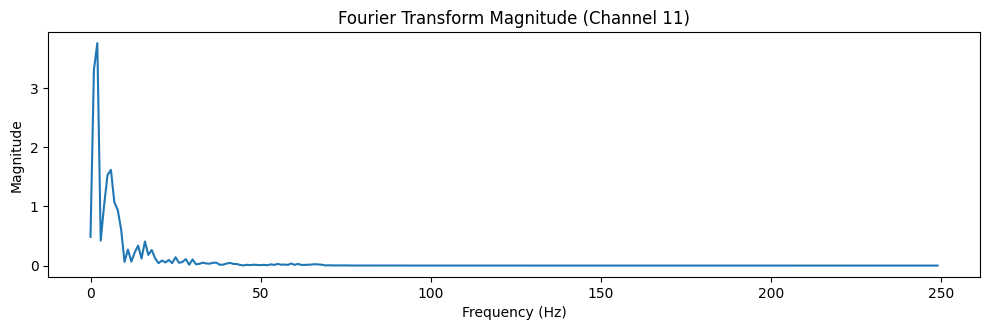

Plotting Channel 12


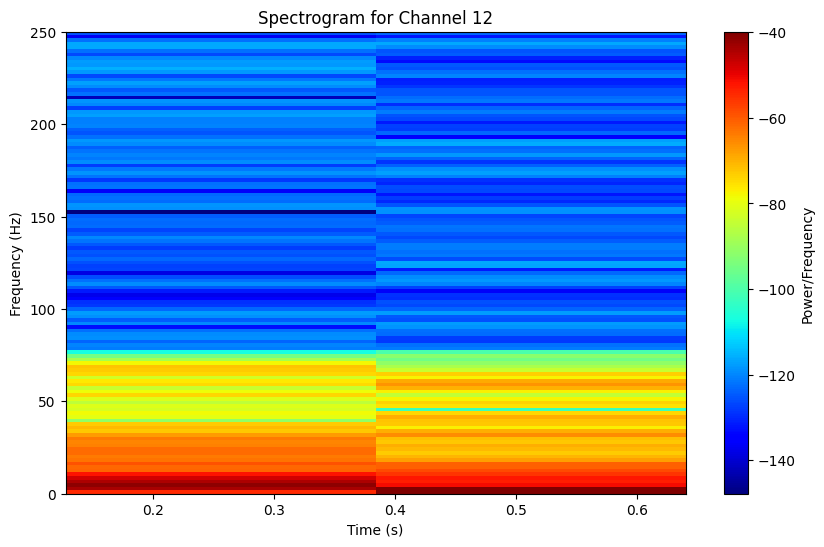

Most similar coefficient to the original signal (Channel 12): Detail L2 with similarity: 0.020679212965108395
Similarity Scores:
Level 1 -> Approximation Similarity: -0.34017872017292117, Detail Similarity: -0.06422469344651563
Level 2 -> Approximation Similarity: 0.015907450236341183, Detail Similarity: 0.020679212965108395
Level 3 -> Approximation Similarity: 0.006061431455537204, Detail Similarity: 0.0009724501909845737
Level 4 -> Approximation Similarity: -0.0012033750006767408, Detail Similarity: -0.005788383749776256


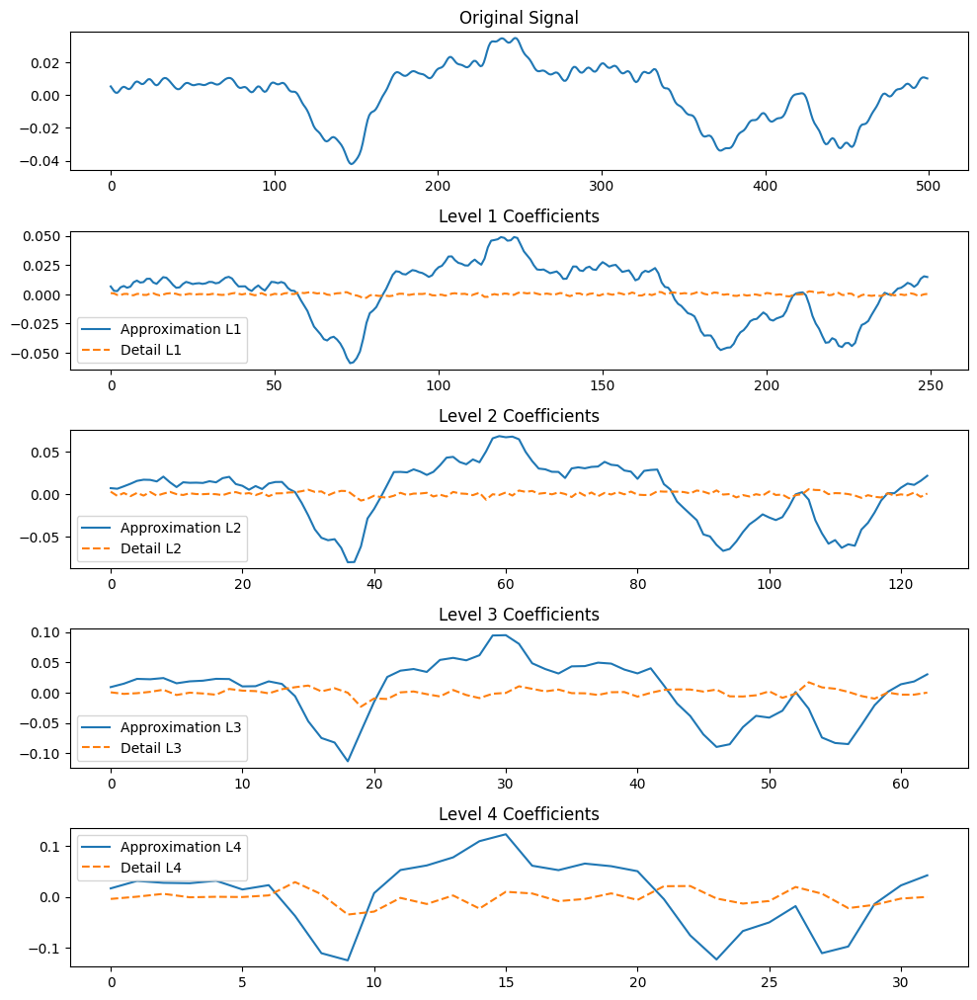

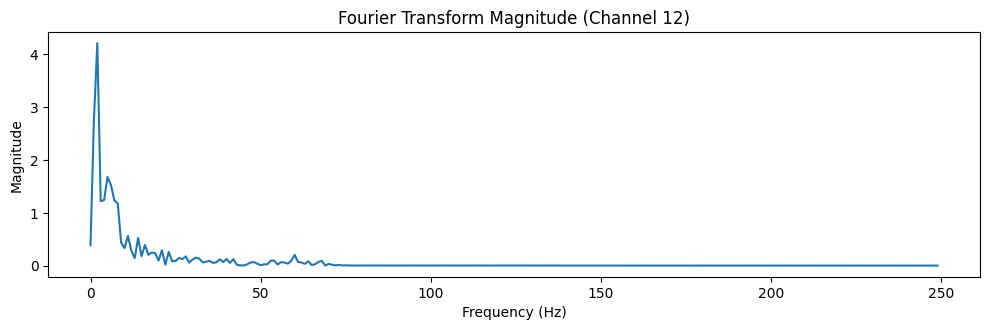

Plotting Channel 13


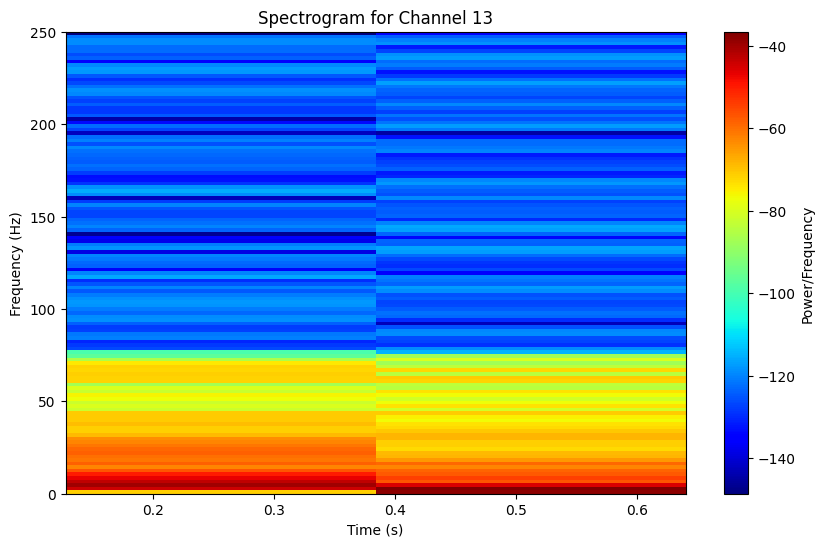

Most similar coefficient to the original signal (Channel 13): Approximation L2 with similarity: 0.015037185285778493
Similarity Scores:
Level 1 -> Approximation Similarity: -0.27042171874605, Detail Similarity: -0.09704002833383459
Level 2 -> Approximation Similarity: 0.015037185285778493, Detail Similarity: 0.00022268387695250104
Level 3 -> Approximation Similarity: 0.005300404338127508, Detail Similarity: -0.015498075299052044
Level 4 -> Approximation Similarity: -0.014301842690072614, Detail Similarity: 0.0006314870881886305


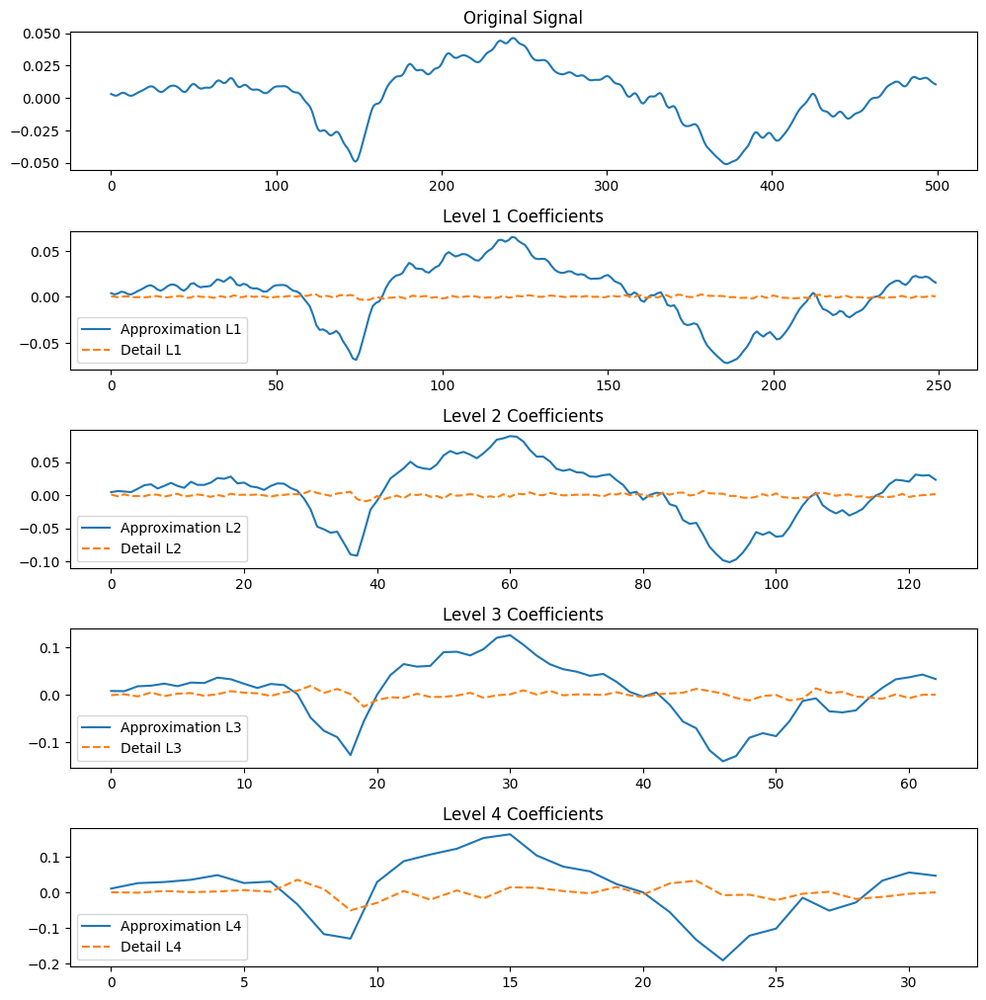

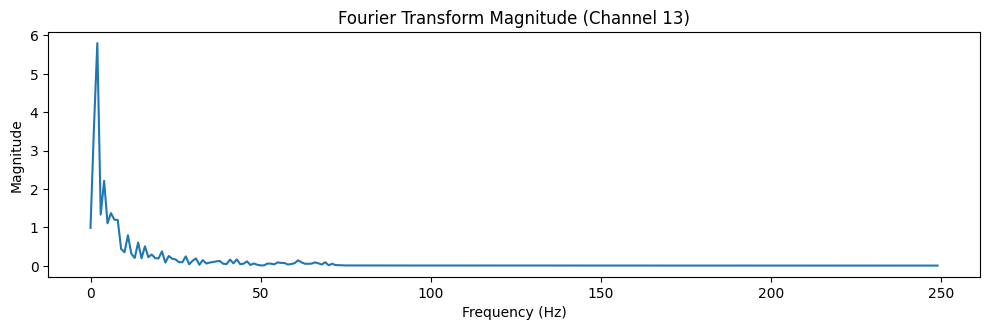

Plotting Channel 14


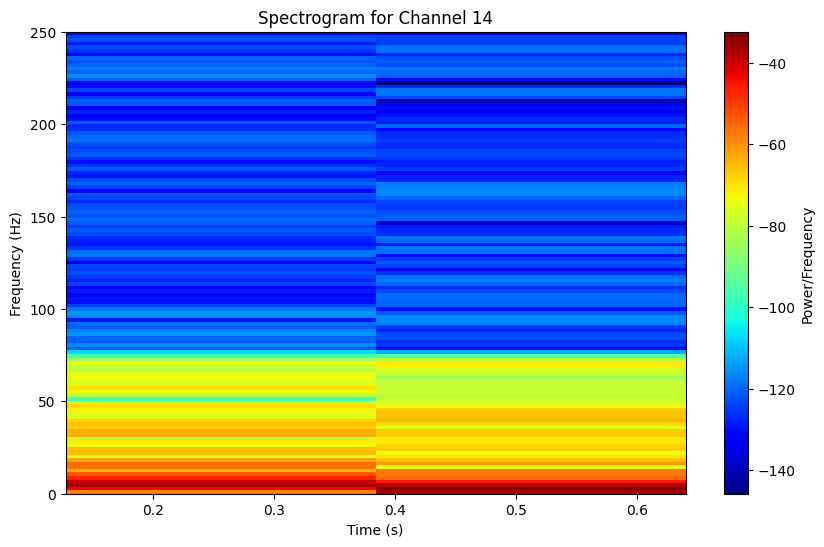

Most similar coefficient to the original signal (Channel 14): Approximation L4 with similarity: 0.010116848127854948
Similarity Scores:
Level 1 -> Approximation Similarity: -0.06469469405549418, Detail Similarity: -0.21980272239098944
Level 2 -> Approximation Similarity: -0.03872728323827979, Detail Similarity: -0.012179391617415495
Level 3 -> Approximation Similarity: -0.0128294597880587, Detail Similarity: 0.002921773517245338
Level 4 -> Approximation Similarity: 0.010116848127854948, Detail Similarity: -0.005310404200346551


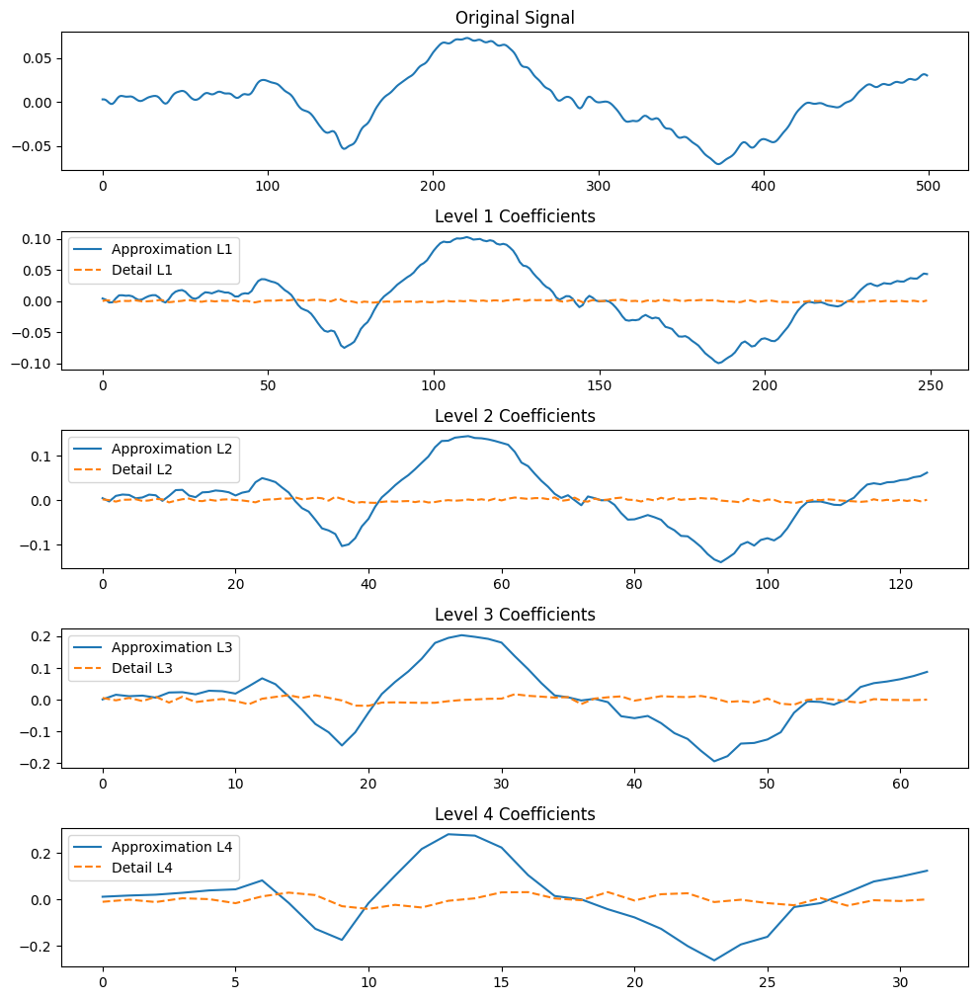

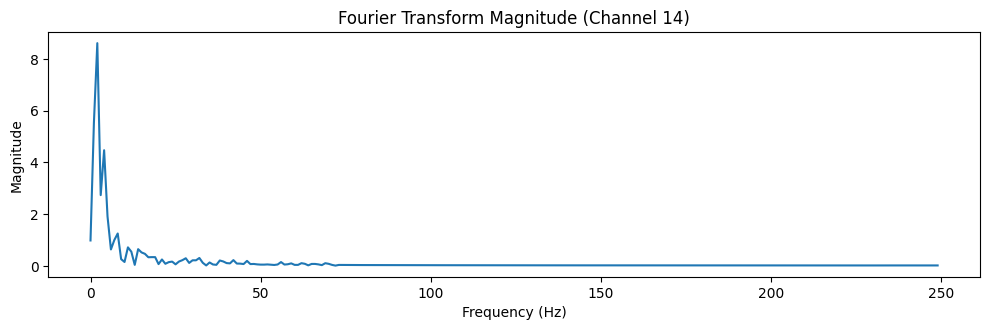

Plotting Channel 15


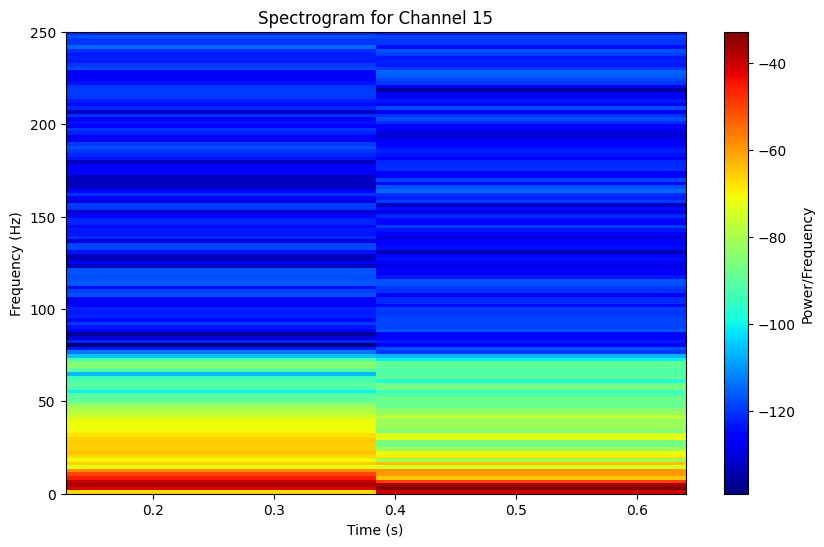

Most similar coefficient to the original signal (Channel 15): Approximation L1 with similarity: 0.06693331043695992
Similarity Scores:
Level 1 -> Approximation Similarity: 0.06693331043695992, Detail Similarity: -0.24431306870529987
Level 2 -> Approximation Similarity: -0.015478475699816698, Detail Similarity: -0.028241989244492713
Level 3 -> Approximation Similarity: -0.0009944942995158445, Detail Similarity: 0.001719493263699492
Level 4 -> Approximation Similarity: 0.00034915018634761096, Detail Similarity: -0.0014318987504468627


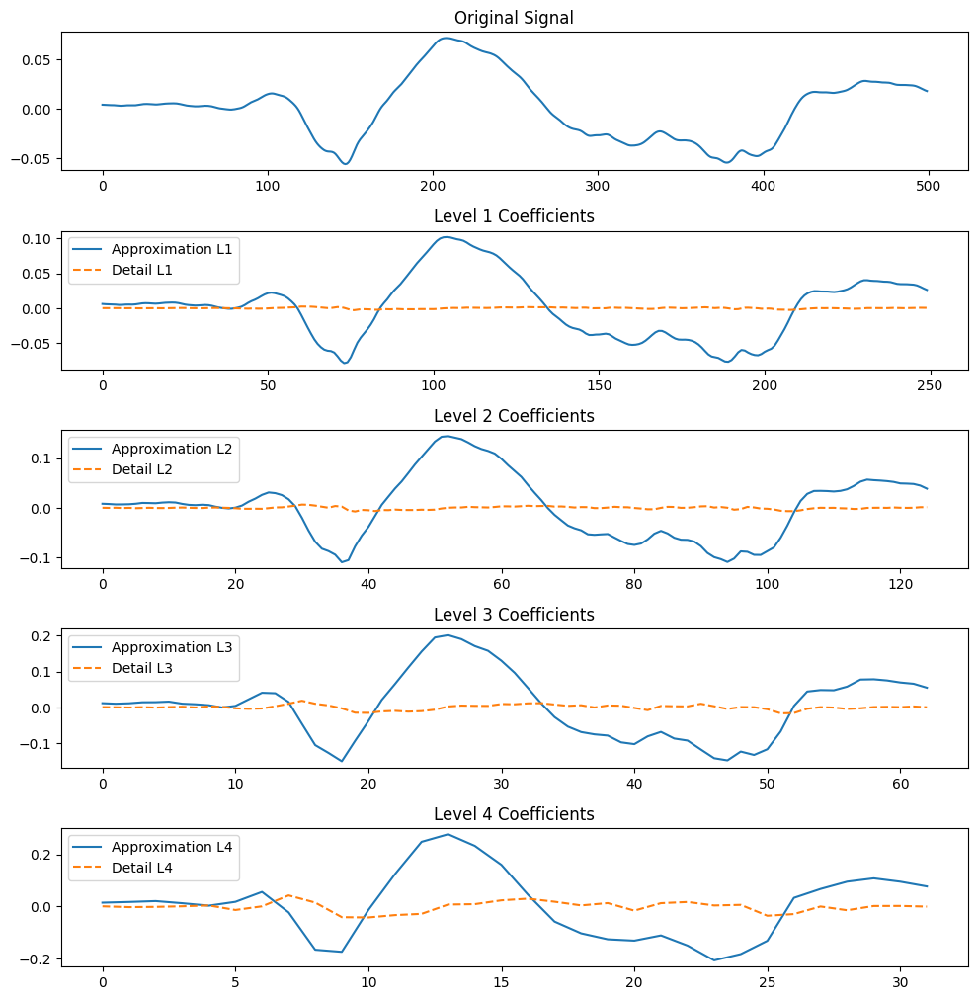

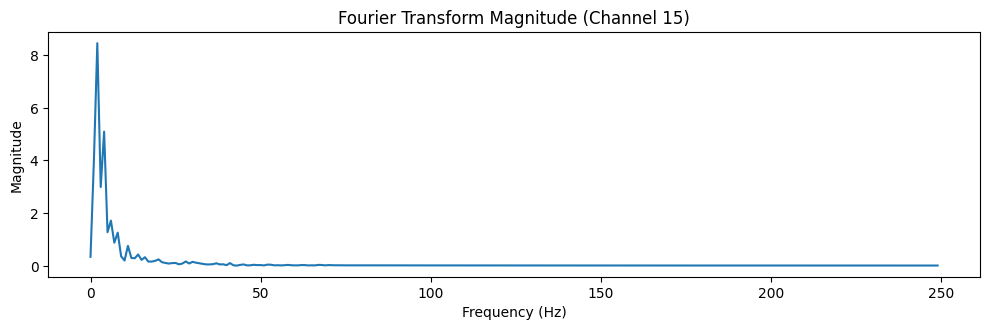

Plotting Channel 16


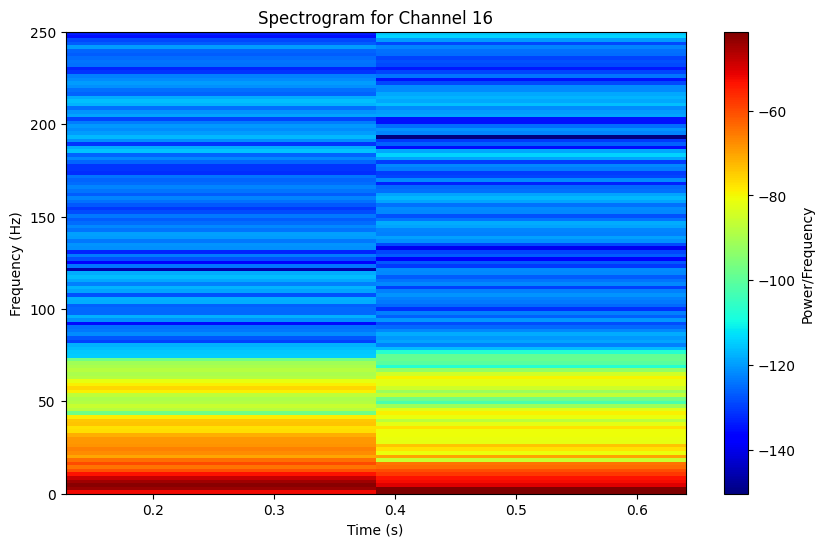

Most similar coefficient to the original signal (Channel 16): Approximation L3 with similarity: 0.027615839199350848
Similarity Scores:
Level 1 -> Approximation Similarity: -0.3082816702079973, Detail Similarity: -0.07716146127553251
Level 2 -> Approximation Similarity: -0.007789204422203837, Detail Similarity: 0.021784434811894255
Level 3 -> Approximation Similarity: 0.027615839199350848, Detail Similarity: -0.006483212374332339
Level 4 -> Approximation Similarity: 0.009992866891614154, Detail Similarity: 0.0030934552964456616


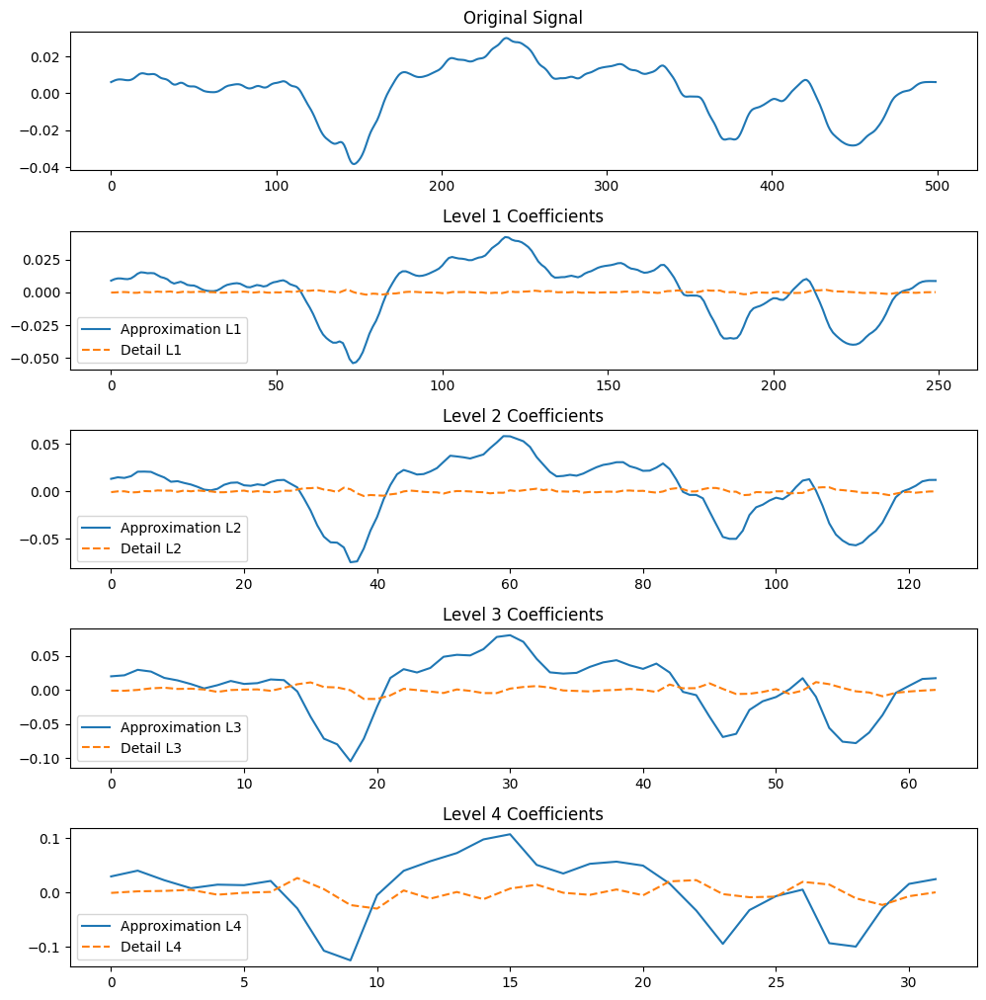

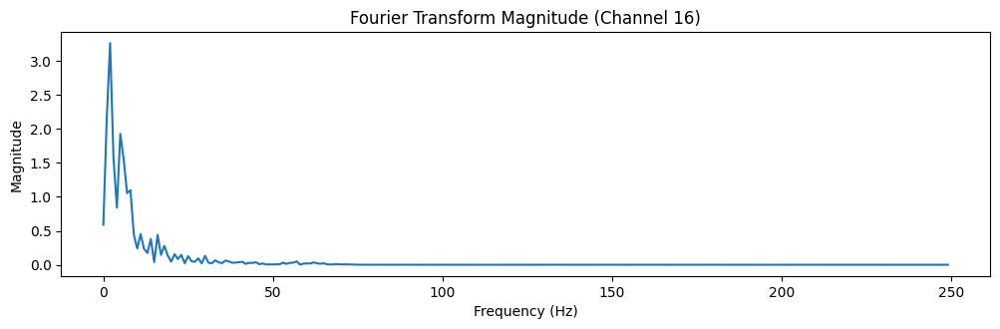

Plotting Channel 17


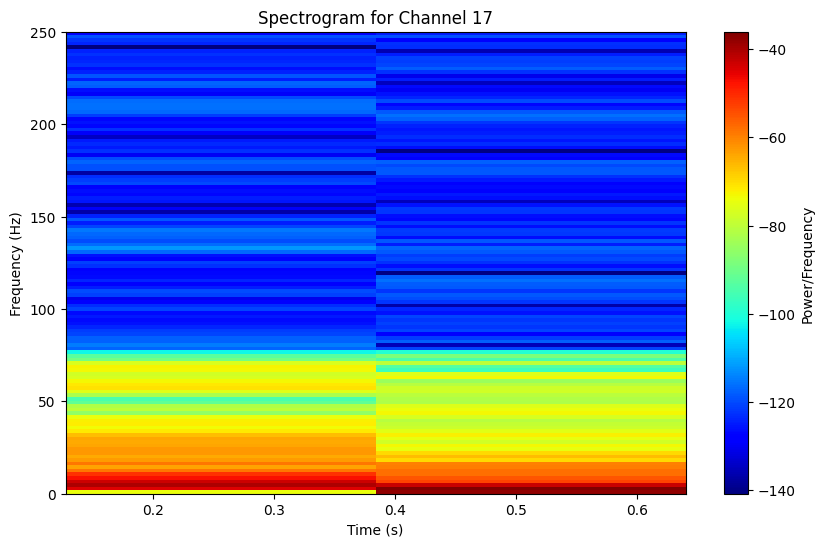

Most similar coefficient to the original signal (Channel 17): Detail L2 with similarity: 0.011527268803088804
Similarity Scores:
Level 1 -> Approximation Similarity: -0.19533068448520255, Detail Similarity: -0.16934937993395108
Level 2 -> Approximation Similarity: -0.016226447289360645, Detail Similarity: 0.011527268803088804
Level 3 -> Approximation Similarity: 0.010765305056595042, Detail Similarity: -0.013309481991518917
Level 4 -> Approximation Similarity: 0.0020531826261046197, Detail Similarity: -0.0007679682559332757


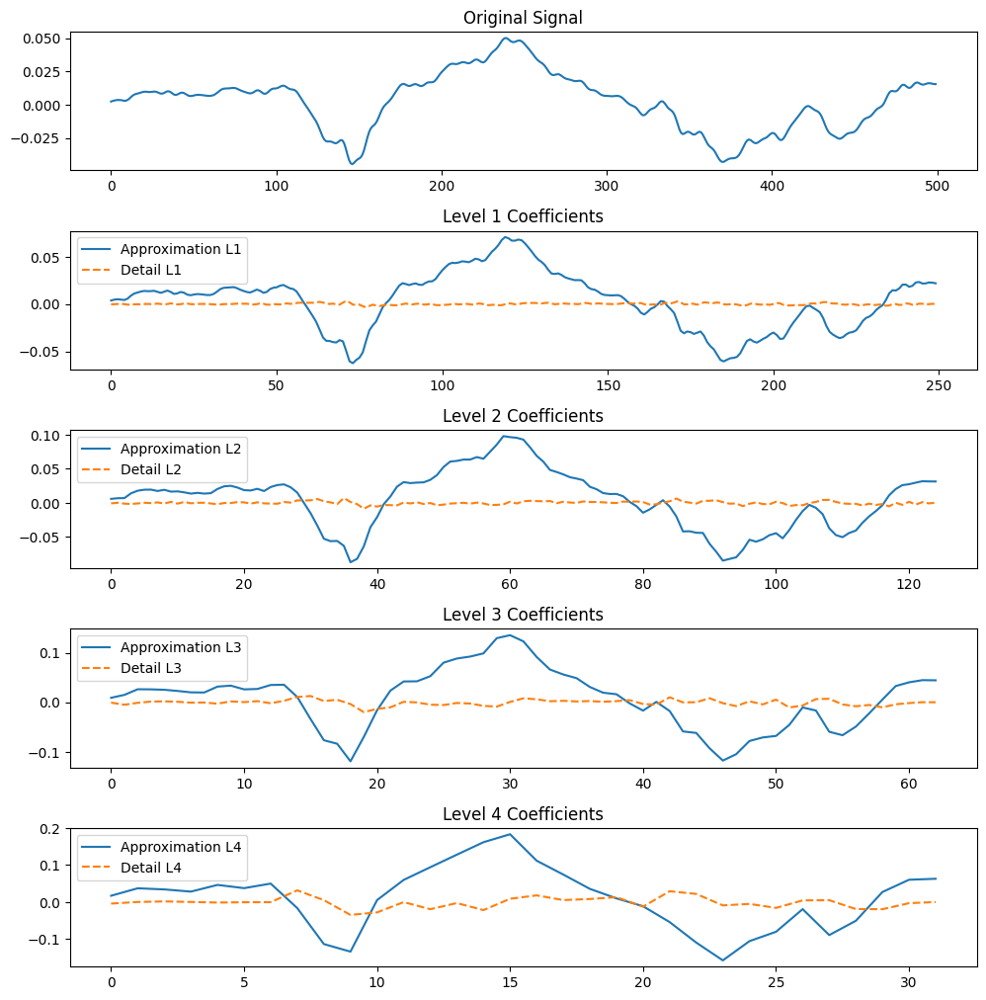

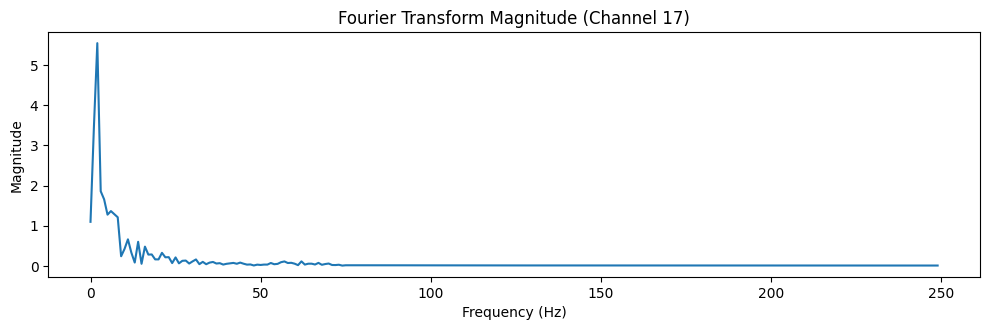

Plotting Channel 18


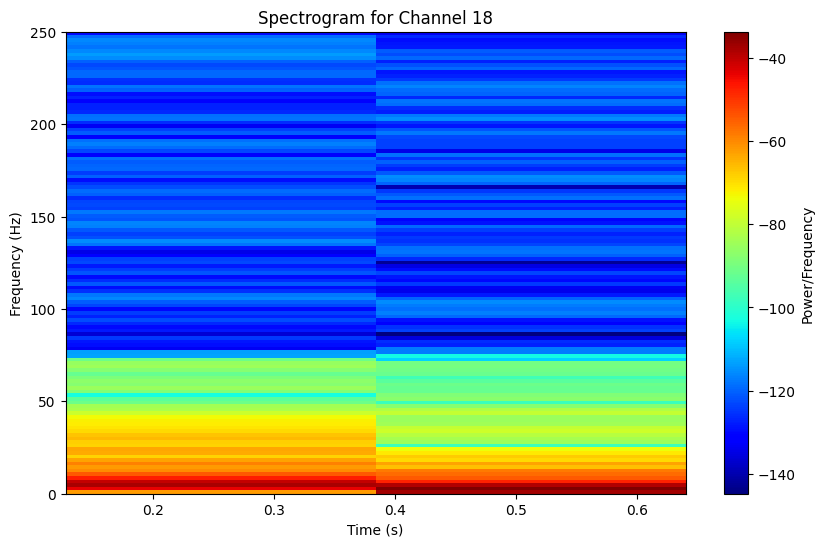

Most similar coefficient to the original signal (Channel 18): Approximation L4 with similarity: 0.005152129331715056
Similarity Scores:
Level 1 -> Approximation Similarity: -0.07427131511550887, Detail Similarity: -0.2699139082479159
Level 2 -> Approximation Similarity: -0.0615240679325592, Detail Similarity: -0.009960182735746833
Level 3 -> Approximation Similarity: -0.006150238012489151, Detail Similarity: 0.002951489244079554
Level 4 -> Approximation Similarity: 0.005152129331715056, Detail Similarity: -0.0015975618809336593


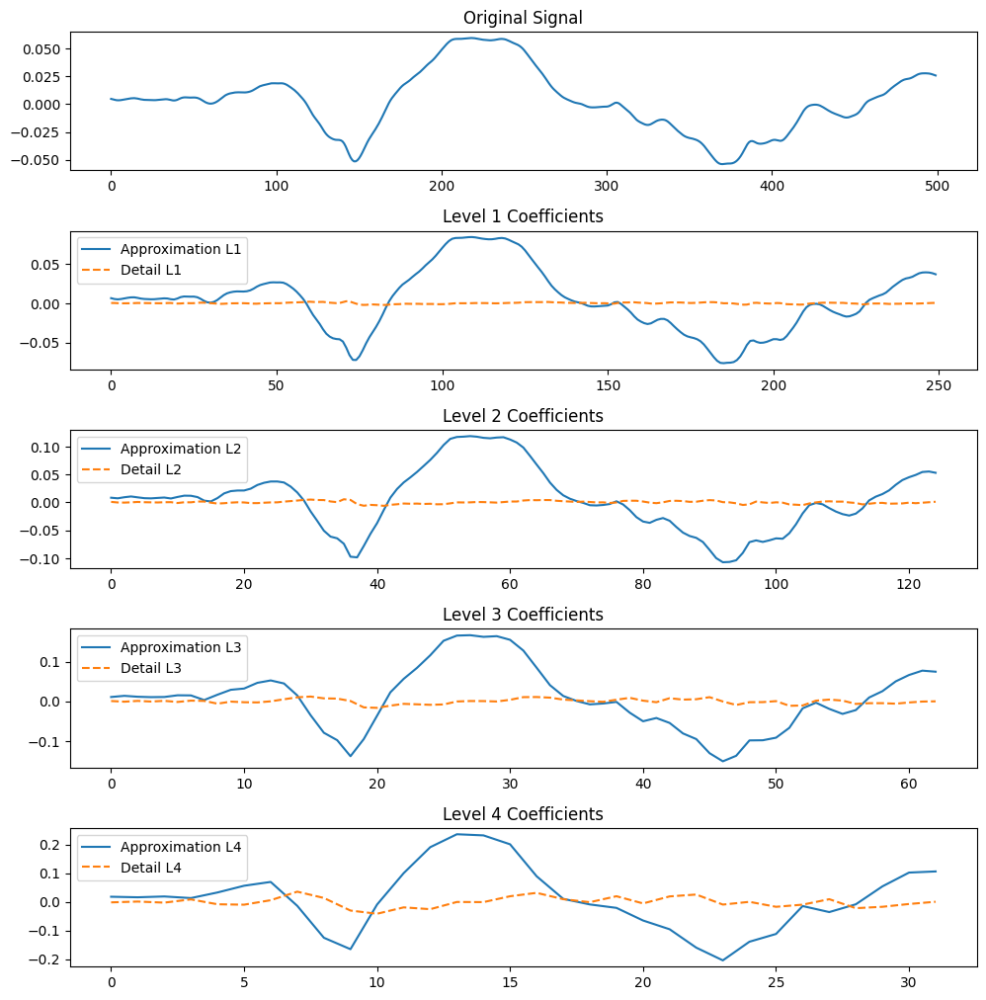

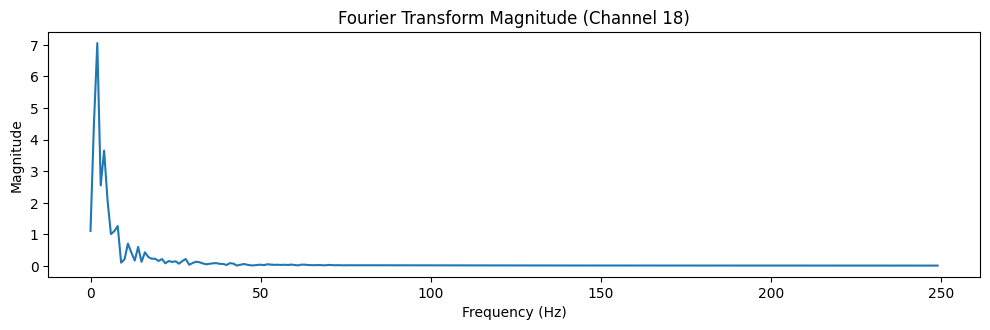

Plotting Channel 19


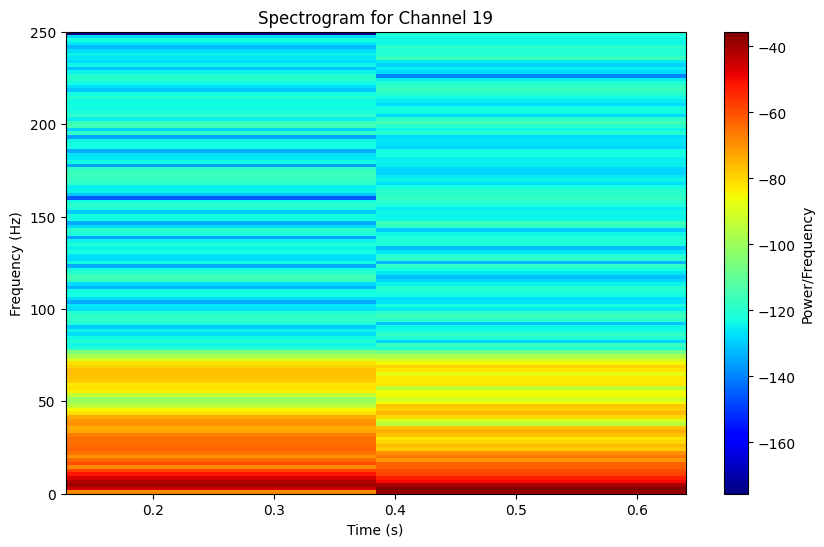

Most similar coefficient to the original signal (Channel 19): Approximation L3 with similarity: 0.00805213346329385
Similarity Scores:
Level 1 -> Approximation Similarity: -0.09514533108296717, Detail Similarity: -0.2166443352547522
Level 2 -> Approximation Similarity: -0.03811006702418699, Detail Similarity: -0.004589669301328377
Level 3 -> Approximation Similarity: 0.00805213346329385, Detail Similarity: -0.0009317146906720949
Level 4 -> Approximation Similarity: 0.0011648357511585348, Detail Similarity: 0.0010116754468709422


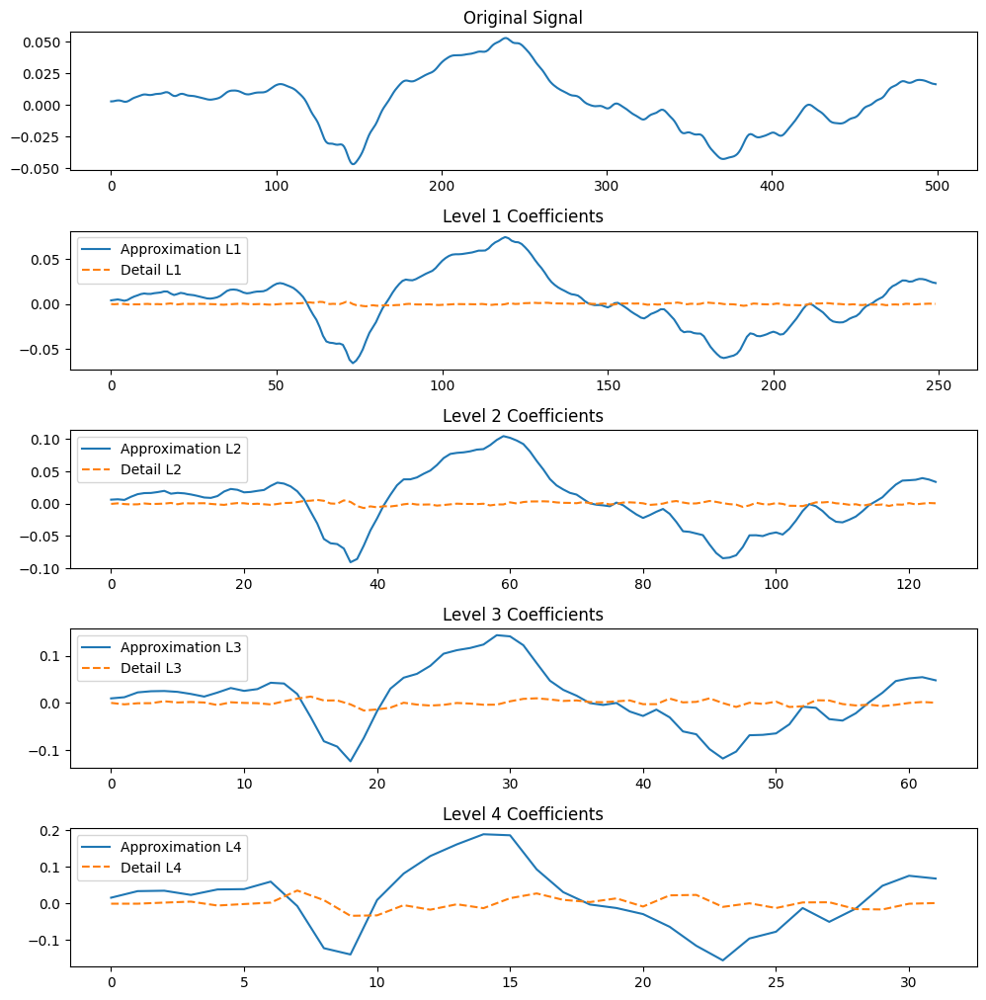

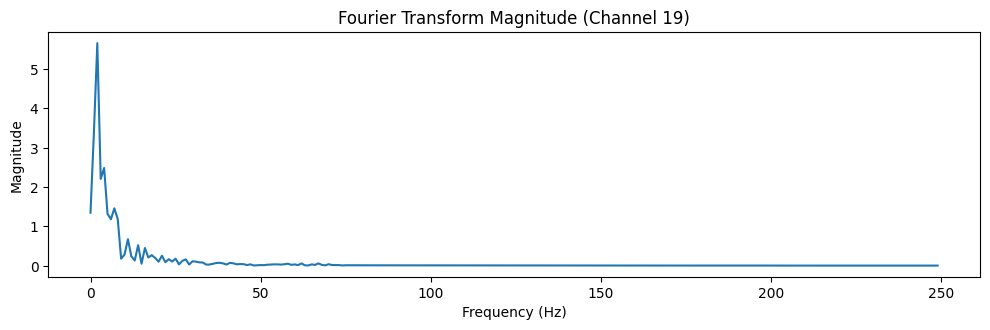

Features saved to Complex_Partial_Seizures_features.csv


In [25]:
print("Complex Partial Seizures Analysis")
cps_features = analyze_data(cps_dataset, "Complex_Partial_Seizures")


Video Detected Seizures Analysis
Analyzing Video_Detected_Seizures: 2043
Plotting Channel 1


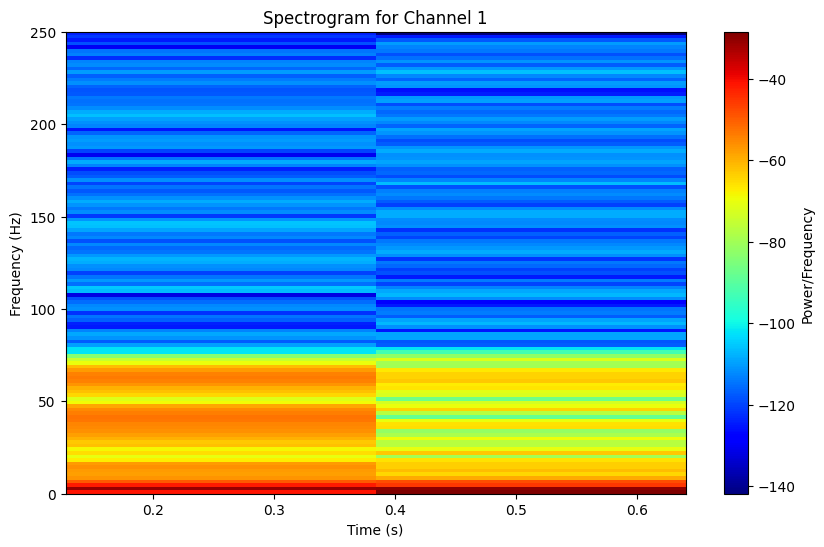

Most similar coefficient to the original signal (Channel 1): Approximation L1 with similarity: 0.28059394352158834
Similarity Scores:
Level 1 -> Approximation Similarity: 0.28059394352158834, Detail Similarity: 0.1108459908535173
Level 2 -> Approximation Similarity: -0.2107242119785339, Detail Similarity: 0.04237657856486107
Level 3 -> Approximation Similarity: -0.19578862338622086, Detail Similarity: 0.06750384611826418
Level 4 -> Approximation Similarity: -0.11300185043579591, Detail Similarity: 0.038054717192552164


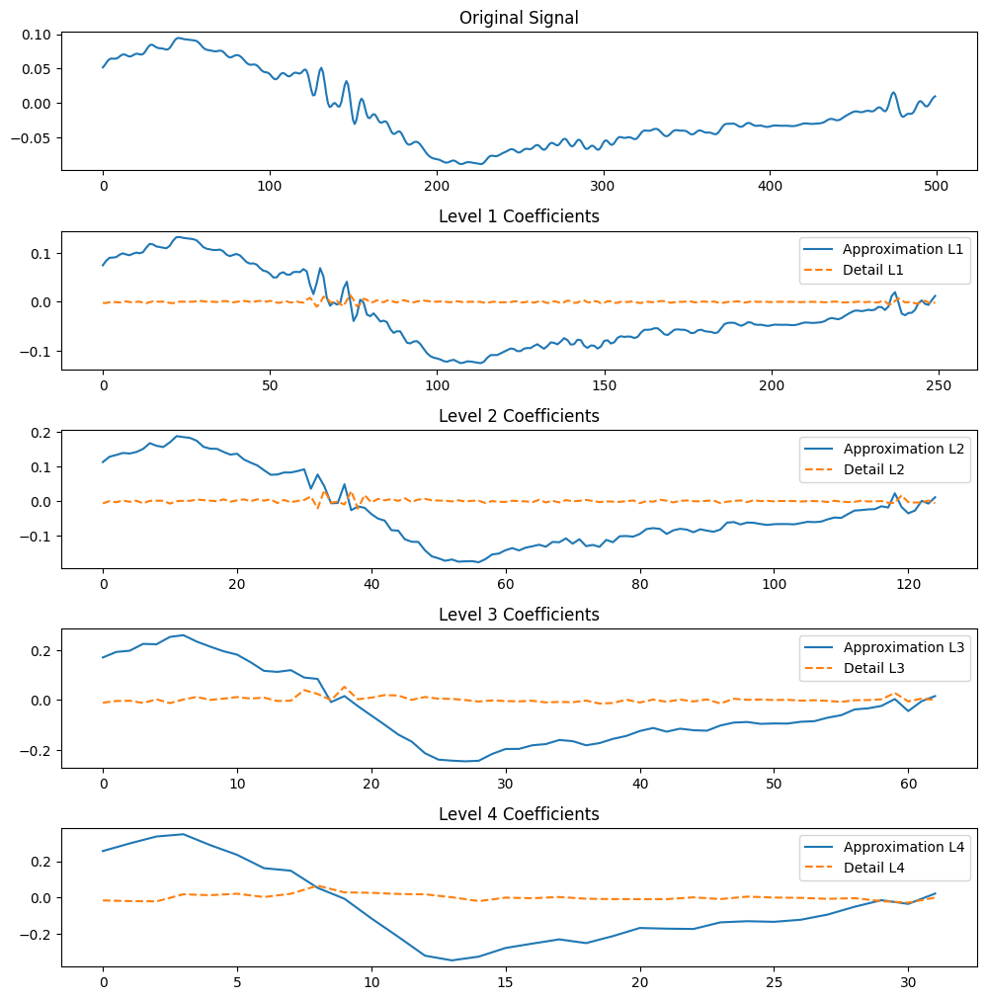

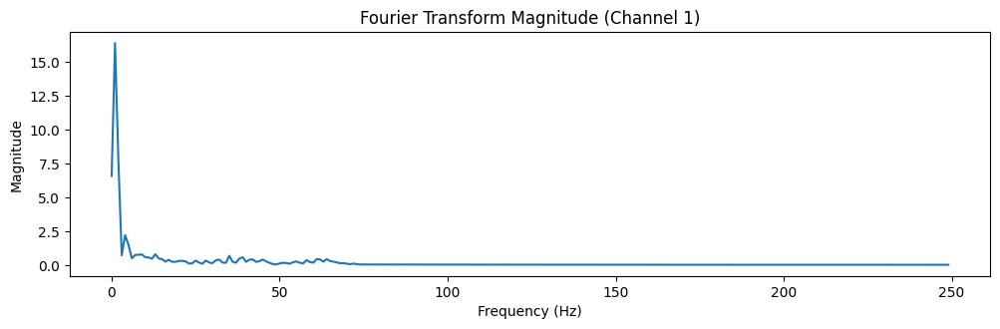

Plotting Channel 2


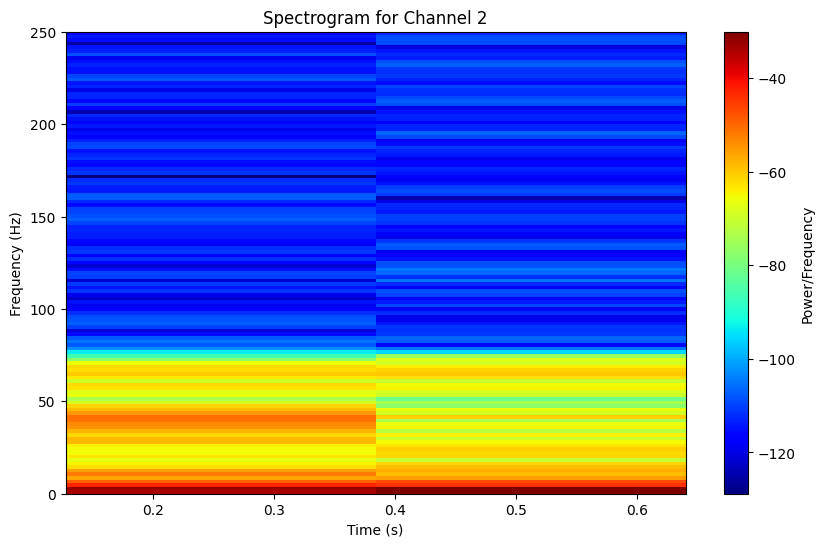

Most similar coefficient to the original signal (Channel 2): Detail L1 with similarity: 0.04611897545521759
Similarity Scores:
Level 1 -> Approximation Similarity: -0.2621656437078235, Detail Similarity: 0.04611897545521759
Level 2 -> Approximation Similarity: -0.20486196277025218, Detail Similarity: -0.014073759415559288
Level 3 -> Approximation Similarity: -0.027990573697185224, Detail Similarity: -0.0360897238686395
Level 4 -> Approximation Similarity: 0.007730642964397814, Detail Similarity: -0.0032159165813021996


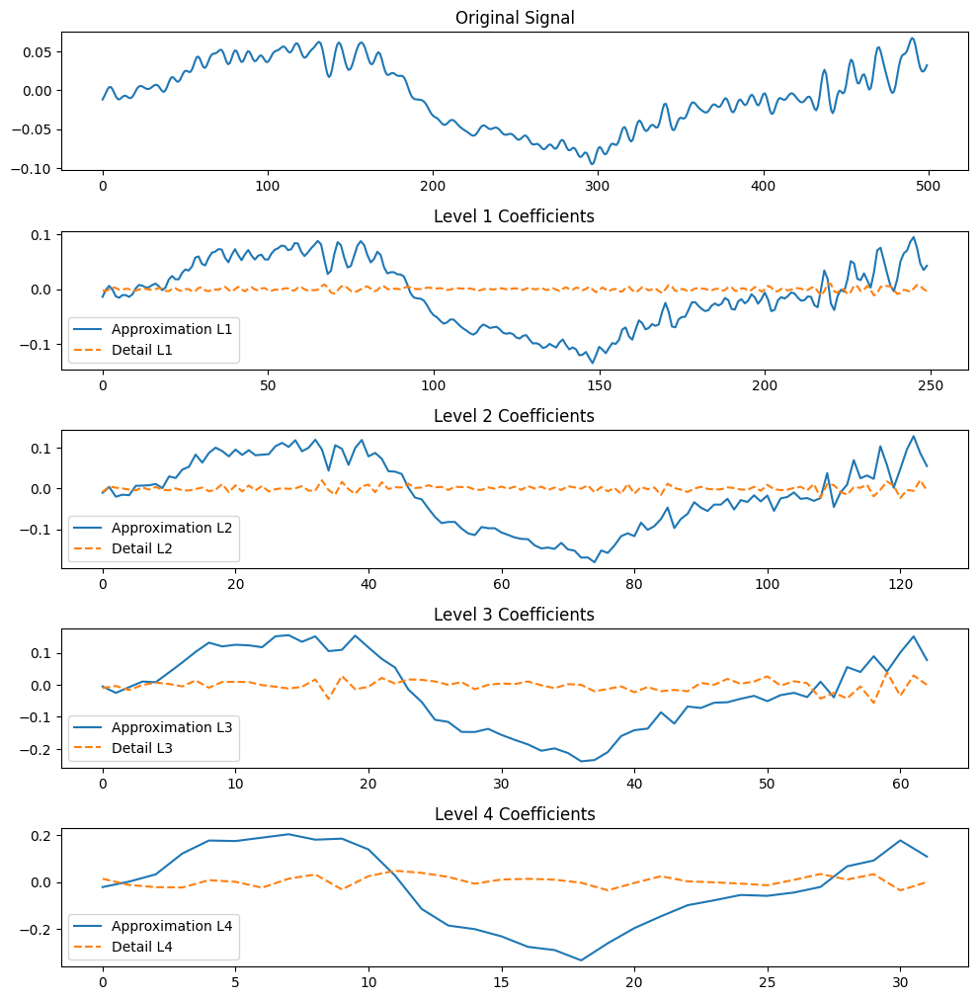

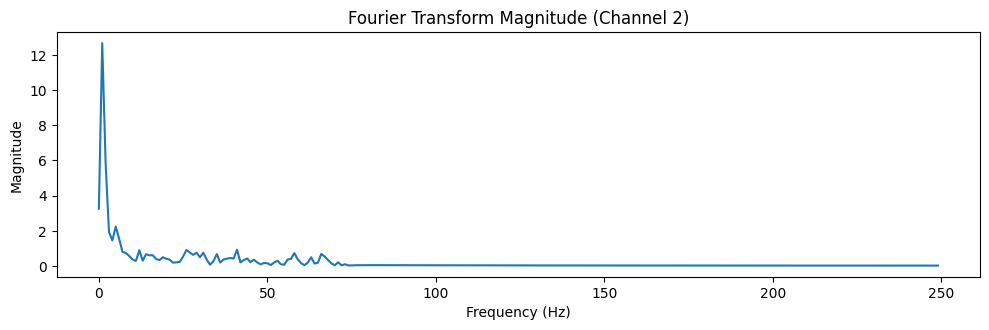

Plotting Channel 3


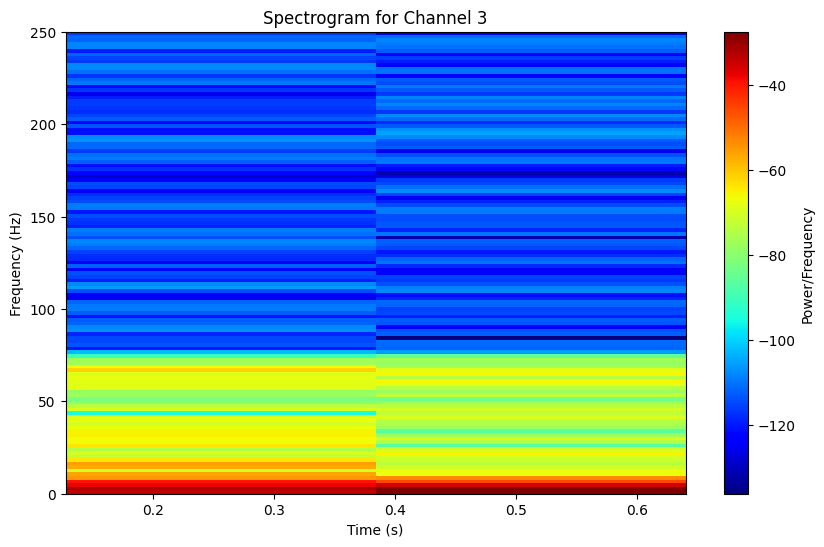

Most similar coefficient to the original signal (Channel 3): Approximation L1 with similarity: 0.4058917548294421
Similarity Scores:
Level 1 -> Approximation Similarity: 0.4058917548294421, Detail Similarity: 0.3311890378053134
Level 2 -> Approximation Similarity: -0.12325273298622309, Detail Similarity: 0.25683426288095484
Level 3 -> Approximation Similarity: -0.20599875082483166, Detail Similarity: 0.10451448596264898
Level 4 -> Approximation Similarity: -0.11909709779340728, Detail Similarity: 0.07872684338962183


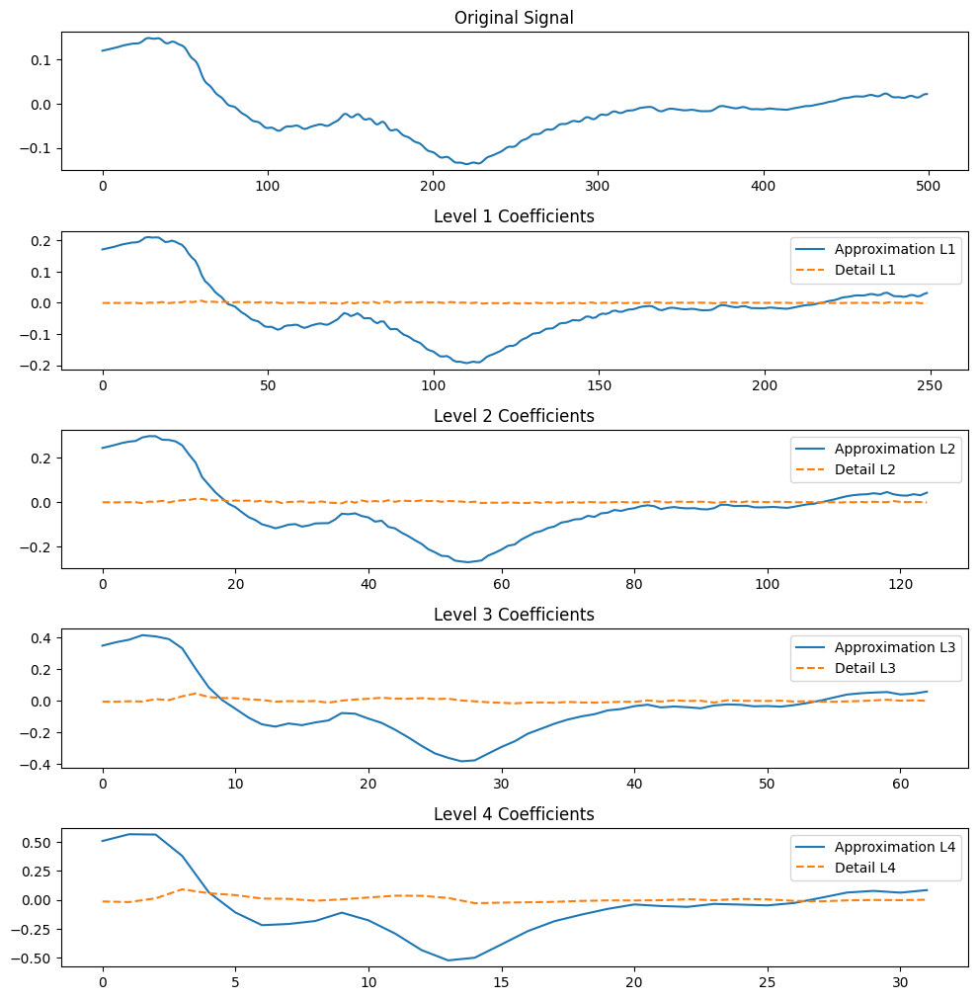

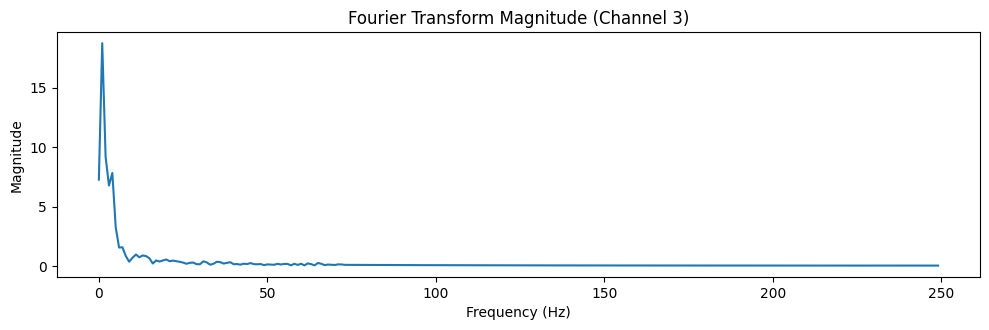

Plotting Channel 4


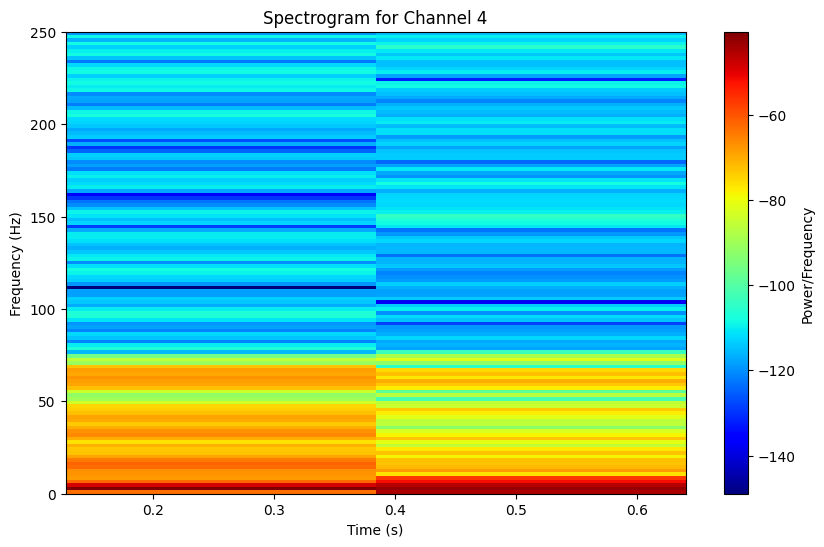

Most similar coefficient to the original signal (Channel 4): Approximation L1 with similarity: 0.1756527643239481
Similarity Scores:
Level 1 -> Approximation Similarity: 0.1756527643239481, Detail Similarity: 0.09406479211541233
Level 2 -> Approximation Similarity: -0.2325623304625957, Detail Similarity: 0.015913504584328855
Level 3 -> Approximation Similarity: -0.13332214621956376, Detail Similarity: 0.007138609153316484
Level 4 -> Approximation Similarity: -0.04939704618304051, Detail Similarity: 0.030656314577485116


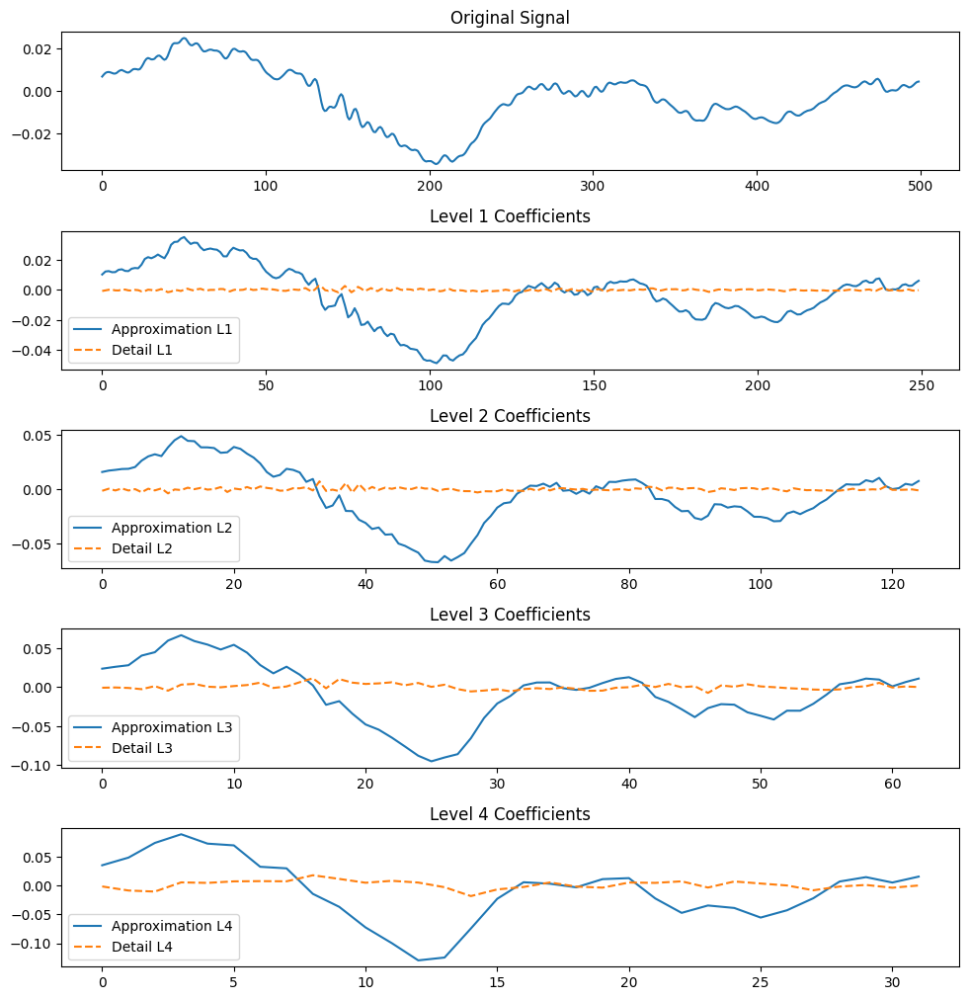

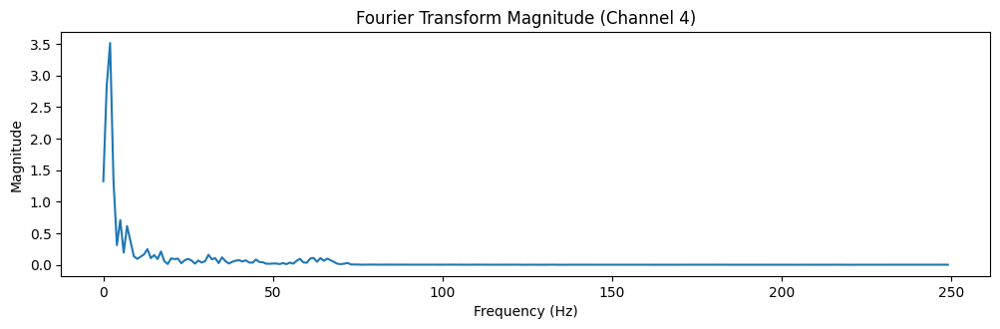

Plotting Channel 5


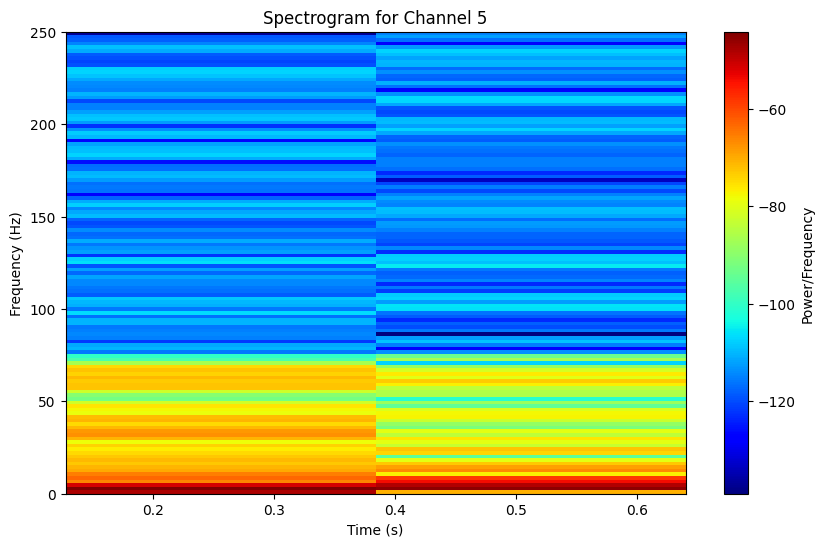

Most similar coefficient to the original signal (Channel 5): Detail L1 with similarity: 0.05686633837682465
Similarity Scores:
Level 1 -> Approximation Similarity: -0.006040801117712912, Detail Similarity: 0.05686633837682465
Level 2 -> Approximation Similarity: -0.11431343926881135, Detail Similarity: -0.005872996355370137
Level 3 -> Approximation Similarity: -0.023494412201987055, Detail Similarity: -0.037126192310898205
Level 4 -> Approximation Similarity: 0.013749320124118194, Detail Similarity: -0.006323537474768433


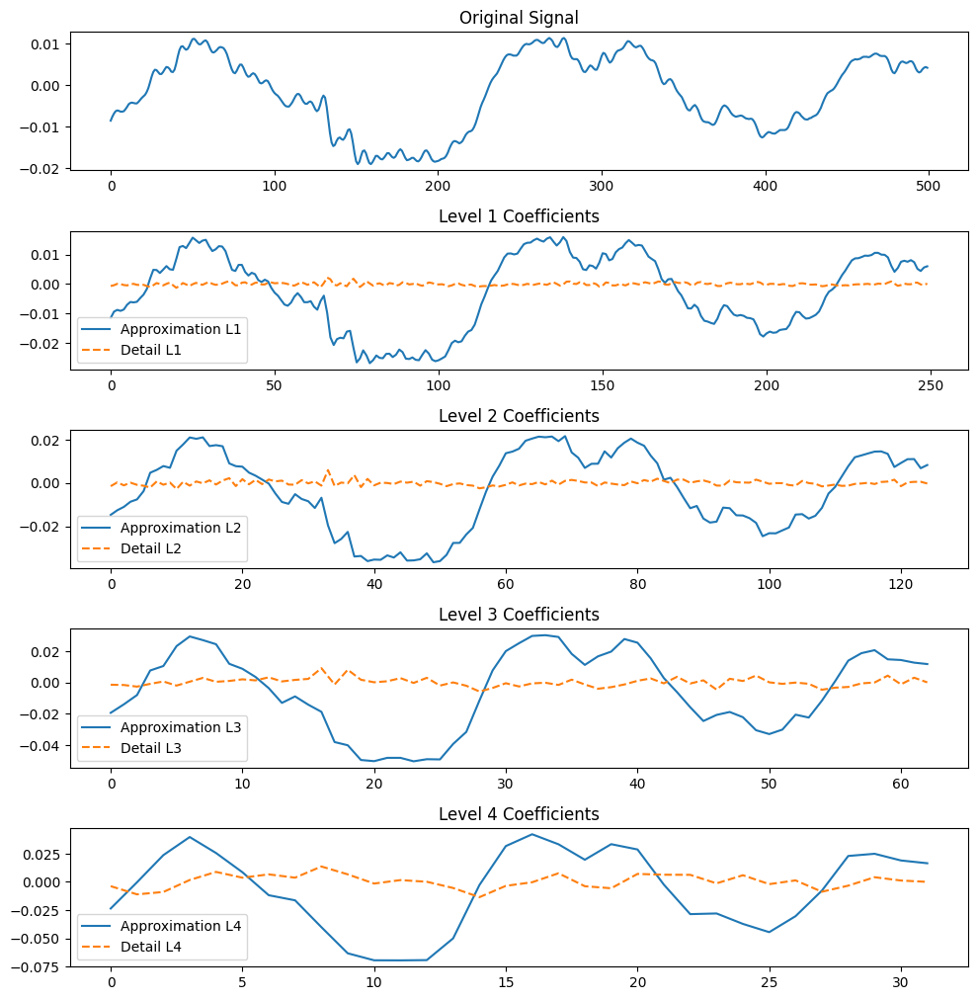

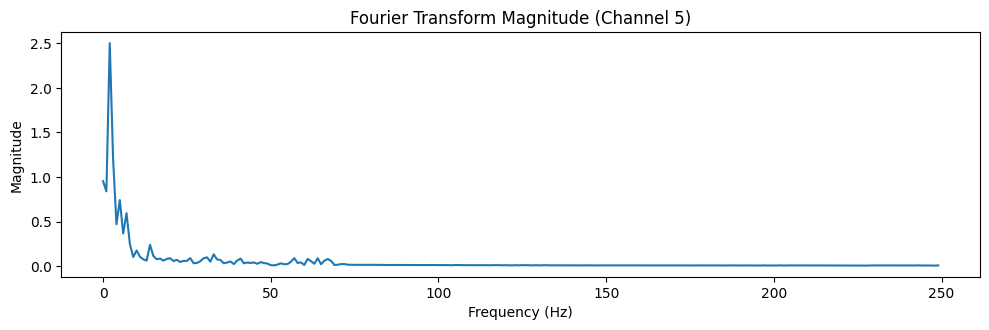

Plotting Channel 6


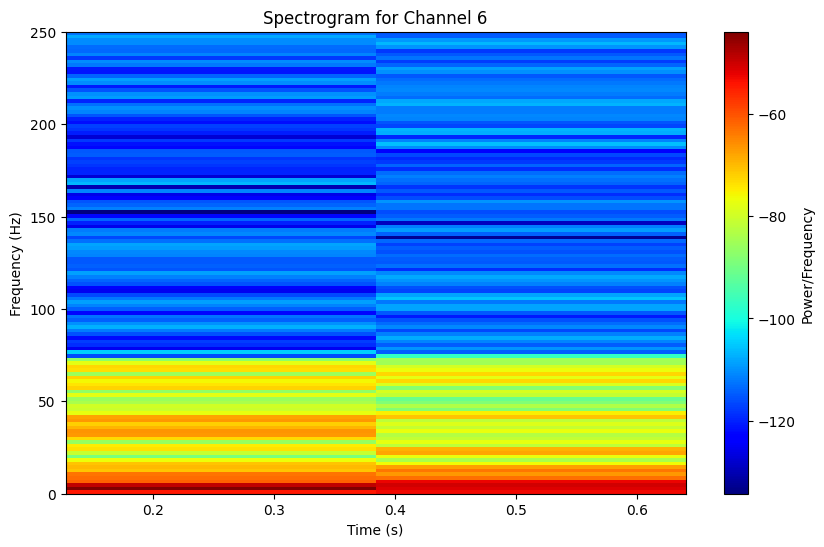

Most similar coefficient to the original signal (Channel 6): Approximation L1 with similarity: 0.10411482847629082
Similarity Scores:
Level 1 -> Approximation Similarity: 0.10411482847629082, Detail Similarity: 0.06559653414099036
Level 2 -> Approximation Similarity: -0.22362368195554072, Detail Similarity: 0.014712494394367885
Level 3 -> Approximation Similarity: -0.09133255595432449, Detail Similarity: -0.054825657975214714
Level 4 -> Approximation Similarity: 7.118368723242029e-05, Detail Similarity: 0.0037493505054075472


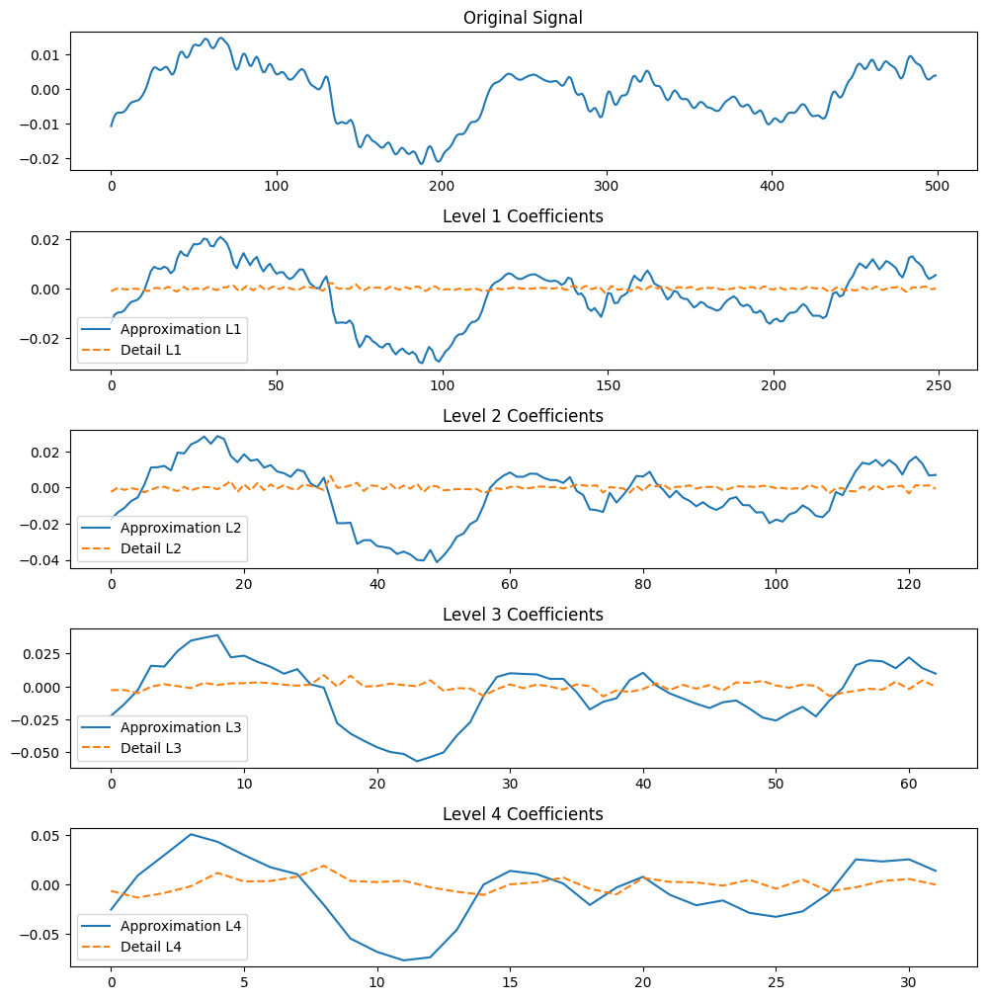

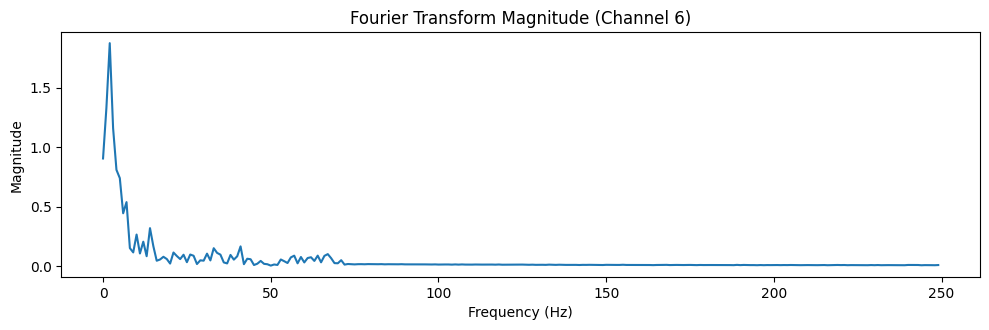

Plotting Channel 7


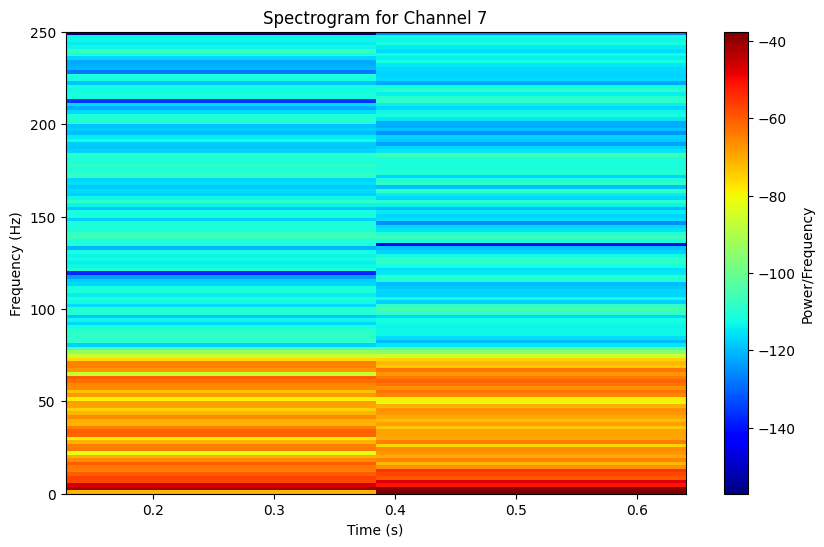

Most similar coefficient to the original signal (Channel 7): Detail L1 with similarity: 0.06689135851384692
Similarity Scores:
Level 1 -> Approximation Similarity: -0.16691965132266914, Detail Similarity: 0.06689135851384692
Level 2 -> Approximation Similarity: -0.1327950403290895, Detail Similarity: -0.005228239438279219
Level 3 -> Approximation Similarity: -0.030067130865059414, Detail Similarity: 0.005748299755704288
Level 4 -> Approximation Similarity: 0.028479529668063577, Detail Similarity: -0.013396590029996401


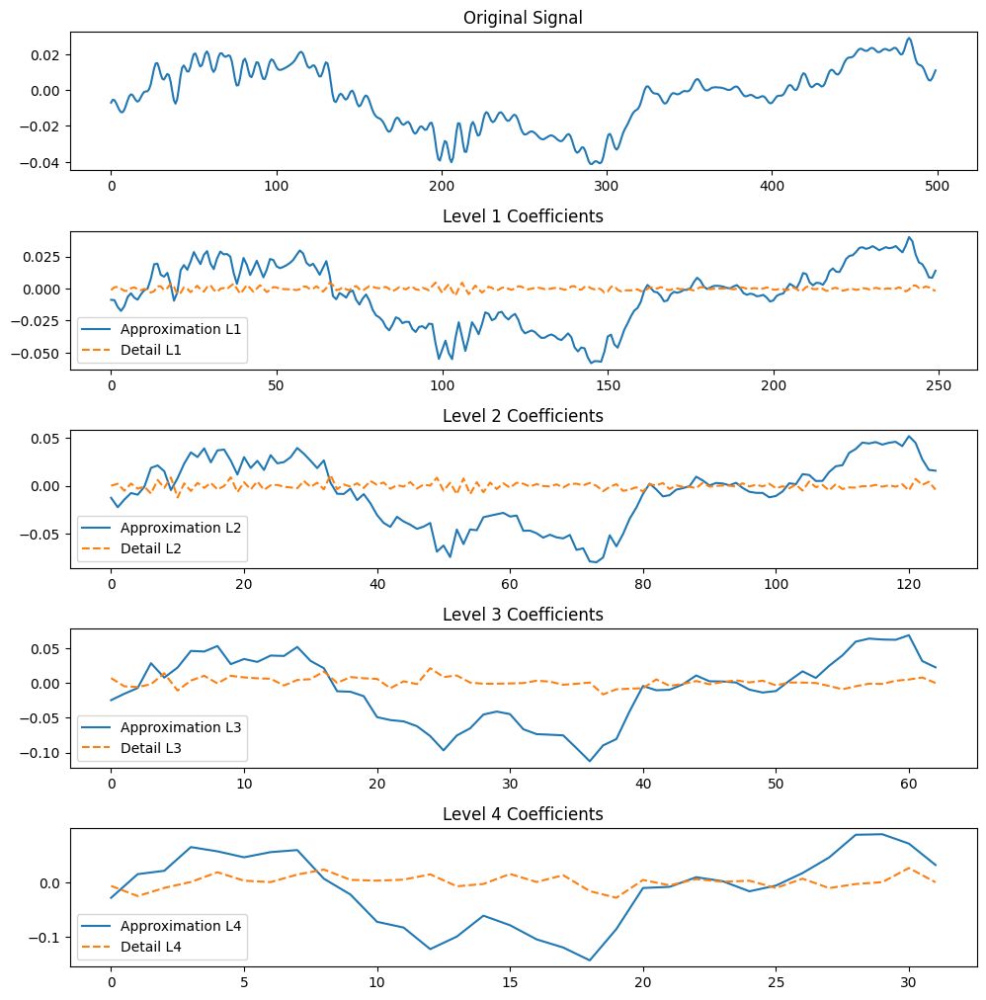

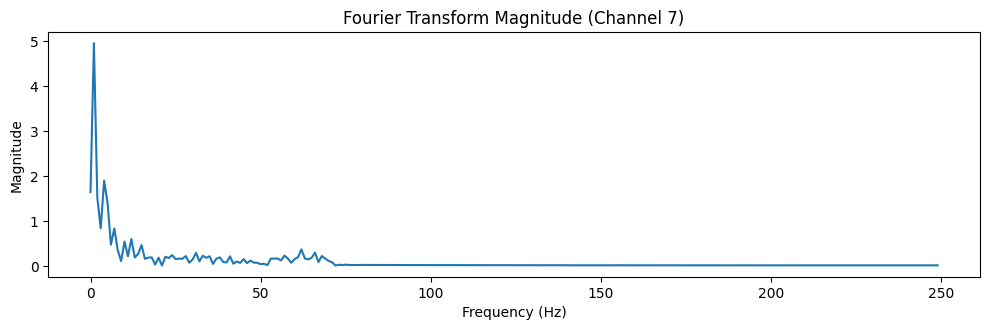

Plotting Channel 8


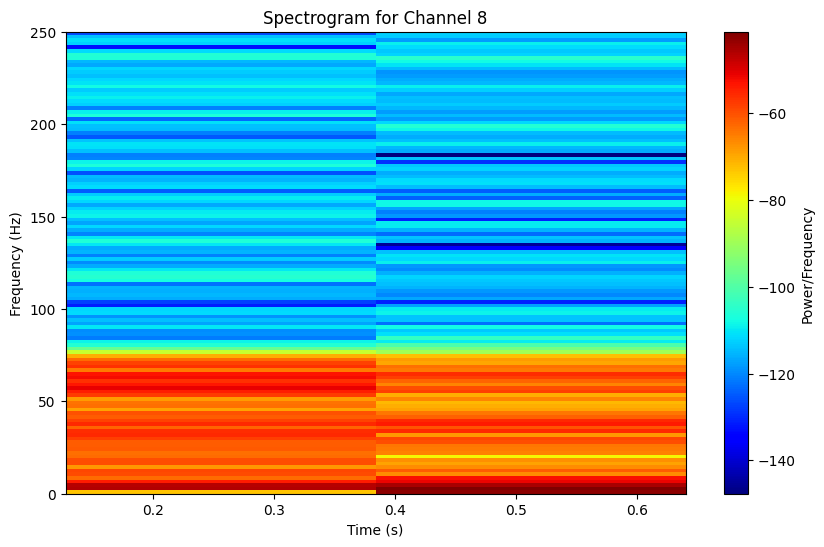

Most similar coefficient to the original signal (Channel 8): Approximation L1 with similarity: 0.23800657274850384
Similarity Scores:
Level 1 -> Approximation Similarity: 0.23800657274850384, Detail Similarity: 0.02378463369205804
Level 2 -> Approximation Similarity: -0.0034766173485121224, Detail Similarity: 0.00802127693392983
Level 3 -> Approximation Similarity: -0.007120576961810553, Detail Similarity: 0.035673285913362655
Level 4 -> Approximation Similarity: 0.019089465143718613, Detail Similarity: 0.03985991154496001


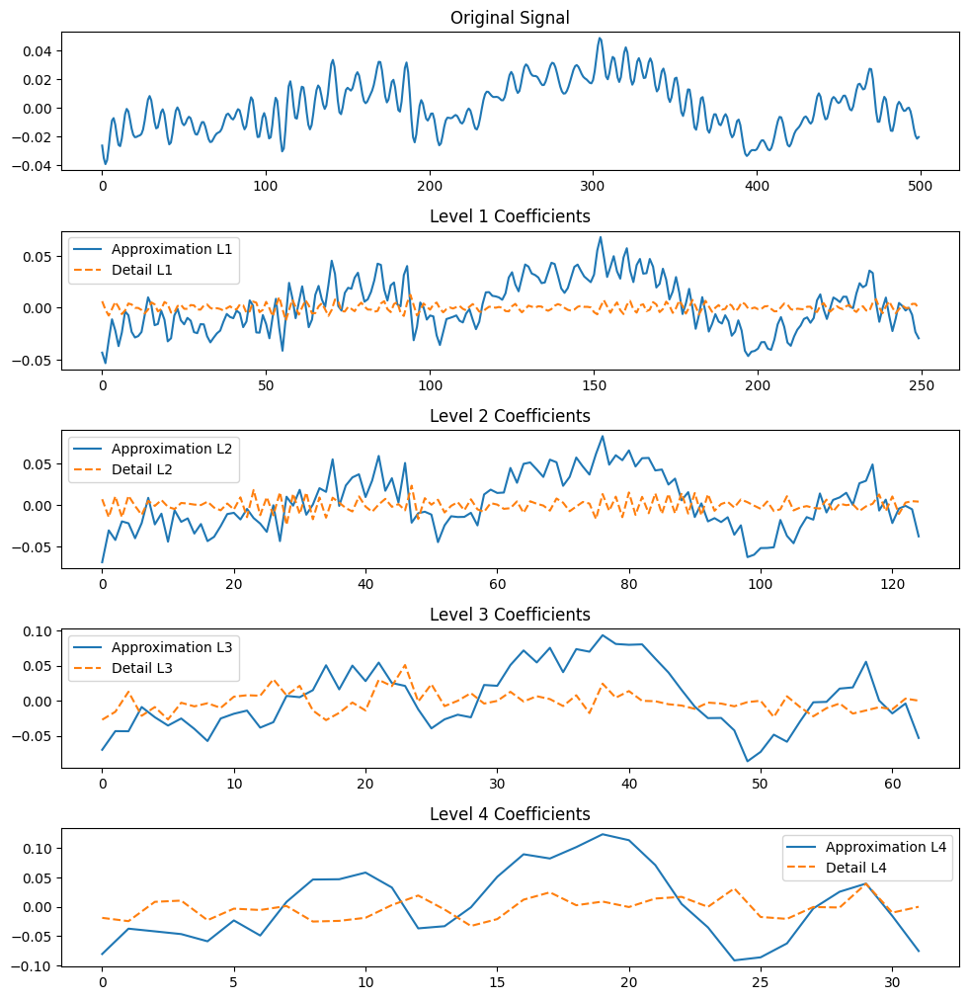

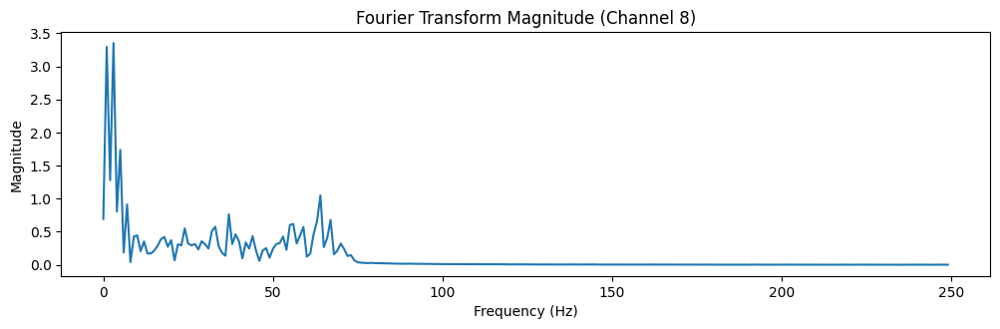

Plotting Channel 9


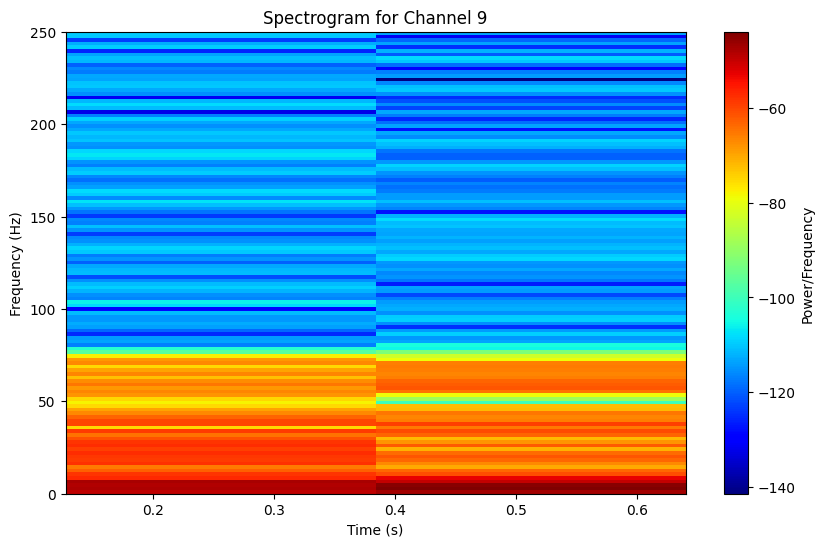

Most similar coefficient to the original signal (Channel 9): Approximation L1 with similarity: 0.46744516182857987
Similarity Scores:
Level 1 -> Approximation Similarity: 0.46744516182857987, Detail Similarity: 0.07751304543536623
Level 2 -> Approximation Similarity: 0.10327154538943954, Detail Similarity: 0.04215182045654851
Level 3 -> Approximation Similarity: -0.14232562332685775, Detail Similarity: 0.030107825714624756
Level 4 -> Approximation Similarity: -0.11696110380179738, Detail Similarity: 0.006449064290177795


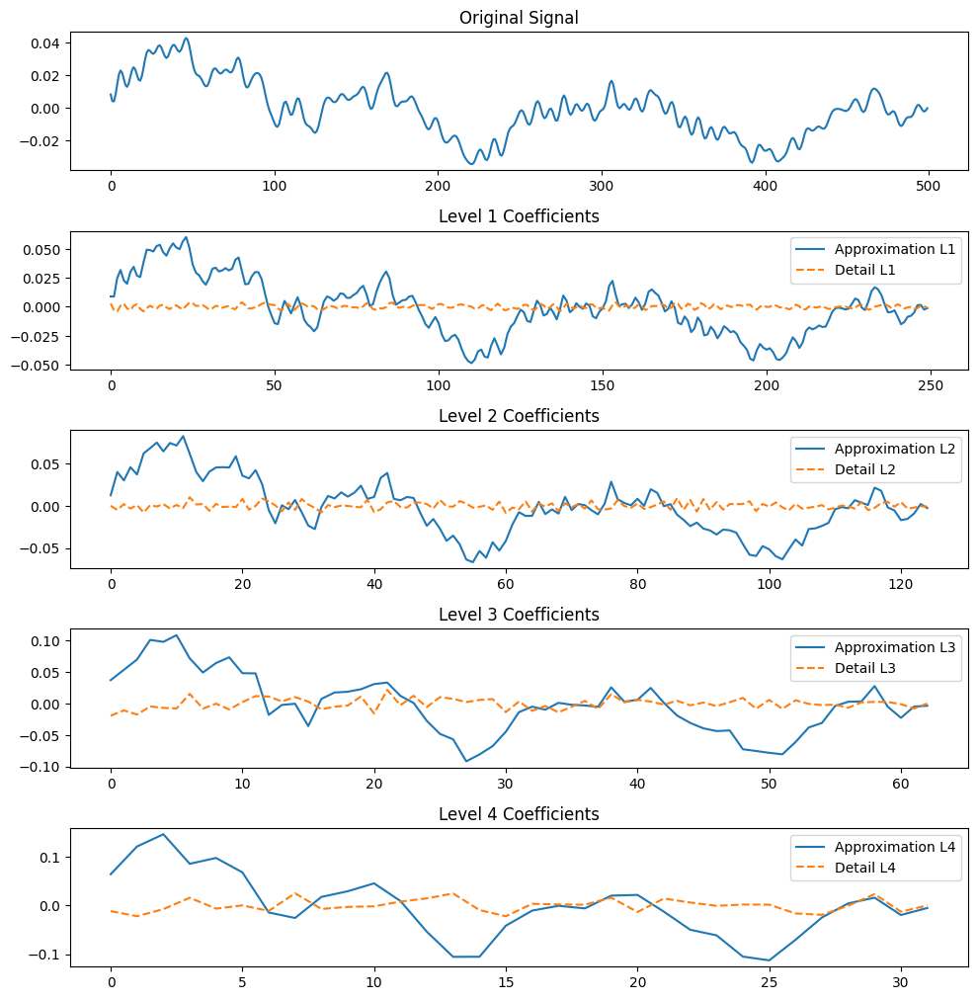

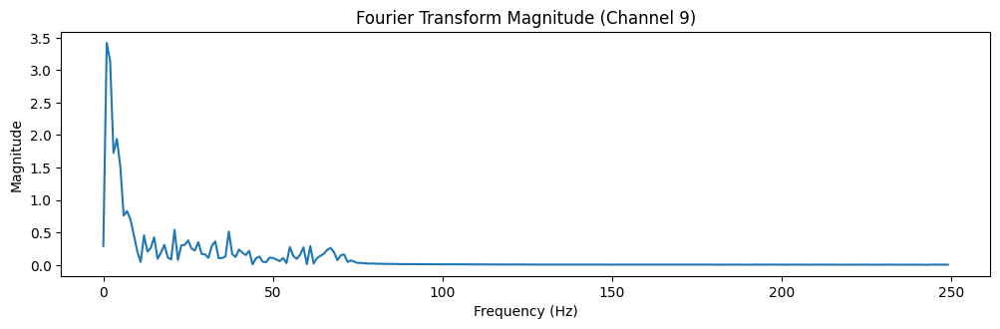

Plotting Channel 10


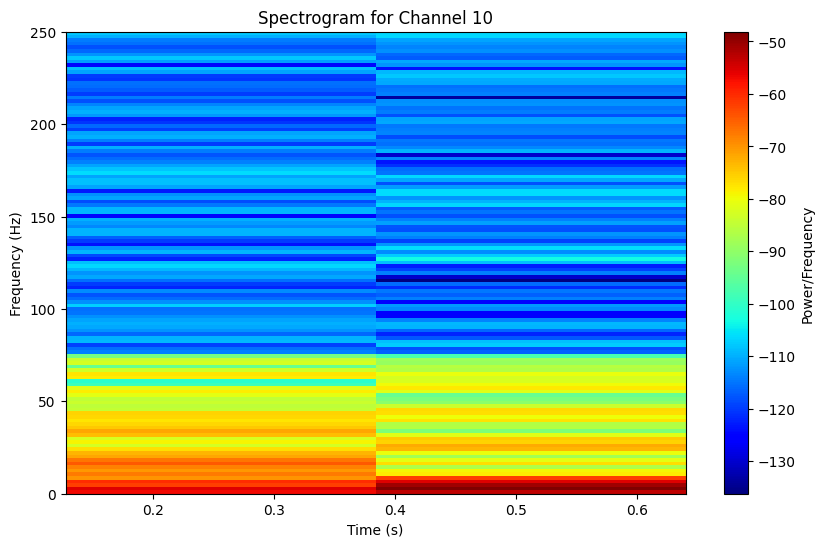

Most similar coefficient to the original signal (Channel 10): Approximation L2 with similarity: 0.13302493663917087
Similarity Scores:
Level 1 -> Approximation Similarity: -0.023422475463603935, Detail Similarity: 0.037308363343624466
Level 2 -> Approximation Similarity: 0.13302493663917087, Detail Similarity: -0.008588840581672747
Level 3 -> Approximation Similarity: -0.02981150861691383, Detail Similarity: 0.0019823024286584725
Level 4 -> Approximation Similarity: 0.01806863143509682, Detail Similarity: -0.016942764453080246


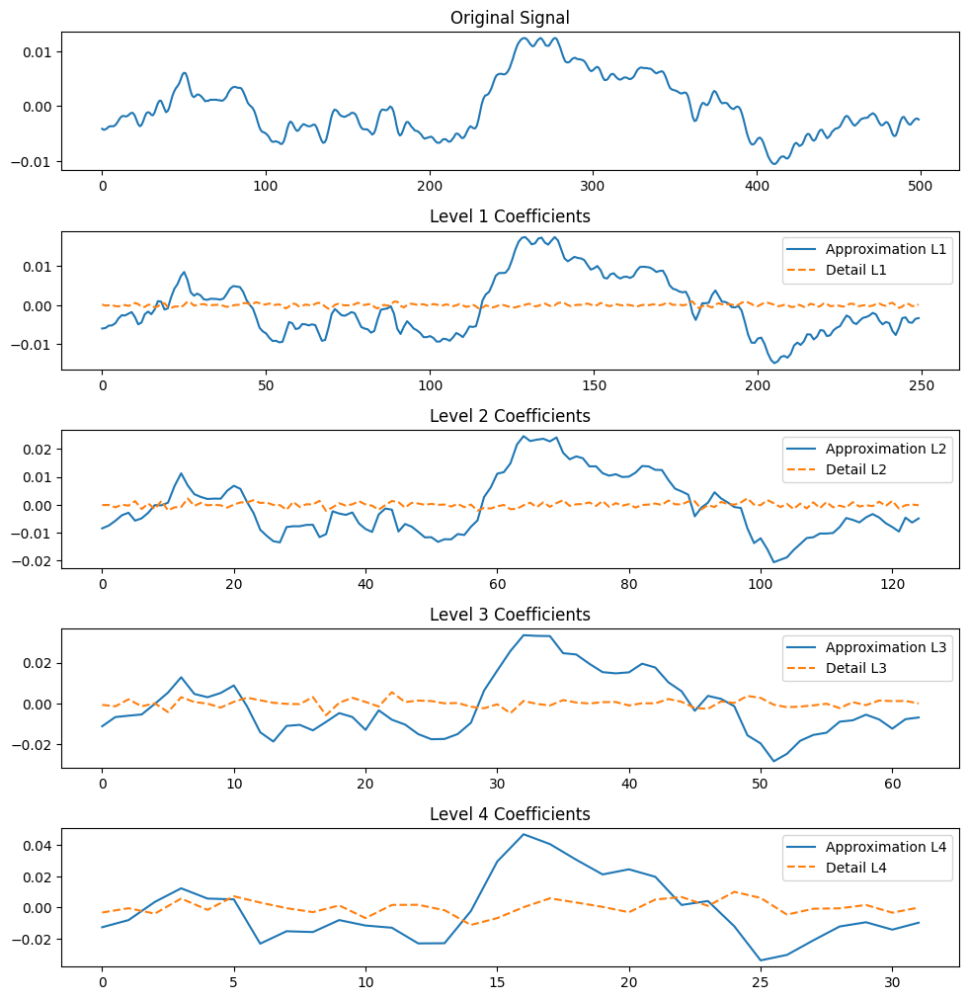

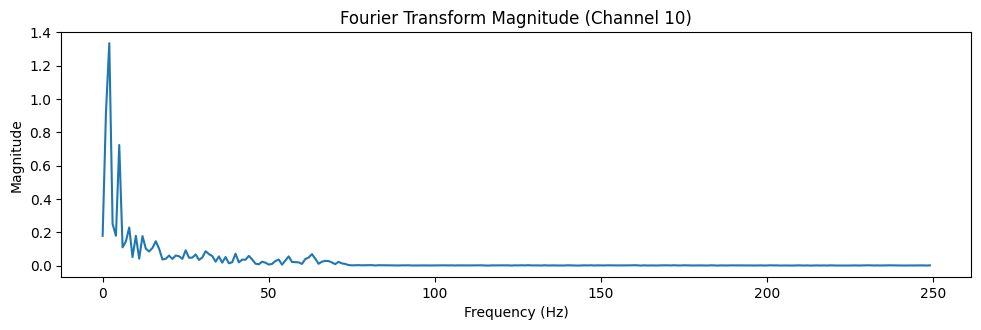

Plotting Channel 11


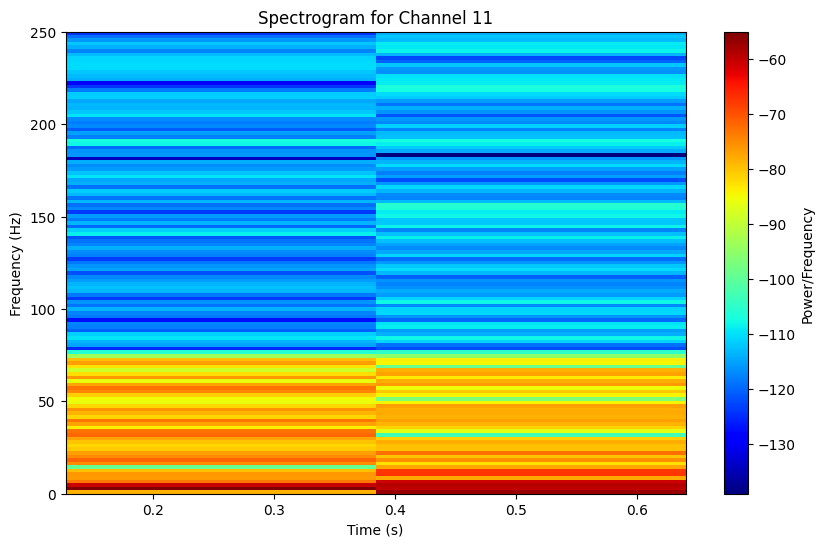

Most similar coefficient to the original signal (Channel 11): Approximation L1 with similarity: 0.15169026652779116
Similarity Scores:
Level 1 -> Approximation Similarity: 0.15169026652779116, Detail Similarity: 0.0044438062671116945
Level 2 -> Approximation Similarity: -0.25175960362319055, Detail Similarity: 0.007990646440334348
Level 3 -> Approximation Similarity: -0.23567131523962087, Detail Similarity: -0.03084329144652515
Level 4 -> Approximation Similarity: -0.1347238988261394, Detail Similarity: 0.016631654368826614


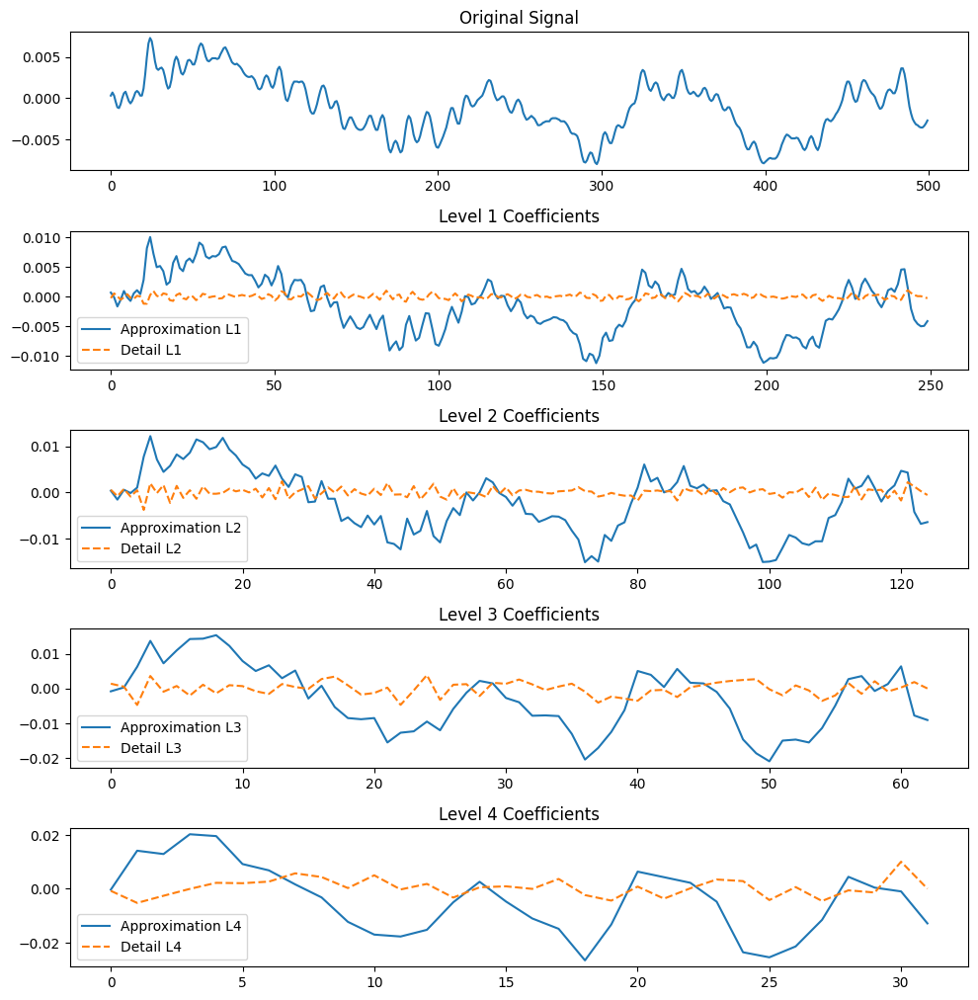

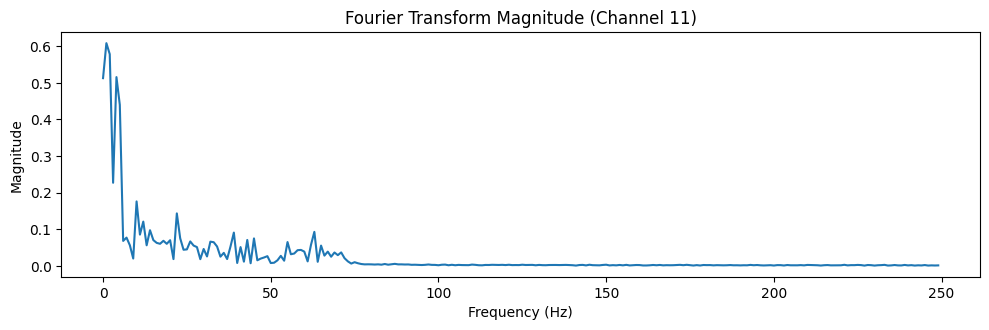

Plotting Channel 12


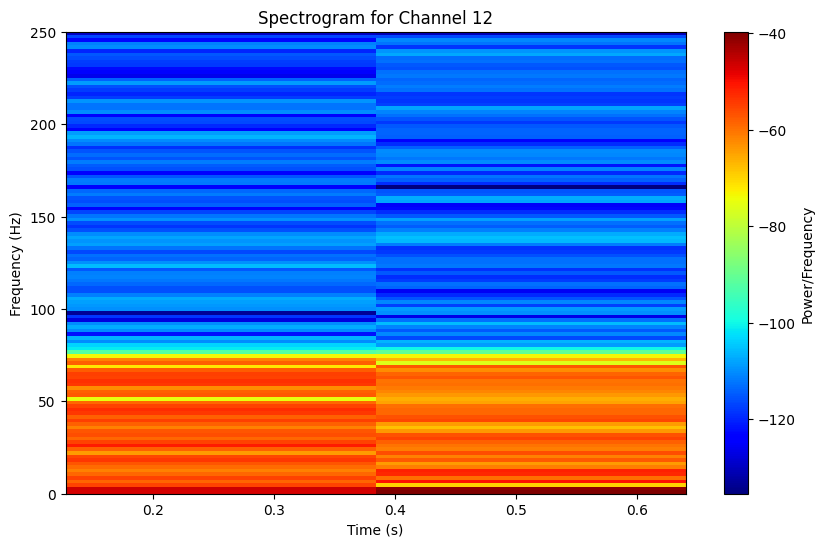

Most similar coefficient to the original signal (Channel 12): Detail L4 with similarity: 0.010245732483204513
Similarity Scores:
Level 1 -> Approximation Similarity: -0.02448031578937678, Detail Similarity: -0.009334645839799302
Level 2 -> Approximation Similarity: -0.22142115551574032, Detail Similarity: -0.003453423983755322
Level 3 -> Approximation Similarity: -0.13280499374662924, Detail Similarity: 0.009502965657454
Level 4 -> Approximation Similarity: -0.07494684190215678, Detail Similarity: 0.010245732483204513


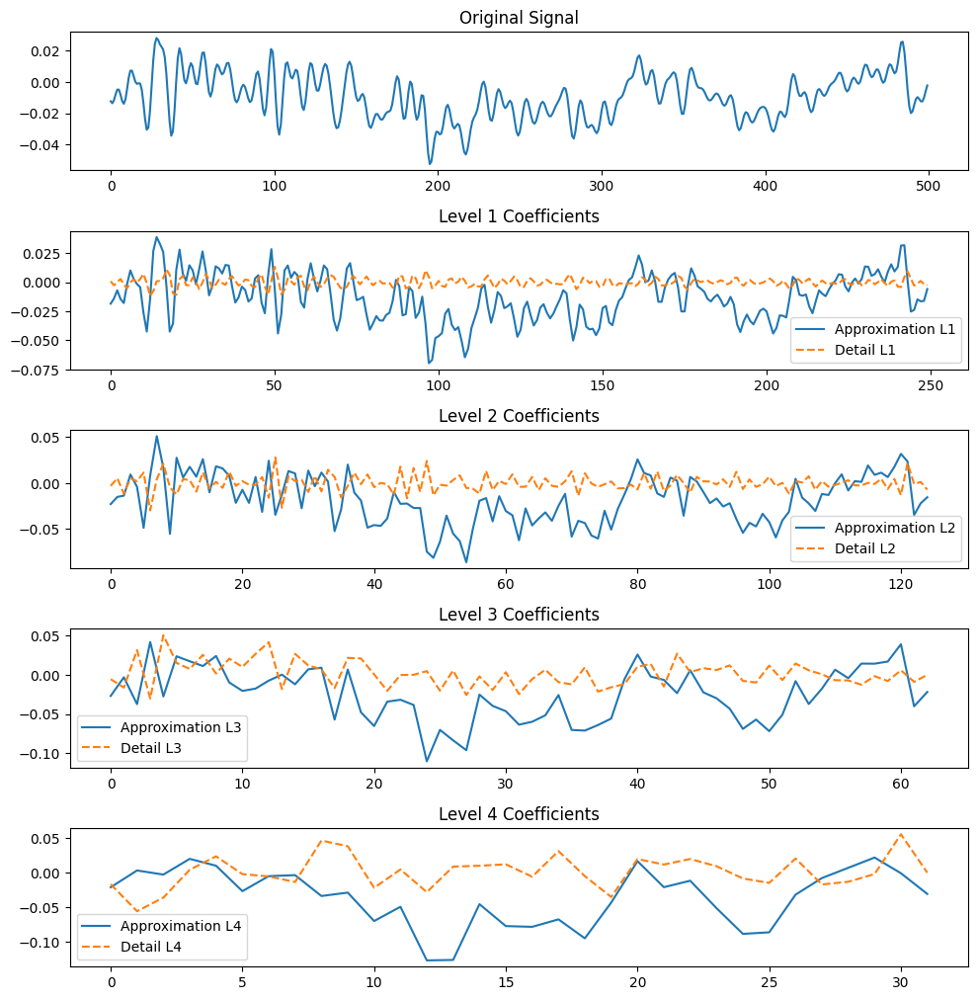

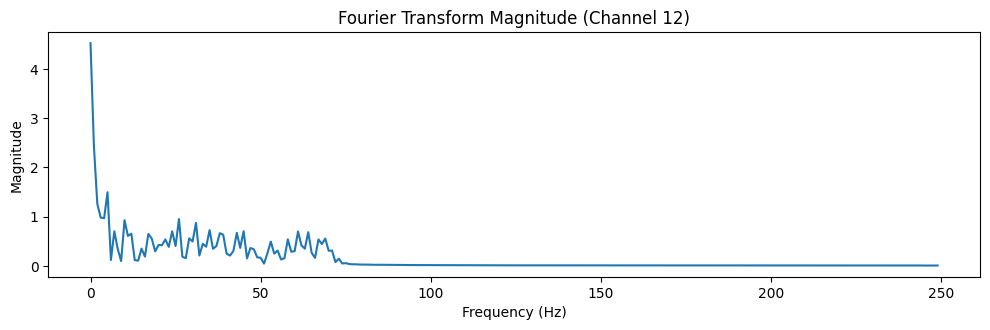

Plotting Channel 13


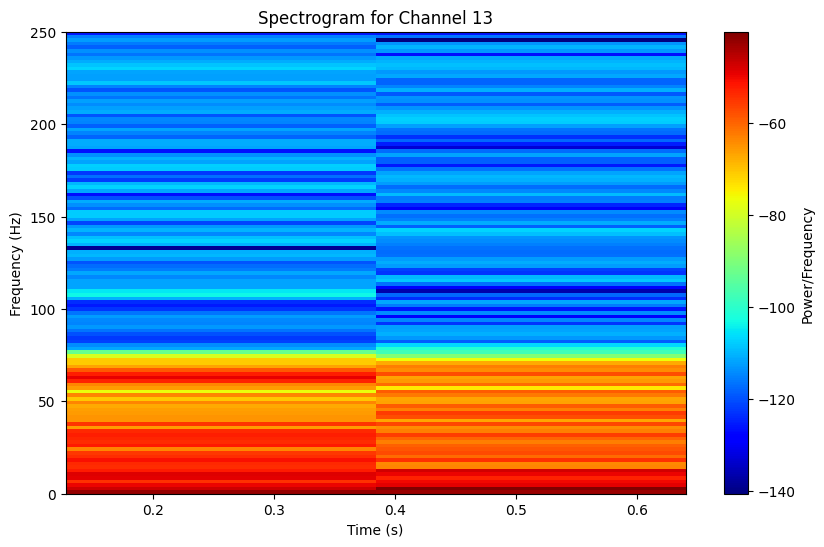

Most similar coefficient to the original signal (Channel 13): Approximation L1 with similarity: 0.1661791121698614
Similarity Scores:
Level 1 -> Approximation Similarity: 0.1661791121698614, Detail Similarity: 0.01298769212120755
Level 2 -> Approximation Similarity: -0.025697386290420014, Detail Similarity: 0.007136132827743124
Level 3 -> Approximation Similarity: -0.07081299969626105, Detail Similarity: -0.02308068150152249
Level 4 -> Approximation Similarity: 0.02648242993740344, Detail Similarity: 0.004567087268655315


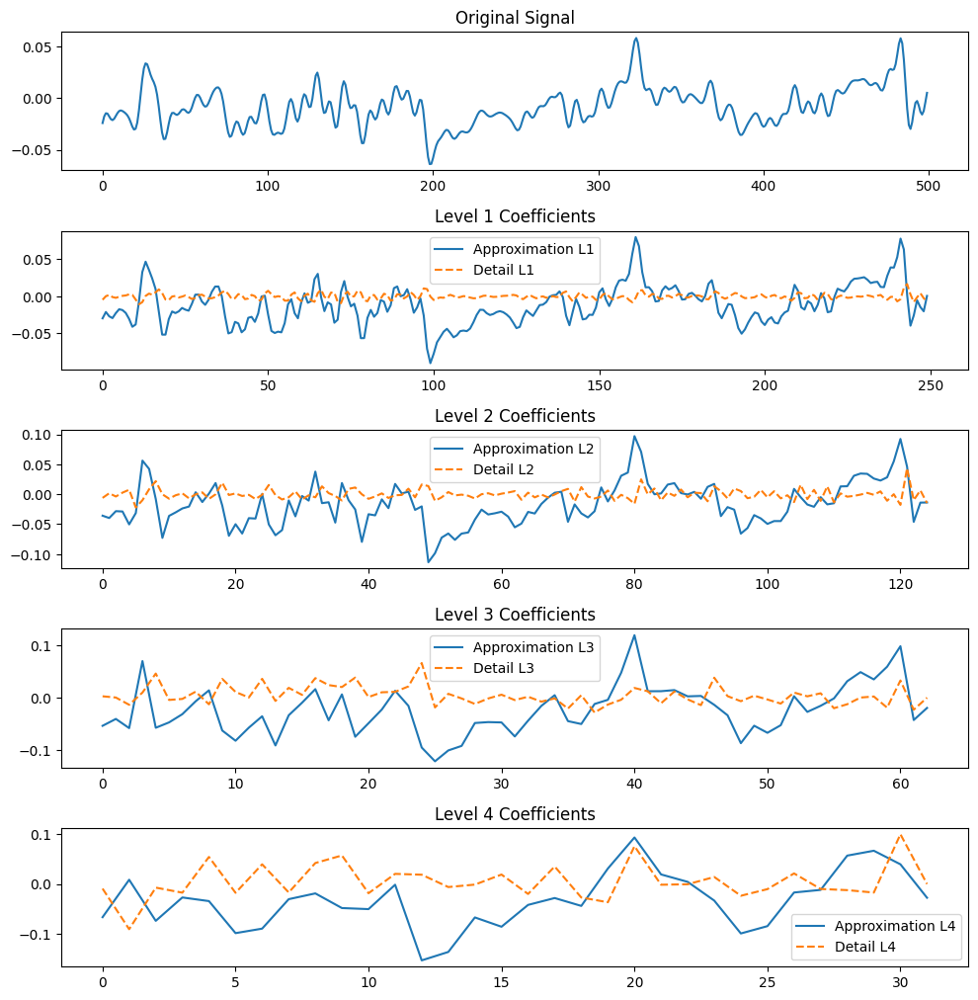

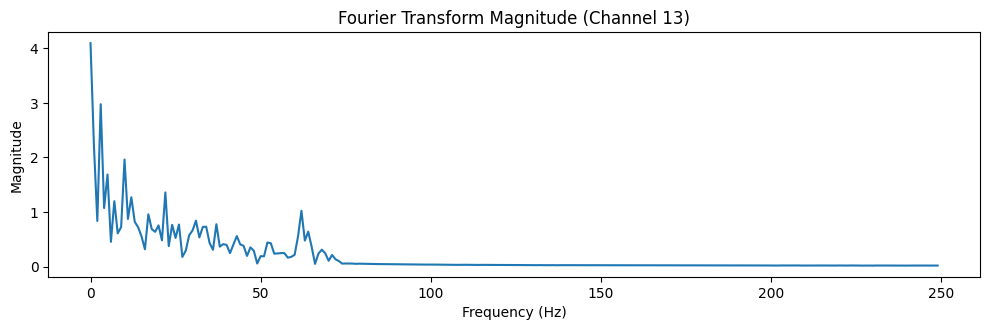

Plotting Channel 14


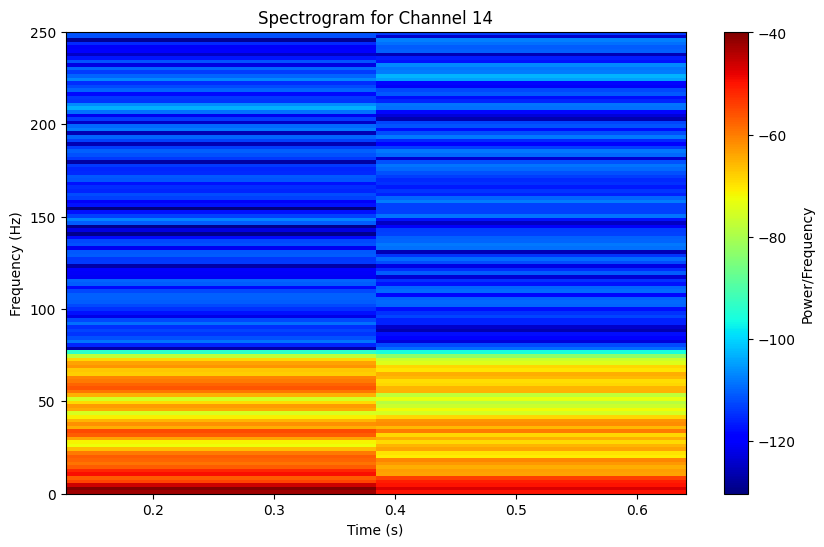

Most similar coefficient to the original signal (Channel 14): Approximation L1 with similarity: 0.11374382496388295
Similarity Scores:
Level 1 -> Approximation Similarity: 0.11374382496388295, Detail Similarity: 0.039782932422680044
Level 2 -> Approximation Similarity: -0.09378311521869002, Detail Similarity: 0.020408718555500634
Level 3 -> Approximation Similarity: -0.014581237424981948, Detail Similarity: 0.026000350142340558
Level 4 -> Approximation Similarity: -0.005737650899263033, Detail Similarity: 0.025129890306486033


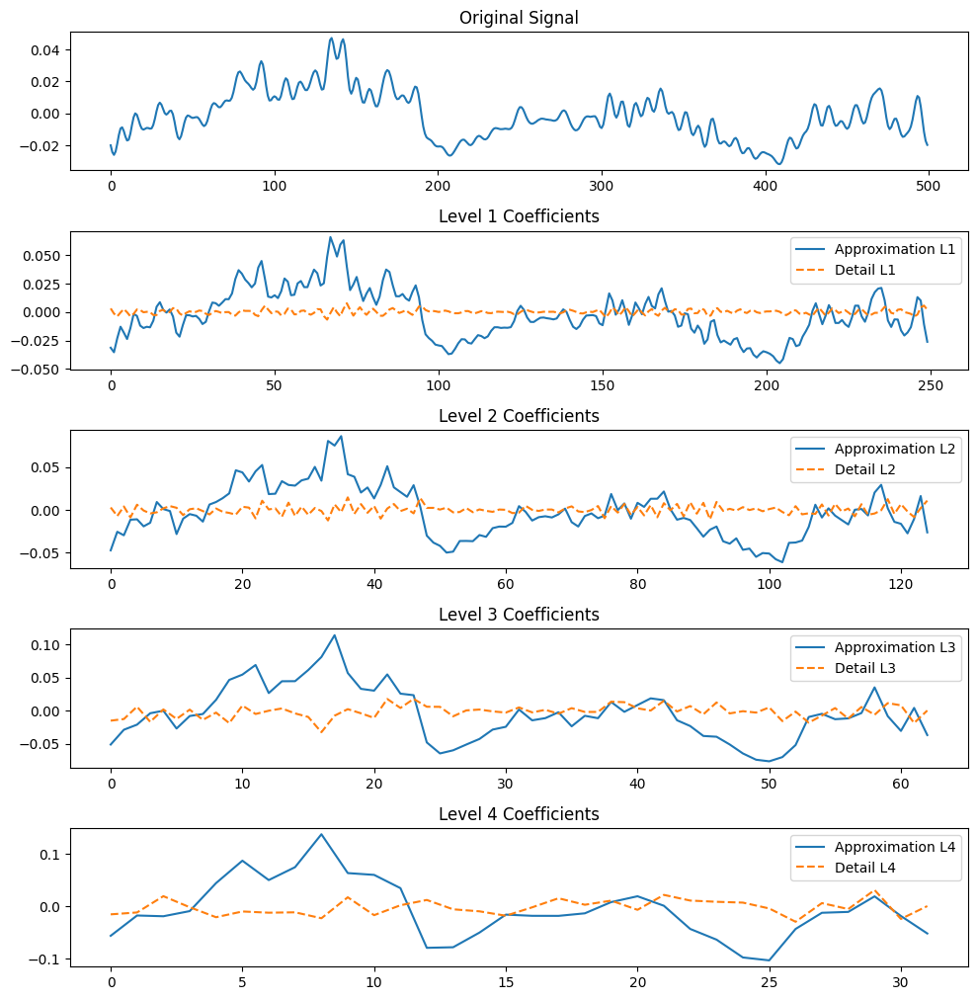

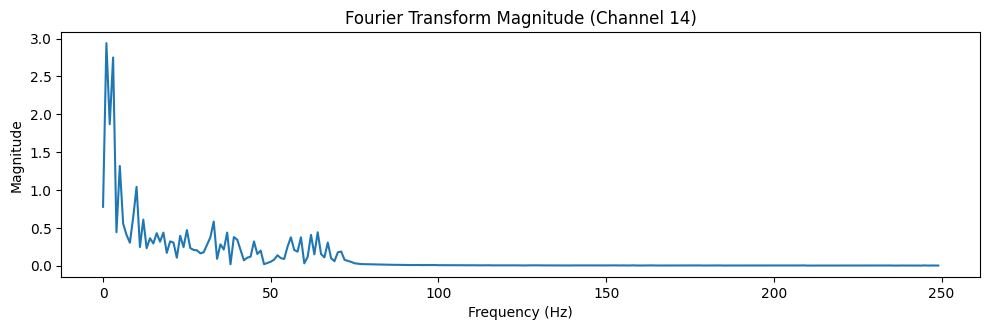

Plotting Channel 15


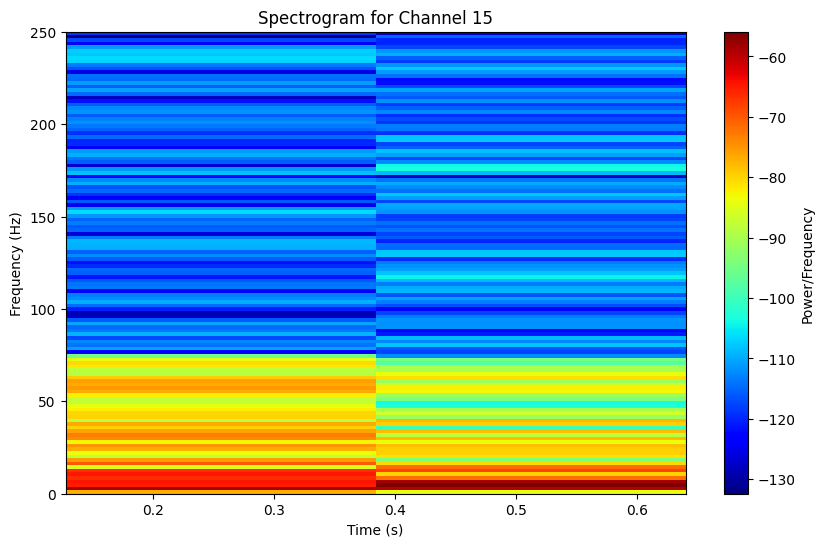

Most similar coefficient to the original signal (Channel 15): Approximation L3 with similarity: 0.05772854443517788
Similarity Scores:
Level 1 -> Approximation Similarity: 0.05197083047638015, Detail Similarity: 0.033093747361790535
Level 2 -> Approximation Similarity: -0.020368270407777275, Detail Similarity: -0.0019380019206937168
Level 3 -> Approximation Similarity: 0.05772854443517788, Detail Similarity: 0.023566446263137784
Level 4 -> Approximation Similarity: 0.0502403487932725, Detail Similarity: -0.010600856634239474


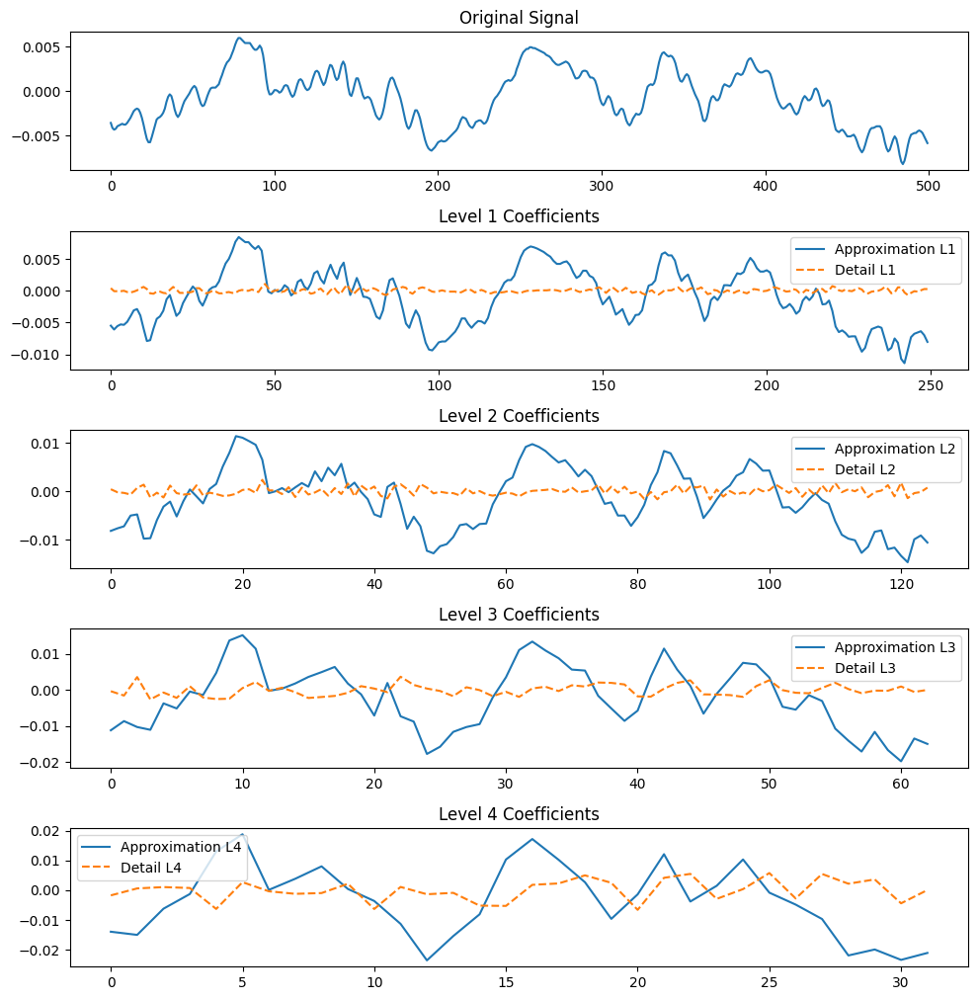

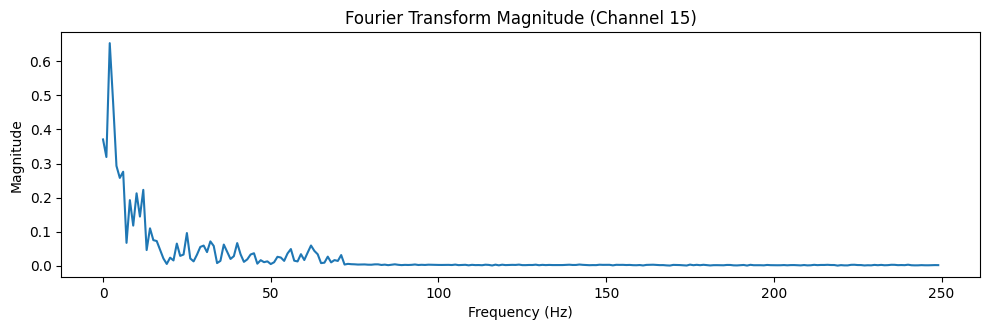

Plotting Channel 16


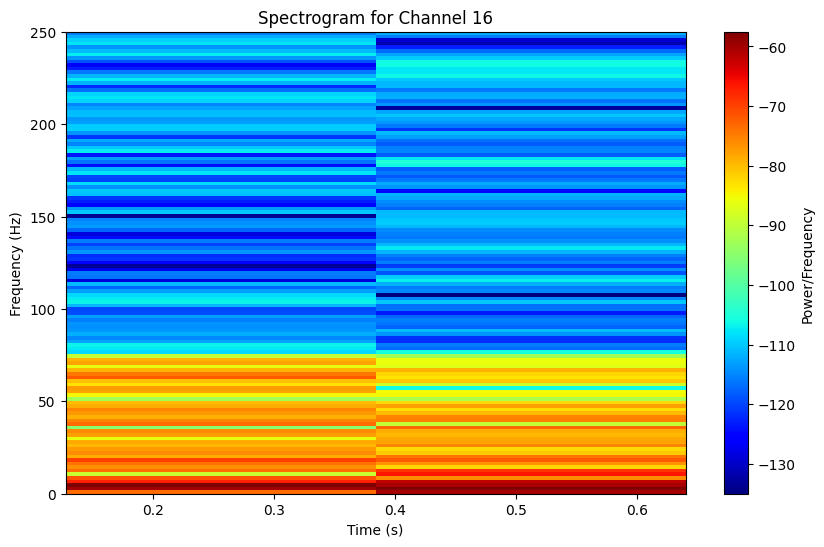

Most similar coefficient to the original signal (Channel 16): Approximation L4 with similarity: 0.023474952050066444
Similarity Scores:
Level 1 -> Approximation Similarity: -0.2079112115128516, Detail Similarity: 0.00054375625169521
Level 2 -> Approximation Similarity: -0.0645506726778493, Detail Similarity: -0.009619741453411186
Level 3 -> Approximation Similarity: 0.01928678262518846, Detail Similarity: -0.012960529736266102
Level 4 -> Approximation Similarity: 0.023474952050066444, Detail Similarity: 0.0159274047261242


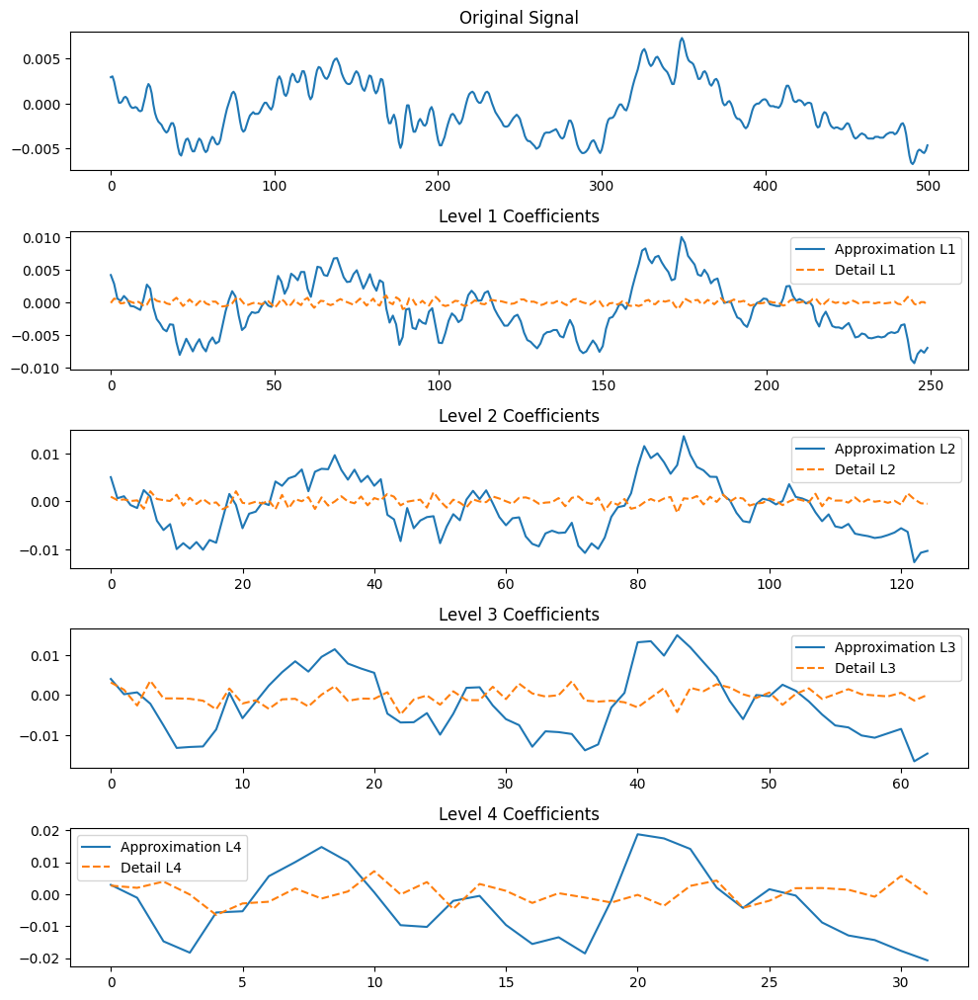

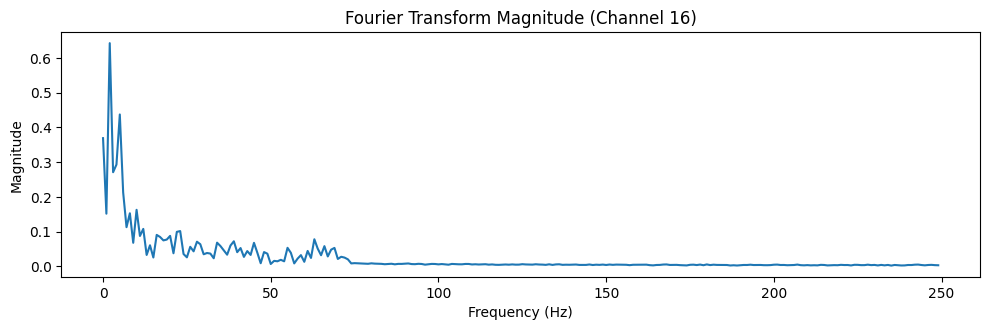

Plotting Channel 17


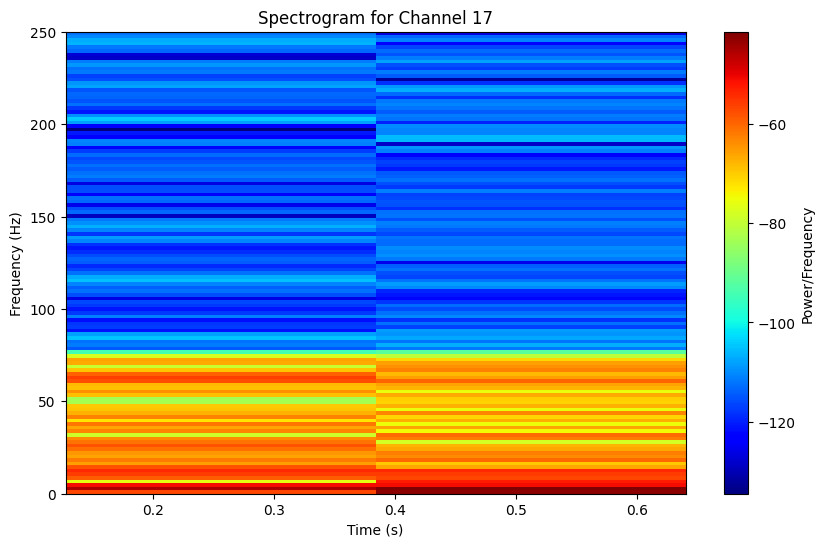

Most similar coefficient to the original signal (Channel 17): Detail L1 with similarity: 0.035700843371624776
Similarity Scores:
Level 1 -> Approximation Similarity: -0.06225220510806065, Detail Similarity: 0.035700843371624776
Level 2 -> Approximation Similarity: -0.27286212824315786, Detail Similarity: 0.0020132820286693906
Level 3 -> Approximation Similarity: -0.16072611433032286, Detail Similarity: -0.030463342473261112
Level 4 -> Approximation Similarity: -0.06204710190530388, Detail Similarity: -0.02191240094086591


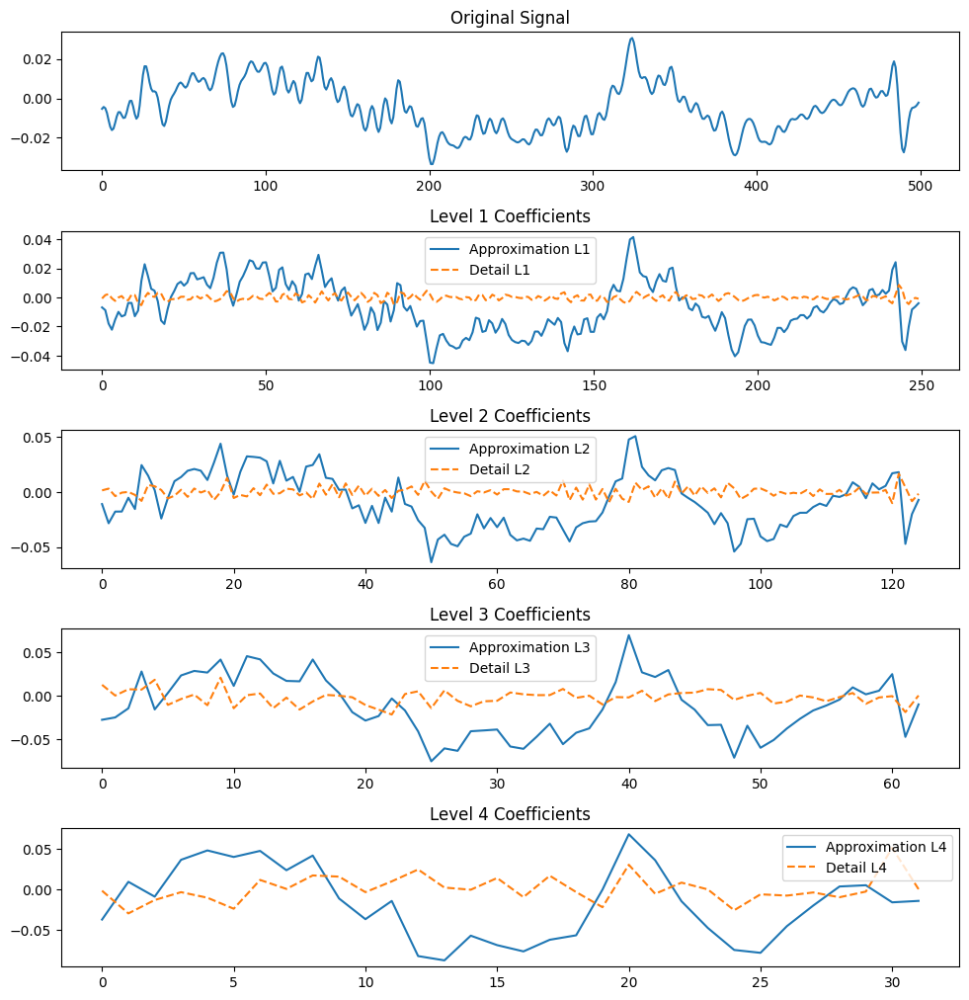

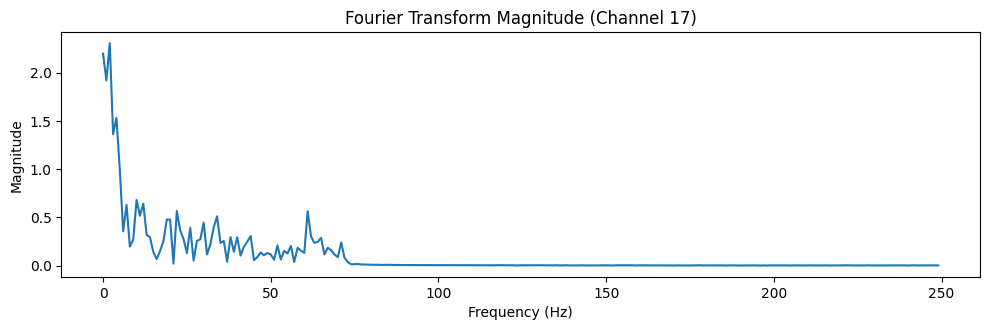

Plotting Channel 18


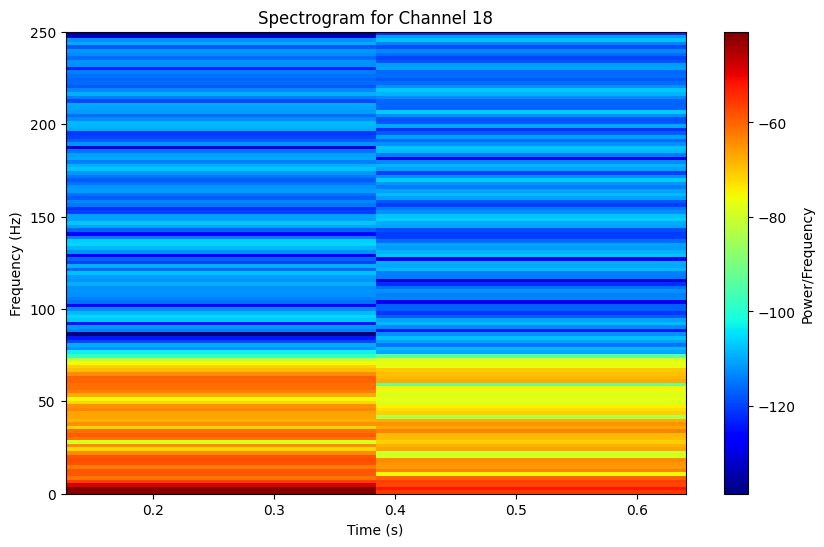

Most similar coefficient to the original signal (Channel 18): Detail L3 with similarity: 0.08290821389648953
Similarity Scores:
Level 1 -> Approximation Similarity: 0.07350513377542292, Detail Similarity: 0.02858401218484907
Level 2 -> Approximation Similarity: -0.07663610139930636, Detail Similarity: 0.03574080571371305
Level 3 -> Approximation Similarity: -0.23809154249915807, Detail Similarity: 0.08290821389648953
Level 4 -> Approximation Similarity: -0.1988508293538024, Detail Similarity: 0.02989779121500075


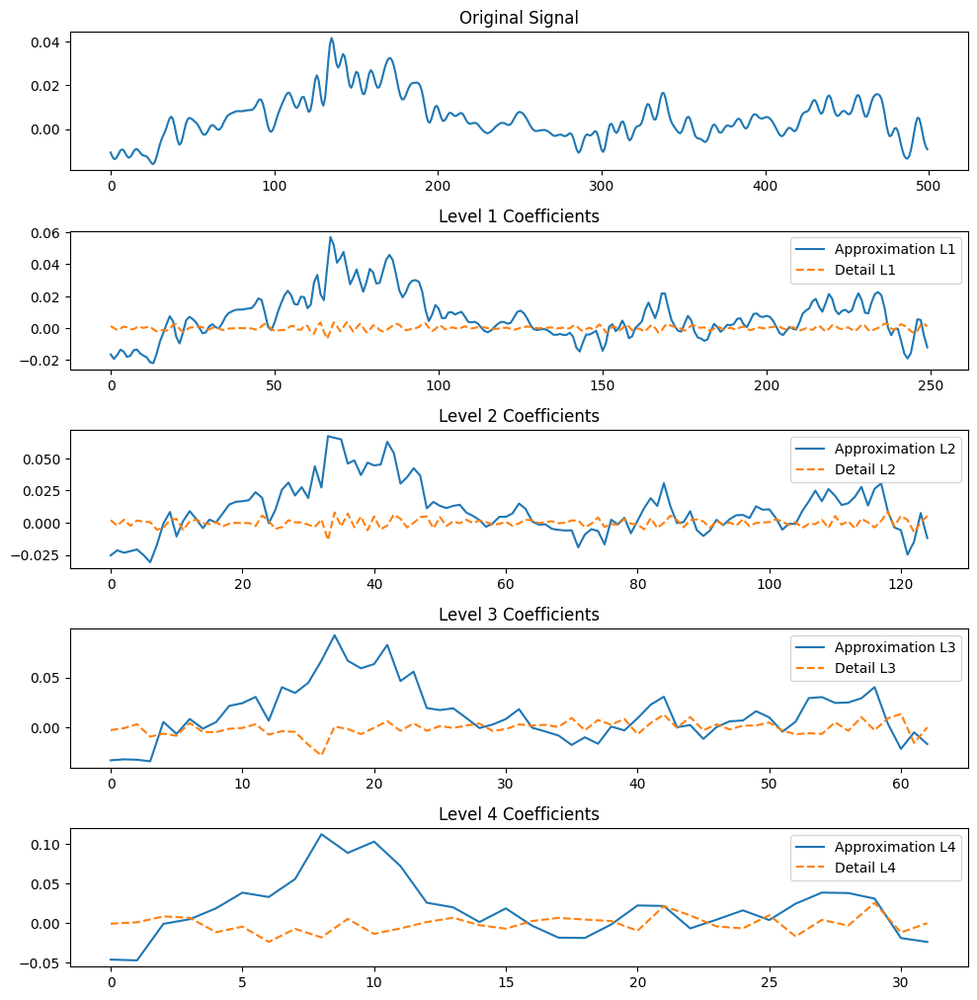

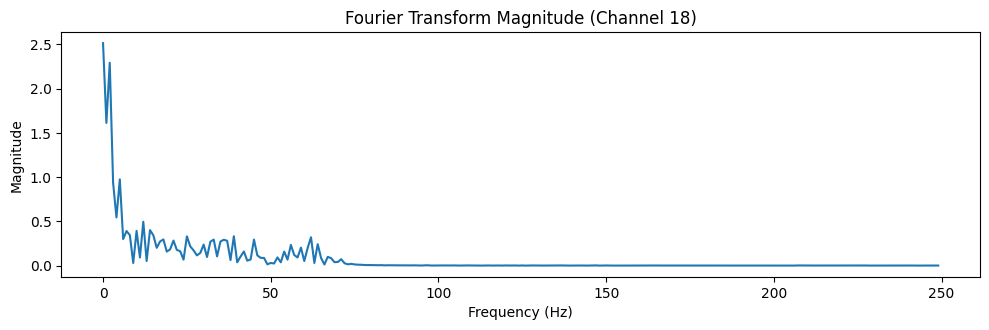

Plotting Channel 19


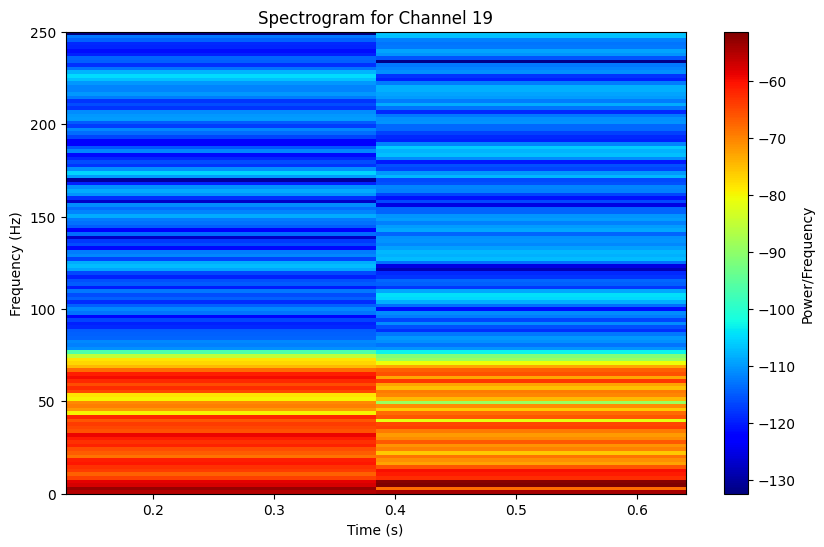

Most similar coefficient to the original signal (Channel 19): Detail L3 with similarity: 0.08265785528814316
Similarity Scores:
Level 1 -> Approximation Similarity: 0.011445966559353891, Detail Similarity: -0.00026839217521913445
Level 2 -> Approximation Similarity: -0.07448705065863787, Detail Similarity: 0.014809237953116604
Level 3 -> Approximation Similarity: -0.12645123008102746, Detail Similarity: 0.08265785528814316
Level 4 -> Approximation Similarity: 0.058756995983188294, Detail Similarity: 0.0159302835376024


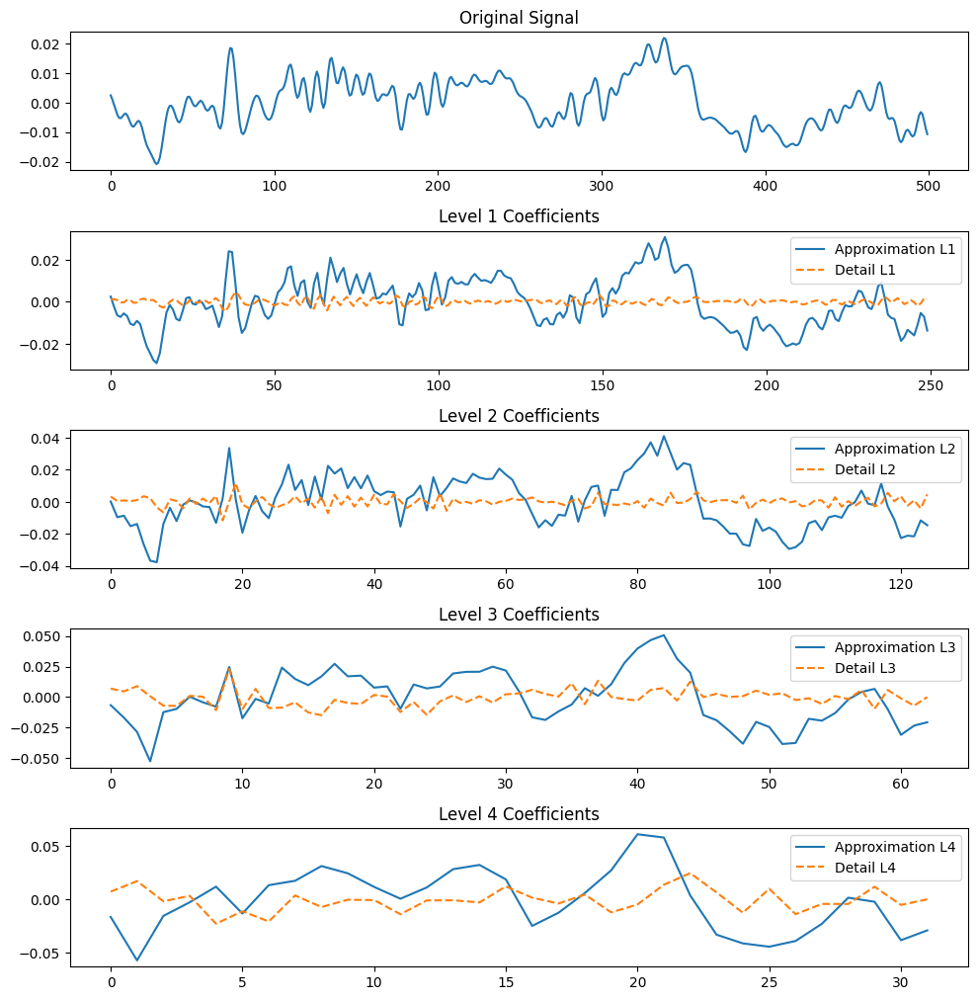

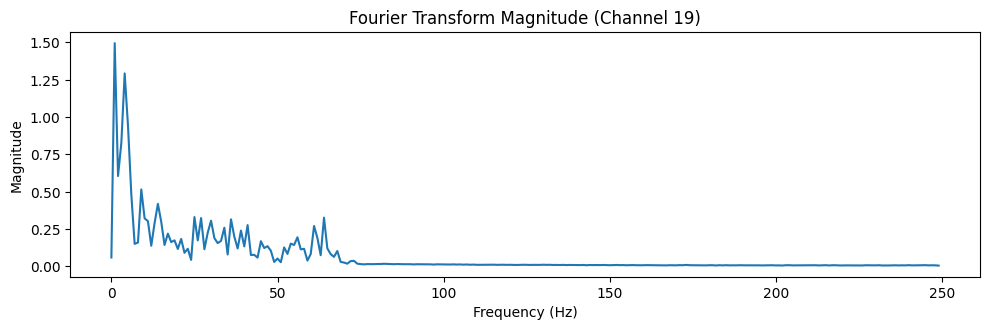

Features saved to Video_Detected_Seizures_features.csv


In [26]:
print("Video Detected Seizures Analysis")
video_features = analyze_data(video_dataset, "Video_Detected_Seizures")

Electrographic Seizures Analysis
Analyzing Electrographic_Seizures: 6342
Plotting Channel 1


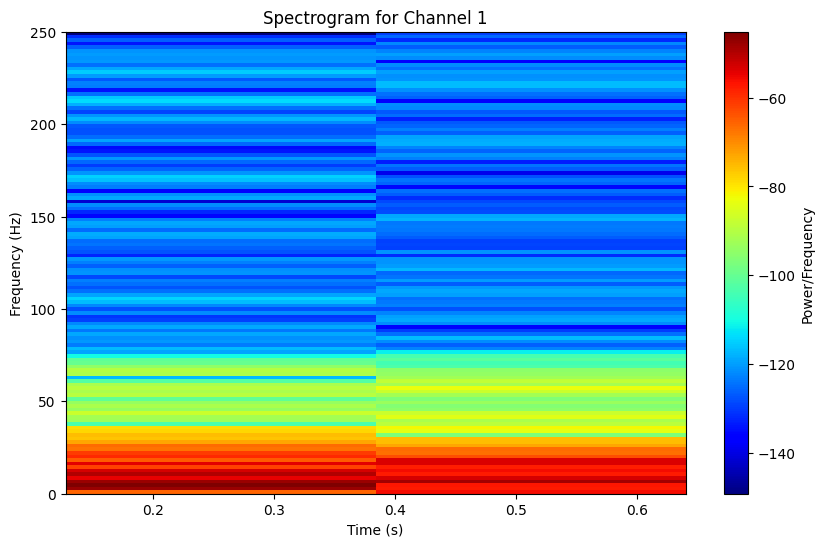

Most similar coefficient to the original signal (Channel 1): Approximation L1 with similarity: 0.060453926397571536
Similarity Scores:
Level 1 -> Approximation Similarity: 0.060453926397571536, Detail Similarity: 0.010857687846352144
Level 2 -> Approximation Similarity: 0.024725662145900162, Detail Similarity: -0.012734539091710621
Level 3 -> Approximation Similarity: -0.012760176905197007, Detail Similarity: 0.012647131235809218
Level 4 -> Approximation Similarity: -0.02825857526337829, Detail Similarity: 0.014266737576693635


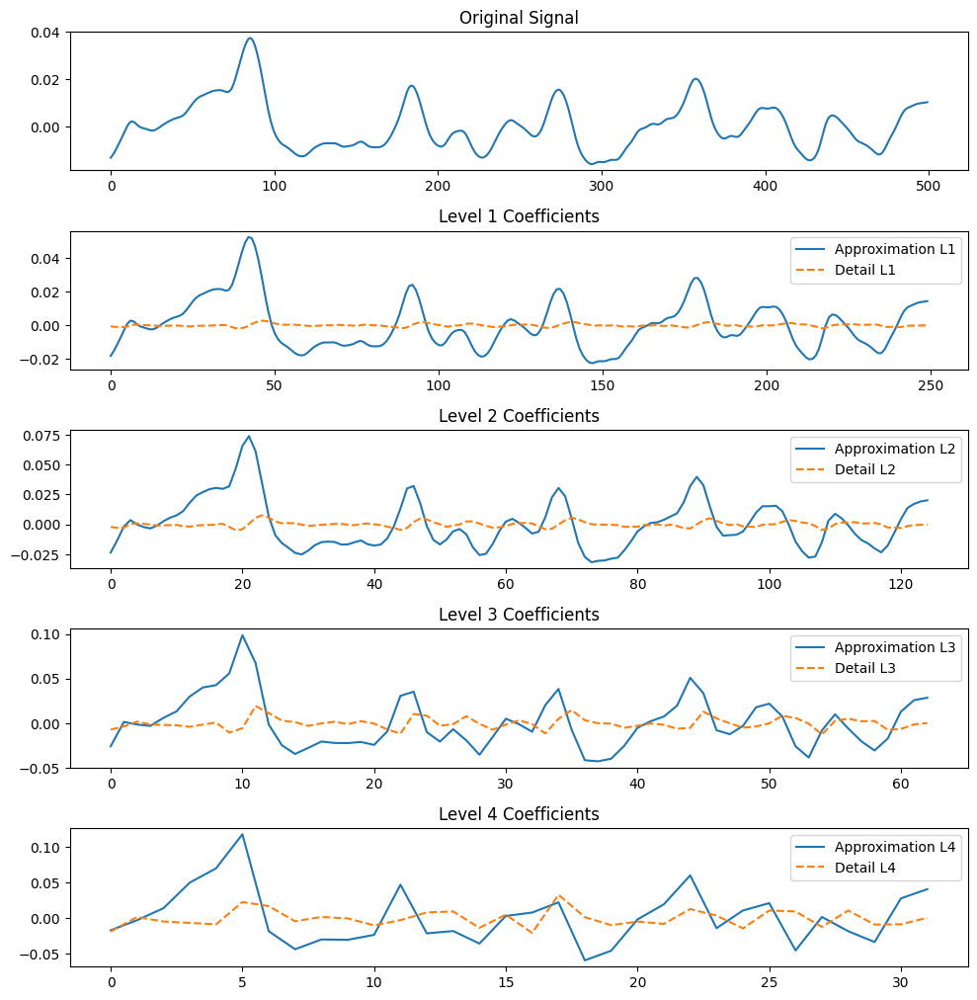

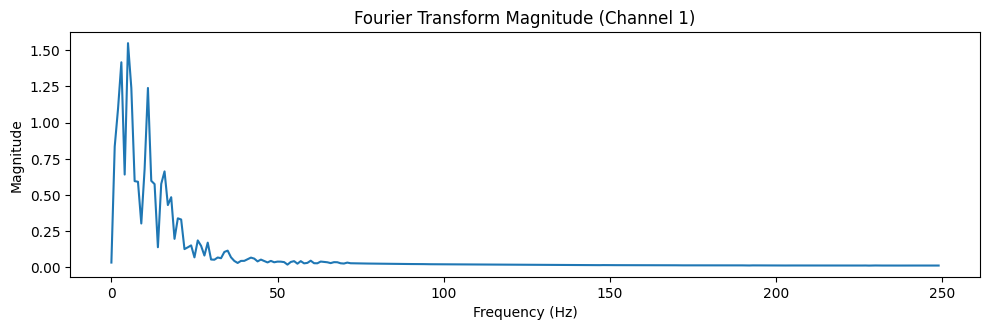

Plotting Channel 2


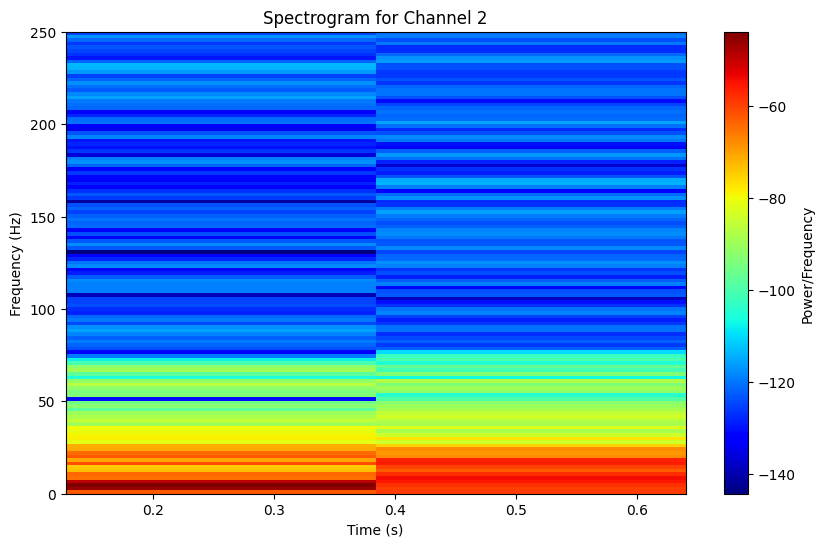

Most similar coefficient to the original signal (Channel 2): Detail L1 with similarity: 0.1043575334291687
Similarity Scores:
Level 1 -> Approximation Similarity: -0.12427471693835156, Detail Similarity: 0.1043575334291687
Level 2 -> Approximation Similarity: 0.052323923074913924, Detail Similarity: -0.02997822525168792
Level 3 -> Approximation Similarity: 0.06374101142134646, Detail Similarity: 0.011041159320222366
Level 4 -> Approximation Similarity: -0.0274629274906858, Detail Similarity: 0.006480984107303045


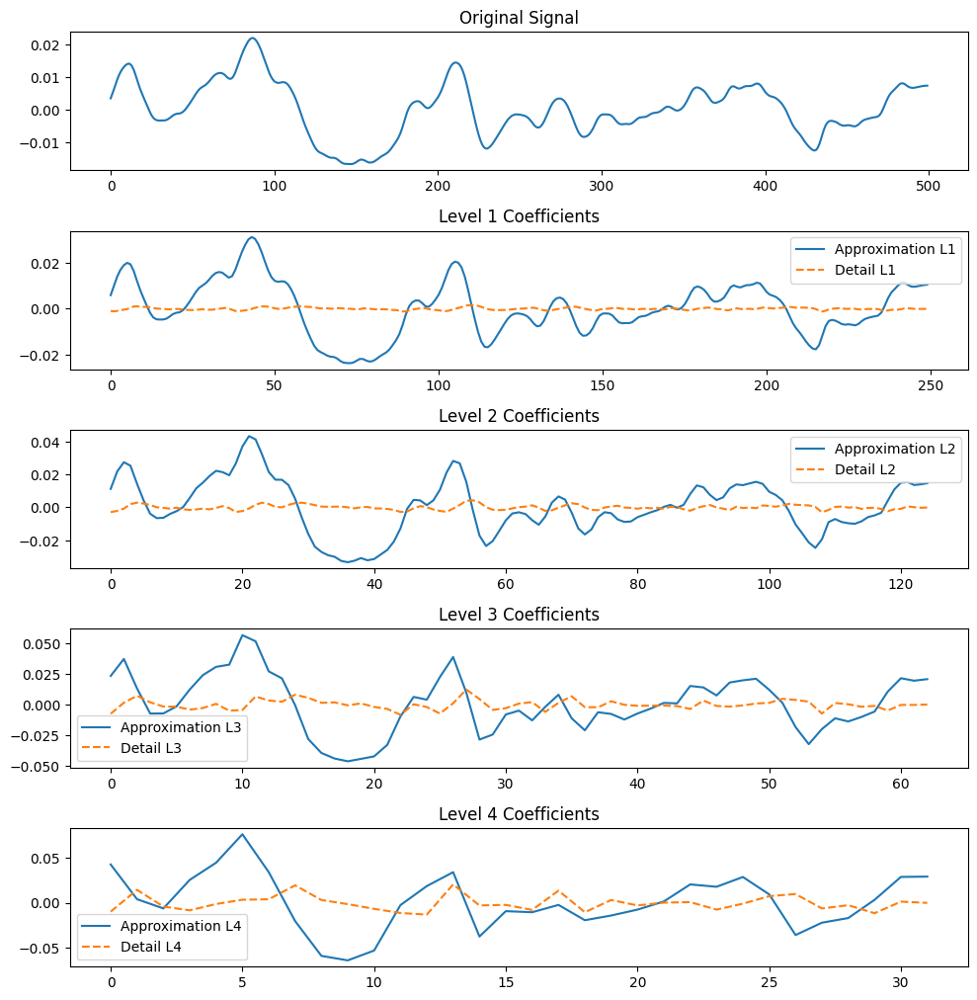

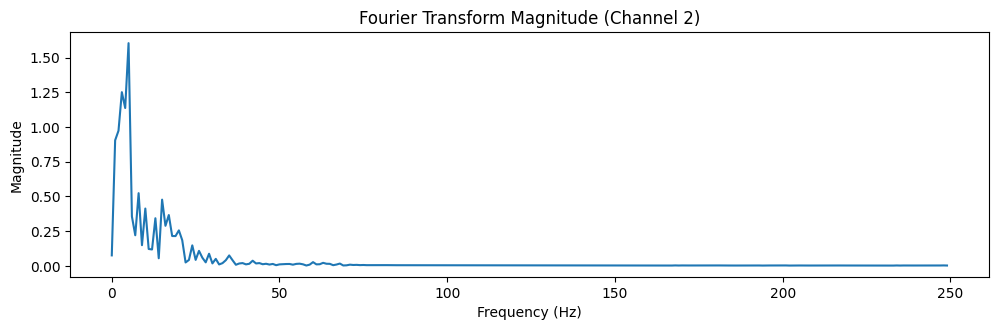

Plotting Channel 3


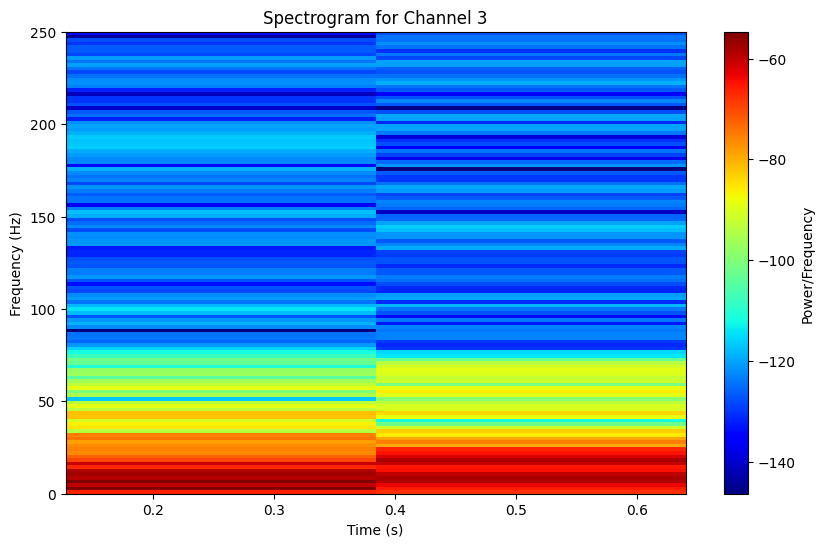

Most similar coefficient to the original signal (Channel 3): Approximation L2 with similarity: 0.0923261465383145
Similarity Scores:
Level 1 -> Approximation Similarity: -0.003258835811898122, Detail Similarity: -0.017189852938625773
Level 2 -> Approximation Similarity: 0.0923261465383145, Detail Similarity: -0.007644440551666229
Level 3 -> Approximation Similarity: -0.0647447939419646, Detail Similarity: -0.0038824153658560106
Level 4 -> Approximation Similarity: -0.009556644313655965, Detail Similarity: 0.017433319792371043


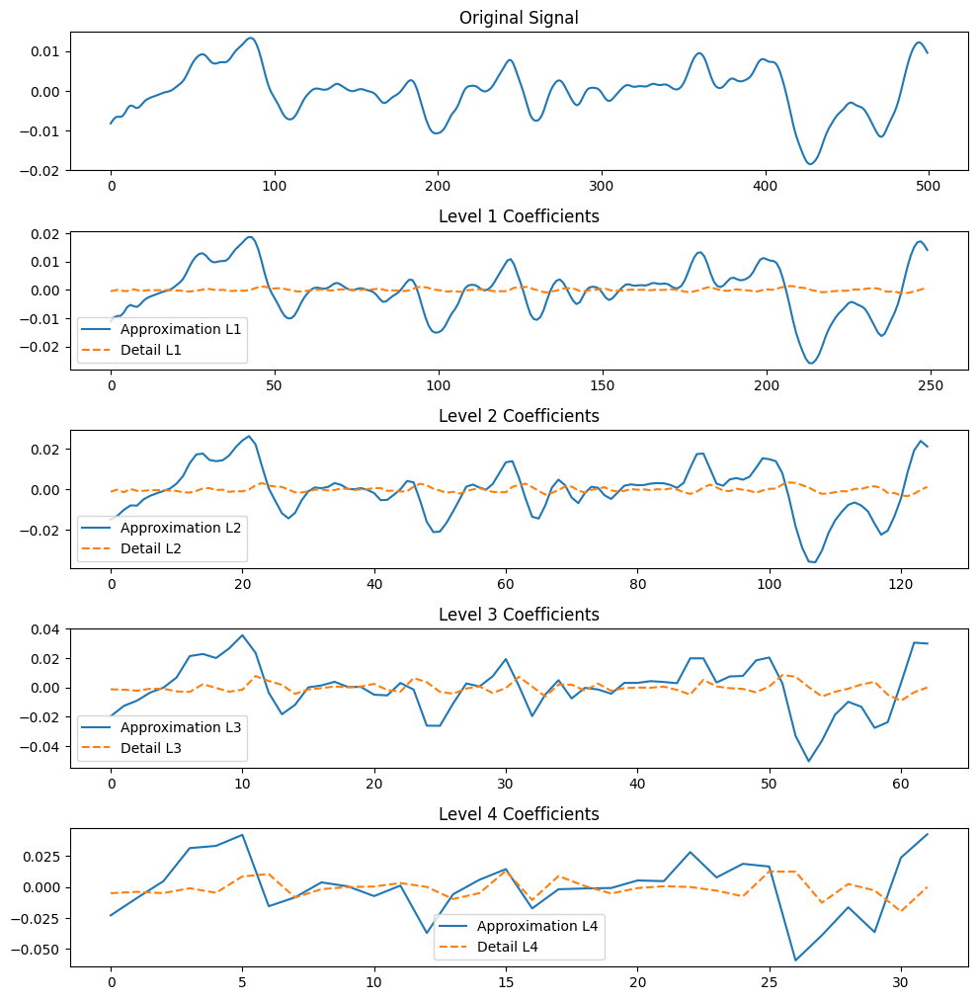

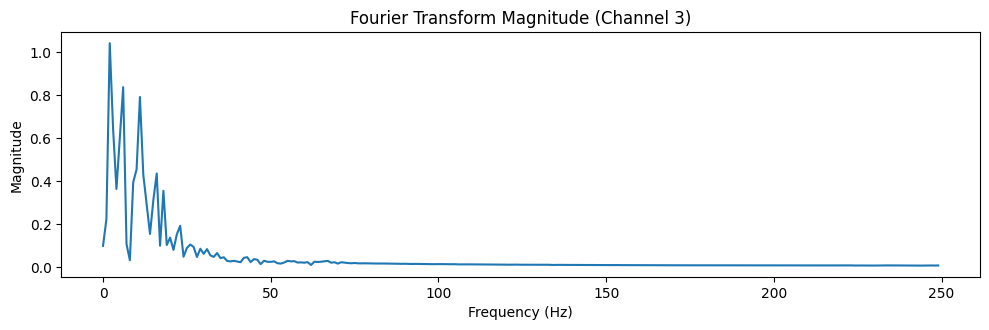

Plotting Channel 4


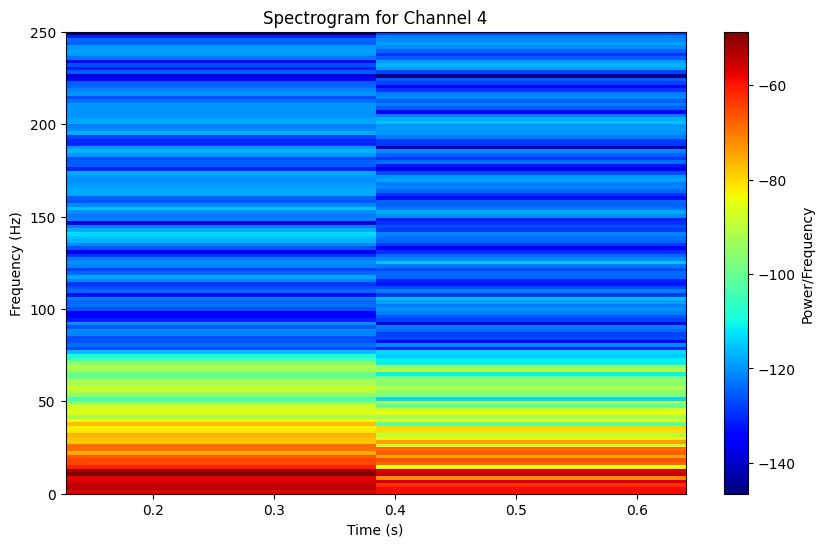

Most similar coefficient to the original signal (Channel 4): Approximation L1 with similarity: 0.18243431638044447
Similarity Scores:
Level 1 -> Approximation Similarity: 0.18243431638044447, Detail Similarity: 0.051775763090555836
Level 2 -> Approximation Similarity: 0.12642351570070284, Detail Similarity: 0.028418293181008664
Level 3 -> Approximation Similarity: 0.08777634315296191, Detail Similarity: 0.010538070852866656
Level 4 -> Approximation Similarity: 0.015244552326626748, Detail Similarity: 0.0007526561103844339


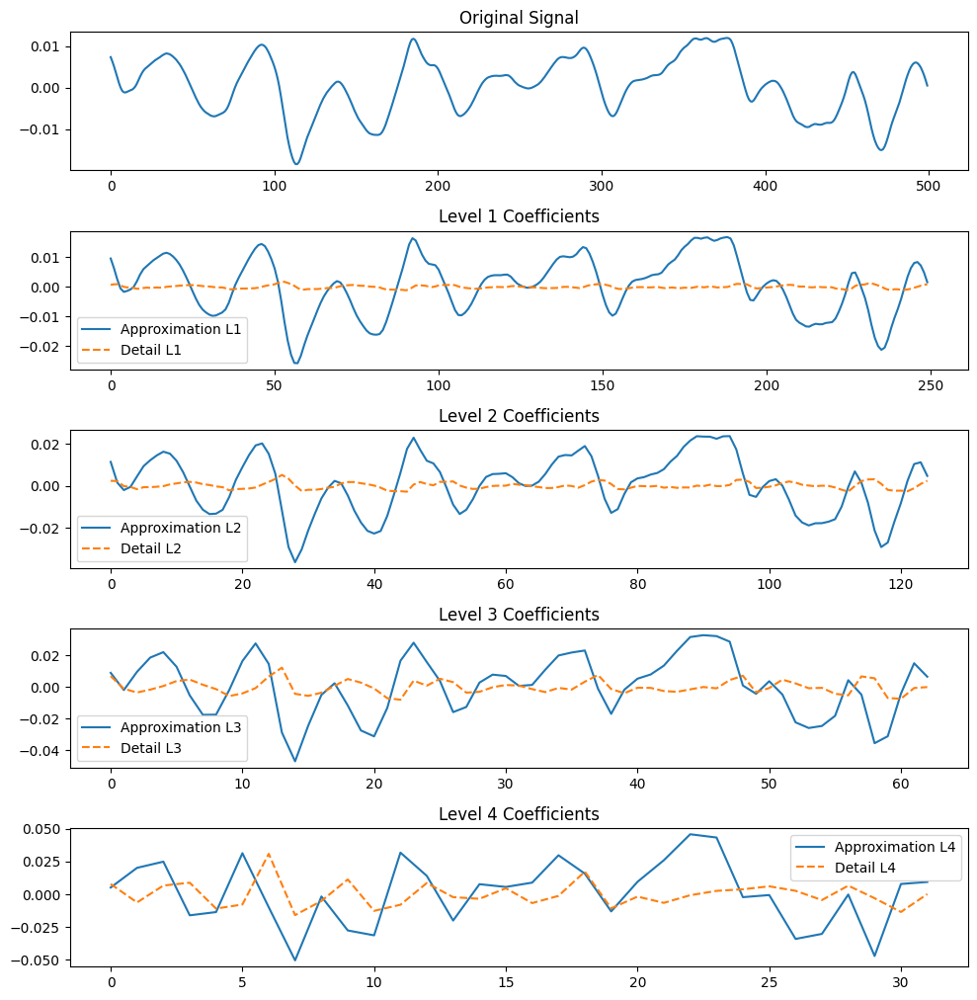

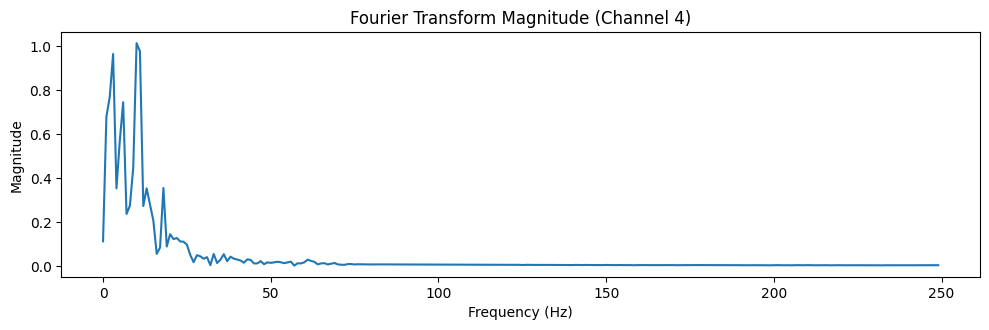

Plotting Channel 5


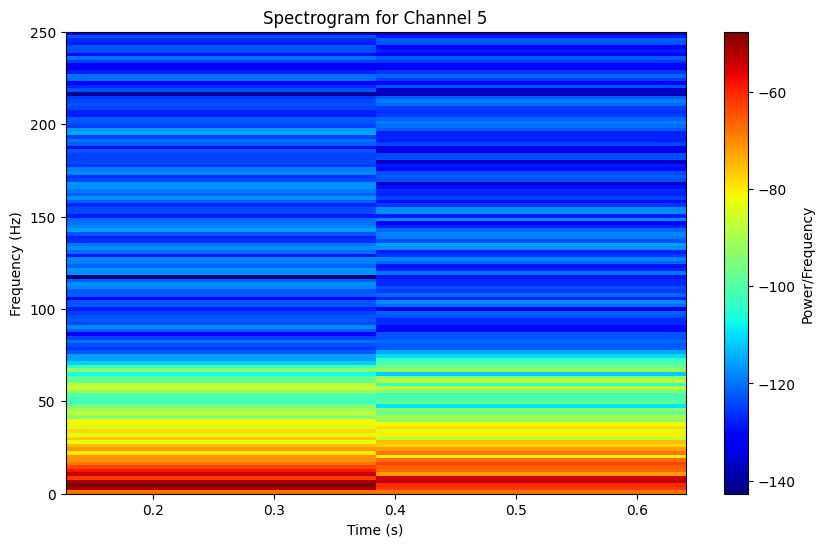

Most similar coefficient to the original signal (Channel 5): Approximation L2 with similarity: 0.08725973450234965
Similarity Scores:
Level 1 -> Approximation Similarity: 0.03654820511838167, Detail Similarity: 0.04023852235908384
Level 2 -> Approximation Similarity: 0.08725973450234965, Detail Similarity: 0.005073724487629191
Level 3 -> Approximation Similarity: 0.022909569485069448, Detail Similarity: 0.009934120357134632
Level 4 -> Approximation Similarity: -0.006734517594900291, Detail Similarity: -0.007308458131936835


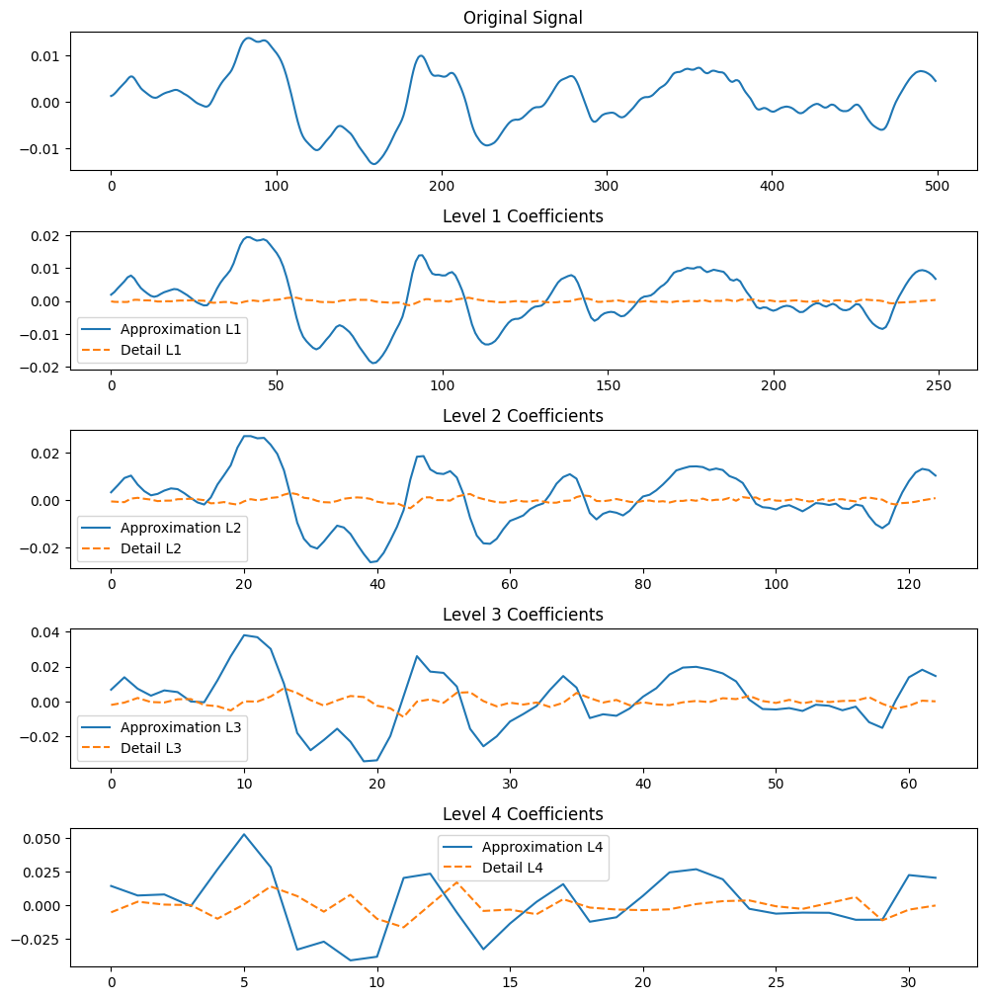

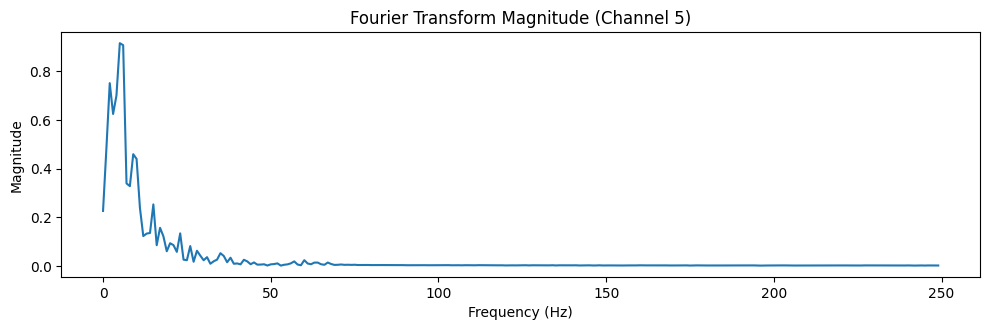

Plotting Channel 6


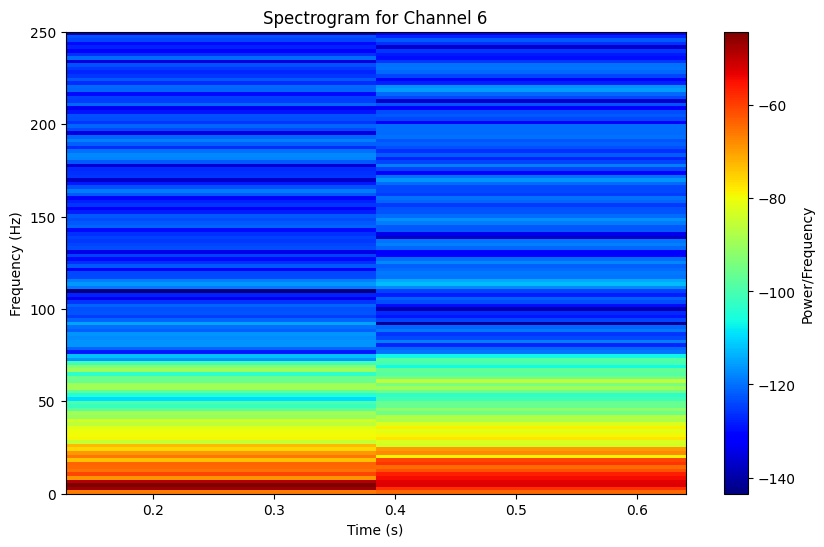

Most similar coefficient to the original signal (Channel 6): Detail L1 with similarity: 0.12007524781387807
Similarity Scores:
Level 1 -> Approximation Similarity: -0.19030549413184655, Detail Similarity: 0.12007524781387807
Level 2 -> Approximation Similarity: 0.10320326105410682, Detail Similarity: 0.00022827943504109369
Level 3 -> Approximation Similarity: 0.055429217015557974, Detail Similarity: 0.01722035640236479
Level 4 -> Approximation Similarity: -0.011353634509164353, Detail Similarity: -0.004602636045201222


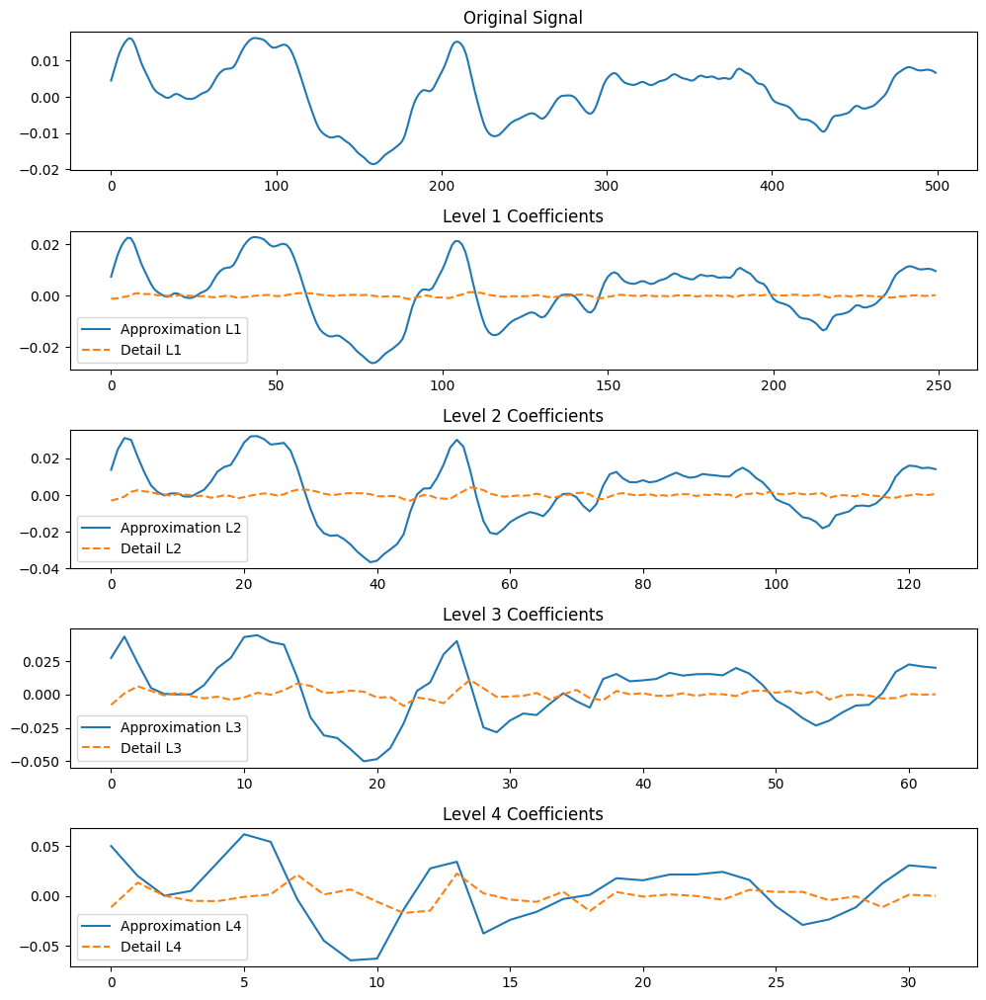

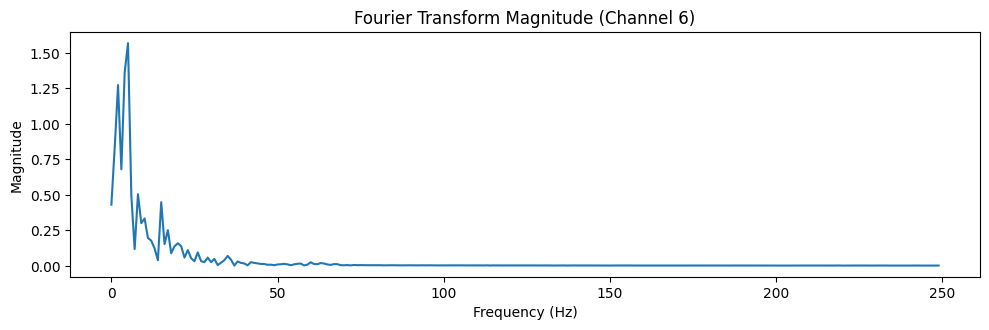

Plotting Channel 7


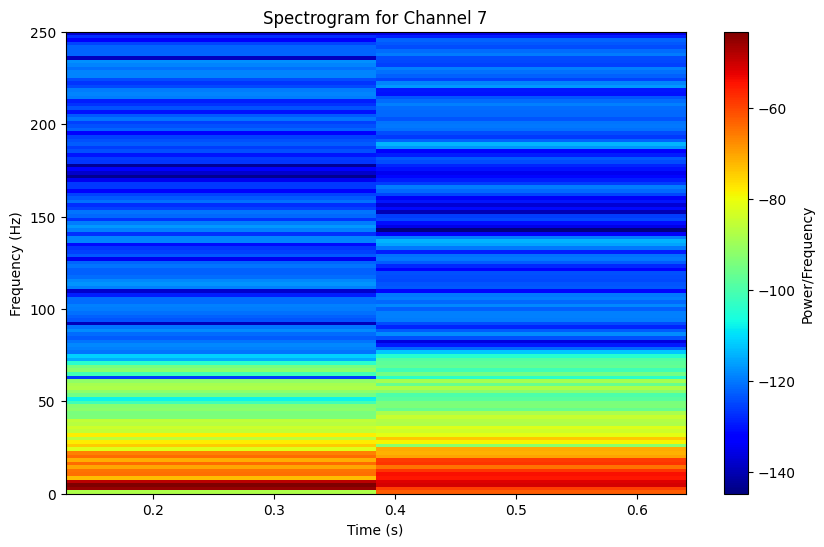

Most similar coefficient to the original signal (Channel 7): Detail L1 with similarity: 0.15874426240187303
Similarity Scores:
Level 1 -> Approximation Similarity: -0.19650045138431704, Detail Similarity: 0.15874426240187303
Level 2 -> Approximation Similarity: 0.11059256432960625, Detail Similarity: -0.005736264566029542
Level 3 -> Approximation Similarity: 0.07014703706952957, Detail Similarity: 0.01347187310213145
Level 4 -> Approximation Similarity: 0.0037822995766382214, Detail Similarity: 0.004132194234487759


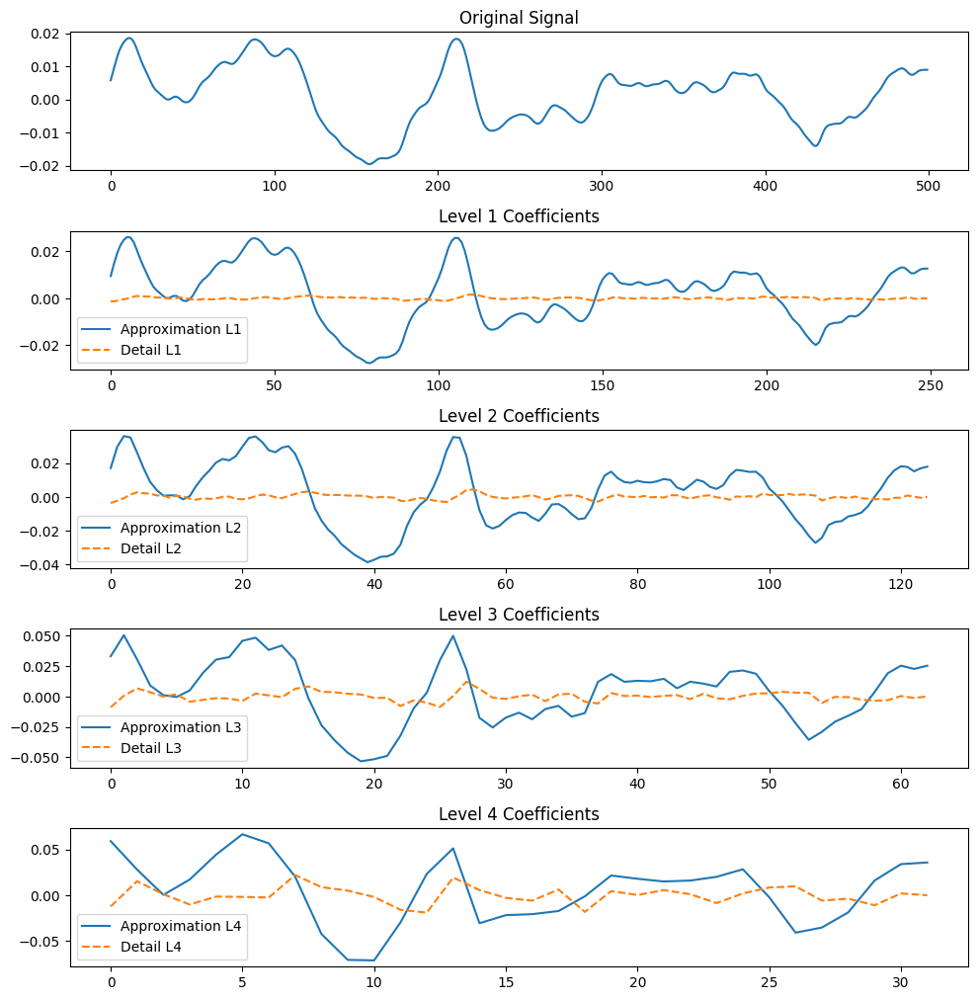

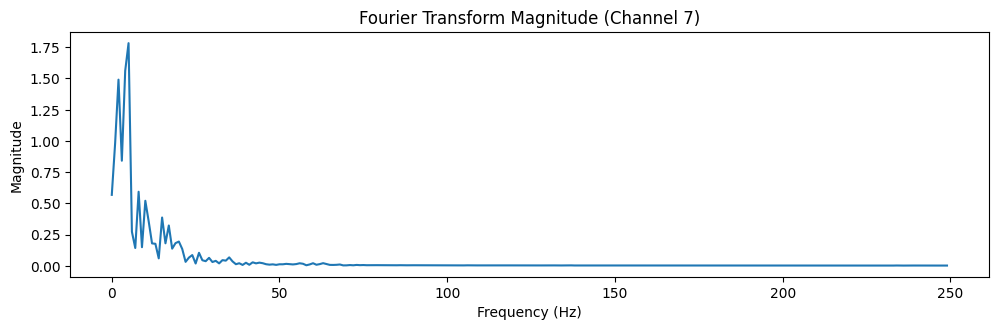

Plotting Channel 8


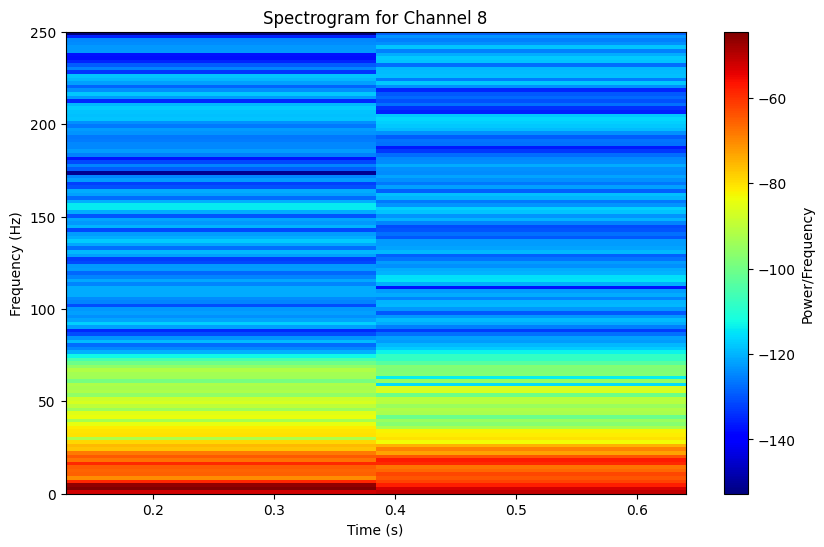

Most similar coefficient to the original signal (Channel 8): Detail L1 with similarity: 0.18690070121504698
Similarity Scores:
Level 1 -> Approximation Similarity: -0.147743710542805, Detail Similarity: 0.18690070121504698
Level 2 -> Approximation Similarity: -0.09097256405890408, Detail Similarity: -0.04976192434752503
Level 3 -> Approximation Similarity: 0.0705474299677162, Detail Similarity: -0.01010553130627848
Level 4 -> Approximation Similarity: -0.046462061674691114, Detail Similarity: 0.023025675156580782


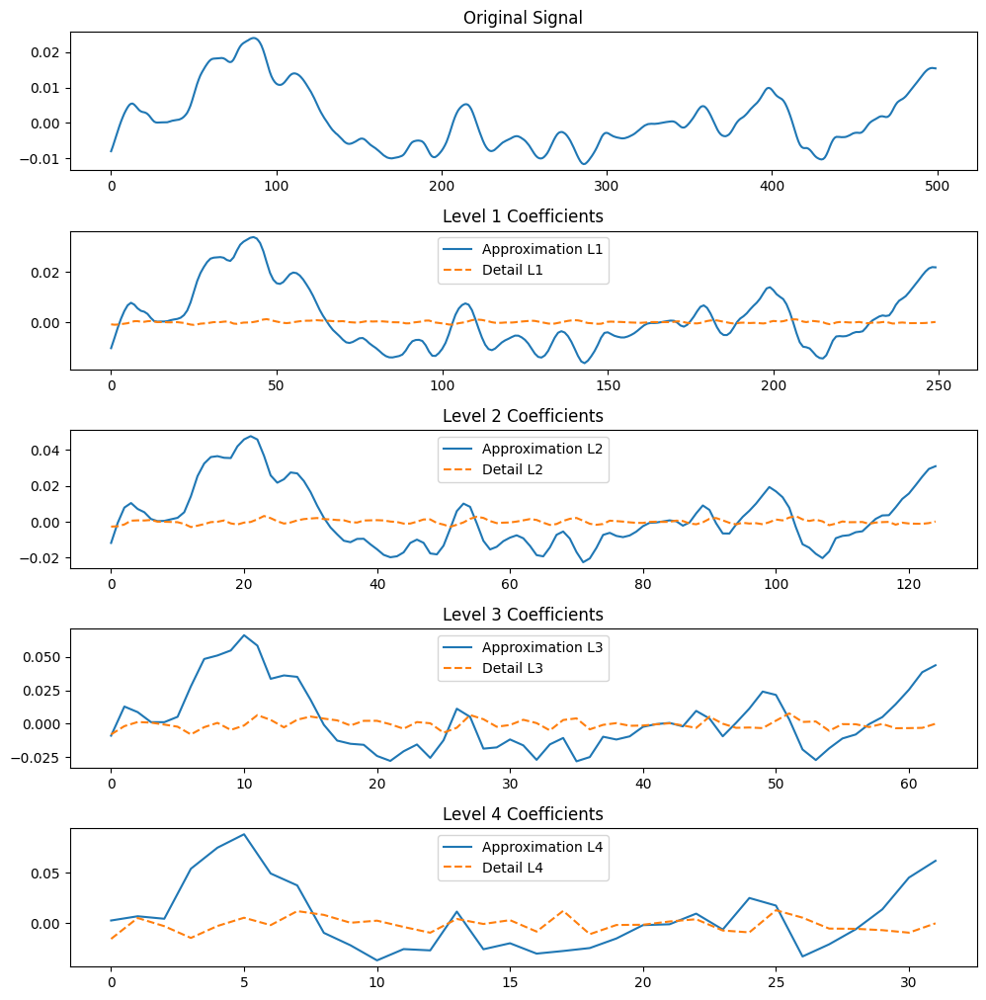

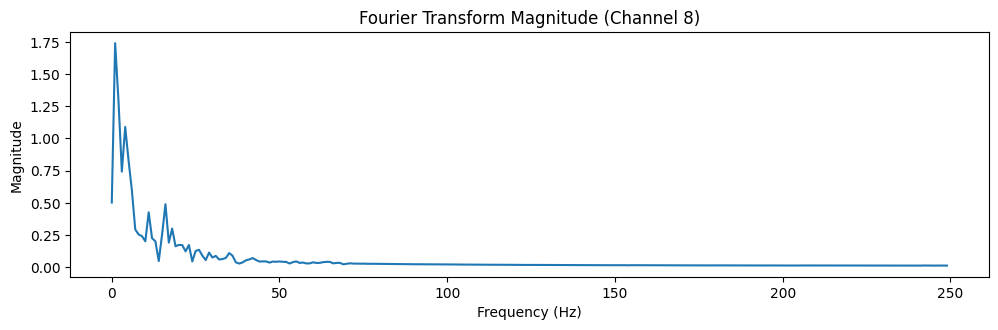

Plotting Channel 9


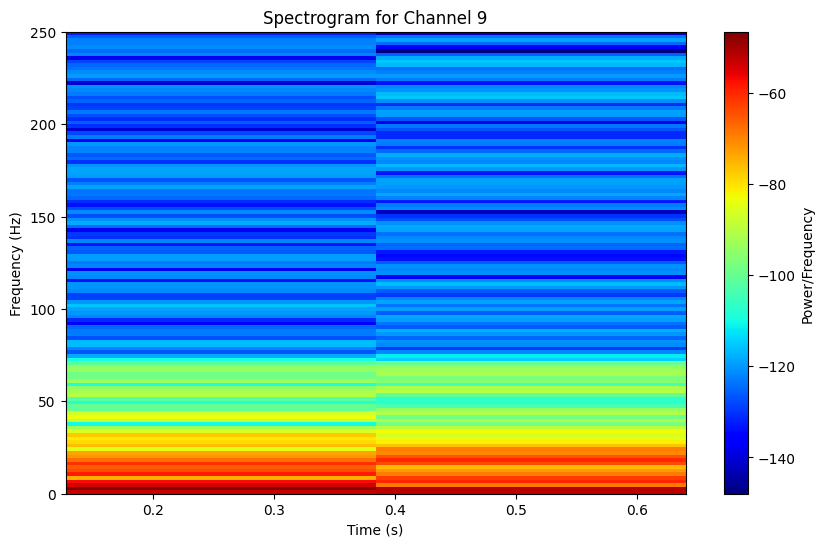

Most similar coefficient to the original signal (Channel 9): Detail L1 with similarity: 0.12845888185602297
Similarity Scores:
Level 1 -> Approximation Similarity: -0.11773459927249841, Detail Similarity: 0.12845888185602297
Level 2 -> Approximation Similarity: -0.15621803916894575, Detail Similarity: -0.07347556781898752
Level 3 -> Approximation Similarity: 0.03154603695403986, Detail Similarity: -0.019824069194659084
Level 4 -> Approximation Similarity: -0.04016329209873714, Detail Similarity: 0.024528632805996733


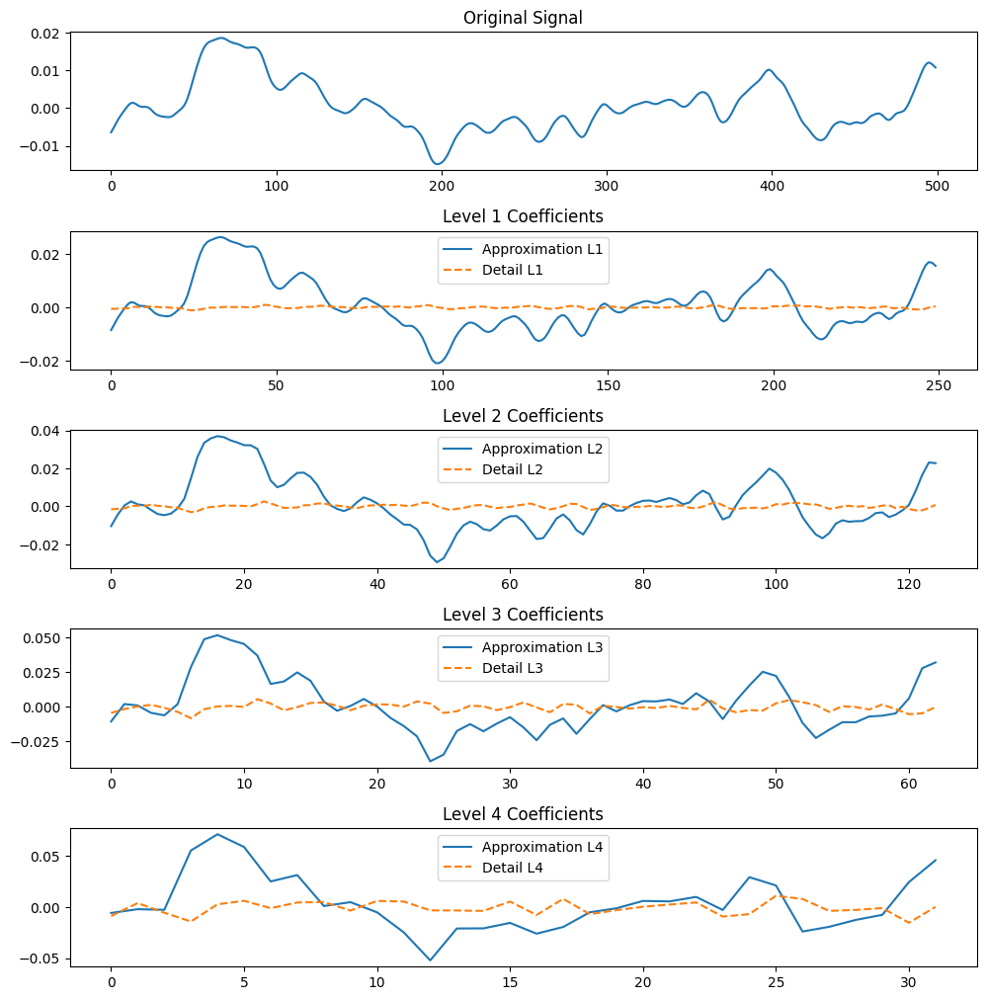

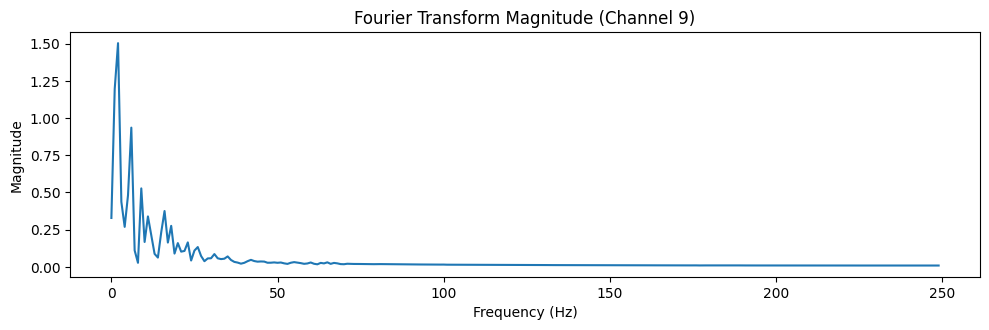

Plotting Channel 10


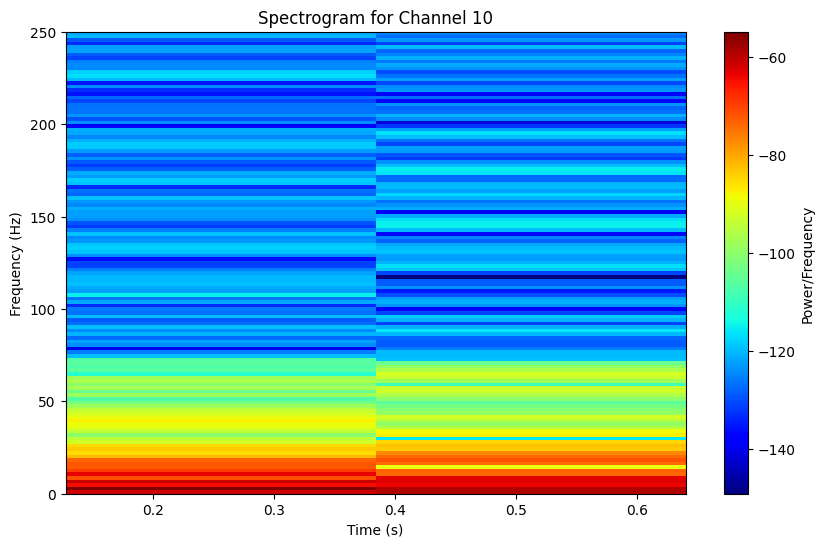

Most similar coefficient to the original signal (Channel 10): Detail L1 with similarity: 0.06847092502866296
Similarity Scores:
Level 1 -> Approximation Similarity: 0.05331436126876012, Detail Similarity: 0.06847092502866296
Level 2 -> Approximation Similarity: -0.19725041825403428, Detail Similarity: -0.021693782018306296
Level 3 -> Approximation Similarity: -0.04328290215738095, Detail Similarity: -0.005097137926431235
Level 4 -> Approximation Similarity: -0.016565651577333224, Detail Similarity: -0.0049996486500832665


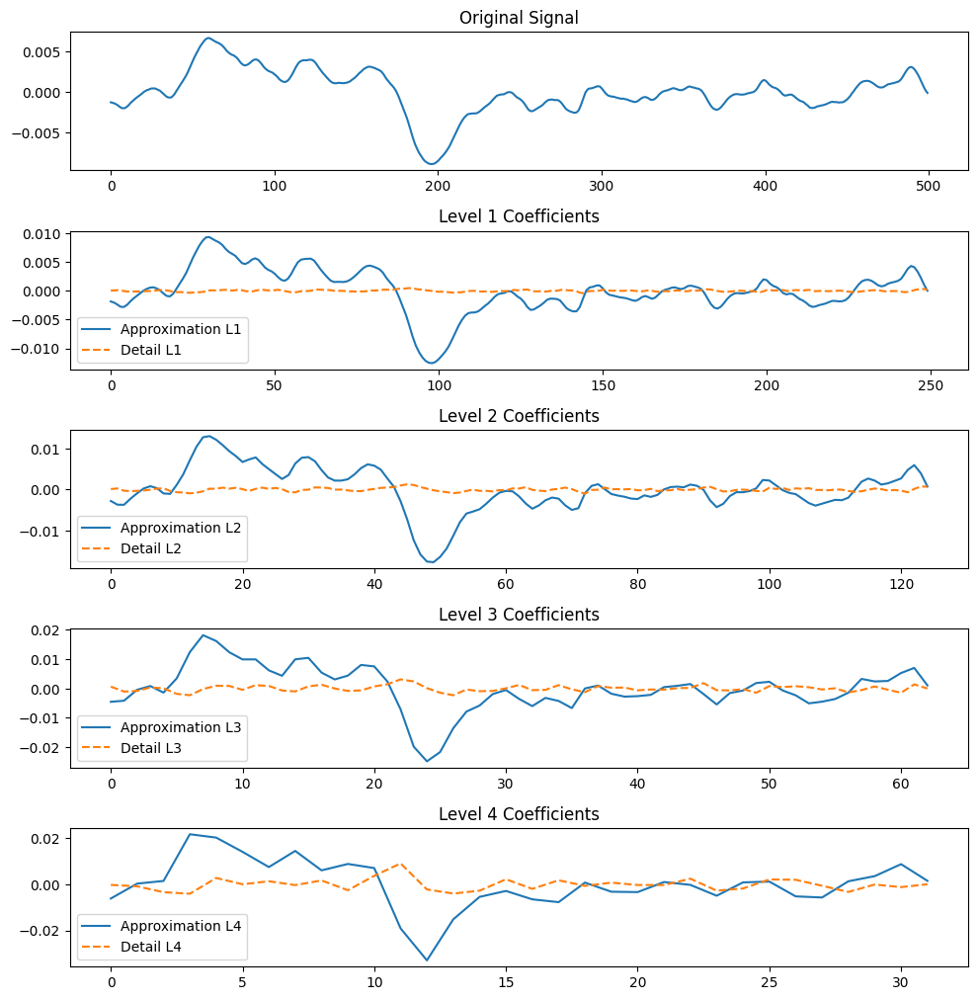

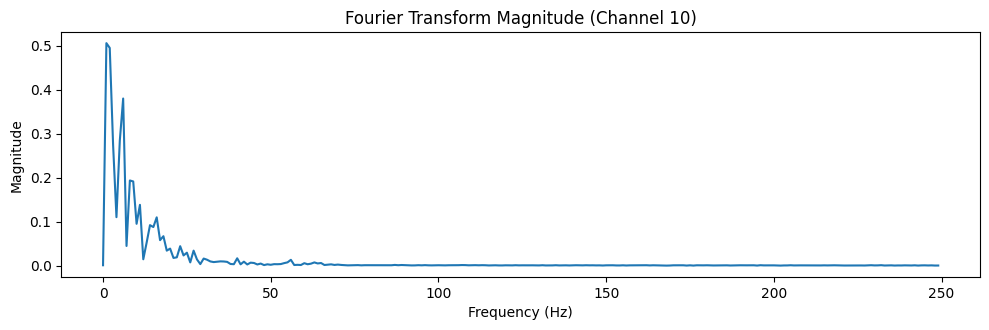

Plotting Channel 11


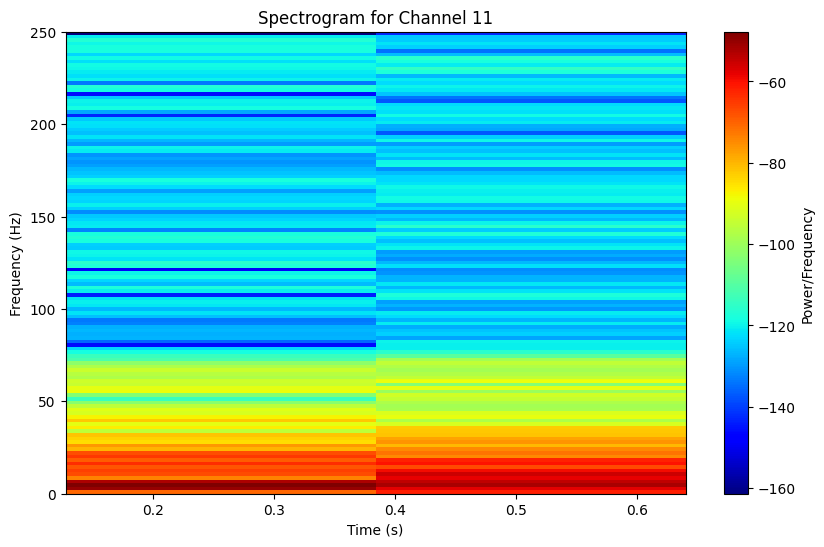

Most similar coefficient to the original signal (Channel 11): Detail L1 with similarity: 0.1341572394320587
Similarity Scores:
Level 1 -> Approximation Similarity: -0.16260216820362686, Detail Similarity: 0.1341572394320587
Level 2 -> Approximation Similarity: 0.1021912892530491, Detail Similarity: -8.222700941778948e-06
Level 3 -> Approximation Similarity: 0.0550045155615672, Detail Similarity: 0.023931974840779476
Level 4 -> Approximation Similarity: -0.026470059715165844, Detail Similarity: 0.003888564347076286


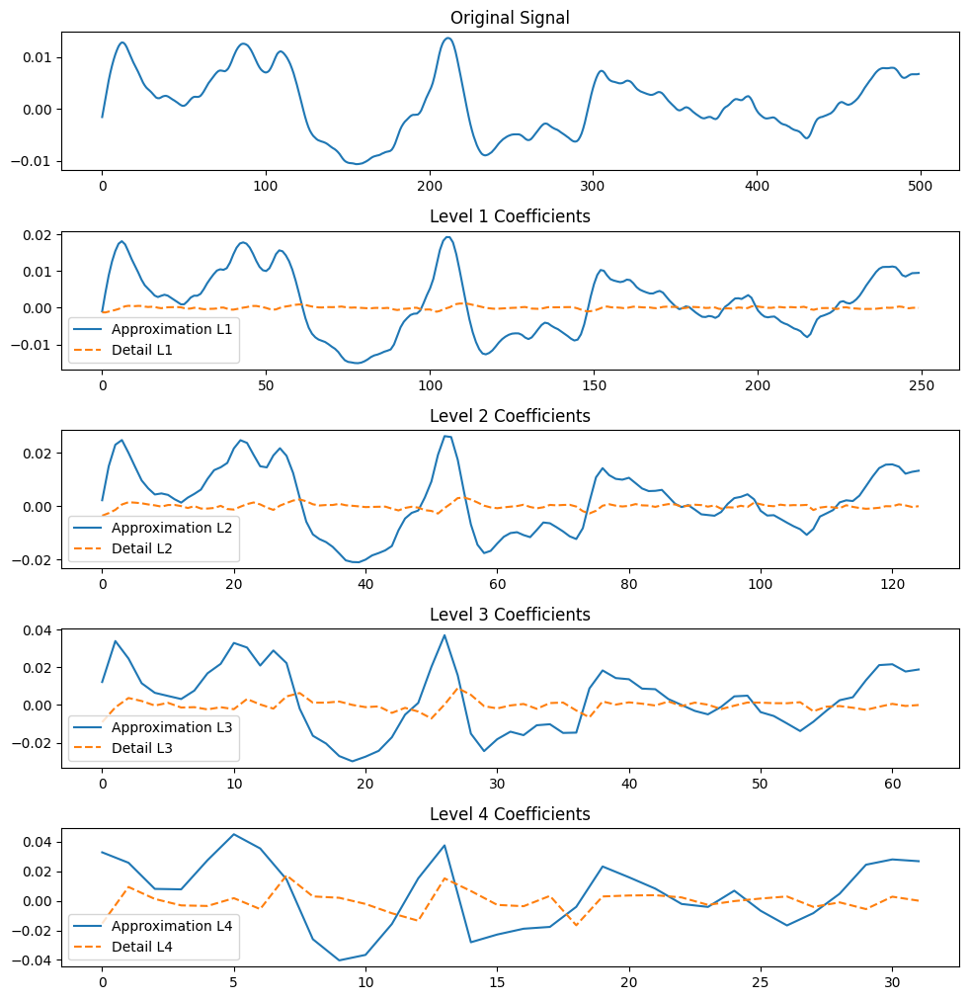

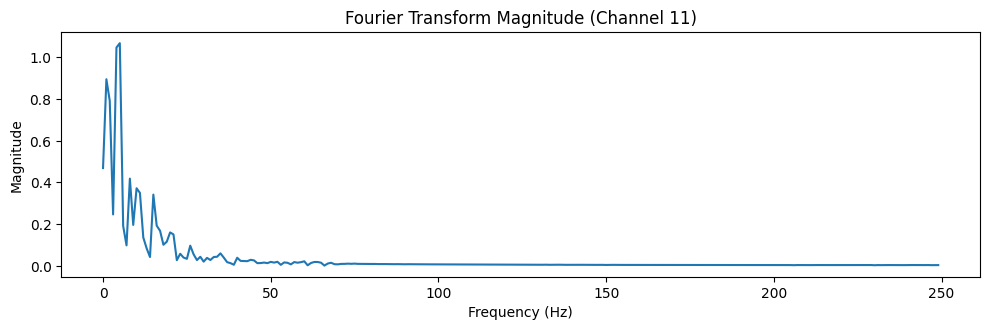

Plotting Channel 12


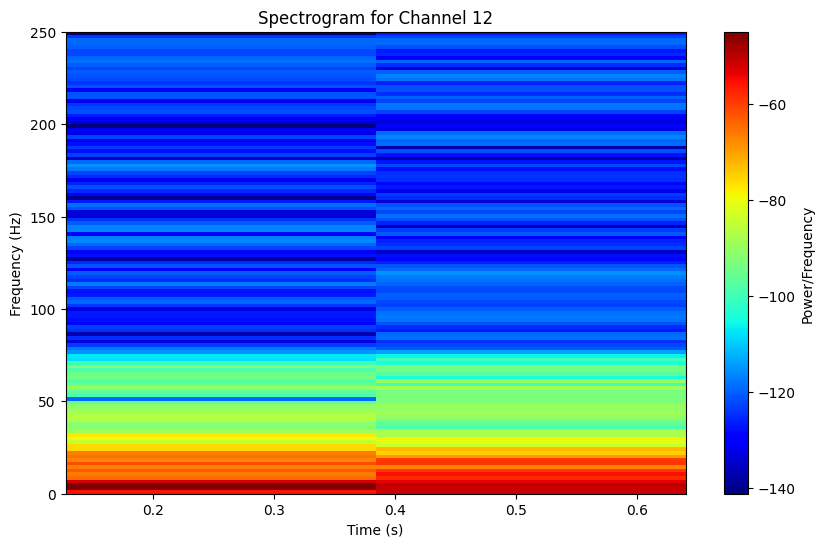

Most similar coefficient to the original signal (Channel 12): Detail L1 with similarity: 0.17262836938468484
Similarity Scores:
Level 1 -> Approximation Similarity: -0.12006105906630961, Detail Similarity: 0.17262836938468484
Level 2 -> Approximation Similarity: 0.0034317064891390275, Detail Similarity: -0.03327657084323839
Level 3 -> Approximation Similarity: 0.0781768848453258, Detail Similarity: 0.0007551036670884909
Level 4 -> Approximation Similarity: -0.03522681466331594, Detail Similarity: 0.006913173579954875


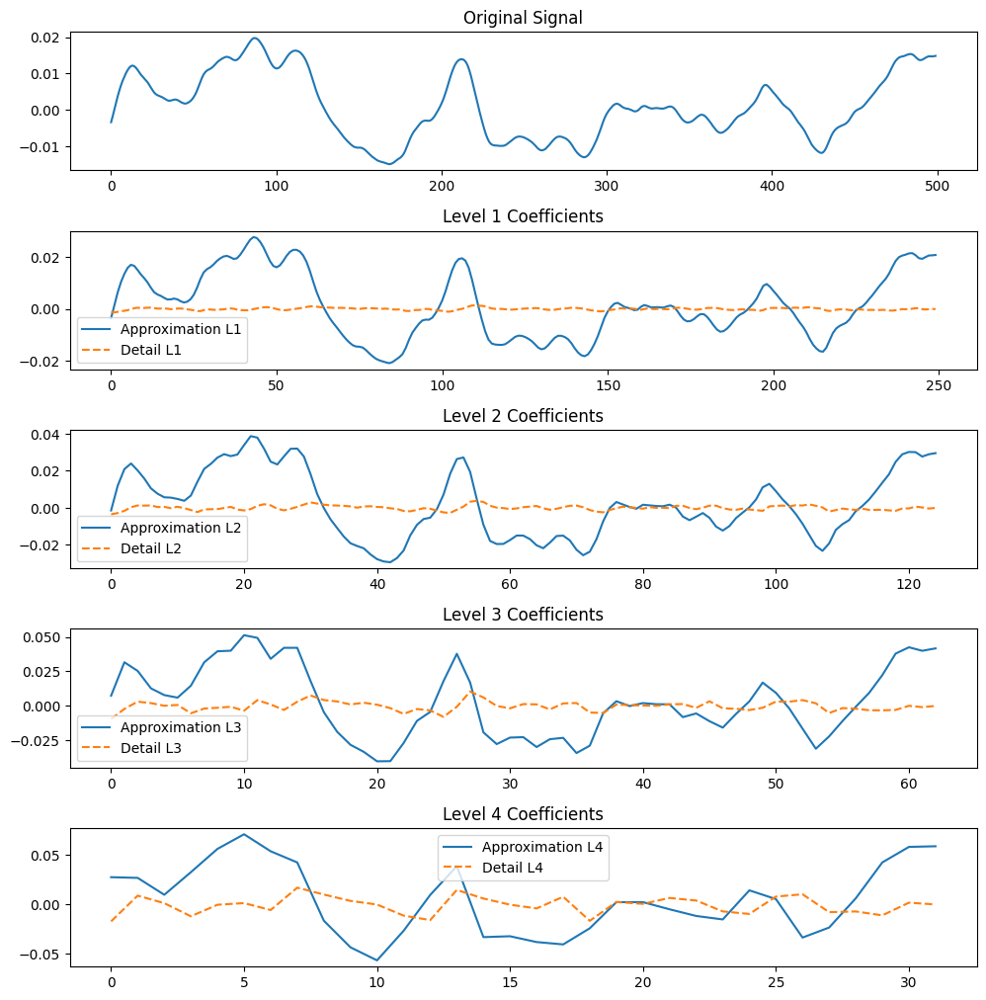

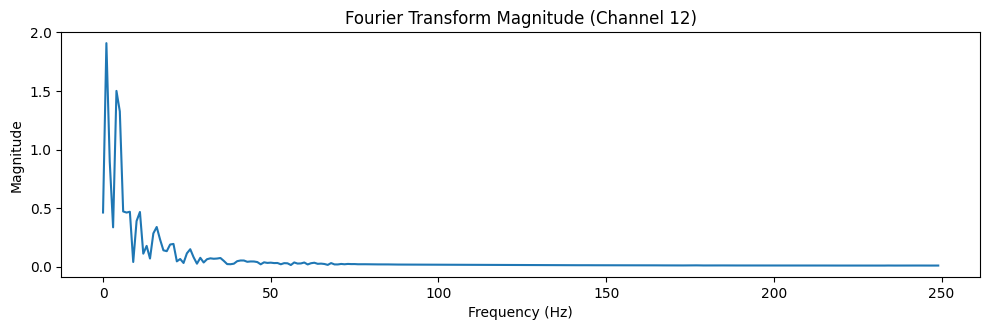

Plotting Channel 13


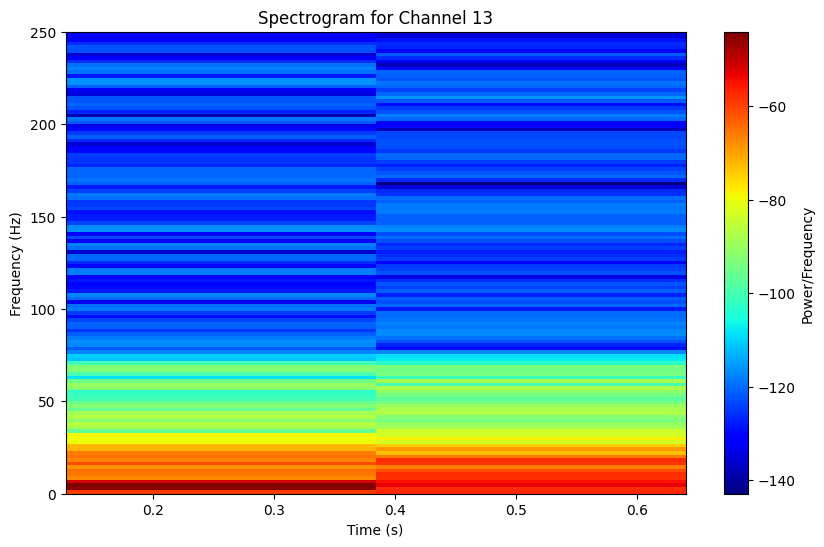

Most similar coefficient to the original signal (Channel 13): Detail L1 with similarity: 0.16150851007351072
Similarity Scores:
Level 1 -> Approximation Similarity: -0.19166425364848735, Detail Similarity: 0.16150851007351072
Level 2 -> Approximation Similarity: 0.0478349531926373, Detail Similarity: -0.028880957897220623
Level 3 -> Approximation Similarity: 0.06913661964965558, Detail Similarity: 0.00511707376666087
Level 4 -> Approximation Similarity: -0.02406628116046638, Detail Similarity: 0.005855932904987406


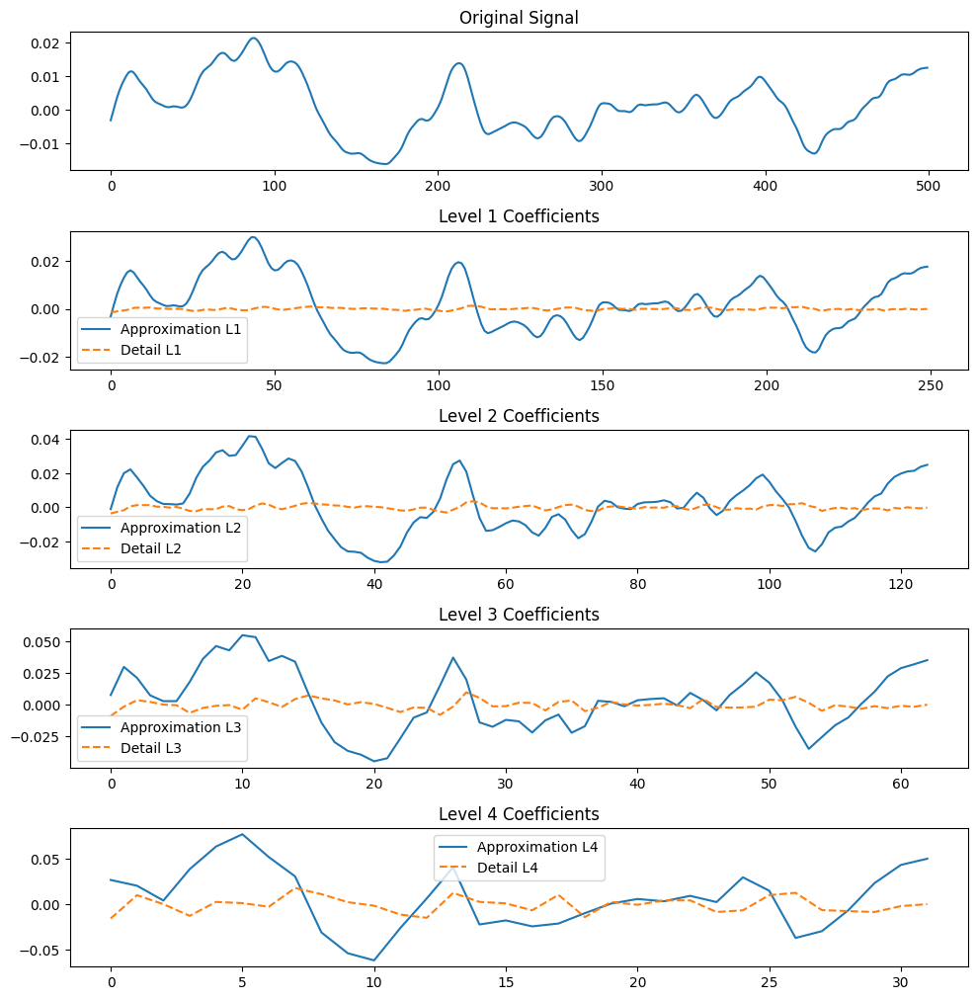

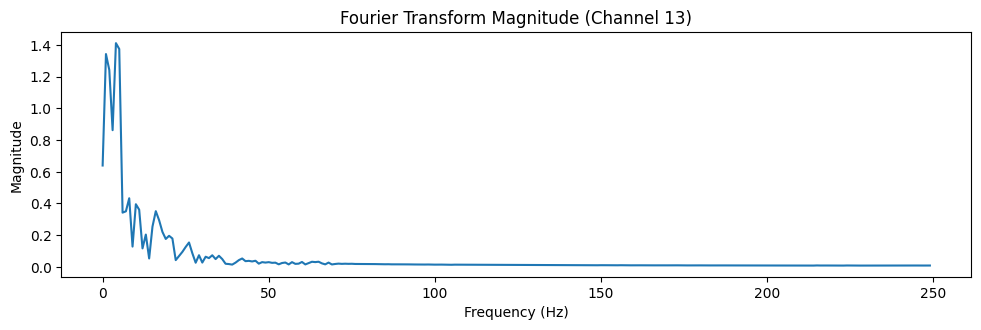

Plotting Channel 14


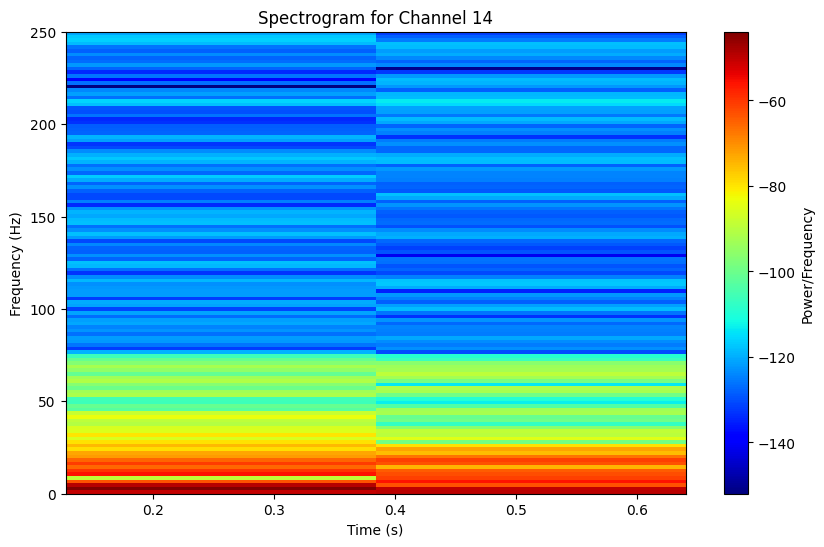

Most similar coefficient to the original signal (Channel 14): Detail L1 with similarity: 0.2160201003098471
Similarity Scores:
Level 1 -> Approximation Similarity: -0.15362637386923522, Detail Similarity: 0.2160201003098471
Level 2 -> Approximation Similarity: -0.11499046776099275, Detail Similarity: -0.06776281337405553
Level 3 -> Approximation Similarity: 0.04376093925827416, Detail Similarity: 0.0026784137296055445
Level 4 -> Approximation Similarity: -0.05527211542244556, Detail Similarity: 0.02707366605764447


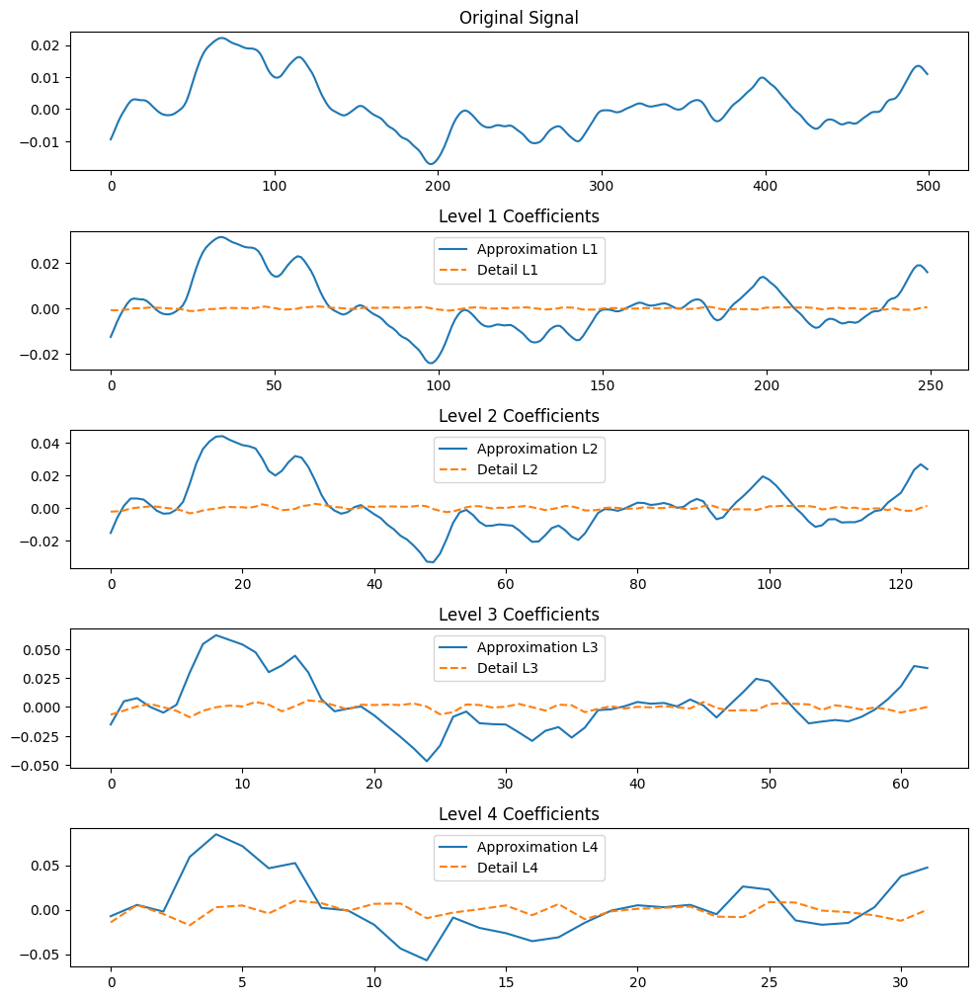

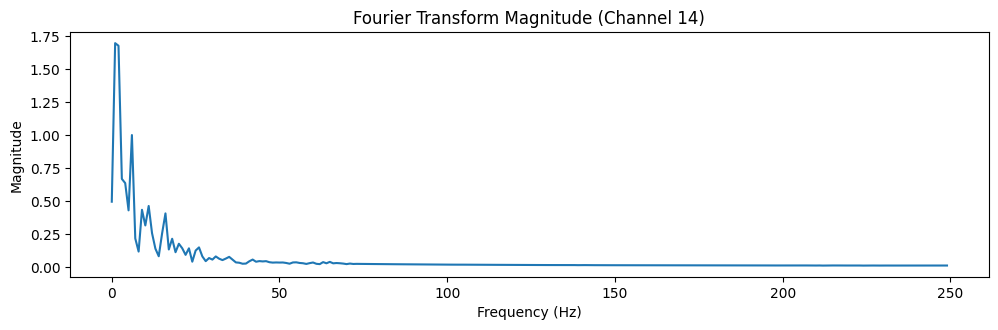

Plotting Channel 15


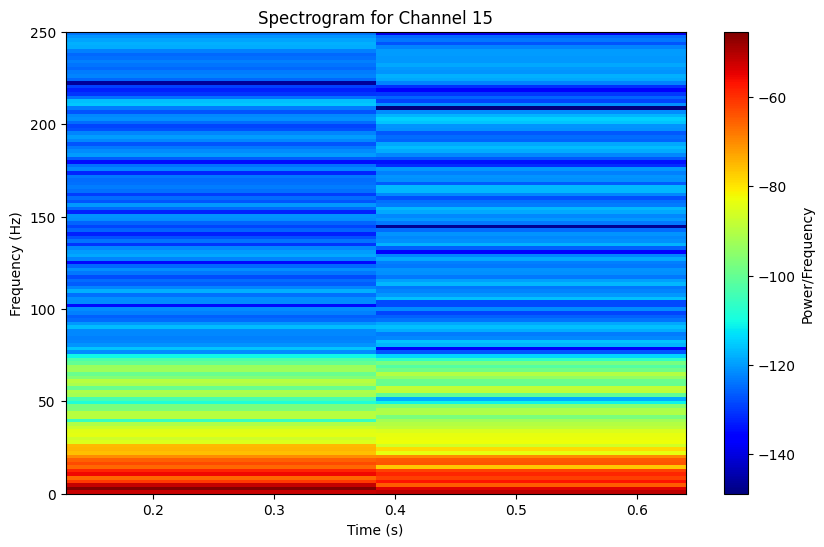

Most similar coefficient to the original signal (Channel 15): Detail L1 with similarity: 0.24459550941819694
Similarity Scores:
Level 1 -> Approximation Similarity: 0.0028786469700710785, Detail Similarity: 0.24459550941819694
Level 2 -> Approximation Similarity: -0.09810201340607146, Detail Similarity: -0.0315473084014823
Level 3 -> Approximation Similarity: 0.07475226377050481, Detail Similarity: 0.012251749757969978
Level 4 -> Approximation Similarity: -0.058665643786949384, Detail Similarity: 0.018095015178313675


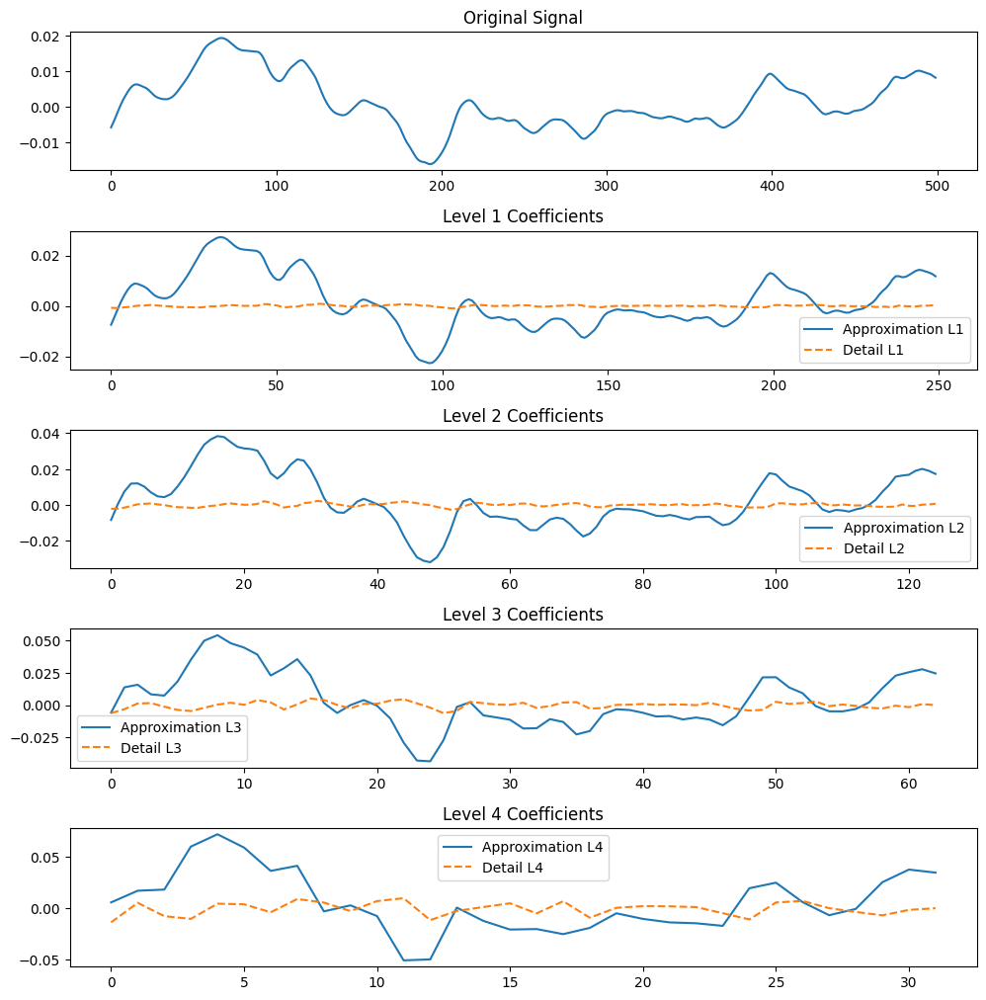

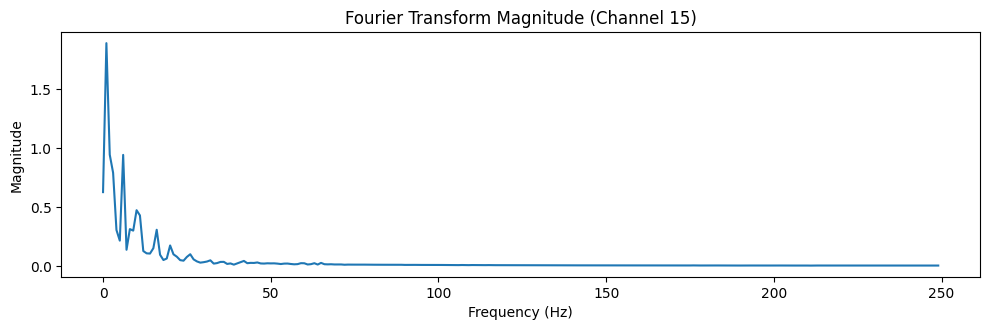

Plotting Channel 16


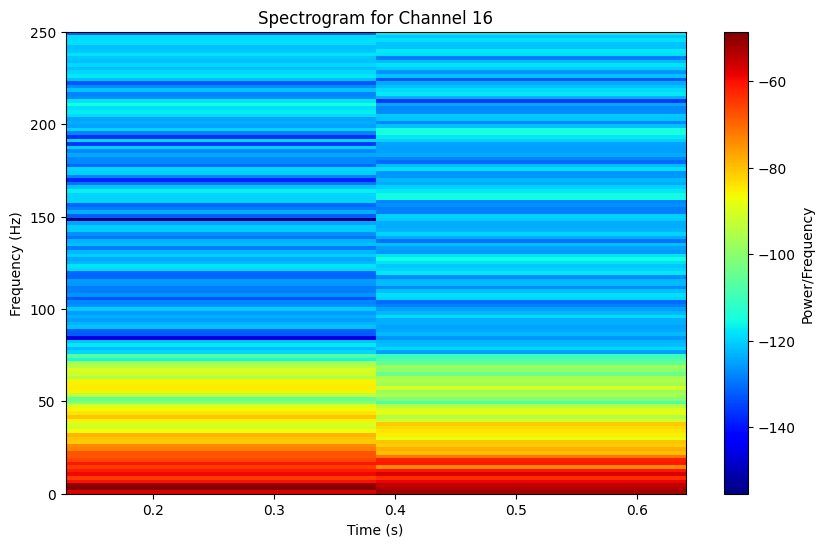

Most similar coefficient to the original signal (Channel 16): Detail L1 with similarity: 0.19609742367368413
Similarity Scores:
Level 1 -> Approximation Similarity: 0.03260729236551748, Detail Similarity: 0.19609742367368413
Level 2 -> Approximation Similarity: -0.0387455507397925, Detail Similarity: 0.020631814547491457
Level 3 -> Approximation Similarity: 0.043163346091772026, Detail Similarity: 0.019959691477365652
Level 4 -> Approximation Similarity: -0.06788231020282352, Detail Similarity: 0.0287136816428857


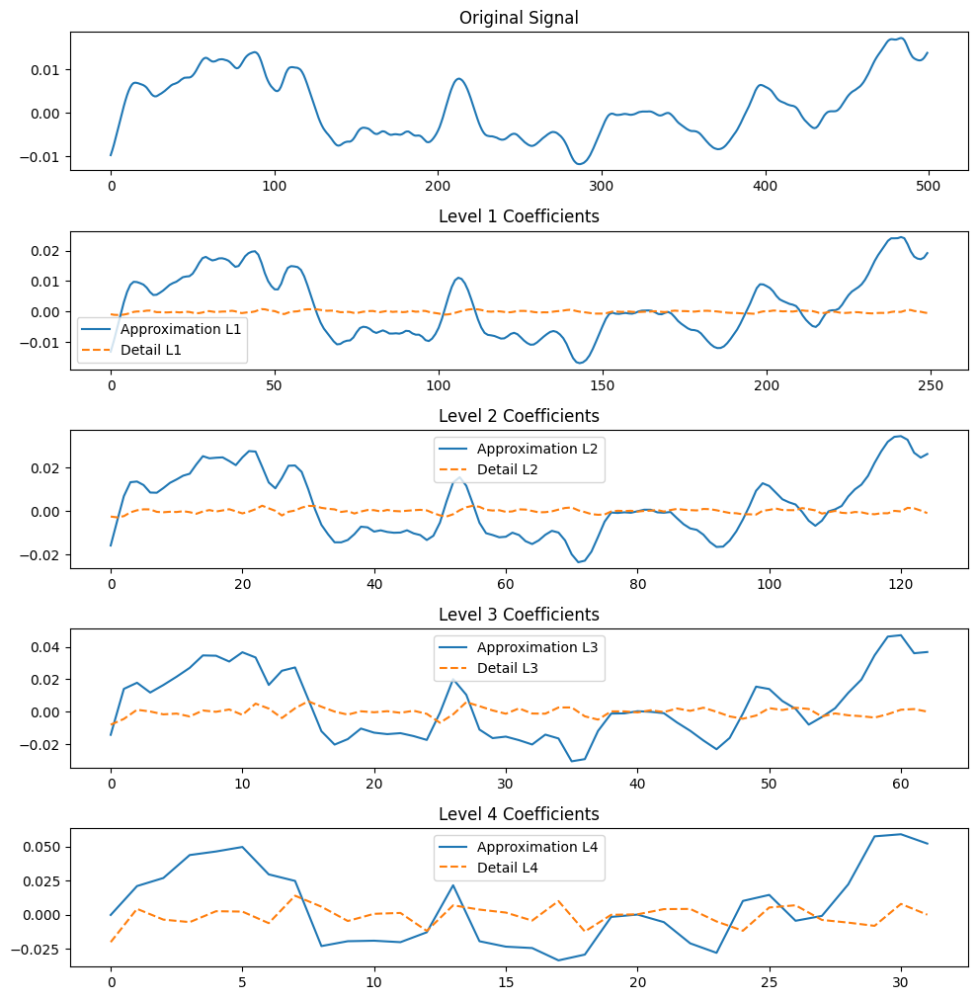

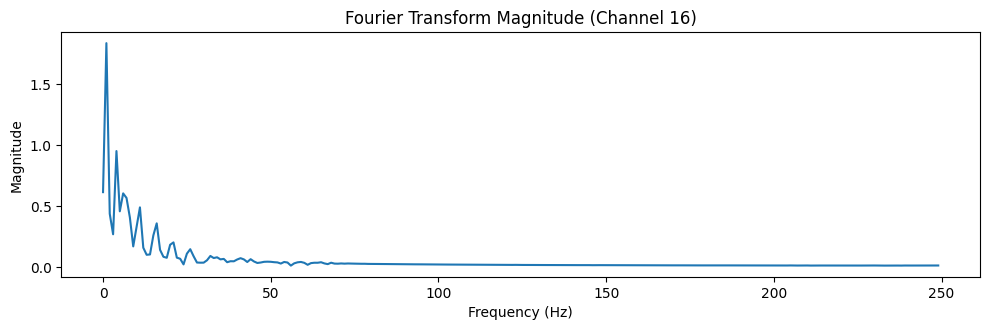

Plotting Channel 17


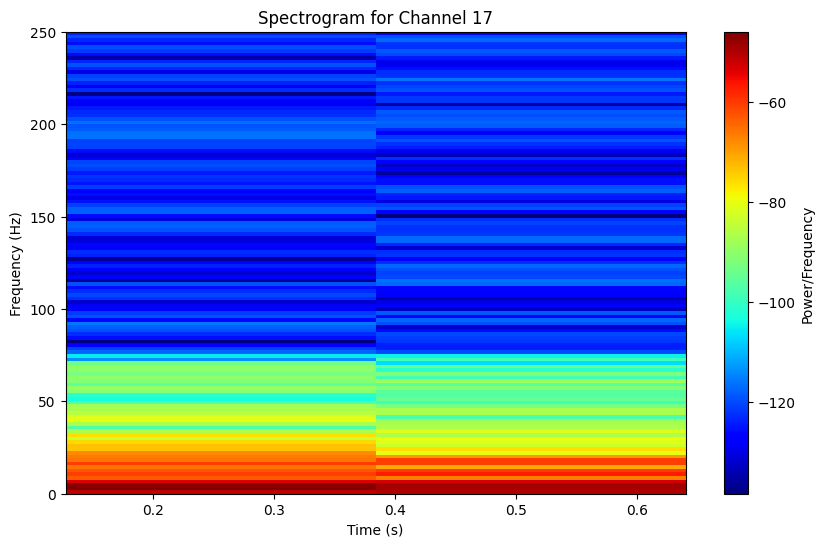

Most similar coefficient to the original signal (Channel 17): Detail L1 with similarity: 0.16272917916596213
Similarity Scores:
Level 1 -> Approximation Similarity: -0.022098603794423473, Detail Similarity: 0.16272917916596213
Level 2 -> Approximation Similarity: 0.017665752787877905, Detail Similarity: -0.023615464462534697
Level 3 -> Approximation Similarity: 0.06798043659935021, Detail Similarity: 0.004445443110031447
Level 4 -> Approximation Similarity: -0.04546499294341547, Detail Similarity: 0.013068179875029845


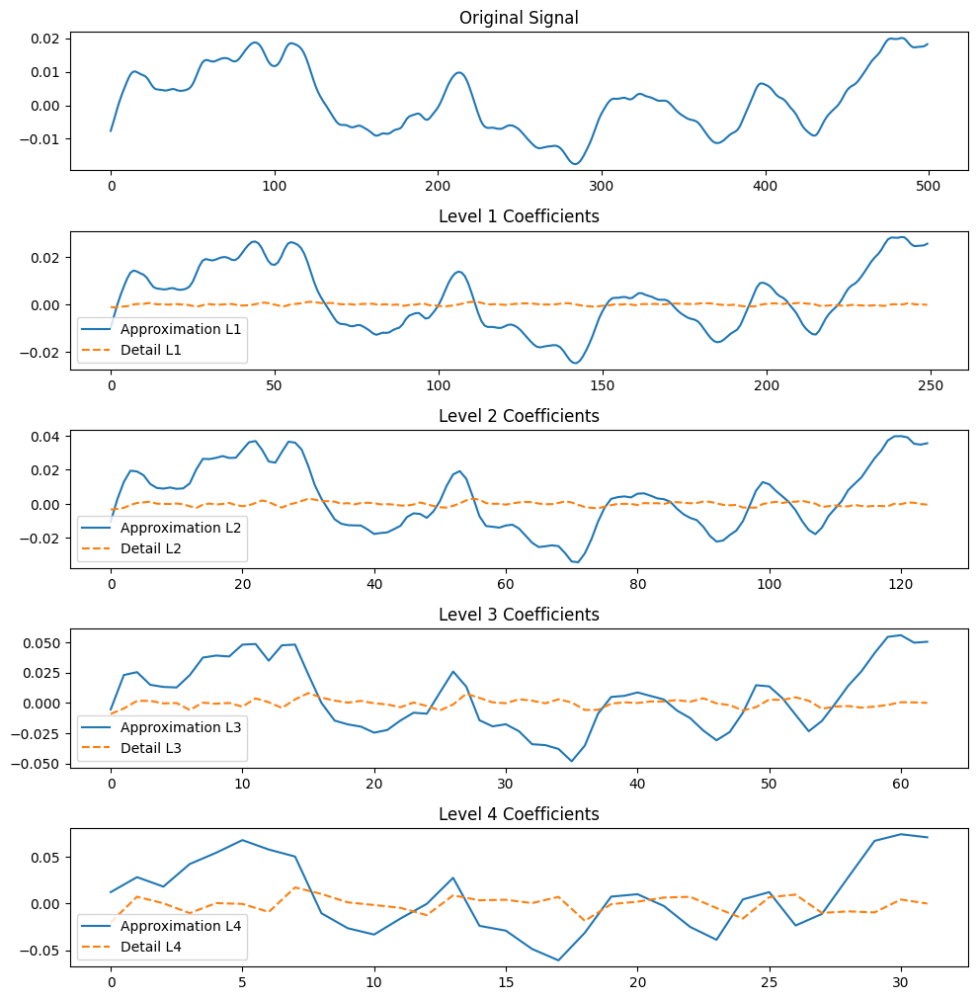

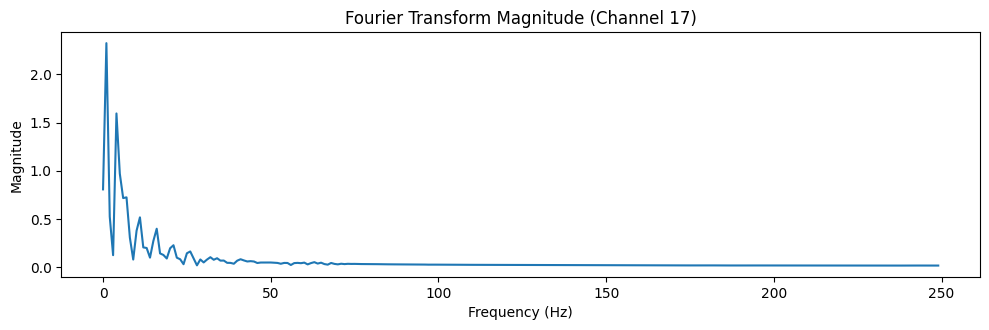

Plotting Channel 18


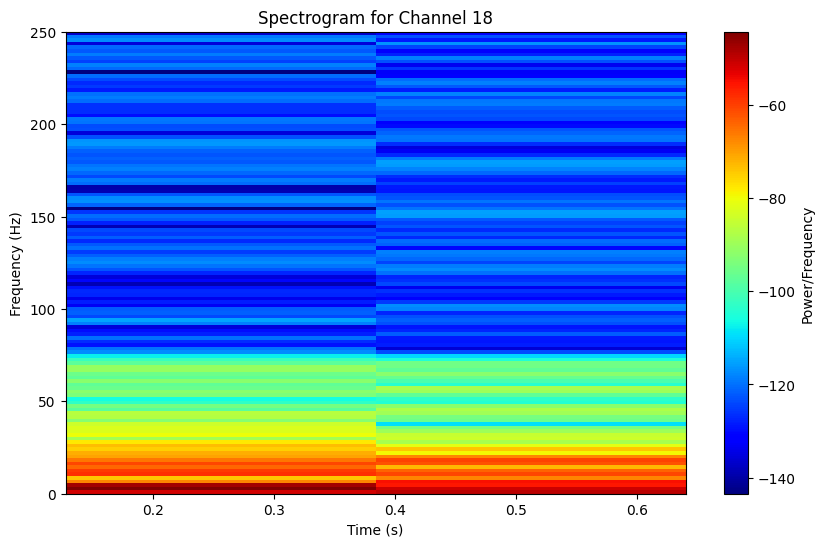

Most similar coefficient to the original signal (Channel 18): Detail L1 with similarity: 0.2227966168887605
Similarity Scores:
Level 1 -> Approximation Similarity: -0.06538260909581387, Detail Similarity: 0.2227966168887605
Level 2 -> Approximation Similarity: -0.07966804732989746, Detail Similarity: -0.045694616602850895
Level 3 -> Approximation Similarity: 0.07631057684500615, Detail Similarity: 0.006252226084826533
Level 4 -> Approximation Similarity: -0.05581000851293969, Detail Similarity: 0.019591118958095097


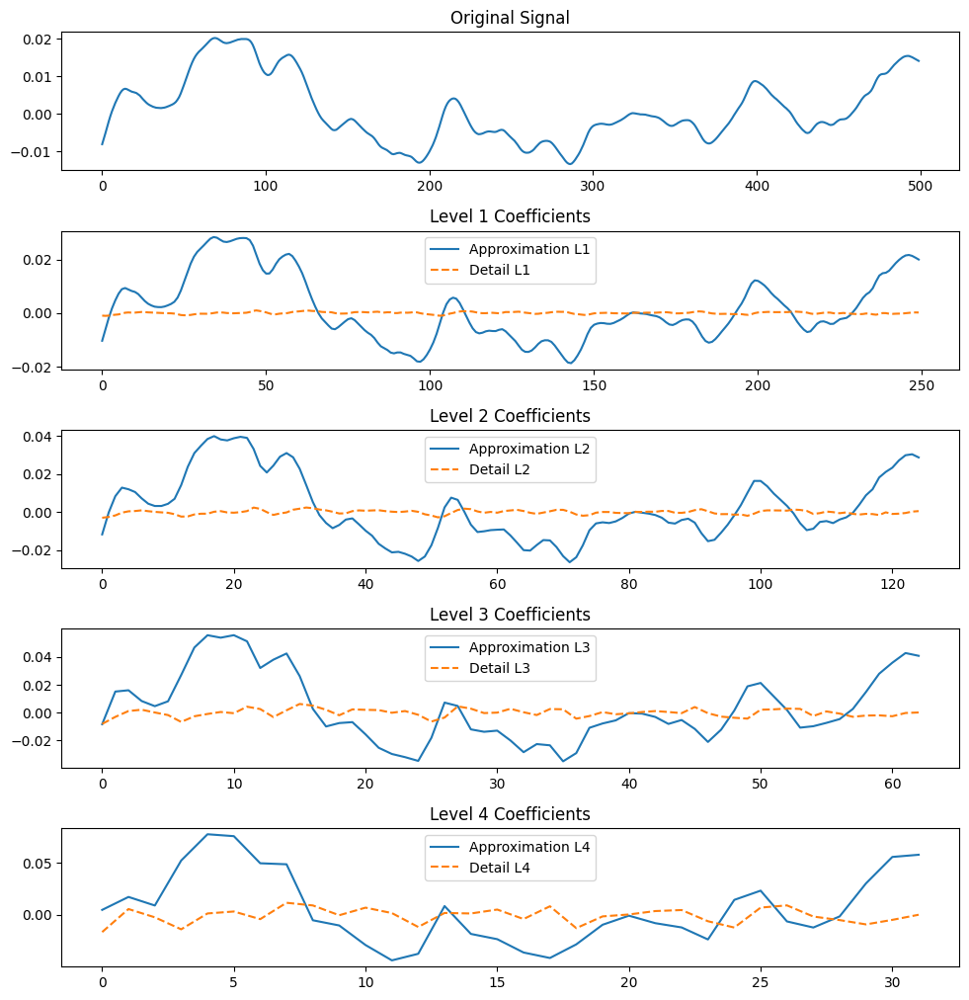

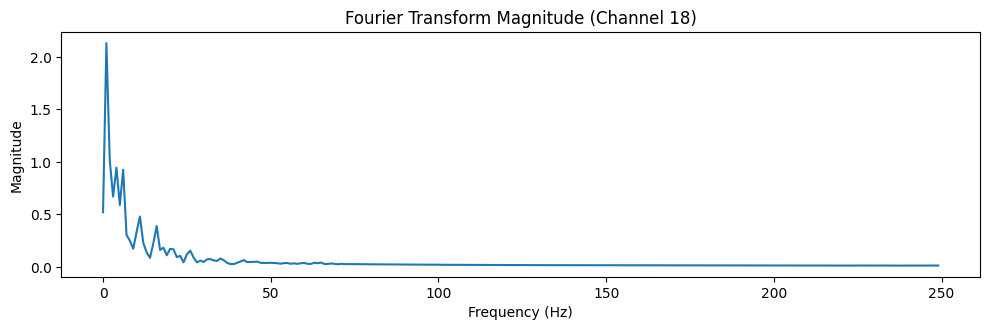

Plotting Channel 19


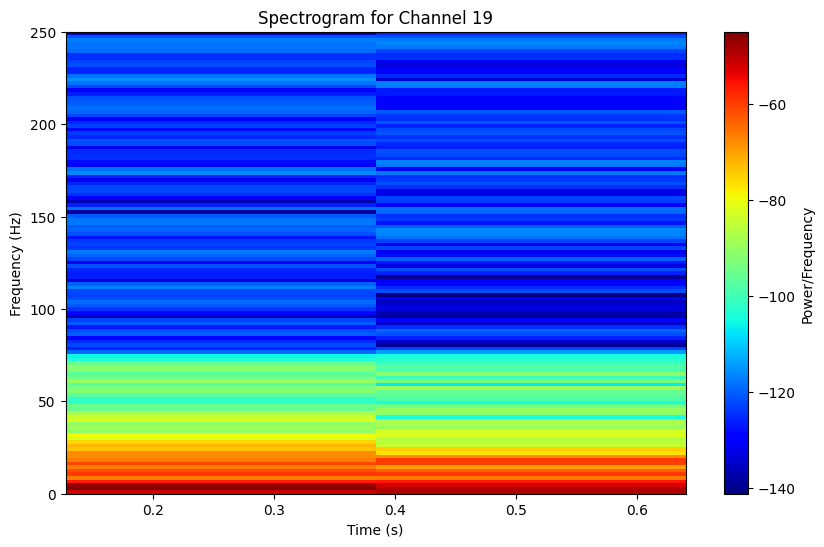

Most similar coefficient to the original signal (Channel 19): Detail L1 with similarity: 0.18667763624886494
Similarity Scores:
Level 1 -> Approximation Similarity: -0.027901296514280097, Detail Similarity: 0.18667763624886494
Level 2 -> Approximation Similarity: -0.04365512739875402, Detail Similarity: -0.038378890918062535
Level 3 -> Approximation Similarity: 0.08994741793884473, Detail Similarity: -0.003410123067762437
Level 4 -> Approximation Similarity: -0.04029041358556513, Detail Similarity: 0.011681741679007714


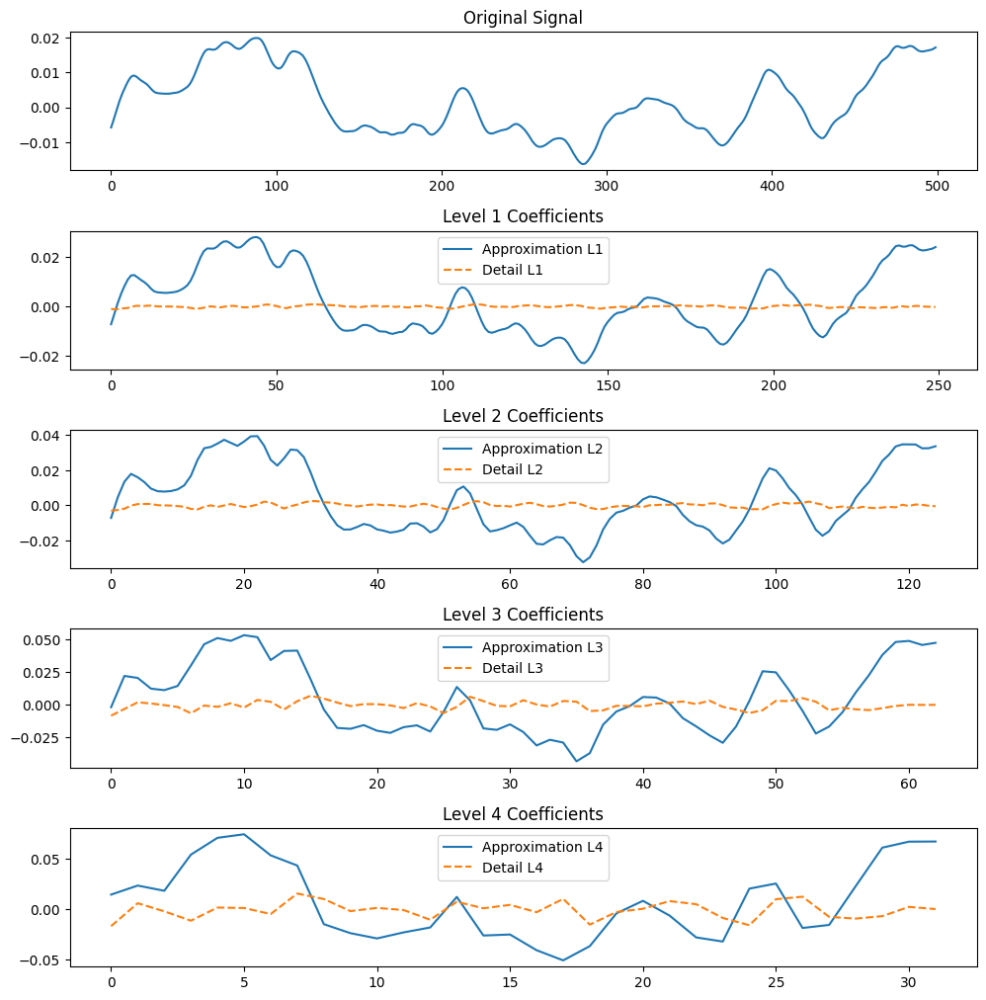

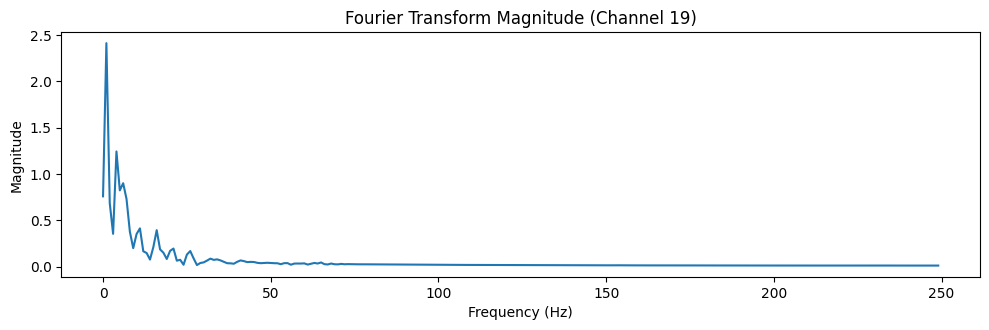

Features saved to Electrographic_Seizures_features.csv


In [27]:
print("Electrographic Seizures Analysis")
seizure_features = analyze_data(seizure_dataset, "Electrographic_Seizures")